In [1]:
# **Data processing libraries:**
import pandas as pd  # Data analysis and manipulation
import numpy as np  # Numerical computing

# **Data cleaning libraries:**
#import missingno as msno  # Missing data visualization and imputation
 # Data cleaning and preparation
%matplotlib inline
# **Data visualization libraries:**
import seaborn as sns  # Statistical data visualization
import matplotlib.pyplot as plt  # 2D and 3D plotting
import plotly.express as px  # Interactive visualizations
import plotly.graph_objects as go  # Interactive data visualization
#import polars as pl
# **Machine learning libraries:**
import sklearn  # Machine learning algorithms
from IPython.core.pylabtools import figsize
figsize(12, 4)
import datetime

In [4]:
file_path = '../data'

In [6]:
file= file_path + '/consommation.csv'
data=pd.read_csv(file)

file1= file_path + '/poduction.csv'
data1=pd.read_csv(file1)


In [7]:
grouped_data = data.groupby(['county', 'product_type', 'is_business'])
grouped_data1 = data1.groupby(['county', 'product_type', 'is_business'])

In [8]:
data['client_id'] = grouped_data.ngroup() + 1 
data1['client_id'] = grouped_data1.ngroup() + 1



In [9]:
print(data['client_id'].unique())
#client-id for 1 to 64

[ 2  4  6  1  3  7  8  9 10 13 14 15 17 16 18 20 22 19 23 25 27 24 26 28
 29 31 33 30 32 34 35 36 37 38 40 39 41 42 44 43 45 47 50 48 49 51 52 54
 55 56 58 57 59 61 63 62 64  5 11 53 60 12 21 46]


In [10]:
print(data1['client_id'].unique())

[ 2  4  6  1  3  7  8  9 10 13 14 15 17 16 18 20 22 19 23 25 27 24 26 28
 29 31 33 30 32 34 35 36 37 38 40 39 41 42 44 43 45 47 50 48 49 51 52 54
 55 56 58 57 59 61 63 62 64  5 11 53 60 12 21 46]


In [10]:
print(data['Client'].unique())

[ 2  4  6  1  3  7  8  9 10 13 14 15 17 16 18 20 22 19 23 25 27 24 26 28
 29 31 33 30 32 34 35 36 37 38 40 39 41 42 44 43 45 47 50 48 49 51 52 54
 55 56 58 57 59 61 63 62 64  5 11 53 60 12 21 46]


In [7]:

data['datetime'] = pd.to_datetime(data['datetime'])
data1['datetime'] = pd.to_datetime(data1['datetime'])

In [8]:

client1=data.loc[data['client_id'] == 1, ['datetime', 'target']] 
client1['sample'] = range(1, len(client1) + 1)


In [9]:
# Sample data
client_target = client1['target'] # The list of integers from client['target']
target_sample = client1['sample']   # The corresponding samples from target['sample']

vector = [sample for target, sample in zip(client_target, target_sample) for _ in range(int(target))]



In [10]:
# Sample data
client_target = client1['target'] # The list of integers from client['target']
target_sample = client1['sample']   # The corresponding samples from target['sample']

vector = [sample for target, sample in zip(client_target, target_sample) for _ in range(int(target))]




Means: [5448.86967538 2374.89346713 5917.55942186 4126.72988618  641.4488826
 6572.77766379 4913.13146284 3195.74926442 1647.7816144 ]
Covariances: [ 42681.73957699  89769.2688504   46101.38947904 113654.44027145
 111673.39638253  57743.41258383  47871.42644263 115393.62982057
  86128.00757453]
Weights (priors): [0.17743433 0.07313323 0.18057082 0.07760498 0.04338497 0.13323031
 0.17281137 0.06480059 0.0770294 ]


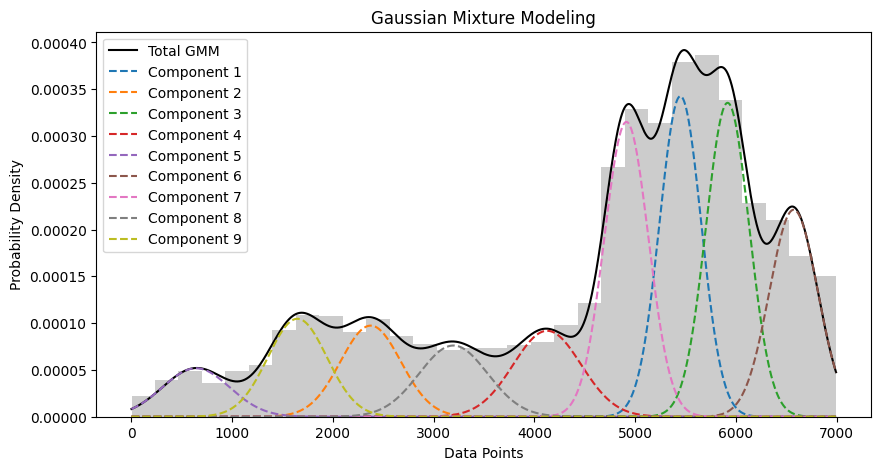

In [13]:
import numpy as np
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt

x = np.array(vector)  # Convert vector to a NumPy array
x = x.reshape(-1, 1) 
# Create a Gaussian Mixture Model with 3 components
gmm = GaussianMixture(n_components=9, random_state=0)
gmm.fit(x)

# Print the parameters of the model
print("Means:", gmm.means_.flatten())
print("Covariances:", gmm.covariances_.flatten())
print("Weights (priors):", gmm.weights_)

# Optionally, plot the density estimated by the GMM
logprob = gmm.score_samples(x)
responsibilities = gmm.predict_proba(x)
pdf = np.exp(logprob)
pdf_individual = responsibilities * pdf[:, np.newaxis]

plt.figure(figsize=(10, 5))
plt.hist(x, bins=30, density=True, alpha=0.4, color='gray')
plt.plot(x.flatten(), pdf, '-k', label="Total GMM")
for i in range(9):
    plt.plot(x.flatten(), pdf_individual[:, i], '--', label=f"Component {i+1}")
plt.legend()
plt.title('Gaussian Mixture Modeling')
plt.xlabel('Data Points')
plt.ylabel('Probability Density')
plt.show()


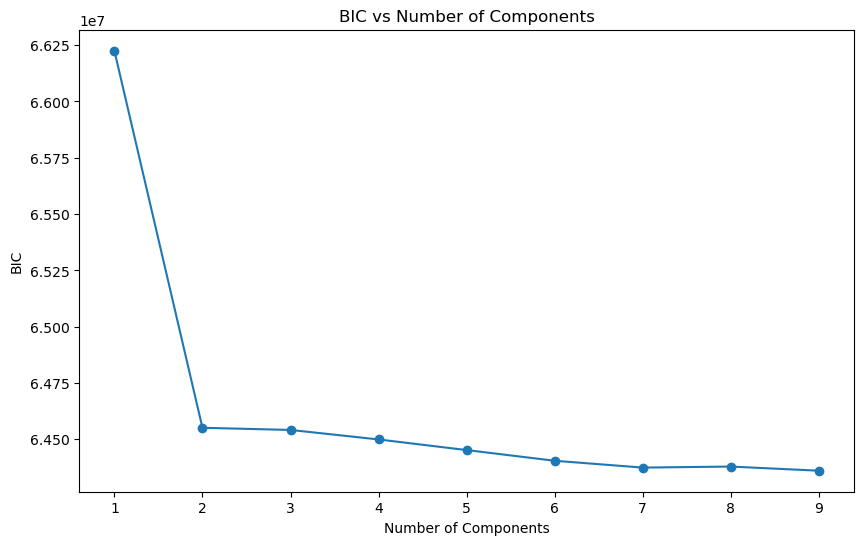

9
Vector for Germany (vi): [  1751.06934774 115362.35956355   5578.47214119  36578.14748864
   3653.45359772 133131.25613157   6631.09229334  44767.10791349
    665.85274315 124535.31580321   5051.12632097  41097.41642969
   2631.4474029  125028.57513361   4570.78647248  79928.8083387
   6033.04176639  45603.37442522]


In [227]:

from sklearn.mixture import GaussianMixture



n_components = np.arange(1, 10)
bics = []
models = []

for n in n_components:
    gmm = GaussianMixture(n_components=n, covariance_type='full', random_state=0)
    gmm.fit(x)
    bics.append(gmm.bic(x))
    models.append(gmm)

optimal_model_index = np.argmin(bics)
optimal_n_components = n_components[optimal_model_index]
gmm = models[optimal_model_index]

# Plot BIC scores
plt.figure(figsize=(10, 6))
plt.plot(n_components, bics, marker='o')
plt.title('BIC vs Number of Components')
plt.xlabel('Number of Components')
plt.ylabel('BIC')
plt.show()

# Extracting the means and covariances for the best model
means = gmm.means_.flatten()
covariances = [cov[0, 0] for cov in gmm.covariances_]
print(optimal_n_components)
# Create and order the vector vi
vi = np.empty(optimal_n_components * 2)
for i in range(optimal_n_components):
    vi[2*i] = means[i]
    vi[2*i + 1] = covariances[i]

print("Vector for Germany (vi):", vi)


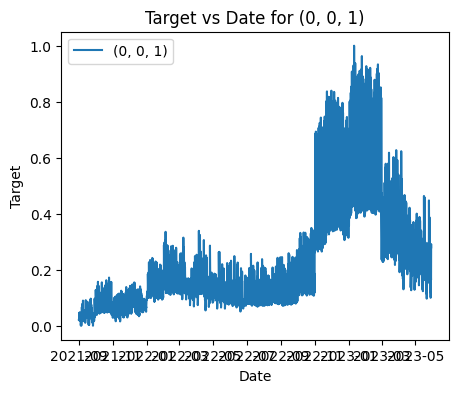

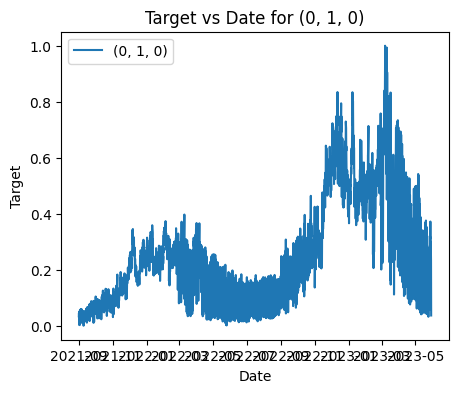

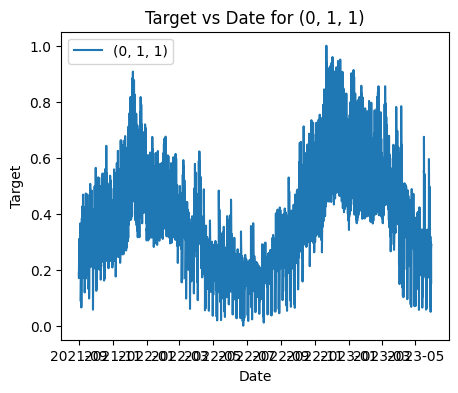

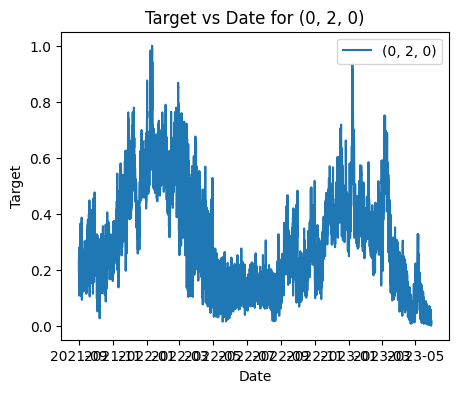

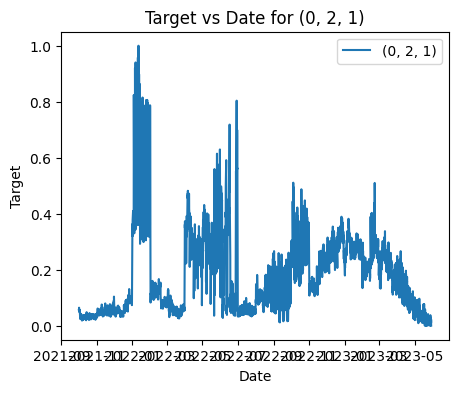

...

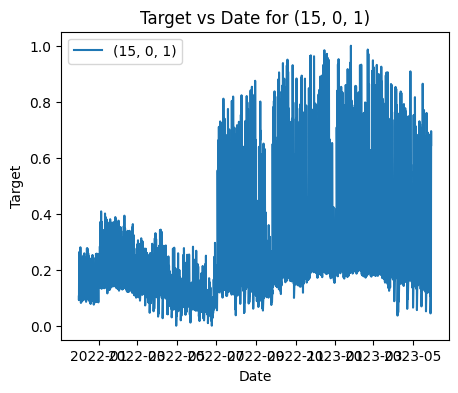

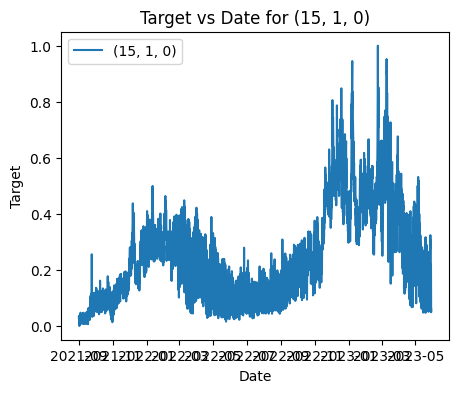

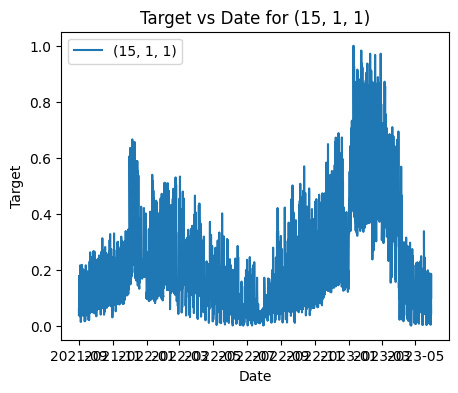

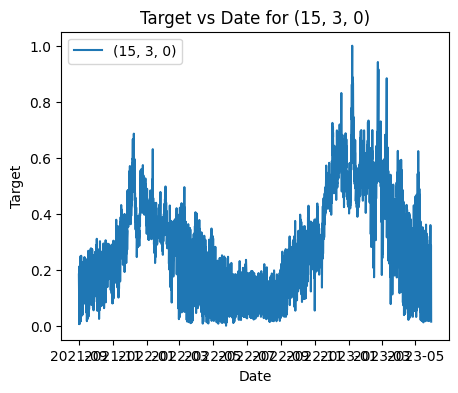

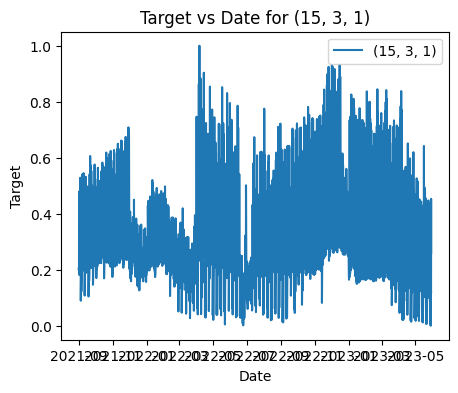

In [ ]:
for name, group in grouped_data:
    normalized_target = (group['target'] - group['target'].min()) / (group['target'].max() - group['target'].min())

    plt.figure(figsize=(5, 4))  # Adjusted figure size to be smaller
    plt.plot(group['datetime'], normalized_target, label=name)
    plt.xlabel('Date')
    plt.ylabel('Target')
    plt.title(f'Target vs Date for {name}')
    plt.legend()
    plt.show()




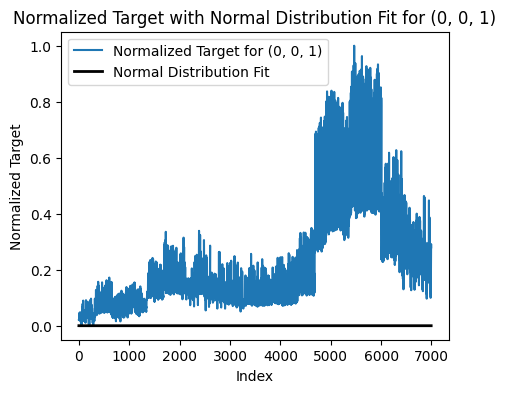

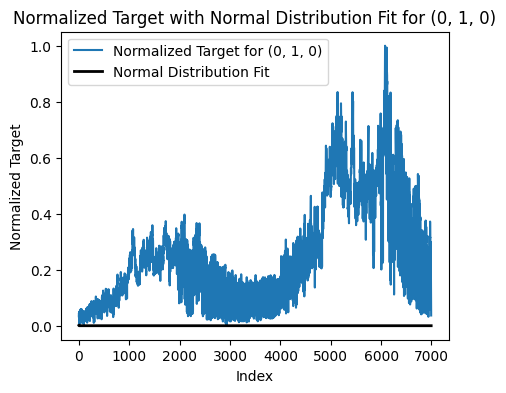

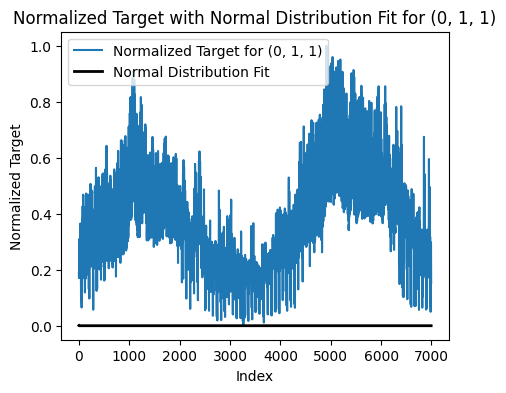

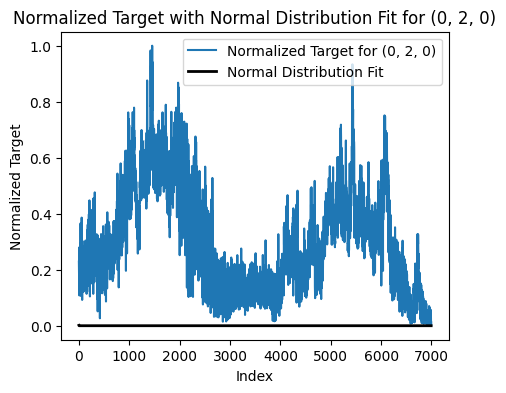

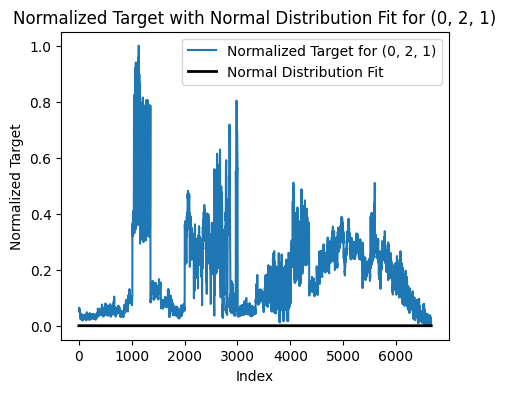

...

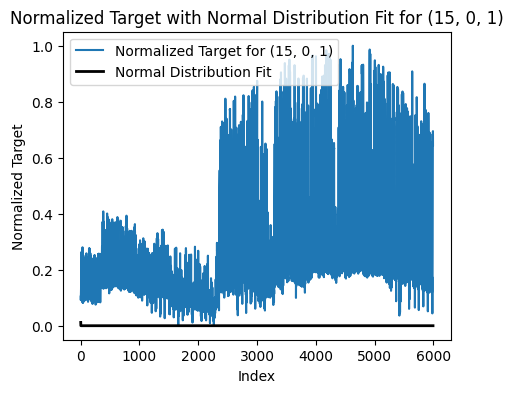

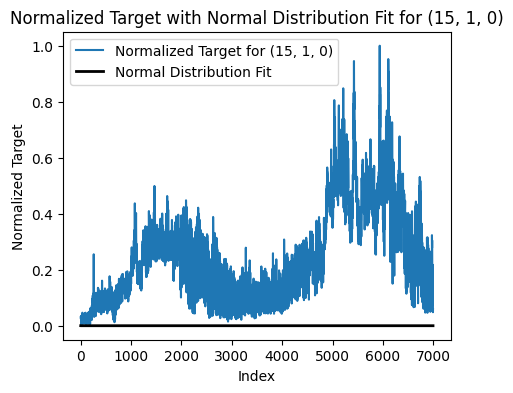

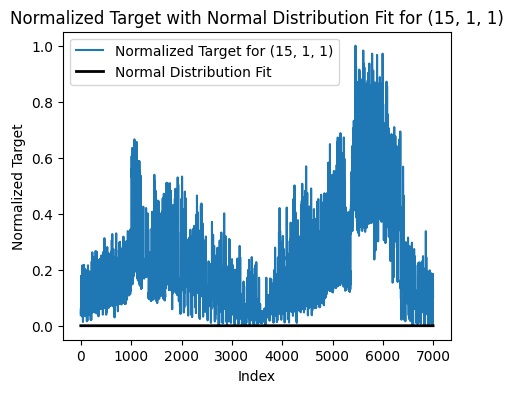

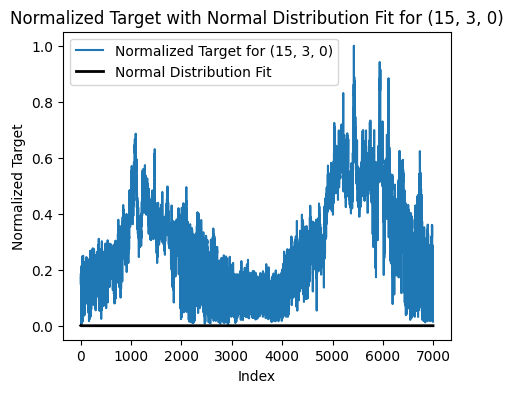

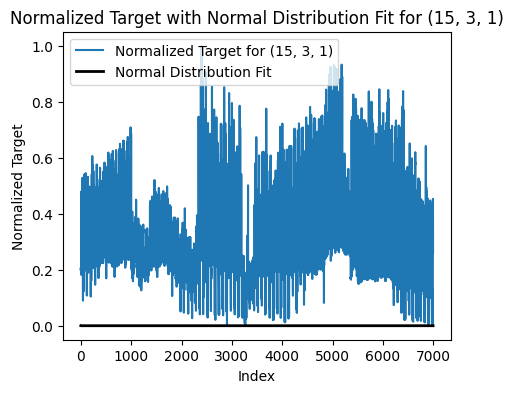

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

for name, group in grouped_data:
    # Create an index from 1 to the length of the datetime column
    group['index'] = range(1, len(group['datetime']) + 1)

    # Normalize the target variable
    normalized_target = (group['target'] - group['target'].min()) / (group['target'].max() - group['target'].min())

    # Fit a normal distribution to the normalized_target
    mu, sigma = norm.fit(normalized_target)

    # Create a sequence of numbers from 1 to the length of normalized_target
    x = np.linspace(1, len(normalized_target), len(normalized_target))

    # Calculate the probability density function (PDF) for the normal distribution
    p = norm.pdf(x, mu, sigma)

    # Plot the normalized data
    plt.figure(figsize=(5, 4))
    plt.plot(group['index'], normalized_target, label=f'Normalized Target for {name}')

    # Plot the PDF of the normal distribution
    plt.plot(x, p, 'k', linewidth=2, label='Normal Distribution Fit')

    plt.xlabel('Index')
    plt.ylabel('Normalized Target')
    plt.title(f'Normalized Target with Normal Distribution Fit for {name}')
    plt.legend()
    plt.show()


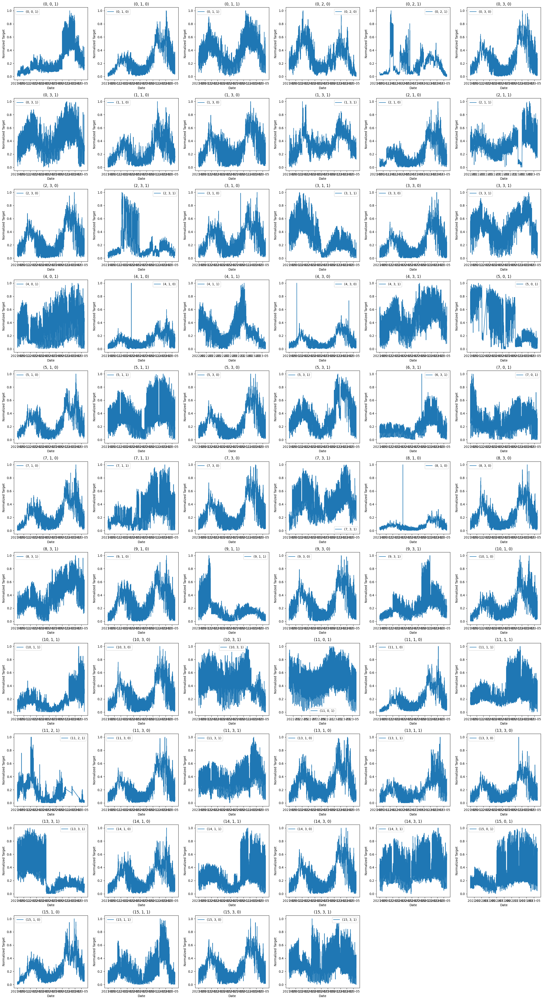

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math

# Assuming 'grouped_data' is defined somewhere above
# Example: grouped_data = df.groupby('some_column')

total_groups = len(grouped_data)

rows_needed = math.ceil(total_groups / 6)

fig, axs = plt.subplots(rows_needed, 6, figsize=(24, 4 * rows_needed))
axs = axs.flatten()

for idx, (name, group) in enumerate(grouped_data):

    # Normalize the 'target' column for the current group
    normalized_target = (group['target'] - group['target'].min()) / (group['target'].max() - group['target'].min())

    ax = axs[idx]
    ax.plot(group['datetime'], normalized_target, label=name)  # Plot the normalized target
    ax.set_xlabel('Date')
    ax.set_ylabel('Normalized Target')
    ax.set_title(f'{name}')
    ax.legend()

for idx in range(len(grouped_data), len(axs)):
    axs[idx].axis('off')

plt.tight_layout()
plt.show()


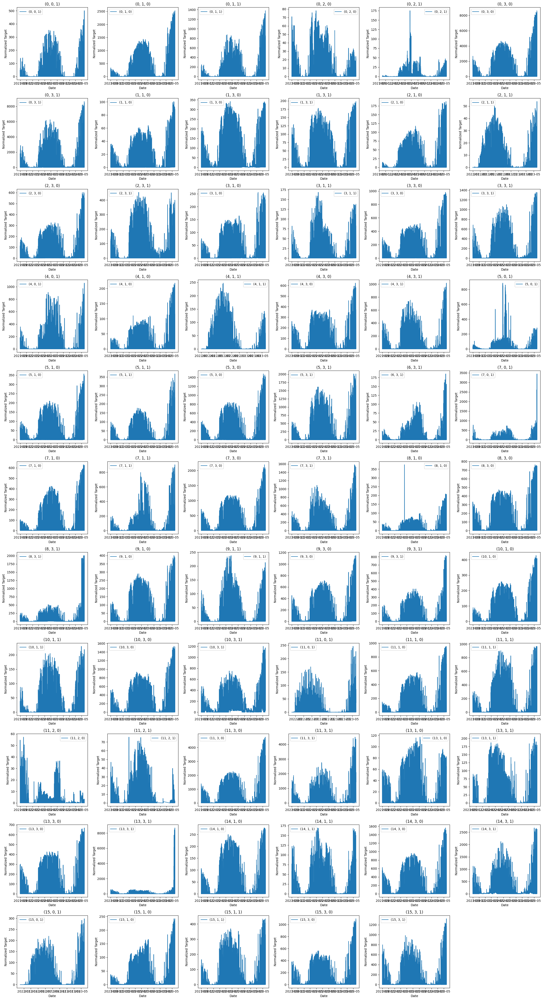

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math

# Assuming 'grouped_data' is defined somewhere above
# Example: grouped_data = df.groupby('some_column')

total_groups1 = len(grouped_data1)

rows_needed1 = math.ceil(total_groups1 / 6)

fig, axs = plt.subplots(rows_needed1, 6, figsize=(24, 4 * rows_needed1))
axs = axs.flatten()

for idx, (name, group) in enumerate(grouped_data1):



    ax = axs[idx]
    ax.plot(group['datetime'], group['target'], label=name)  # Plot the normalized target
    ax.set_xlabel('Date')
    ax.set_ylabel('Normalized Target')
    ax.set_title(f'{name}')
    ax.legend()

for idx in range(len(grouped_data1), len(axs)):
    axs[idx].axis('off')

plt.tight_layout()
plt.show()

#for consumption

Weighted Mean: 3988.1309043793326
Weighted Variance: 4057151.2383340313


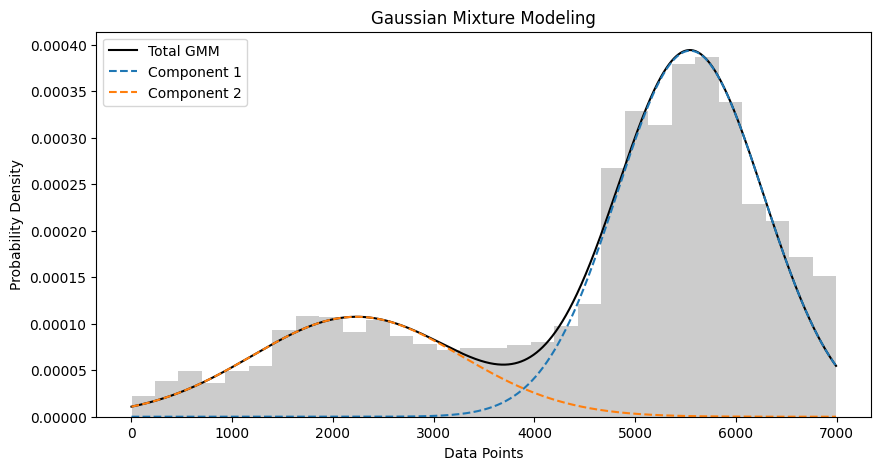

Client 1 - Means: [5545.47478244 2234.53341557]
Client 1 - Covariances: [ 531645.18237442 1086732.07844547]
Client 1 - Weights (priors): [0.719234 0.280766]
mean of pdf 4615.8750149828165
variance of pdf 2901189.307496939


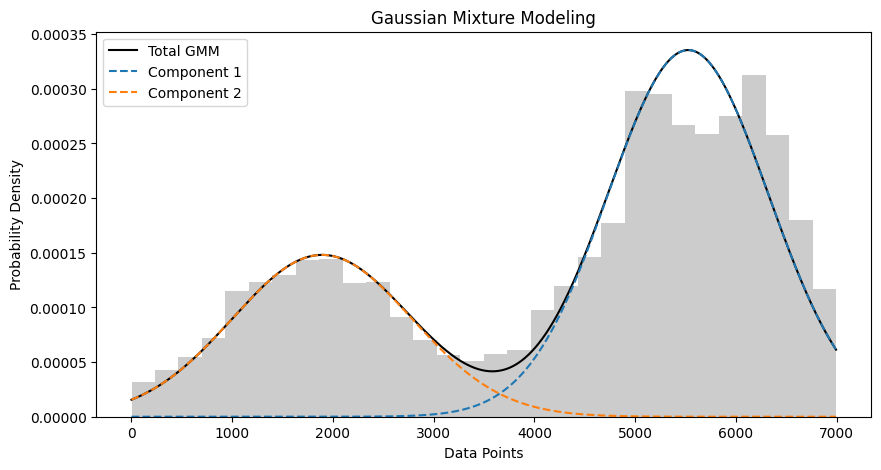

Client 2 - Means: [5526.70198797 1892.77127205]
Client 2 - Covariances: [633771.02106988 794171.57486828]
Client 2 - Weights (priors): [0.66928188 0.33071812]
mean of pdf 4324.895247637838
variance of pdf 3609761.378105809


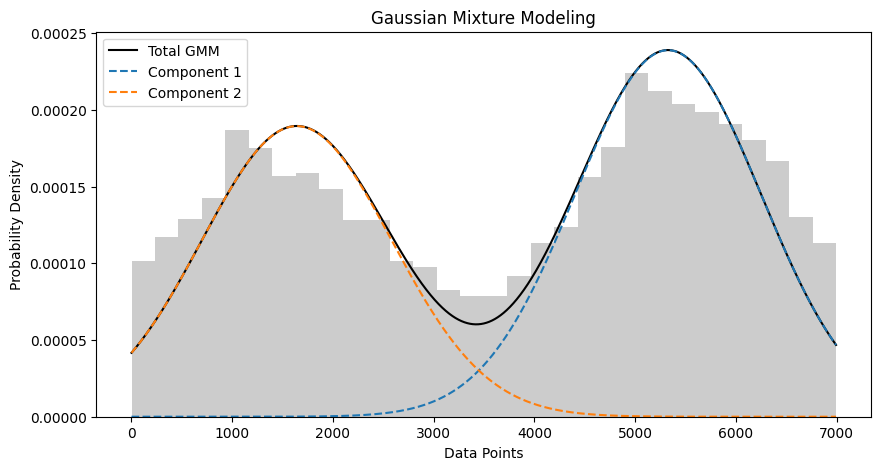

Client 3 - Means: [5326.69570249 1641.04504471]
Client 3 - Covariances: [852510.34141308 888030.02093423]
Client 3 - Weights (priors): [0.55271743 0.44728257]
mean of pdf 3678.1684221197024
variance of pdf 4226651.135922209


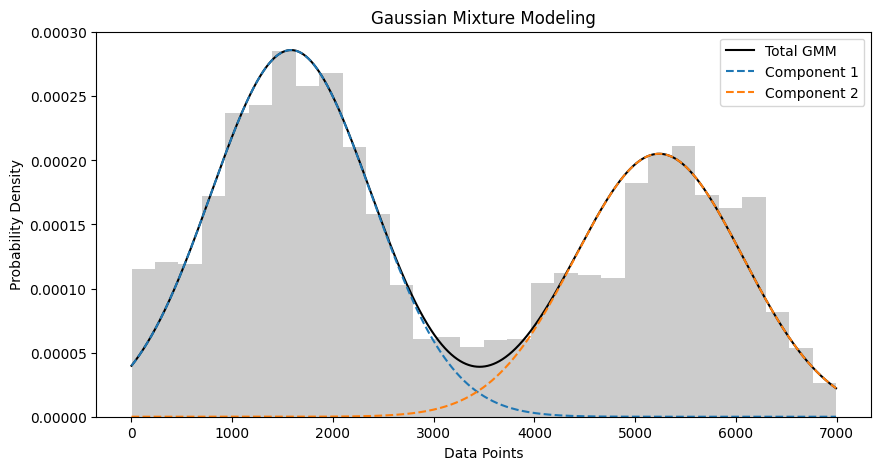

Client 4 - Means: [1584.2402042  5238.00089123]
Client 4 - Covariances: [635298.25867028 693800.90430509]
Client 4 - Weights (priors): [0.57159435 0.42840565]
mean of pdf 3149.531913270036
variance of pdf 3929424.298235286


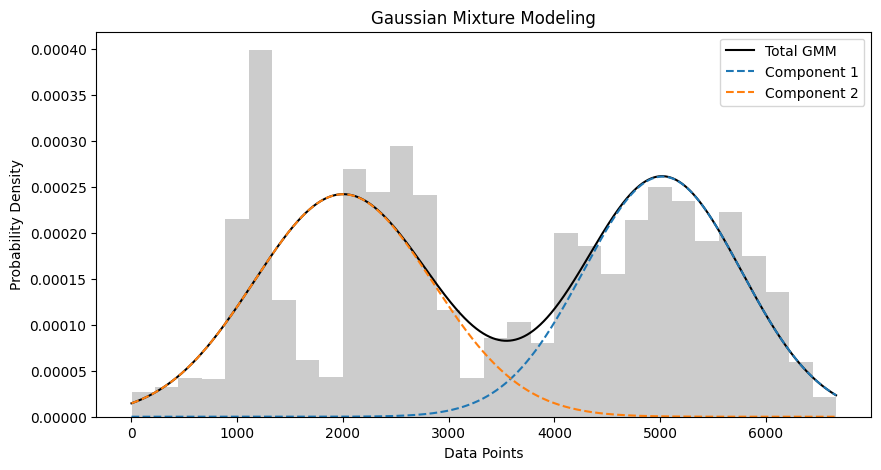

Client 5 - Means: [5020.63461127 2001.5009144 ]
Client 5 - Covariances: [557814.72157716 712726.78713307]
Client 5 - Weights (priors): [0.48848615 0.51151385]
mean of pdf 3476.3059106809956
variance of pdf 2914638.0721547096


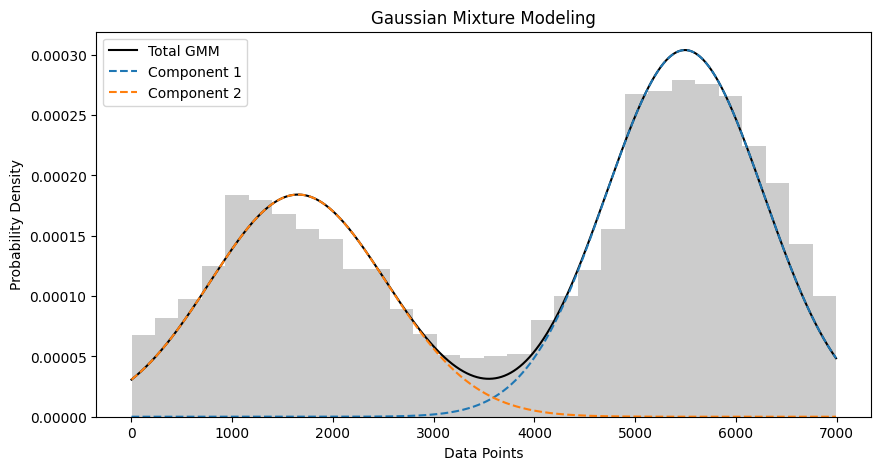

Client 6 - Means: [5494.5960519  1654.66440122]
Client 6 - Covariances: [612560.6511196  764365.76593009]
Client 6 - Weights (priors): [0.59636227 0.40363773]
mean of pdf 3944.6547517908743
variance of pdf 4223185.54448079


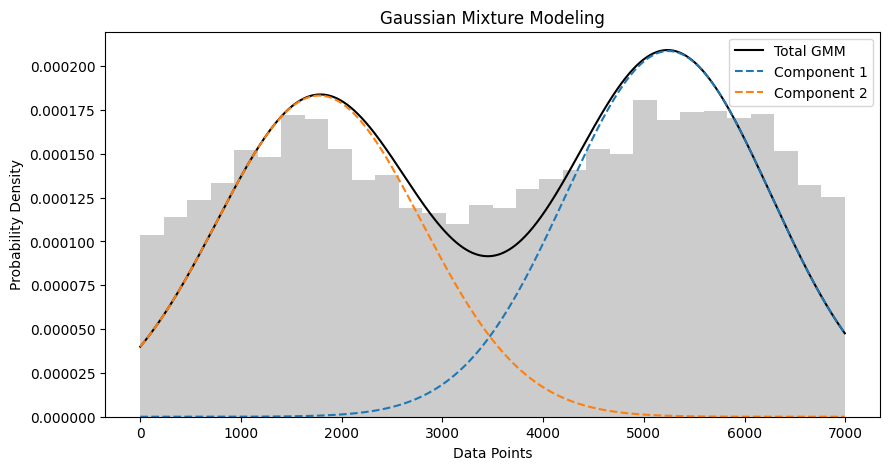

Client 7 - Means: [5243.61615768 1776.48743153]
Client 7 - Covariances: [1036680.7828824  1035043.90513069]
Client 7 - Weights (priors): [0.53263246 0.46736754]
mean of pdf 3623.1927437966183
variance of pdf 4028360.2858922305


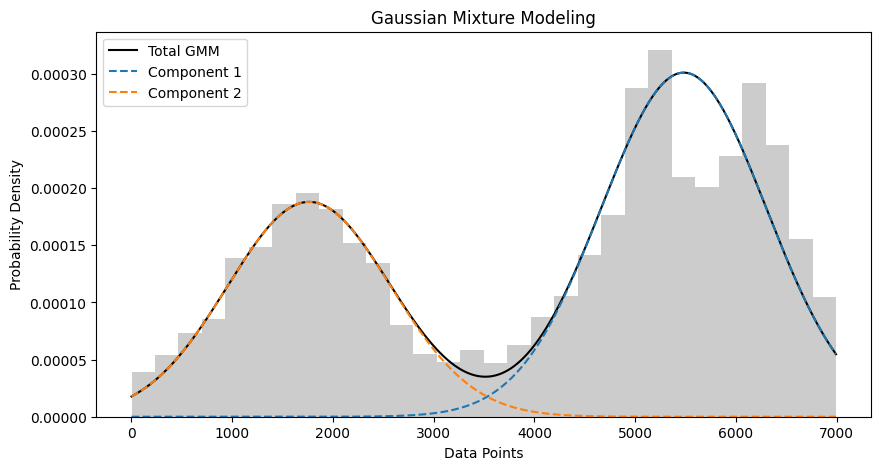

Client 8 - Means: [5482.79219188 1763.73601889]
Client 8 - Covariances: [669505.90416697 658360.84677245]
Client 8 - Weights (priors): [0.61760951 0.38239049]
mean of pdf 4060.6604705513737
variance of pdf 3931773.264378562


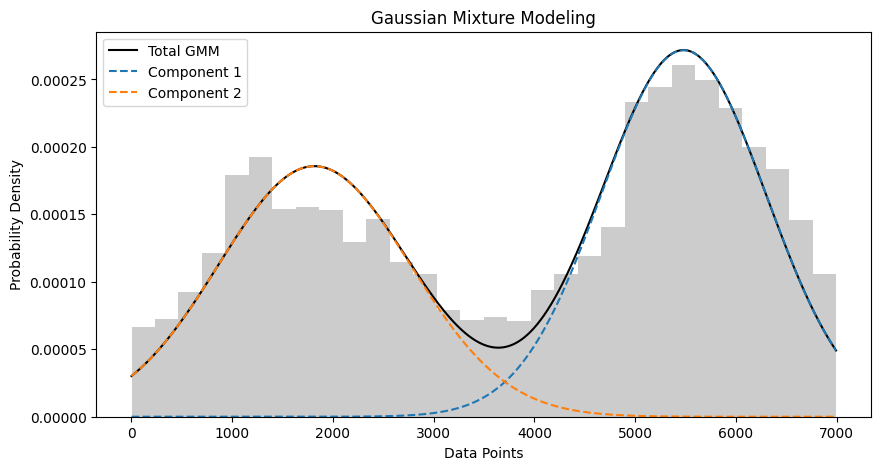

Client 9 - Means: [5481.23193647 1816.24734366]
Client 9 - Covariances: [668851.47139679 906065.27359068]
Client 9 - Weights (priors): [0.55689721 0.44310279]
mean of pdf 3857.267029343673
variance of pdf 4088505.9138395046


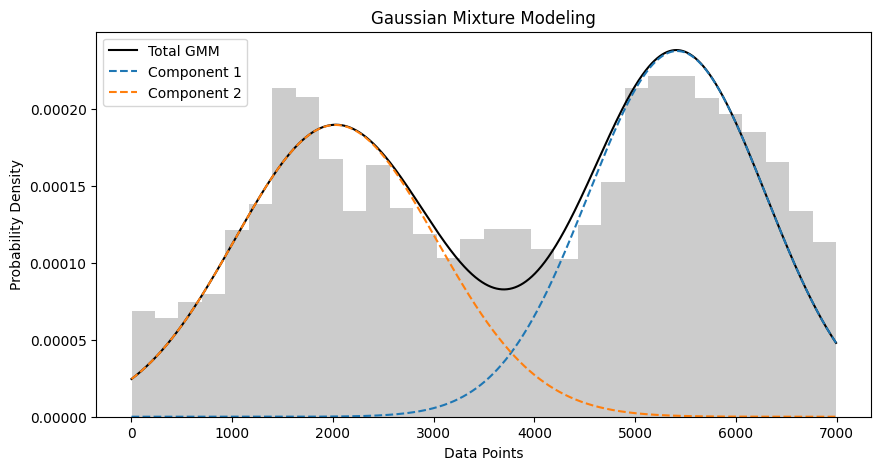

Client 10 - Means: [5416.0288064  2026.28880451]
Client 10 - Covariances: [ 778299.8438977  1002566.90152911]
Client 10 - Weights (priors): [0.52479386 0.47520614]
mean of pdf 3805.2035536864073
variance of pdf 3750393.7264730325


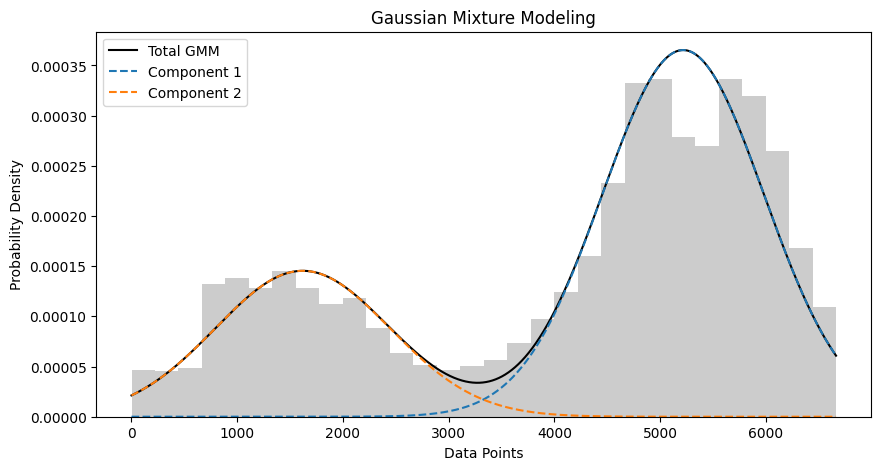

Client 11 - Means: [5218.13883271 1619.69896435]
Client 11 - Covariances: [583097.76597829 681336.65594811]
Client 11 - Weights (priors): [0.69922178 0.30077822]
mean of pdf 4135.806480357652
variance of pdf 3335910.451388593


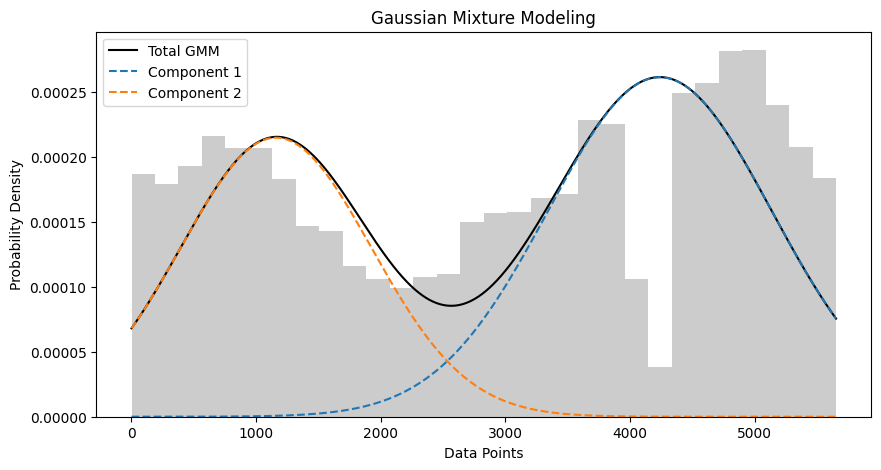

Client 12 - Means: [4239.21895793 1159.96906491]
Client 12 - Covariances: [803867.09088725 584463.67576806]
Client 12 - Weights (priors): [0.58802497 0.41197503]
mean of pdf 2970.644889098203
variance of pdf 3010454.7598601603


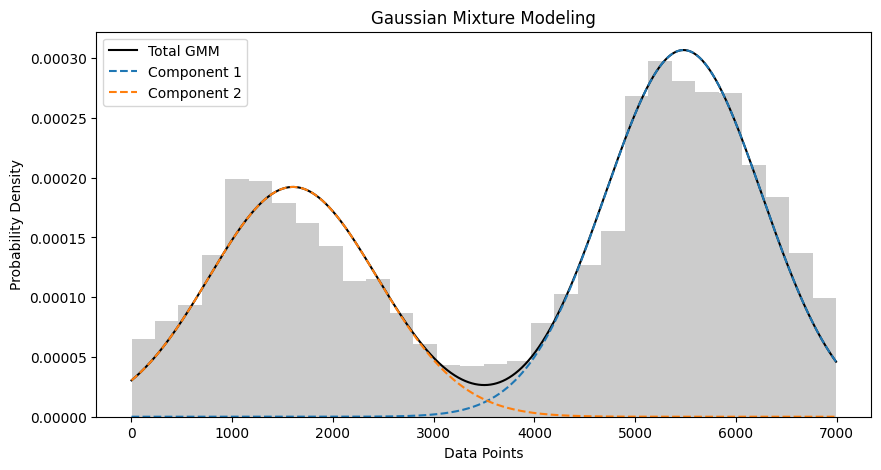

Client 13 - Means: [5480.44039428 1603.85222613]
Client 13 - Covariances: [604098.48389665 696766.58688603]
Client 13 - Weights (priors): [0.59770798 0.40229202]
mean of pdf 3920.919914418353
variance of pdf 4254892.635236015


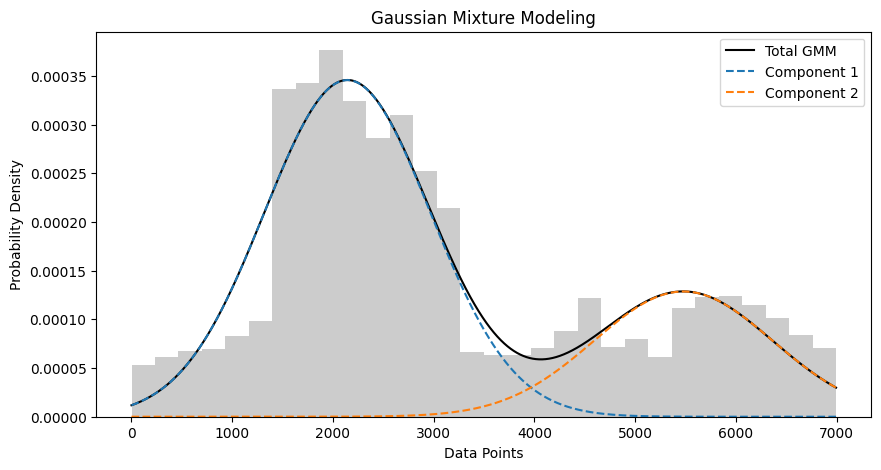

Client 14 - Means: [2143.37338909 5478.84526213]
Client 14 - Covariances: [679292.09586166 786235.86170146]
Client 14 - Weights (priors): [0.71416939 0.28583061]
mean of pdf 3096.7533490599712
variance of pdf 2980898.590417912


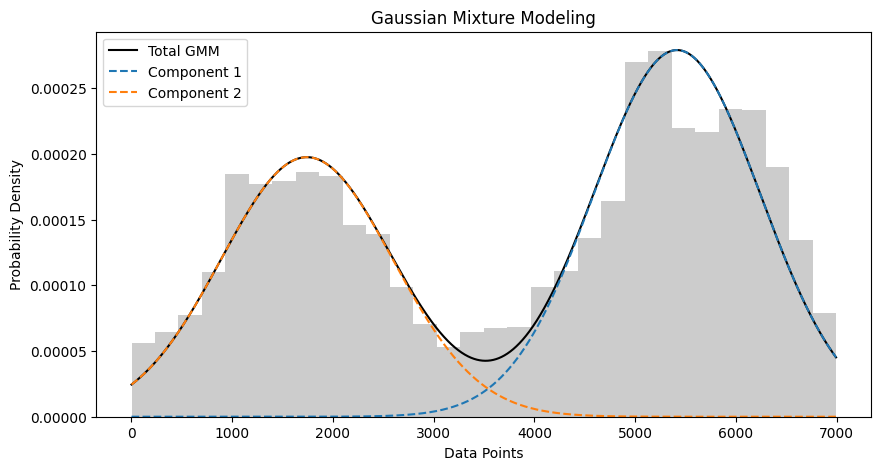

Client 15 - Means: [5415.63347827 1741.91282056]
Client 15 - Covariances: [684302.2769935  725875.67418645]
Client 15 - Weights (priors): [0.5783373 0.4216627]
mean of pdf 3866.562518590843
variance of pdf 3993065.3744750004


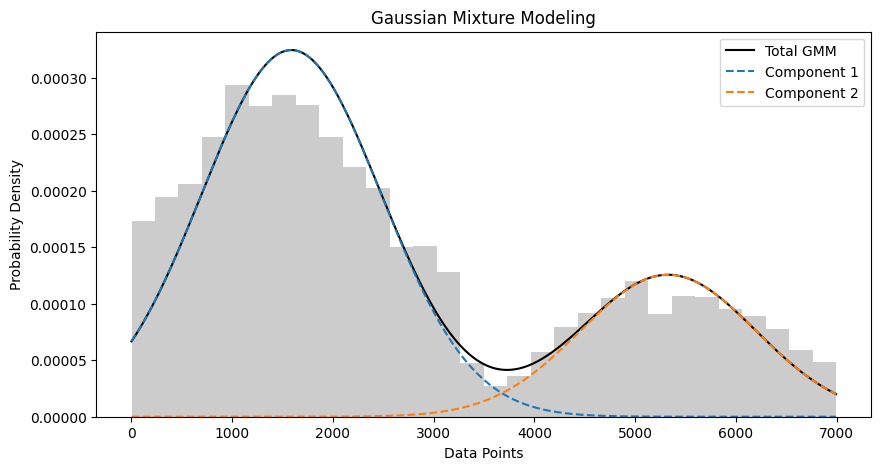

Client 16 - Means: [1587.53323311 5327.81772409]
Client 16 - Covariances: [795718.75419808 757358.38736896]
Client 16 - Weights (priors): [0.72588843 0.27411157]
mean of pdf 2612.7884970909445
variance of pdf 3568801.7405542224


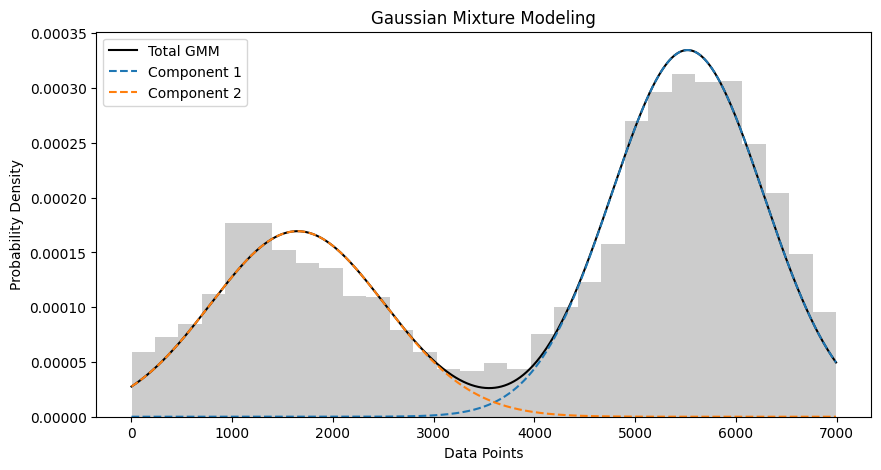

Client 17 - Means: [5520.10204748 1648.7086299 ]
Client 17 - Covariances: [568659.30376342 747835.28874113]
Client 17 - Weights (priors): [0.632799 0.367201]
mean of pdf 4098.522520468013
variance of pdf 4117058.176118551


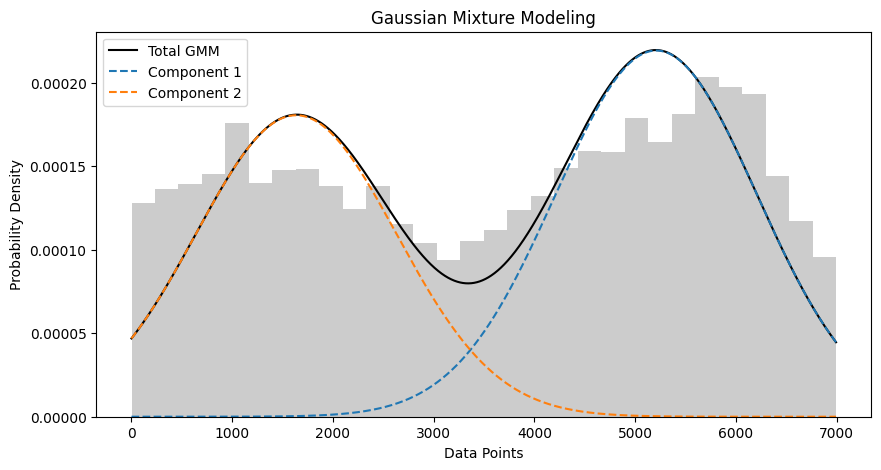

Client 18 - Means: [5209.38728596 1635.36704013]
Client 18 - Covariances: [1000067.27935757  990541.71768332]
Client 18 - Weights (priors): [0.54964958 0.45035042]
mean of pdf 3599.825770818385
variance of pdf 4157694.6096726055


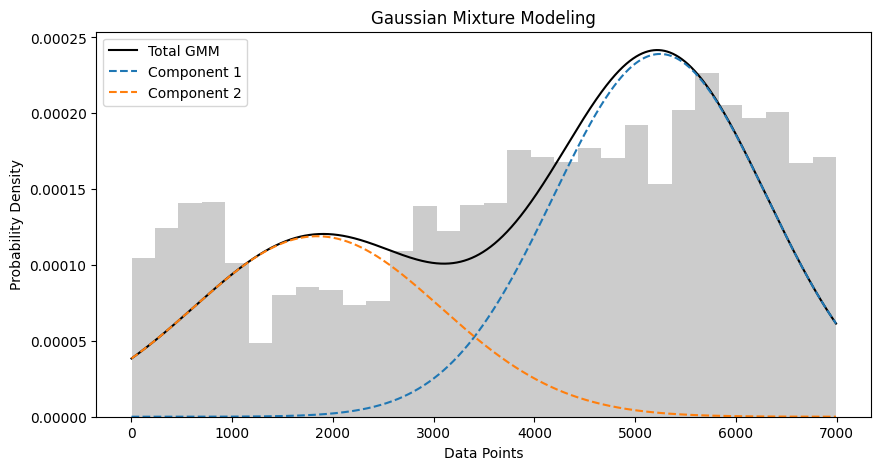

Client 19 - Means: [5247.119698   1842.74366035]
Client 19 - Covariances: [1122289.41177325 1499438.78209945]
Client 19 - Weights (priors): [0.63487641 0.36512359]
mean of pdf 4004.1017139831783
variance of pdf 3946602.4725581096


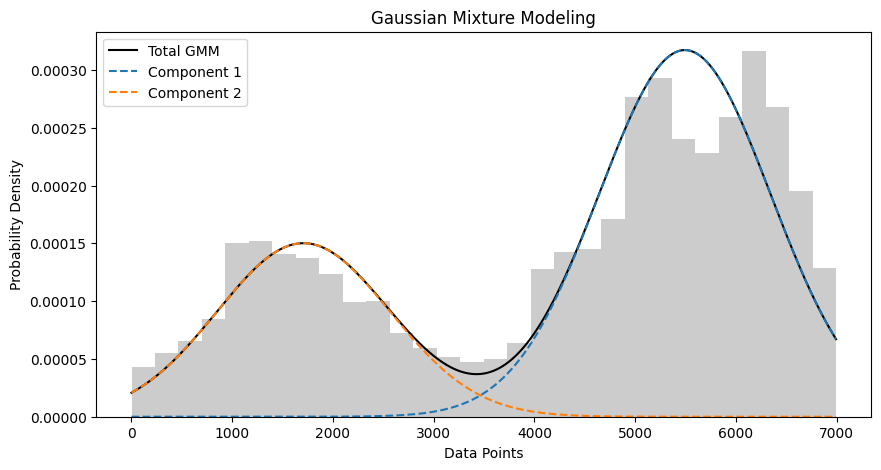

Client 20 - Means: [5493.56761466 1707.79908482]
Client 20 - Covariances: [724707.6613952  736191.86866011]
Client 20 - Weights (priors): [0.67704593 0.32295407]
mean of pdf 4270.938251110161
variance of pdf 3862185.740463901


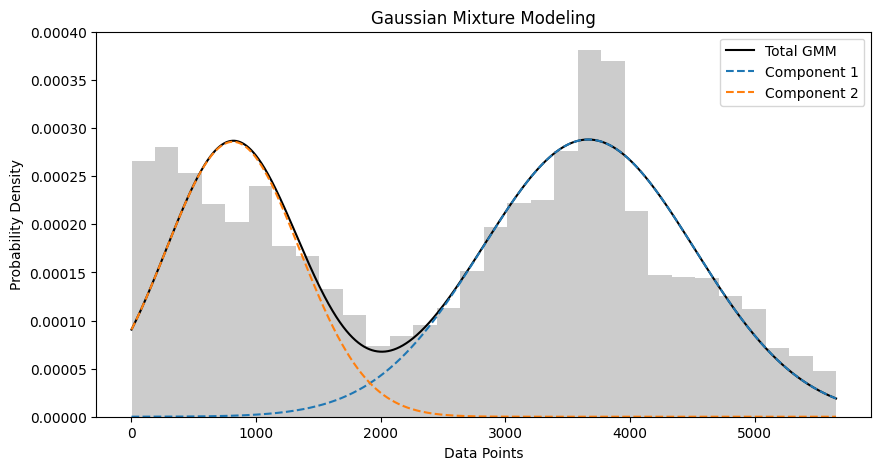

Client 21 - Means: [3664.1546661   814.20600646]
Client 21 - Covariances: [725877.43214806 287740.51288556]
Client 21 - Weights (priors): [0.61559253 0.38440747]
mean of pdf 2568.613122644133
variance of pdf 2479480.2090232535


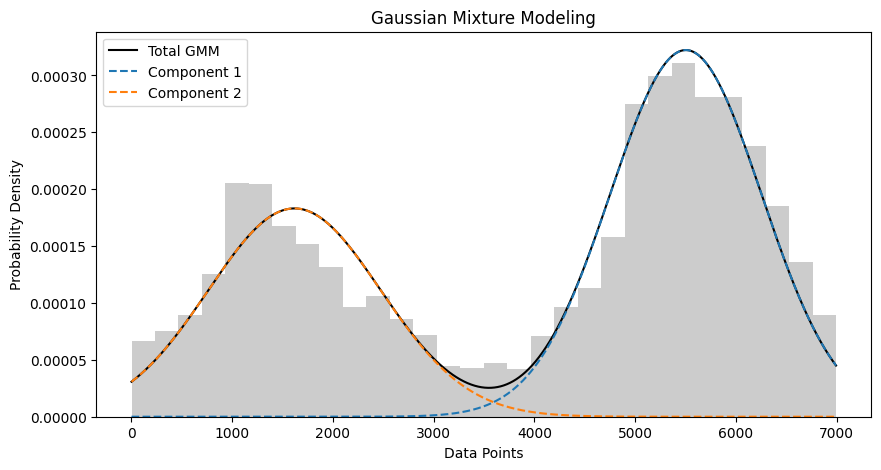

Client 22 - Means: [5503.07928972 1618.7074447 ]
Client 22 - Covariances: [564491.0204014  733368.61930204]
Client 22 - Weights (priors): [0.60695682 0.39304318]
mean of pdf 3976.353441423246
variance of pdf 4230346.292619701


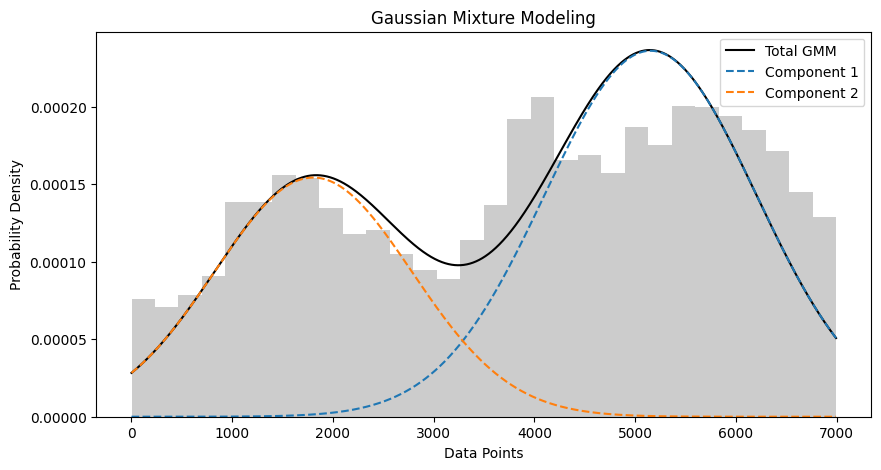

Client 23 - Means: [5152.17561944 1804.64316414]
Client 23 - Covariances: [1103573.54514397  958598.45603998]
Client 23 - Weights (priors): [0.62147274 0.37852726]
mean of pdf 3885.043326734281
variance of pdf 3684838.749468048


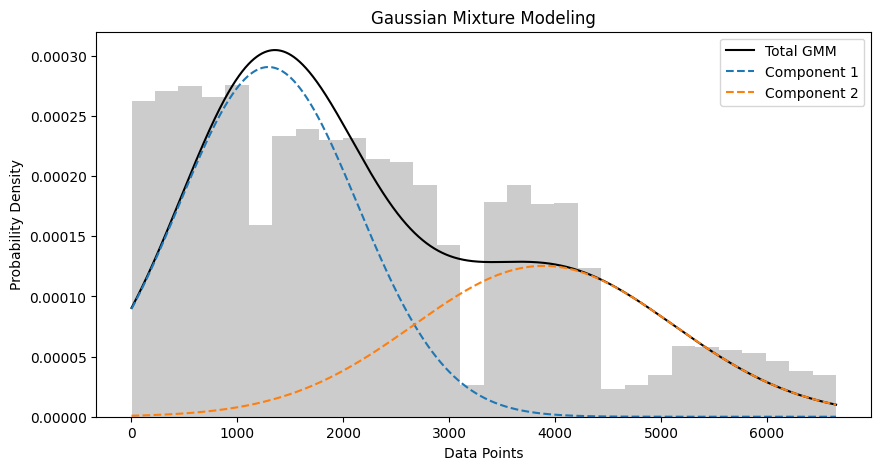

Client 24 - Means: [1293.8075473  3891.30263597]
Client 24 - Covariances: [ 710164.81583042 1508215.82315747]
Client 24 - Weights (priors): [0.61400468 0.38599532]
mean of pdf 2296.4284979825543
variance of pdf 2617262.995071036


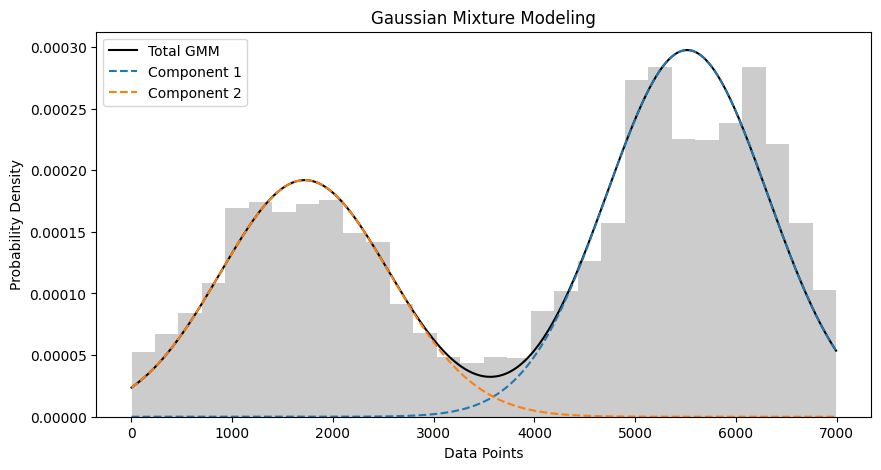

Client 25 - Means: [5516.30727986 1721.55062029]
Client 25 - Covariances: [637096.92586356 707401.39706557]
Client 25 - Weights (priors): [0.59525775 0.40474225]
mean of pdf 3980.408935269449
variance of pdf 4134928.8622844187


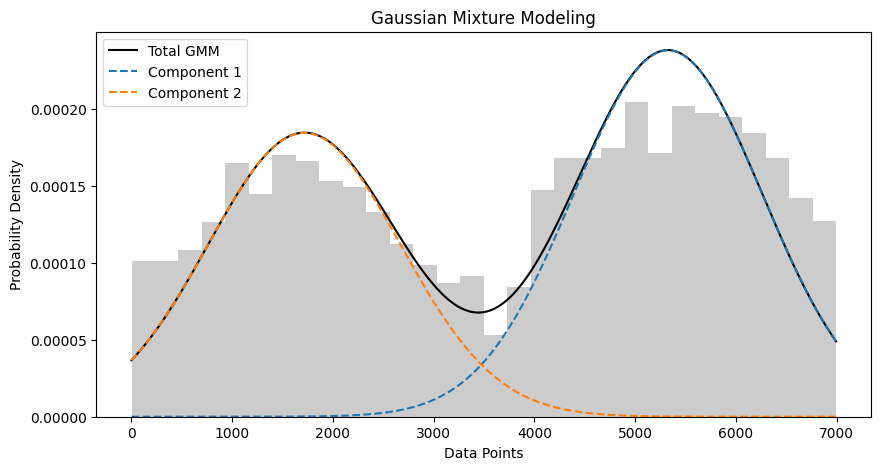

Client 26 - Means: [5326.395412   1716.44604639]
Client 26 - Covariances: [879961.47959852 911584.91992072]
Client 26 - Weights (priors): [0.55916196 0.44083804]
mean of pdf 3734.9924271252885
variance of pdf 4106223.0302970437


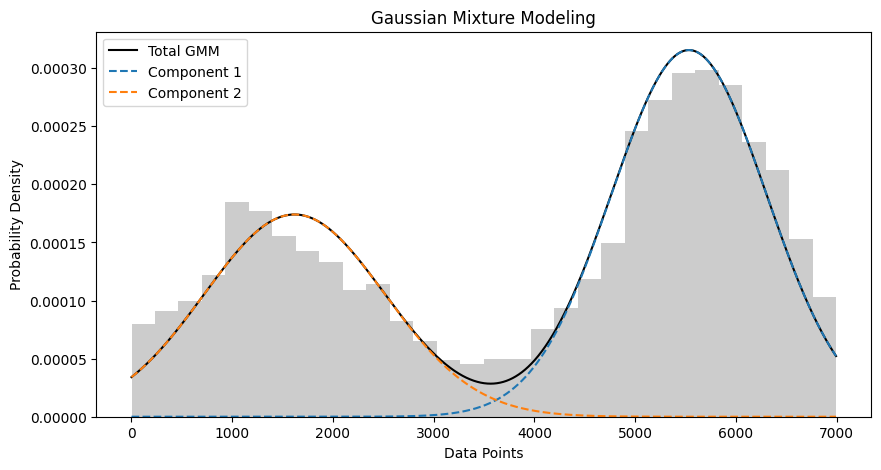

Client 27 - Means: [5533.91696194 1619.11854322]
Client 27 - Covariances: [592685.08607148 802793.10374936]
Client 27 - Weights (priors): [0.60902073 0.39097927]
mean of pdf 4003.3119299143536
variance of pdf 4324091.360656537


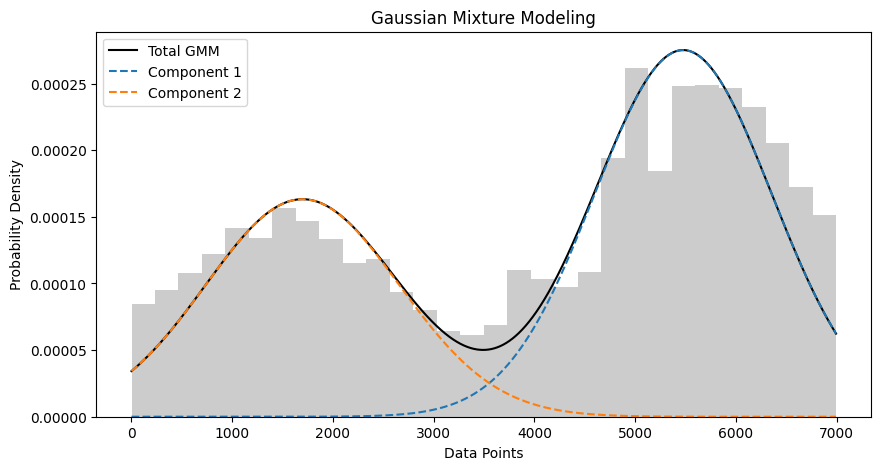

Client 28 - Means: [5476.73628904 1697.37326409]
Client 28 - Covariances: [775554.78765152 921351.73096198]
Client 28 - Weights (priors): [0.60727975 0.39272025]
mean of pdf 3992.5039111919486
variance of pdf 4239319.416945971


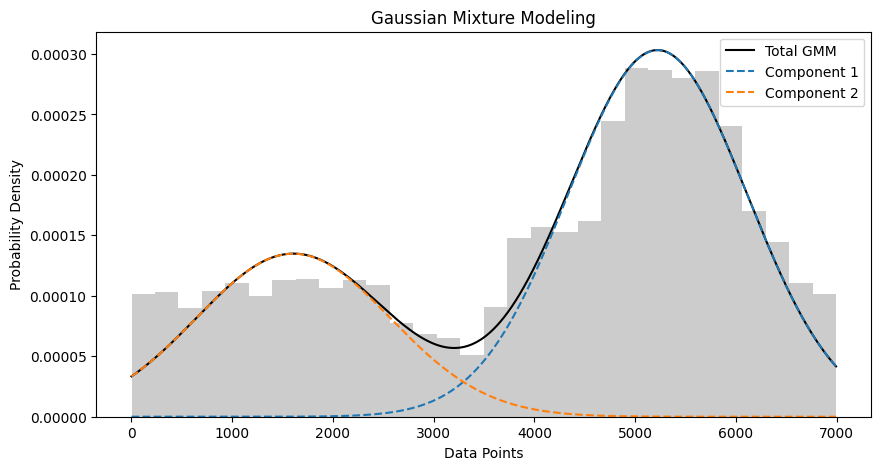

Client 29 - Means: [5222.9358151 1606.7399454]
Client 29 - Covariances: [790191.50789488 923066.05278478]
Client 29 - Weights (priors): [0.67535752 0.32464248]
mean of pdf 4048.9650214080466
variance of pdf 3700429.1404814576


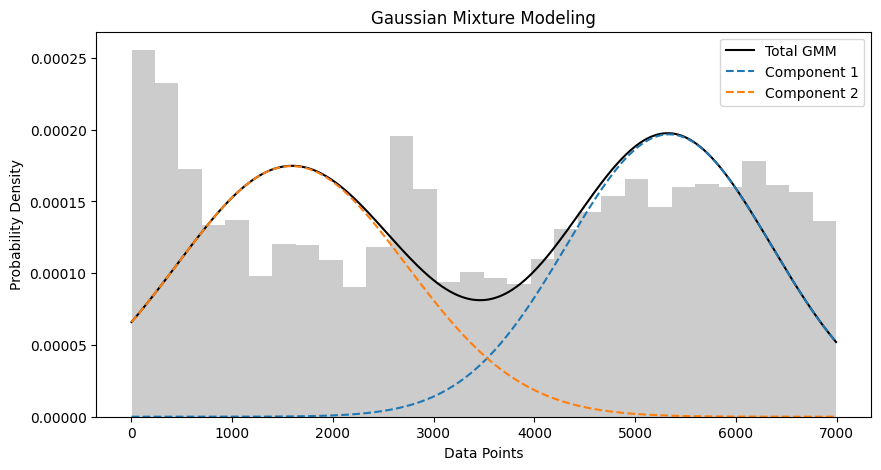

Client 30 - Means: [5335.48028515 1589.2498097 ]
Client 30 - Covariances: [1034277.33472826 1296102.05028839]
Client 30 - Weights (priors): [0.50164865 0.49835135]
mean of pdf 3468.541277157549
variance of pdf 4673280.582695404


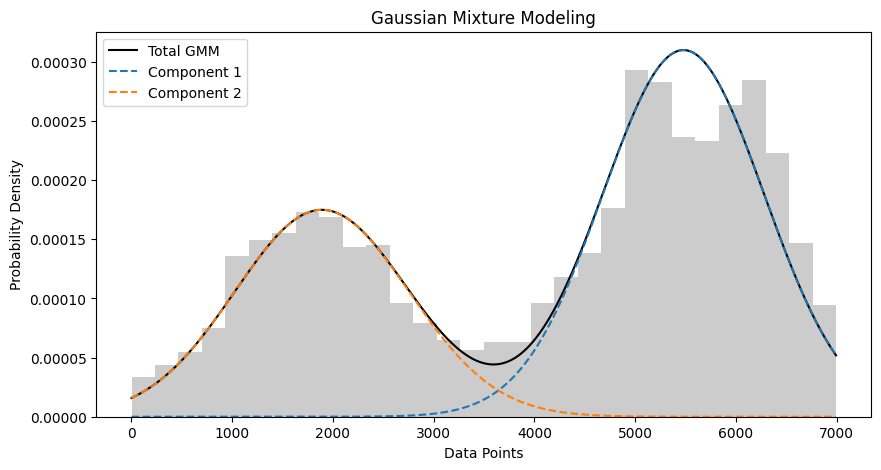

Client 31 - Means: [5480.18749865 1890.6328342 ]
Client 31 - Covariances: [640984.03152982 743530.92345626]
Client 31 - Weights (priors): [0.62197308 0.37802692]
mean of pdf 4123.239207226875
variance of pdf 3709280.920482078


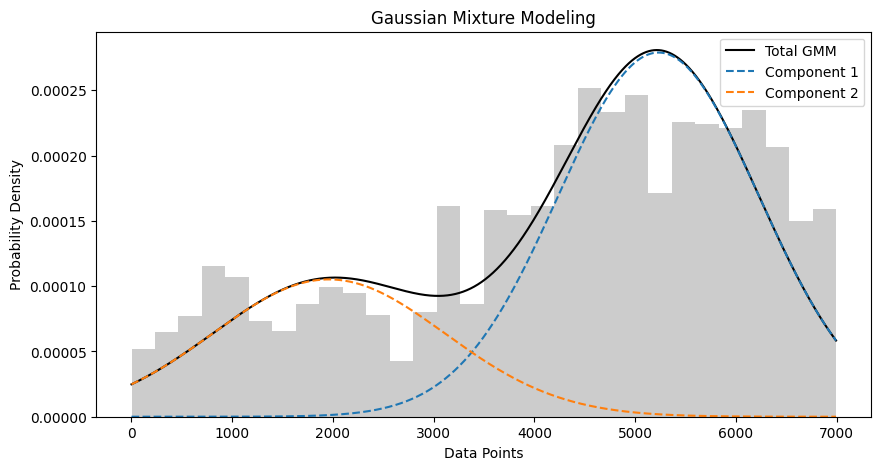

Client 32 - Means: [5231.98180948 1959.50236984]
Client 32 - Covariances: [ 992173.12304202 1328365.69241178]
Client 32 - Weights (priors): [0.69624008 0.30375992]
mean of pdf 4237.93372599712
variance of pdf 3359165.2730117077


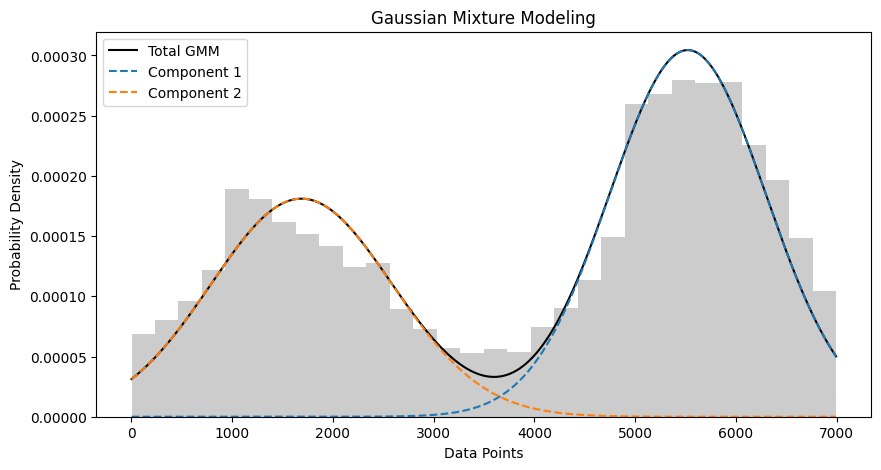

Client 33 - Means: [5522.21115119 1688.17113962]
Client 33 - Covariances: [600693.05272871 810742.05996466]
Client 33 - Weights (priors): [0.59138949 0.40861051]
mean of pdf 3955.582094633478
variance of pdf 4238713.170644175


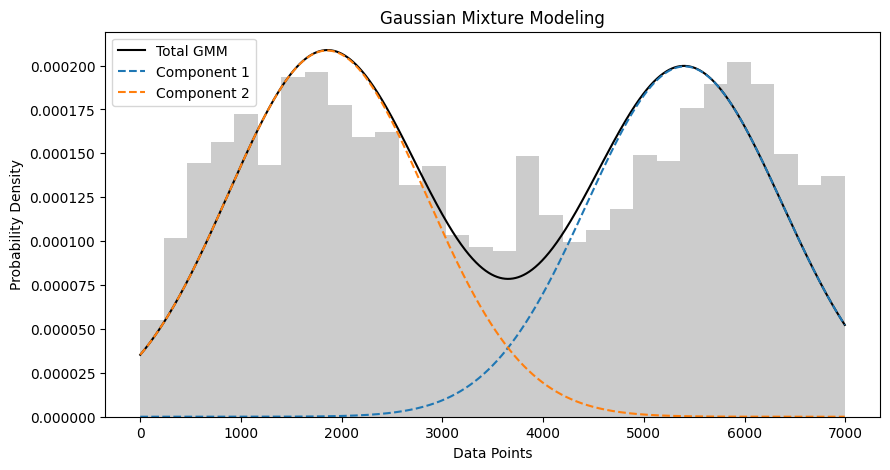

Client 34 - Means: [5403.54100473 1854.37011021]
Client 34 - Covariances: [944487.38415497 966327.00528329]
Client 34 - Weights (priors): [0.48603678 0.51396322]
mean of pdf 3579.397690735339
variance of pdf 4102409.673702857


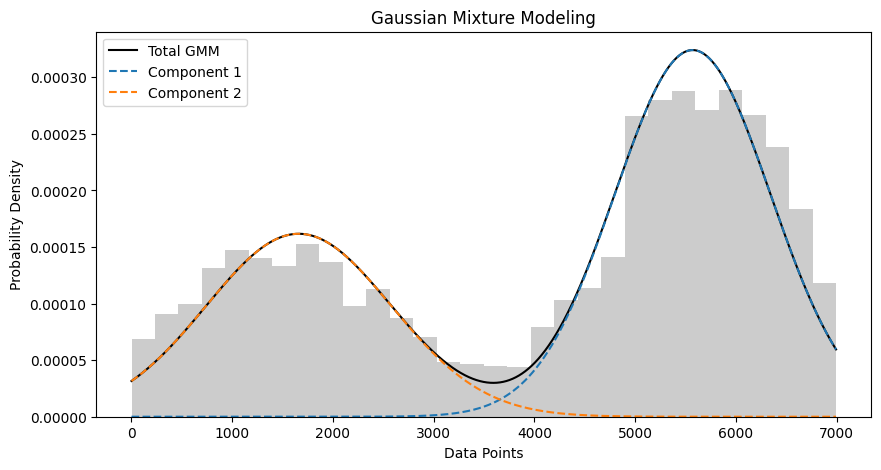

Client 35 - Means: [5570.78776174 1660.53872786]
Client 35 - Covariances: [597563.19001282 842894.76200389]
Client 35 - Weights (priors): [0.62790857 0.37209143]
mean of pdf 4115.817605420939
variance of pdf 4261206.457851826


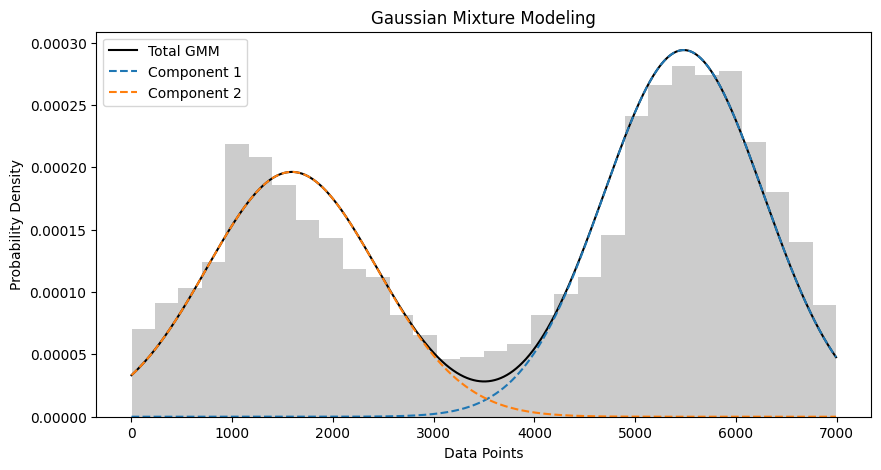

Client 36 - Means: [5482.17379352 1592.51311165]
Client 36 - Covariances: [628788.64560547 713934.38996233]
Client 36 - Weights (priors): [0.58429965 0.41570035]
mean of pdf 3865.240499517695
variance of pdf 4339032.342694195


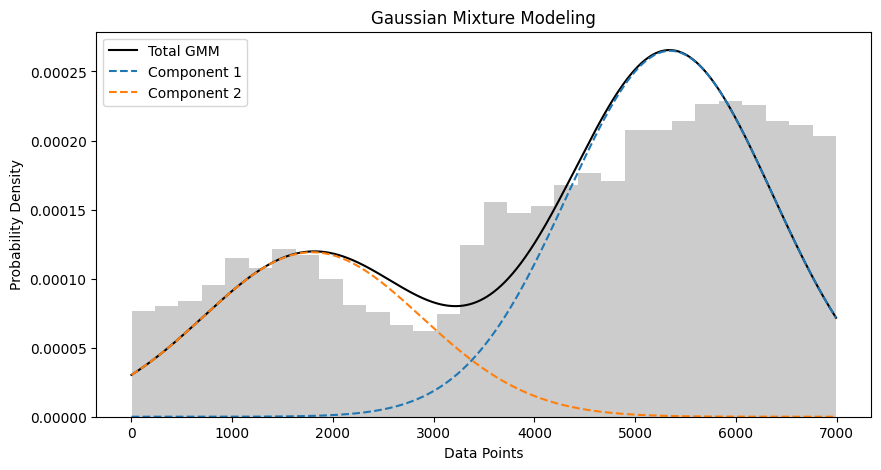

Client 37 - Means: [5347.04854735 1794.38042441]
Client 37 - Covariances: [1037567.30543803 1174491.47640245]
Client 37 - Weights (priors): [0.67646781 0.32353219]
mean of pdf 4197.646050792279
variance of pdf 3844186.1931226384


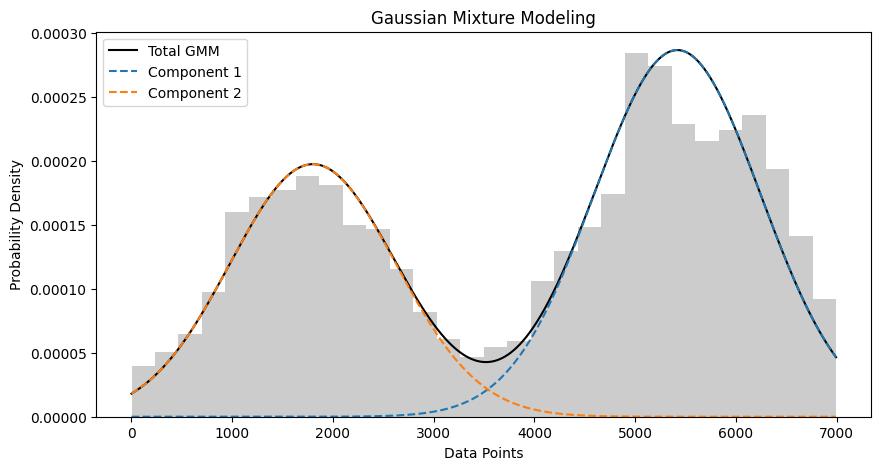

Client 38 - Means: [5418.87675449 1801.28094474]
Client 38 - Covariances: [682421.09513084 677263.70988639]
Client 38 - Weights (priors): [0.59305239 0.40694761]
mean of pdf 3946.7048011351876
variance of pdf 3838755.1390060657


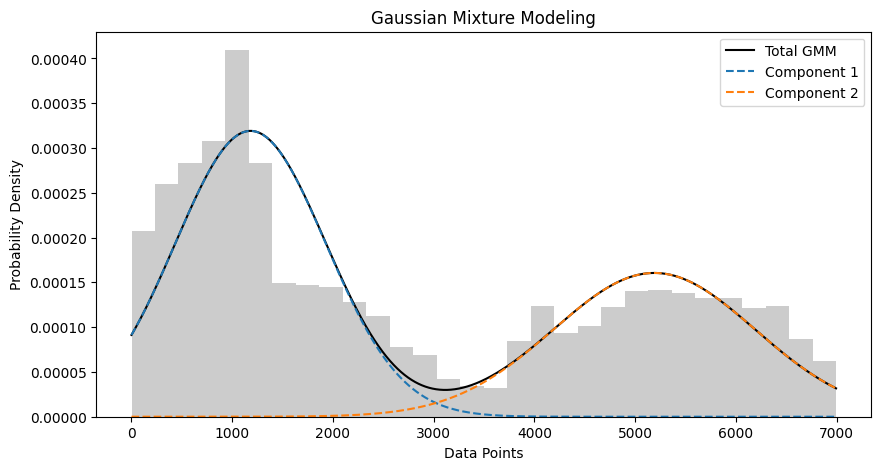

Client 39 - Means: [1182.15030105 5190.42992885]
Client 39 - Covariances: [ 557548.28951931 1002484.4028176 ]
Client 39 - Weights (priors): [0.59717775 0.40282225]
mean of pdf 2796.7745370550856
variance of pdf 4601632.465981757


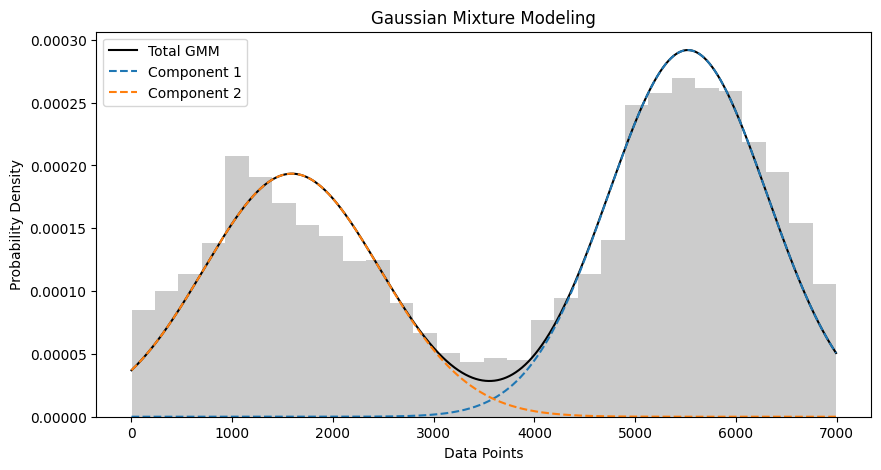

Client 40 - Means: [5522.64000523 1592.81626404]
Client 40 - Covariances: [618776.12360527 765896.66157884]
Client 40 - Weights (priors): [0.57553969 0.42446031]
mean of pdf 3854.585795731211
variance of pdf 4453977.141239565


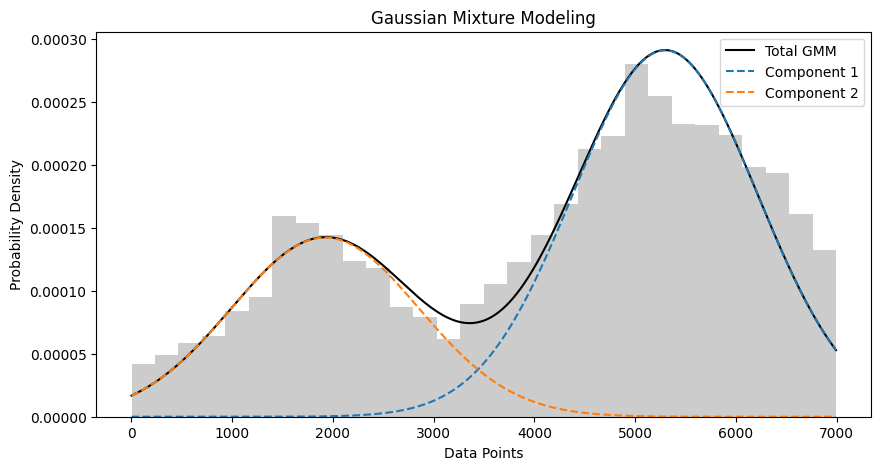

Client 41 - Means: [5298.27657537 1922.19541569]
Client 41 - Covariances: [842929.54298208 863606.07005378]
Client 41 - Weights (priors): [0.6689964 0.3310036]
mean of pdf 4180.781563787942
variance of pdf 3373732.3015629672


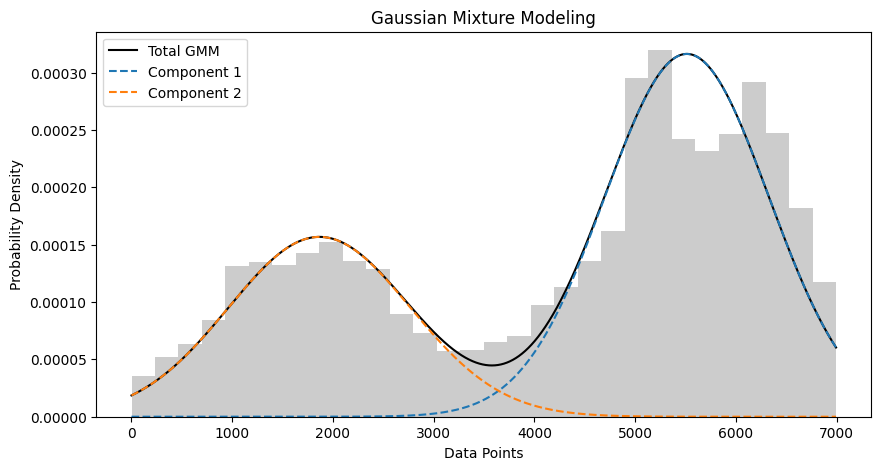

Client 42 - Means: [5513.24382196 1866.22882988]
Client 42 - Covariances: [661936.70768378 815683.06798359]
Client 42 - Weights (priors): [0.64503574 0.35496426]
mean of pdf 4218.683857540563
variance of pdf 3761905.2670205534


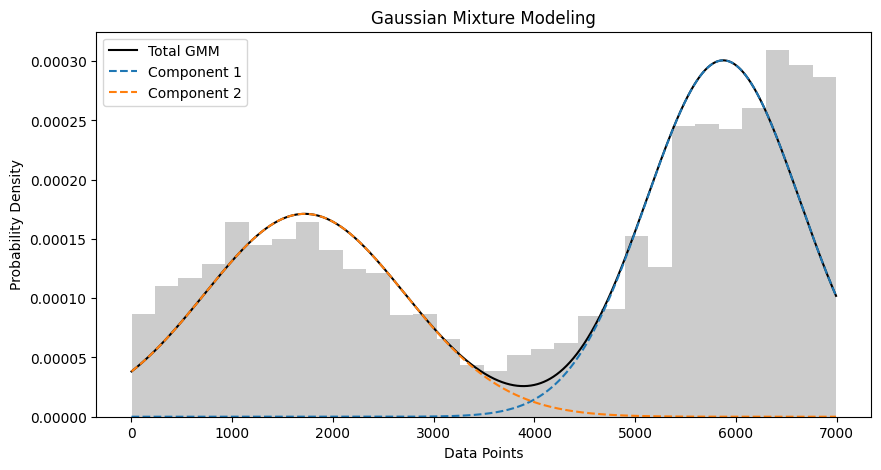

Client 43 - Means: [5873.91240457 1720.53843297]
Client 43 - Covariances: [580186.8501931  985625.95257732]
Client 43 - Weights (priors): [0.57403113 0.42596887]
mean of pdf 4104.704372677756
variance of pdf 4970976.817789503


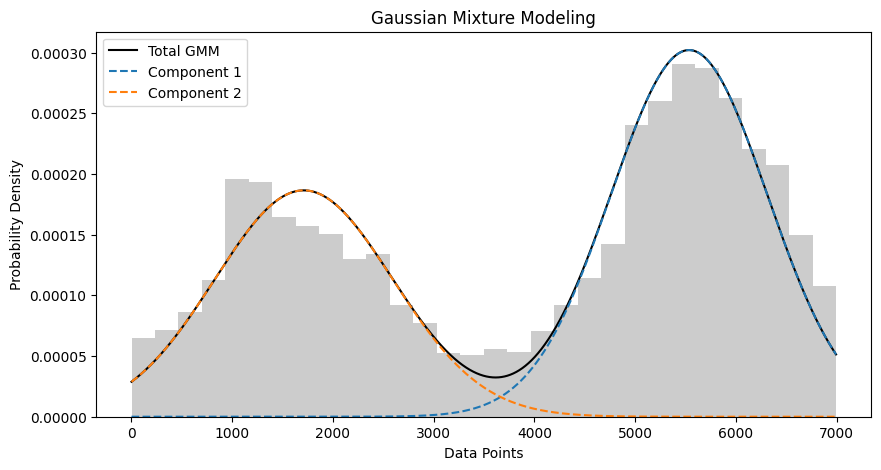

Client 44 - Means: [5535.39471969 1710.45340335]
Client 44 - Covariances: [600296.567986   782033.76834714]
Client 44 - Weights (priors): [0.58662639 0.41337361]
mean of pdf 3954.2649221436795
variance of pdf 4223179.1828952115


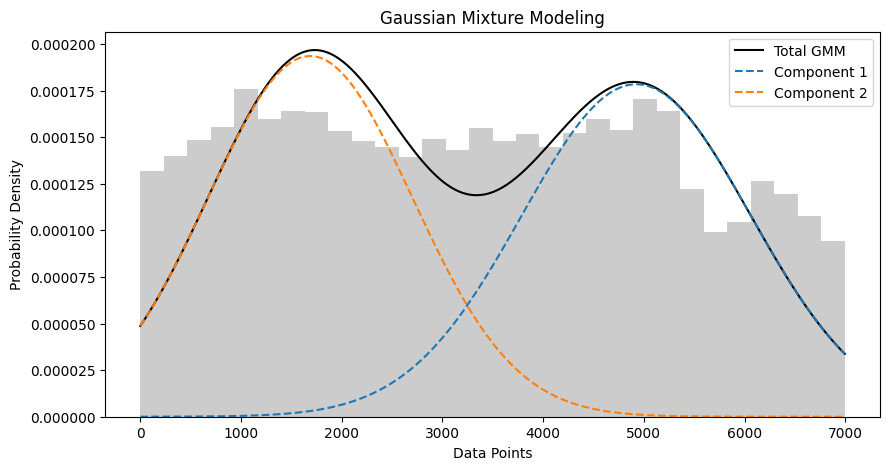

Client 45 - Means: [4923.96955117 1688.17103981]
Client 45 - Covariances: [1286445.05429424 1031730.90464274]
Client 45 - Weights (priors): [0.5072325 0.4927675]
mean of pdf 3329.4732059768285
variance of pdf 3777980.5046800934


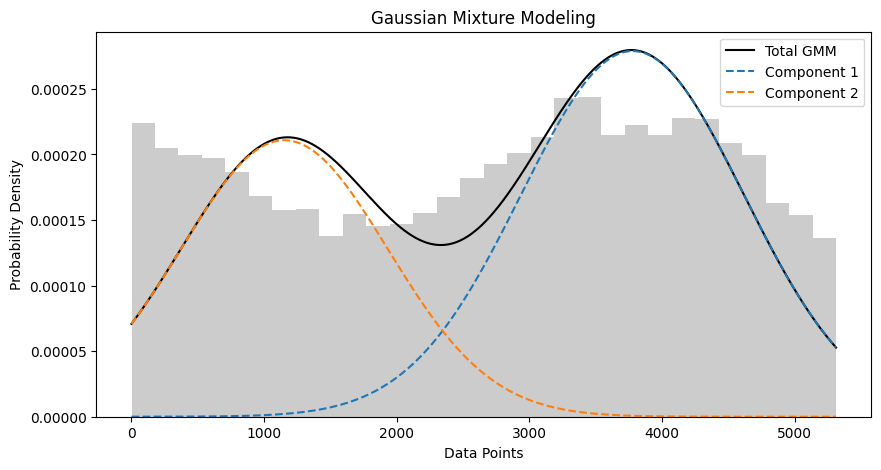

Client 46 - Means: [3776.61837552 1152.81735676]
Client 46 - Covariances: [706827.10125776 608130.96212889]
Client 46 - Weights (priors): [0.58778185 0.41221815]
mean of pdf 2695.0399865292306
variance of pdf 2334177.4292275333


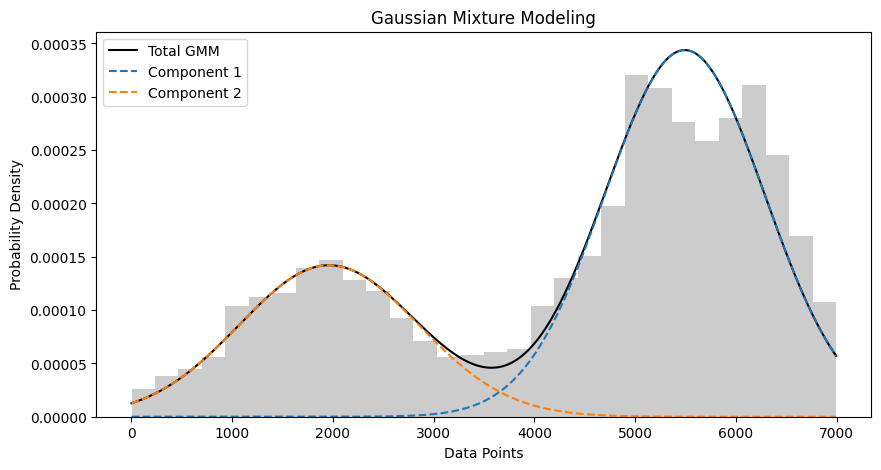

Client 47 - Means: [5492.71507337 1960.85651291]
Client 47 - Covariances: [628290.48006013 793390.09106521]
Client 47 - Weights (priors): [0.68289283 0.31710717]
mean of pdf 4372.737405900695
variance of pdf 3381897.486956015


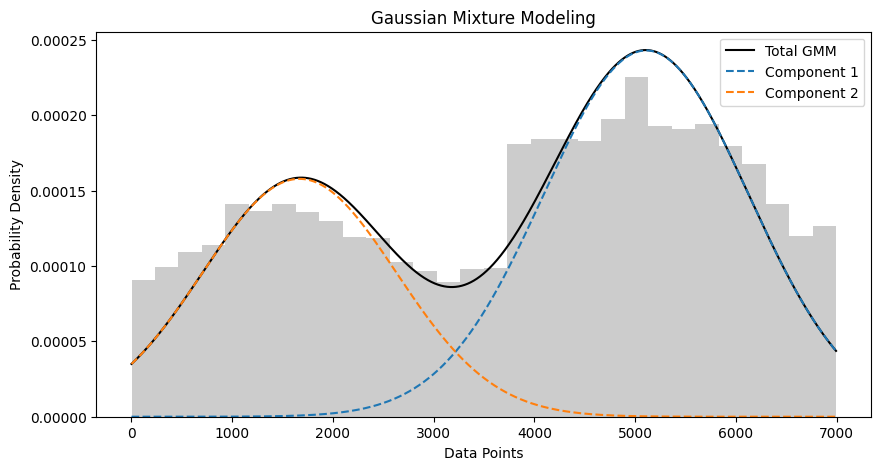

Client 48 - Means: [5108.95889056 1668.14467411]
Client 48 - Covariances: [1035157.27274919  923019.70103695]
Client 48 - Weights (priors): [0.61987125 0.38012875]
mean of pdf 3801.0064678788294
variance of pdf 3782212.3076956933


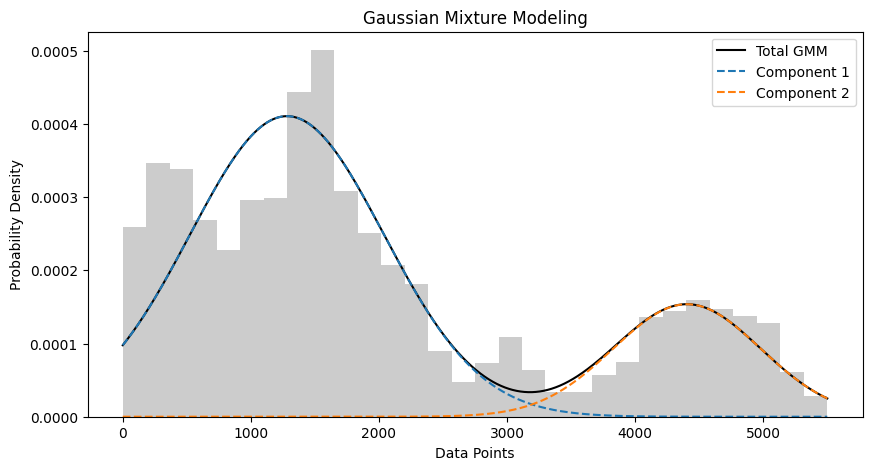

Client 49 - Means: [1282.56443818 4403.86805695]
Client 49 - Covariances: [571923.2105731  330106.03195283]
Client 49 - Weights (priors): [0.77862075 0.22137925]
mean of pdf 1973.5563063454556
variance of pdf 2197715.5606104992


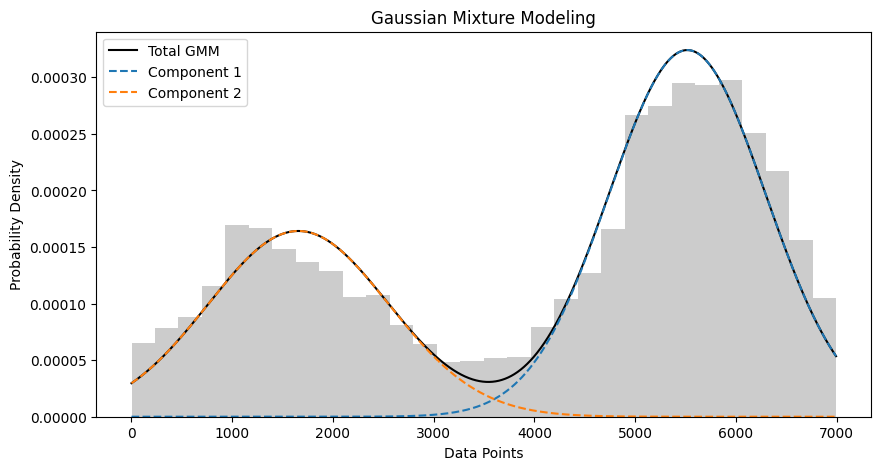

Client 50 - Means: [5518.07312263 1657.31786867]
Client 50 - Covariances: [604919.92270297 801298.79046422]
Client 50 - Weights (priors): [0.63169075 0.36830925]
mean of pdf 4096.121237088798
variance of pdf 4145109.125089369


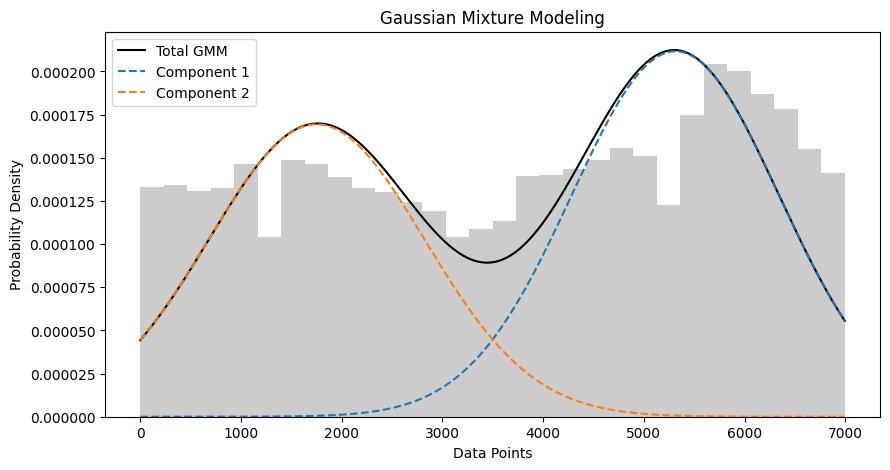

Client 51 - Means: [5311.81925659 1752.40303861]
Client 51 - Covariances: [1057469.55008011 1145462.03160417]
Client 51 - Weights (priors): [0.54569716 0.45430284]
mean of pdf 3694.7663553093516
variance of pdf 4238349.021067575


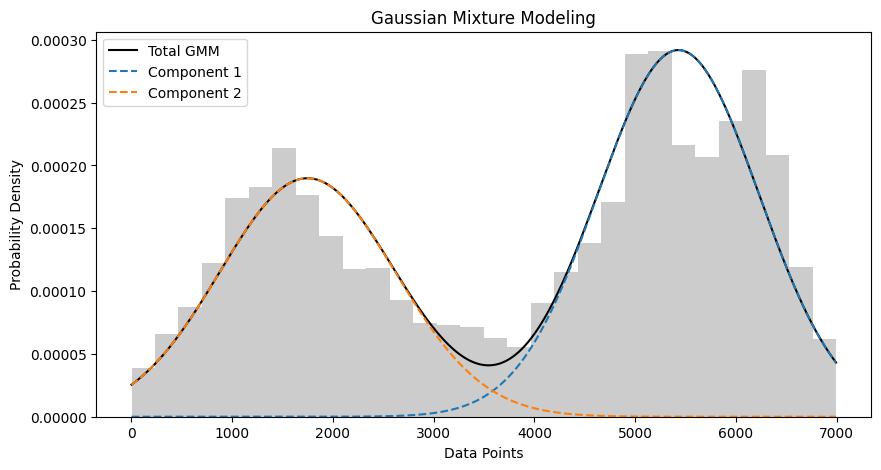

Client 52 - Means: [5429.39172588 1747.69783896]
Client 52 - Covariances: [640455.24862745 759772.47846425]
Client 52 - Weights (priors): [0.5853181 0.4146819]
mean of pdf 3902.659924538428
variance of pdf 3979983.090453807


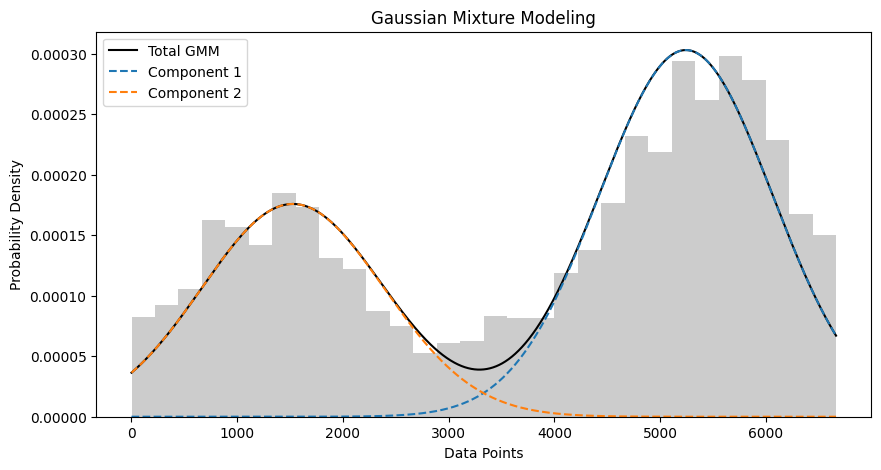

Client 53 - Means: [5243.72356052 1527.03217695]
Client 53 - Covariances: [668390.06204281 739315.09425708]
Client 53 - Weights (priors): [0.62100978 0.37899022]
mean of pdf 3835.1338892279746
variance of pdf 3946438.1875476385


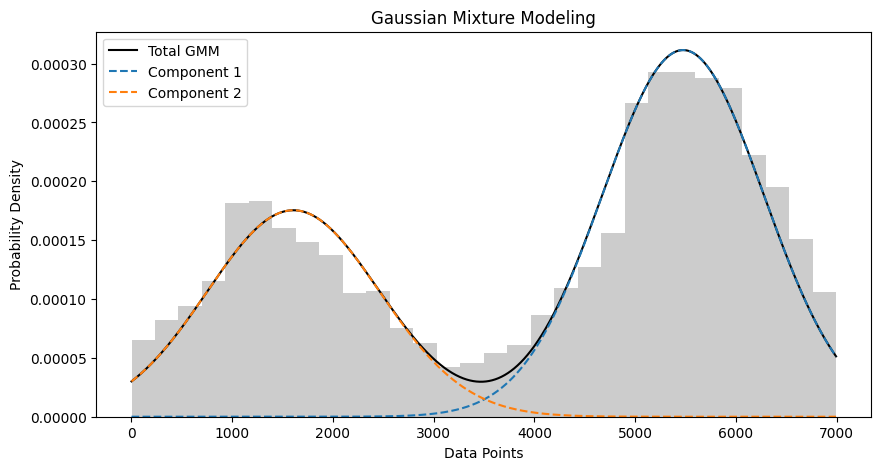

Client 54 - Means: [5475.97776898 1607.59244805]
Client 54 - Covariances: [638761.07802112 731055.61617698]
Client 54 - Weights (priors): [0.62404786 0.37595214]
mean of pdf 4021.6500300061325
variance of pdf 4184290.312059844


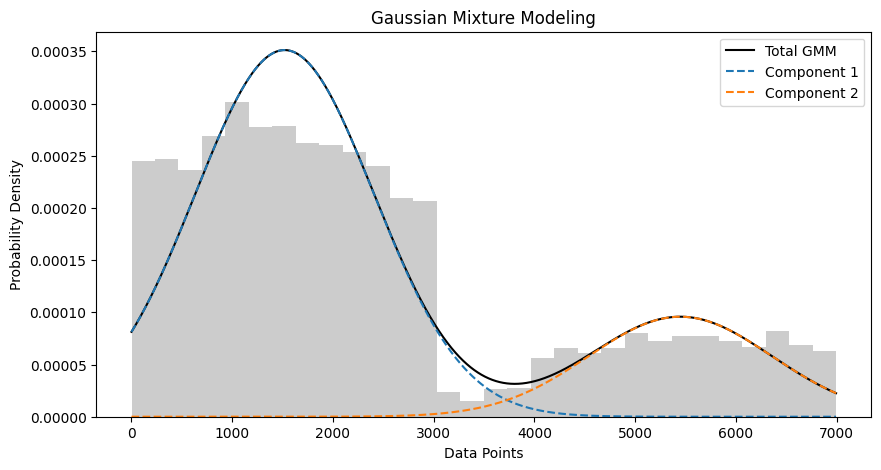

Client 55 - Means: [1520.05339995 5448.51016105]
Client 55 - Covariances: [788709.18375661 825313.39732754]
Client 55 - Weights (priors): [0.78185485 0.21814515]
mean of pdf 2377.02718127977
variance of pdf 3428874.5988047426


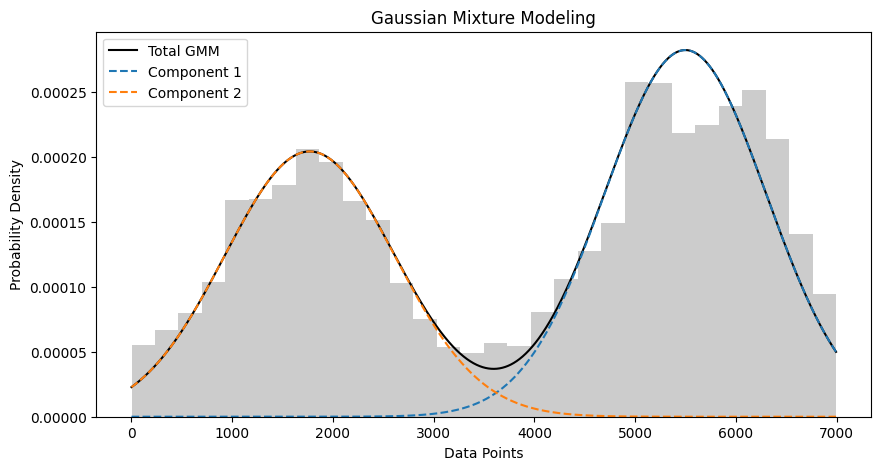

Client 56 - Means: [5498.14998355 1769.2871122 ]
Client 56 - Covariances: [646055.40704739 713139.21618564]
Client 56 - Weights (priors): [0.56813725 0.43186275]
mean of pdf 3887.7930082924304
variance of pdf 4086577.152268512


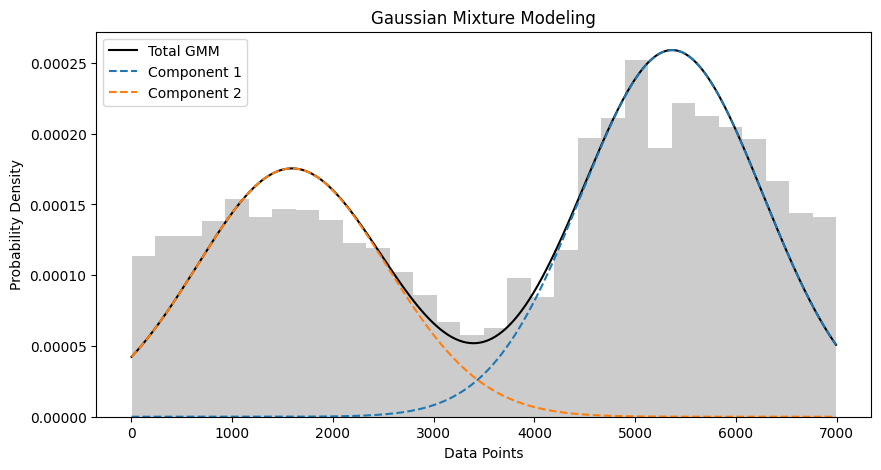

Client 57 - Means: [5367.54366976 1592.84371807]
Client 57 - Covariances: [811956.5705165  891007.24844929]
Client 57 - Weights (priors): [0.58498797 0.41501203]
mean of pdf 3800.9977780608365
variance of pdf 4303938.22378872


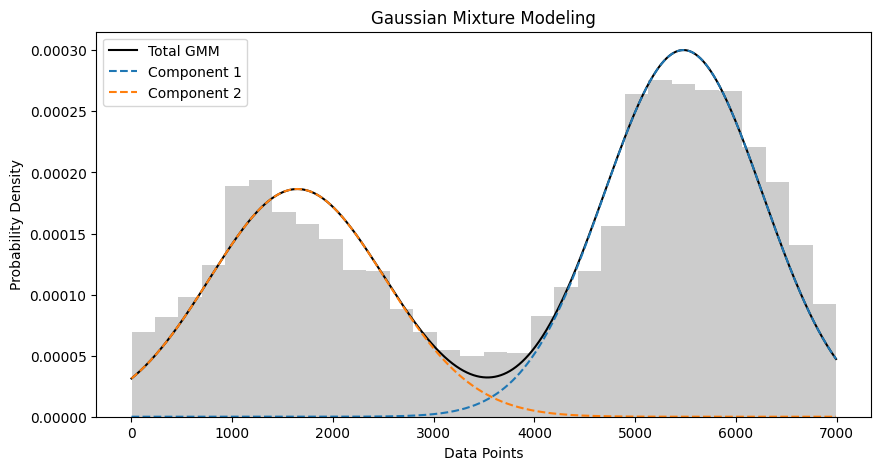

Client 58 - Means: [5479.35442814 1647.42347795]
Client 58 - Covariances: [620511.10925512 759782.31400624]
Client 58 - Weights (priors): [0.59270944 0.40729056]
mean of pdf 3918.645124738203
variance of pdf 4221951.7105014175


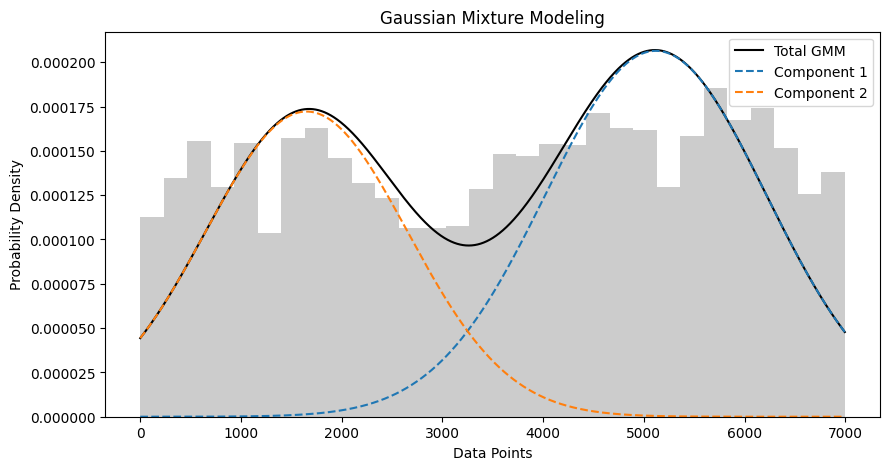

Client 59 - Means: [5118.11746058 1651.49860926]
Client 59 - Covariances: [1202461.01437009 1003965.35029279]
Client 59 - Weights (priors): [0.56747621 0.43252379]
mean of pdf 3618.722351971464
variance of pdf 4066252.5756784338


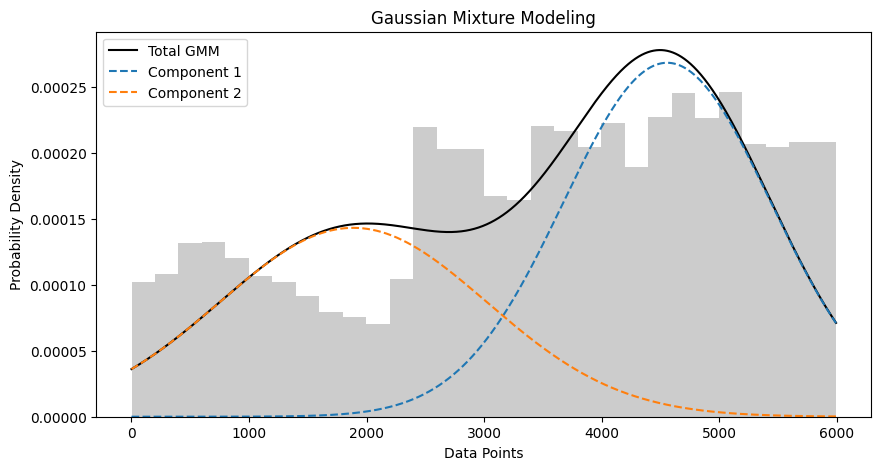

Client 60 - Means: [4556.19516412 1887.12044145]
Client 60 - Covariances: [ 776085.68741727 1291074.11437101]
Client 60 - Weights (priors): [0.59232463 0.40767537]
mean of pdf 3468.079137961089
variance of pdf 2706300.279486863


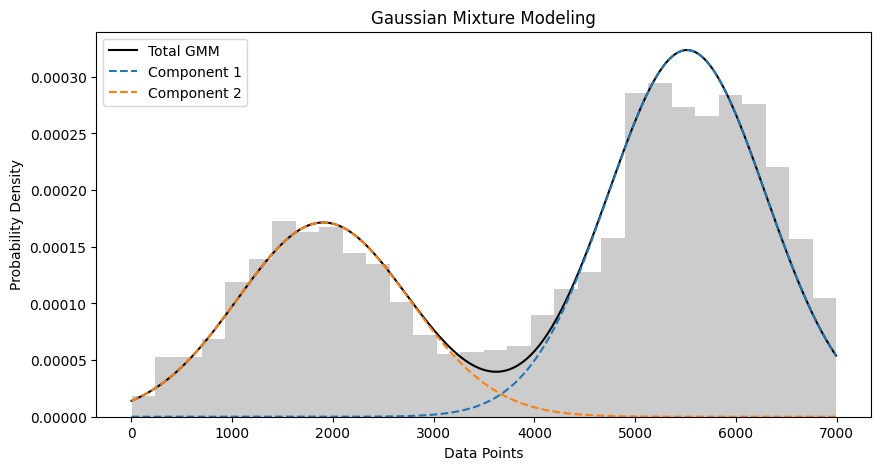

Client 61 - Means: [5514.35969567 1904.72413335]
Client 61 - Covariances: [611187.57611982 724437.57236372]
Client 61 - Weights (priors): [0.63420139 0.36579861]
mean of pdf 4193.960027171025
variance of pdf 3675320.5825589024


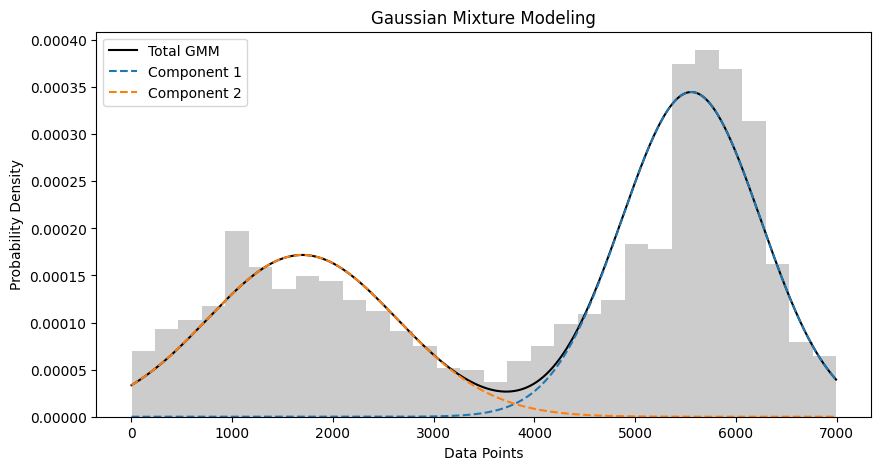

Client 62 - Means: [5557.35974322 1696.24445618]
Client 62 - Covariances: [475982.020691   879152.86534263]
Client 62 - Weights (priors): [0.59624703 0.40375297]
mean of pdf 3998.422985698638
variance of pdf 4227714.177929467


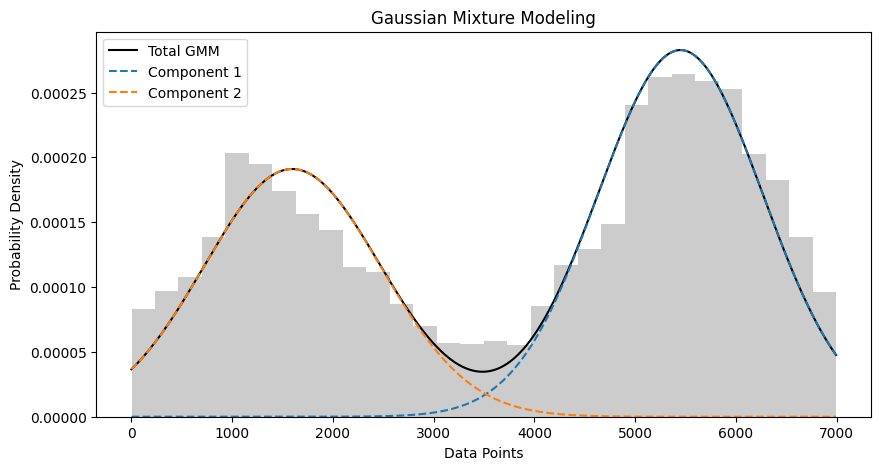

Client 63 - Means: [5450.02822245 1596.79510722]
Client 63 - Covariances: [669022.84710801 770734.9702078 ]
Client 63 - Weights (priors): [0.57966649 0.42033351]
mean of pdf 3830.3852282628045
variance of pdf 4329394.45209803


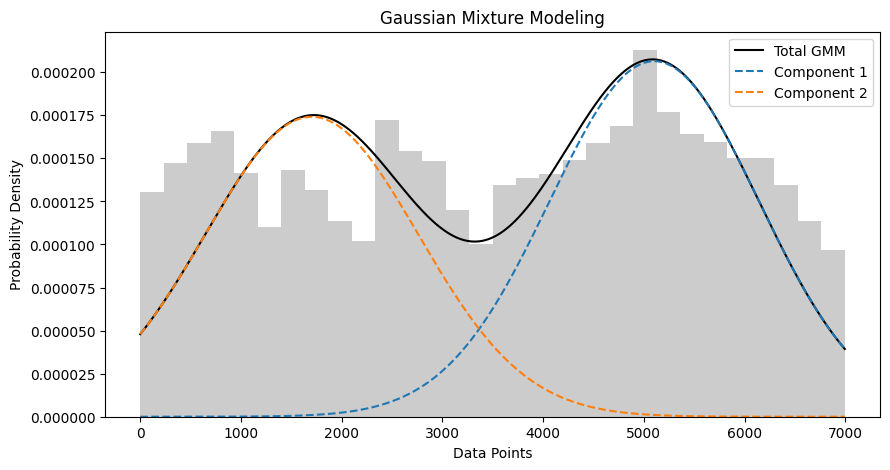

Client 64 - Means: [5102.65701063 1702.93299101]
Client 64 - Covariances: [1078796.5282513  1123144.78847454]
Client 64 - Weights (priors): [0.53744122 0.46255878]
mean of pdf 3530.084830680276
variance of pdf 3972638.356824548


In [55]:
import numpy as np
import pandas as pd
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt
import csv

# Assuming 'data' is your DataFrame containing all the clients' information
def process_client(client_id, data):
    client_data = data.loc[data['client_id'] == client_id, ['datetime', 'target']]
    client_data['sample'] = range(1, len(client_data) + 1)
    
    client_target = client_data['target']
    target_sample = client_data['sample']
    
    vector = [sample for target, sample in zip(client_target, target_sample) for _ in range(int(target))]
    x = np.array(vector).reshape(-1, 1)
    
    gmm = GaussianMixture(n_components=2, random_state=0)
    gmm.fit(x)
    
    return gmm, x


def calculate_gmm_statistics(gmm):
    # Extract means, covariances (variances), and weights from the GMM model
    means = gmm.means_.flatten()  # Flatten means for easier calculations
    variances = gmm.covariances_.flatten()  # Flatten variances for easier calculations
    weights = gmm.weights_.flatten()  # Flatten weights for easier calculations
    
    # Calculate the weighted mean
    weighted_mean = np.dot(weights, means)
    
    # Calculate the weighted variance
    weighted_variance = np.dot(weights, variances) + np.dot(weights, (means - weighted_mean)**2)
    
    return weighted_mean, weighted_variance

# Example usage:
# Assume `gmm` is the GaussianMixture model fitted in your process_client function
weighted_mean, weighted_variance = calculate_gmm_statistics(gmm)
print("Weighted Mean:", weighted_mean)
print("Weighted Variance:", weighted_variance)

# Plotting function for GMM
def plot_gmm(gmm, x):
    logprob = gmm.score_samples(x)
    responsibilities = gmm.predict_proba(x)
    pdf = np.exp(logprob)
    pdf_individual = responsibilities * pdf[:, np.newaxis]

    plt.figure(figsize=(10, 5))
    plt.hist(x, bins=30, density=True, alpha=0.4, color='gray')
    plt.plot(x.flatten(), pdf, '-k', label="Total GMM")
    for i in range(2):
        plt.plot(x.flatten(), pdf_individual[:, i], '--', label=f"Component {i+1}")
    plt.legend()
    plt.title('Gaussian Mixture Modeling')
    plt.xlabel('Data Points')
    plt.ylabel('Probability Density')
    plt.show()
# Function to save GMM parameters to CSV
def save_gmm_params_to_csv1(filename, data):
    with open(filename, 'w', newline='') as csvfile:
        # Create a CSV writer object
        writer = csv.writer(csvfile)
        # Write the header
        writer.writerow(['client_id', 'mean', 'covariance', 'weight','mean_pdf','covariance_pdf'])

        # Process each client_id and extract GMM parameters
        for client_id in range(1, 65):
            gmm, x = process_client(client_id, data)
            mean_pdf,variance_pdf=calculate_gmm_statistics(gmm)
            # Retrieve means, covariances, and weights
            means = gmm.means_
            covariances = gmm.covariances_
            weights = gmm.weights_

            # Write GMM parameters to CSV for each client
            for i in range(means.shape[0]):
                mean_str = ','.join(map(str, means[i].flatten()))
                covariance_str = ','.join(map(str, covariances[i].flatten()))
                weight_str = str(weights[i])
                
                # Write the parameters for each component of the GMM for the client
                writer.writerow([client_id, mean_str, covariance_str, weight_str,mean_pdf,variance_pdf])
filename = 'gmm_parameters2.csv'
save_gmm_params_to_csv1(filename, data)
# Iterate over each client and process their data
for client_id in range(1, 65):
    gmm, x = process_client(client_id, data)
    mean,variance=calculate_gmm_statistics(gmm)
    plot_gmm(gmm, x)  # This will plot 64 figures; you might want to adjust this based on your needs

    # Print GMM parameters for each client
    print(f"Client {client_id} - Means:", gmm.means_.flatten())
    print(f"Client {client_id} - Covariances:", gmm.covariances_.flatten())
    print(f"Client {client_id} - Weights (priors):", gmm.weights_)
    print('mean of pdf',mean)
    print('variance of pdf',variance)



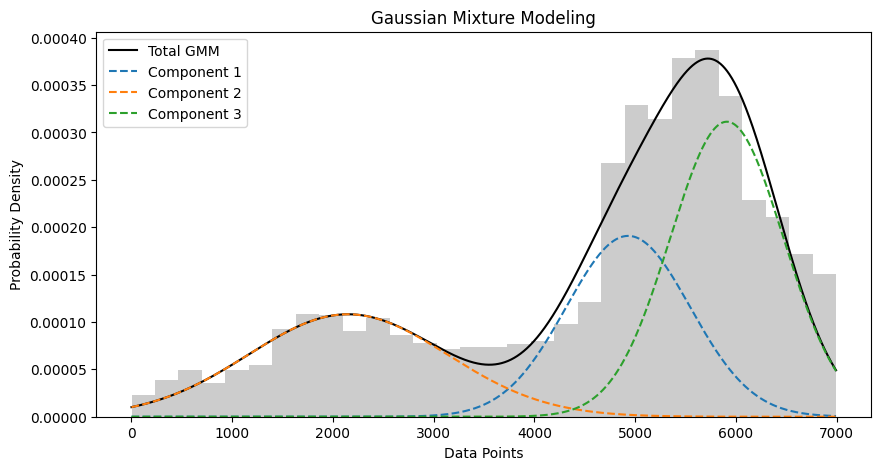

Client 1 - Means: [4930.80905889 2149.04966418 5909.94172749]
Client 1 - Covariances: [378207.70419748 974340.76397535 315520.40606161]
Client 1 - Weights (priors): [0.29417284 0.26749836 0.4383288 ]
mean of pdf 4615.875014986753
variance of pdf 2901189.3074864885


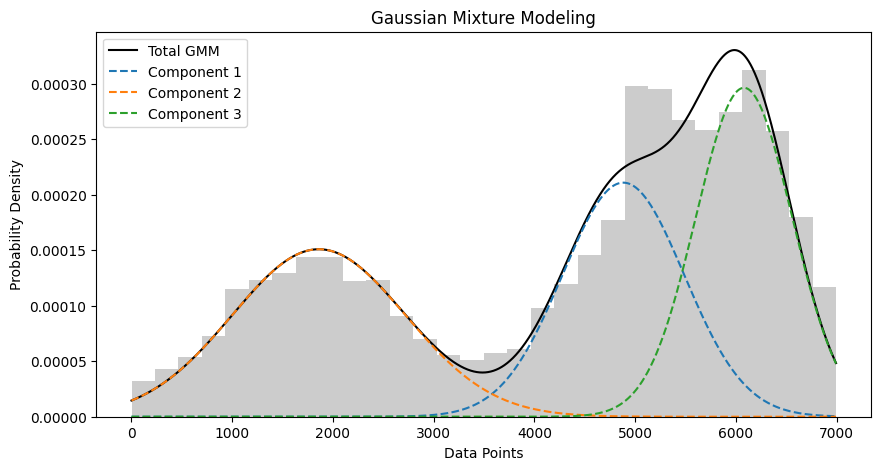

Client 2 - Means: [4882.48296279 1859.92129187 6080.27138306]
Client 2 - Covariances: [364682.99898638 739804.9473405  229018.33205558]
Client 2 - Weights (priors): [0.31921868 0.32533313 0.35544819]
mean of pdf 4324.895247639521
variance of pdf 3609761.3781245025


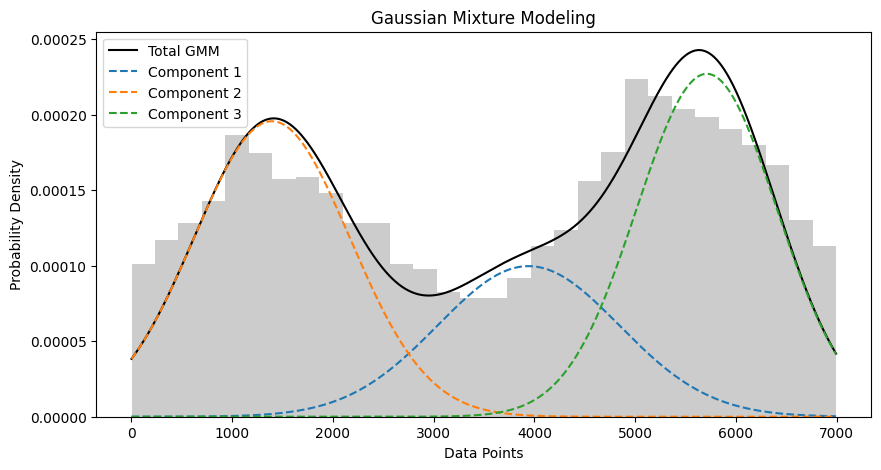

Client 3 - Means: [3941.22757337 1394.47464128 5710.7393308 ]
Client 3 - Covariances: [812893.32978085 595572.82876759 484326.37865637]
Client 3 - Weights (priors): [0.22536302 0.37851905 0.39611793]
mean of pdf 3678.1684221158594
variance of pdf 4226651.135879537


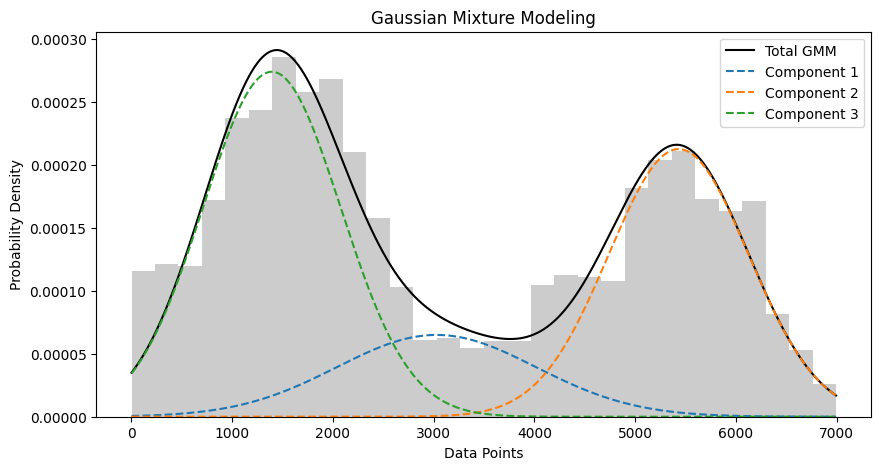

Client 4 - Means: [3027.92986807 5431.6365335  1393.47942116]
Client 4 - Covariances: [976304.64424373 481355.28637818 466823.71056465]
Client 4 - Weights (priors): [0.16093186 0.3697274  0.46934074]
mean of pdf 3149.5319132702884
variance of pdf 3929424.298234924


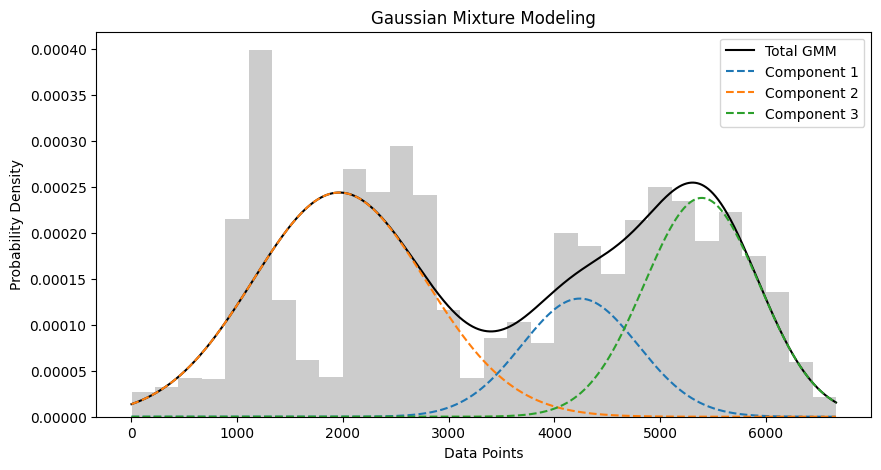

Client 5 - Means: [4240.10285803 1965.65359699 5392.43825838]
Client 5 - Covariances: [302124.69573204 670005.55202294 294690.35227344]
Client 5 - Weights (priors): [0.17685298 0.49969244 0.32345458]
mean of pdf 3476.3059106815463
variance of pdf 2914638.0721553494


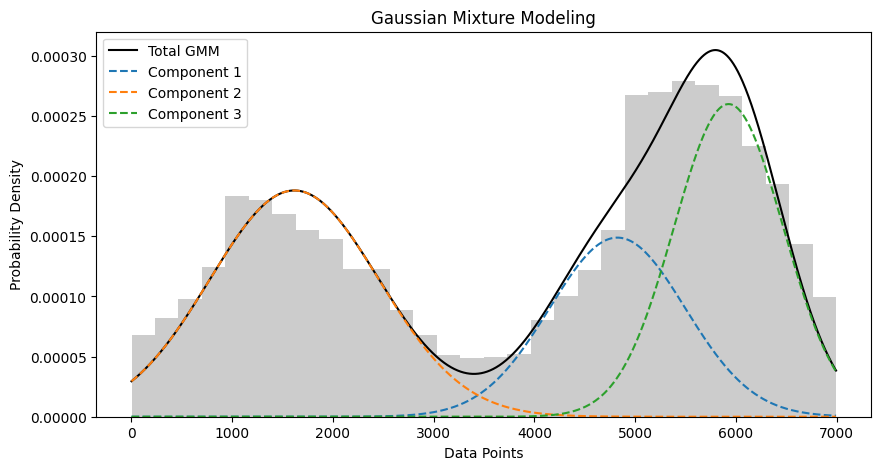

Client 6 - Means: [4823.77218105 1616.87181276 5927.64229367]
Client 6 - Covariances: [453053.12939773 704590.35020413 293907.64026659]
Client 6 - Weights (priors): [0.25117576 0.39568846 0.35313578]
mean of pdf 3944.654751807374
variance of pdf 4223185.544515524


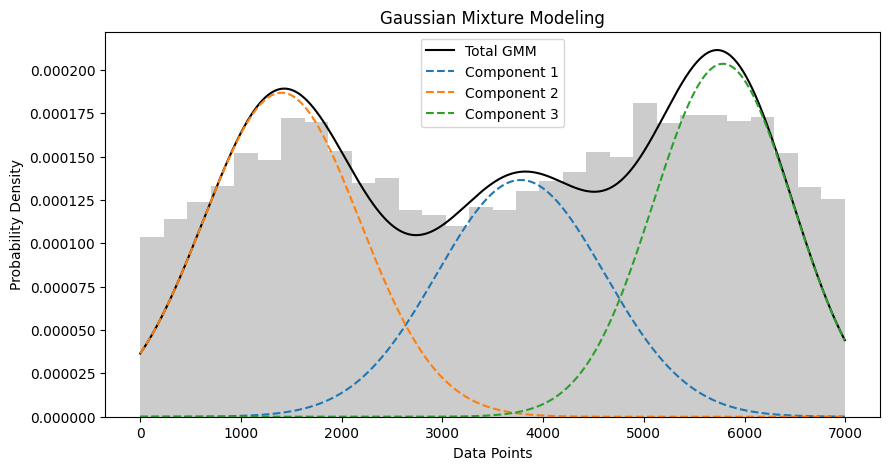

Client 7 - Means: [3777.65875308 1403.06193823 5784.69539885]
Client 7 - Covariances: [688081.80768405 601391.7439635  478154.75296269]
Client 7 - Weights (priors): [0.2838869  0.36327348 0.35283962]
mean of pdf 3623.192743933903
variance of pdf 4028360.285764406


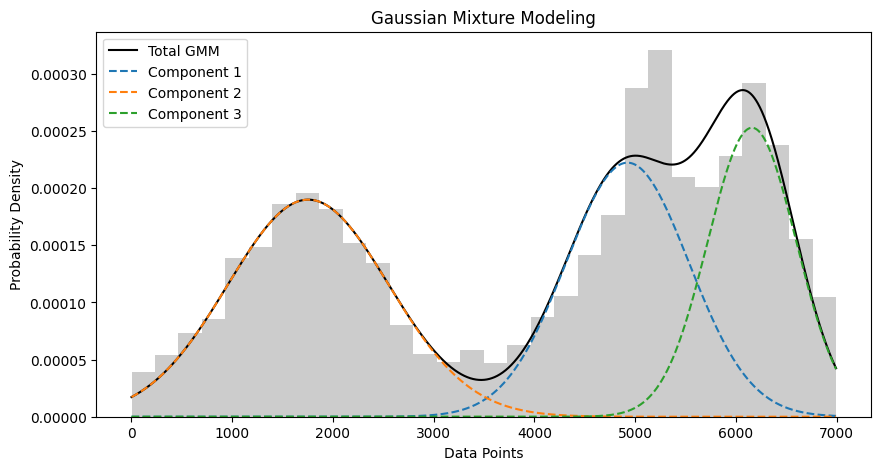

Client 8 - Means: [4923.92930324 1755.16177413 6159.58387814]
Client 8 - Covariances: [372657.3011261  640538.06642125 193295.47274175]
Client 8 - Weights (priors): [0.34019987 0.3811065  0.27869363]
mean of pdf 4060.6604705514383
variance of pdf 3931773.264378466


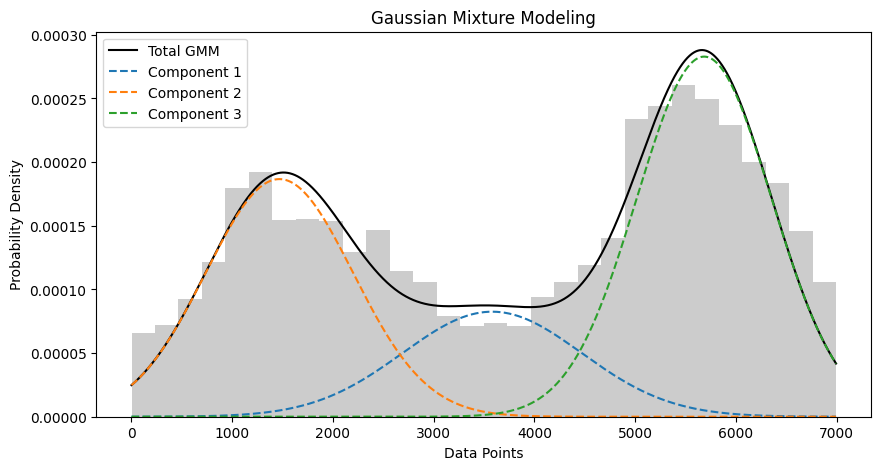

Client 9 - Means: [3580.44588858 1468.71190292 5684.80625179]
Client 9 - Covariances: [789791.79975217 533584.28992991 447865.6215515 ]
Client 9 - Weights (priors): [0.18377512 0.34174049 0.47448439]
mean of pdf 3857.267029343363
variance of pdf 4088505.9138347395


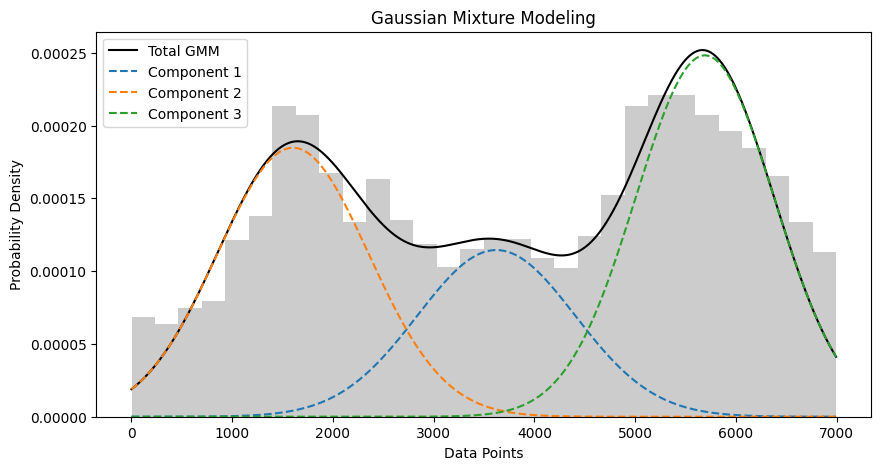

Client 10 - Means: [3621.78076545 1603.3535198  5692.10838458]
Client 10 - Covariances: [614300.98581649 563302.31495699 471911.46098092]
Client 10 - Weights (priors): [0.22494348 0.34758703 0.4274695 ]
mean of pdf 3805.2035536870367
variance of pdf 3750393.7264767927


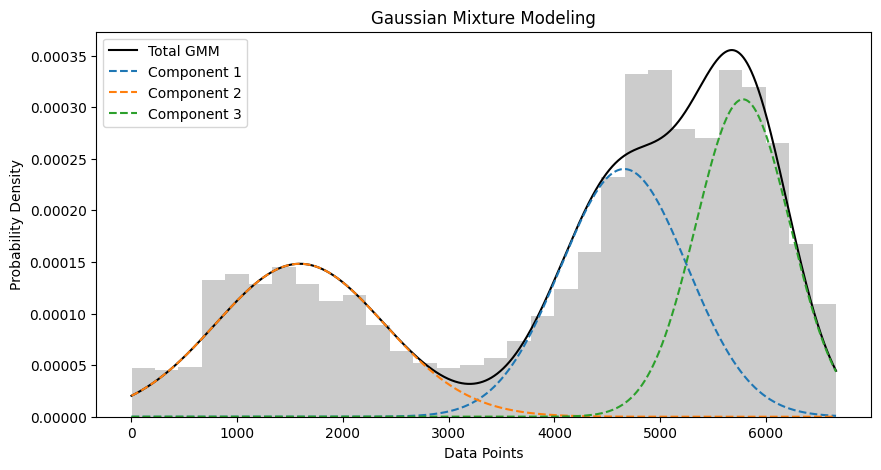

Client 11 - Means: [4659.69597039 1593.31675137 5784.06561793]
Client 11 - Covariances: [357685.2209714  637856.07843754 198256.7032505 ]
Client 11 - Weights (priors): [0.35990411 0.29674741 0.34334848]
mean of pdf 4135.806480357217
variance of pdf 3335910.4513873532


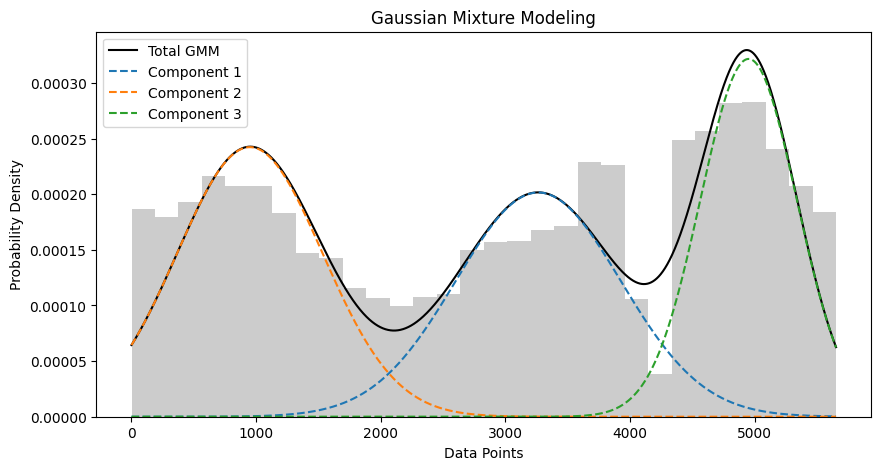

Client 12 - Means: [3263.60611527  950.15667225 4950.4341523 ]
Client 12 - Covariances: [436715.09837628 340095.07038305 149866.14519818]
Client 12 - Weights (priors): [0.33381491 0.35415066 0.31203443]
mean of pdf 2970.64488909876
variance of pdf 3010454.7598613445


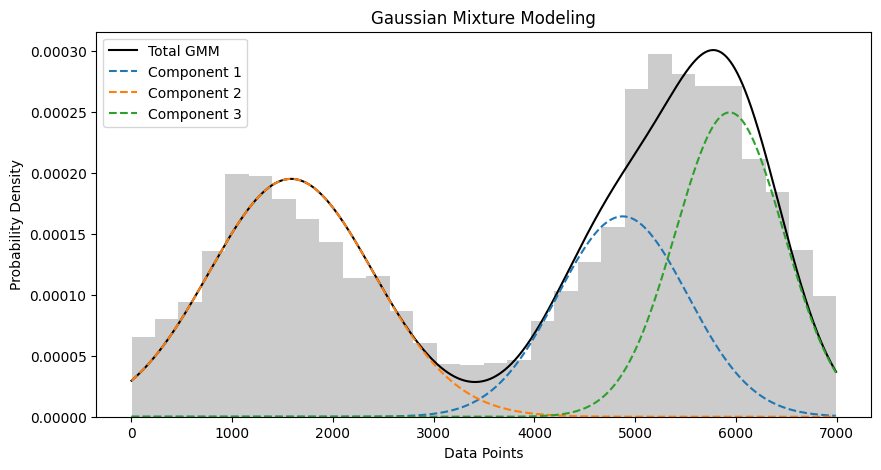

Client 13 - Means: [4876.08709209 1585.57949695 5937.41070385]
Client 13 - Covariances: [416467.65994636 665891.33787145 288820.07857366]
Client 13 - Weights (priors): [0.2655327  0.39860798 0.33585931]
mean of pdf 3920.9199144183344
variance of pdf 4254892.635239597


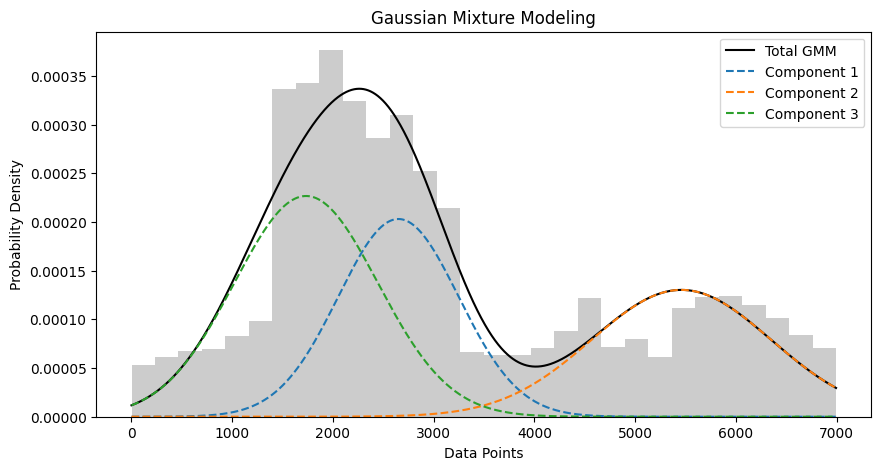

Client 14 - Means: [2650.39442554 5458.80203299 1733.75551667]
Client 14 - Covariances: [357942.83722617 794460.53106416 506978.37731217]
Client 14 - Weights (priors): [0.30447913 0.29097634 0.40454452]
mean of pdf 3096.7533490560963
variance of pdf 2980898.590405236


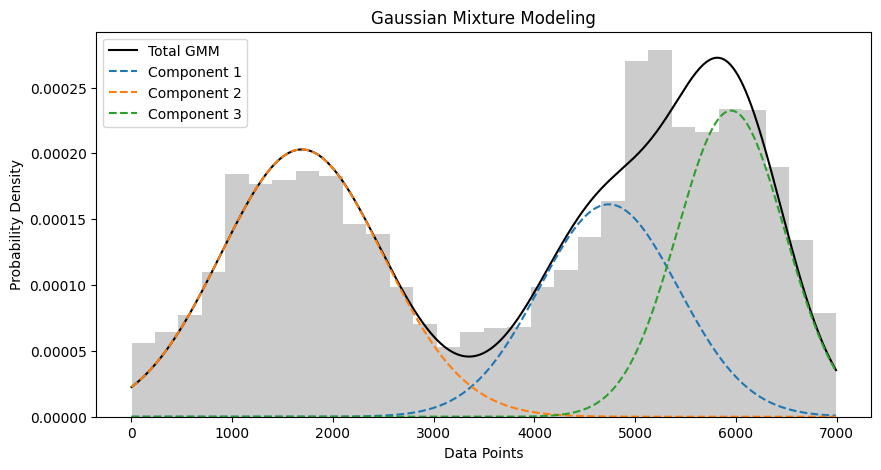

Client 15 - Means: [4738.34277773 1691.16386608 5952.12067753]
Client 15 - Covariances: [475732.48159139 649399.46276146 285010.9075196 ]
Client 15 - Weights (priors): [0.27887843 0.41001629 0.31110529]
mean of pdf 3866.562518590439
variance of pdf 3993065.374475298


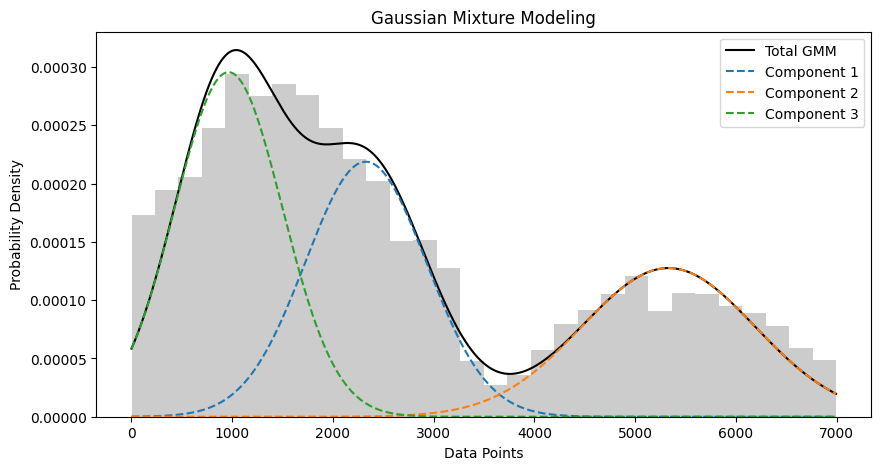

Client 16 - Means: [2326.80928391 5330.37384379  964.02034467]
Client 16 - Covariances: [360207.58259861 739736.15336109 285787.73380088]
Client 16 - Weights (priors): [0.32906447 0.27490278 0.39603275]
mean of pdf 2612.788497091134
variance of pdf 3568801.740553579


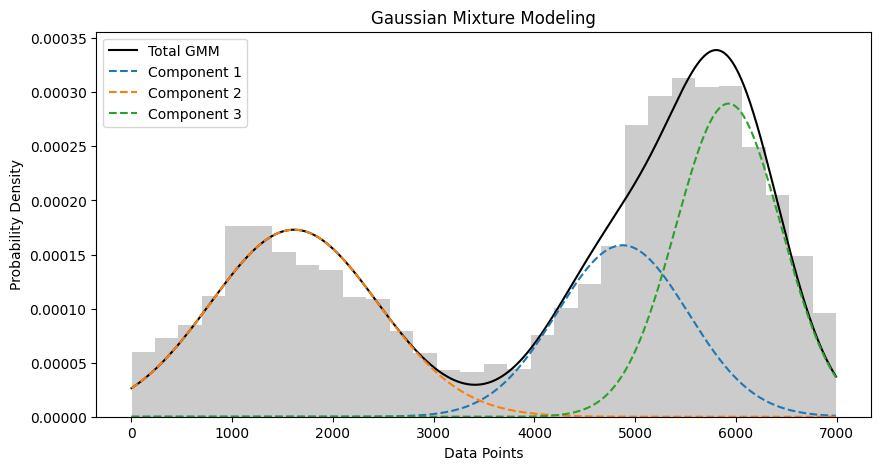

Client 17 - Means: [4874.76367031 1614.71164381 5926.66184122]
Client 17 - Covariances: [424415.13334424 692772.19511649 274469.46373583]
Client 17 - Weights (priors): [0.25892431 0.36080596 0.38026974]
mean of pdf 4098.522520469265
variance of pdf 4117058.176115634


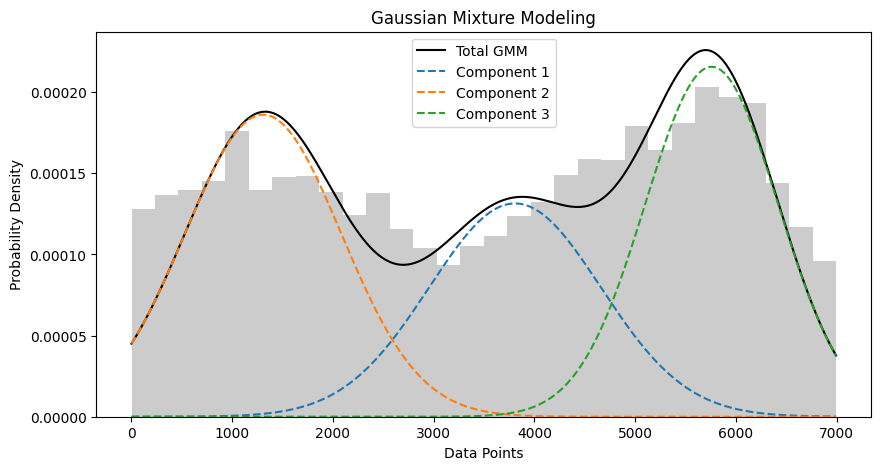

Client 18 - Means: [3807.4913035  1307.26005855 5759.13412639]
Client 18 - Covariances: [726312.85267493 601468.46333802 436641.98885865]
Client 18 - Weights (priors): [0.28082567 0.3619233  0.35725103]
mean of pdf 3599.8257708275537
variance of pdf 4157694.6096617137


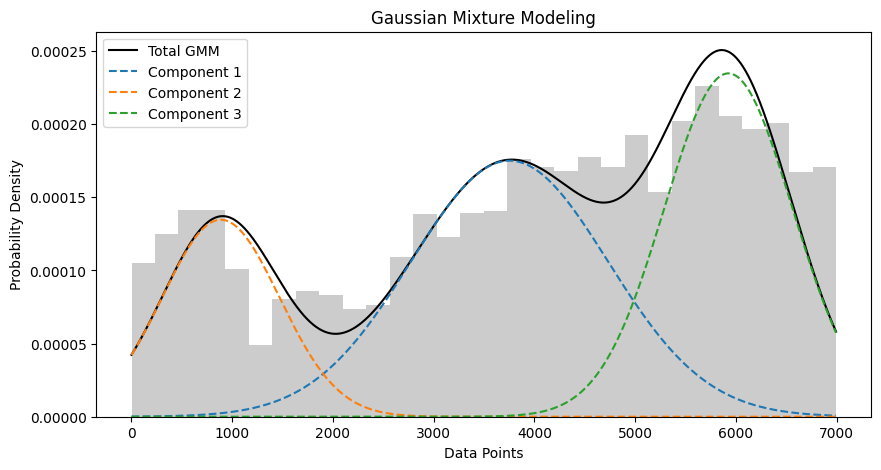

Client 19 - Means: [3752.73644544  887.21870152 5925.33425498]
Client 19 - Covariances: [956320.49099623 338584.54201212 405803.49033795]
Client 19 - Weights (priors): [0.42893661 0.19636822 0.37469516]
mean of pdf 4004.1017139830483
variance of pdf 3946602.4725240967


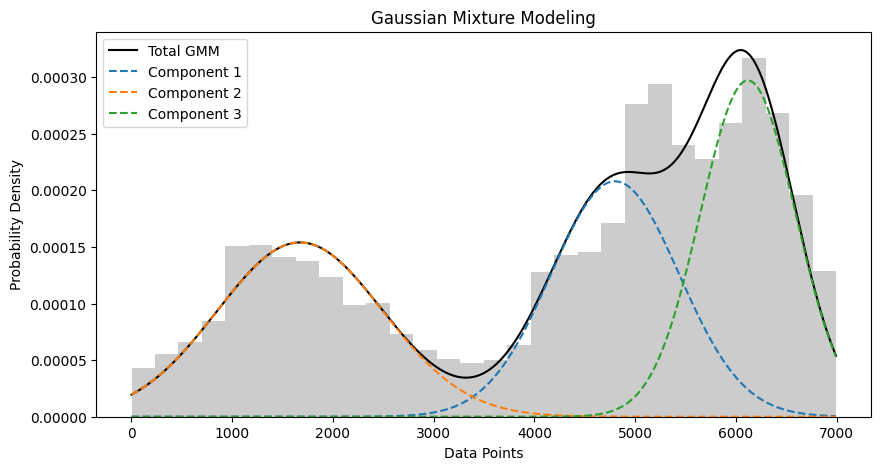

Client 20 - Means: [4800.22998014 1673.17689313 6118.73771818]
Client 20 - Covariances: [403192.19024222 676805.29864158 222931.50377393]
Client 20 - Weights (priors): [0.33098091 0.31748493 0.35153416]
mean of pdf 4270.938251110141
variance of pdf 3862185.740464331


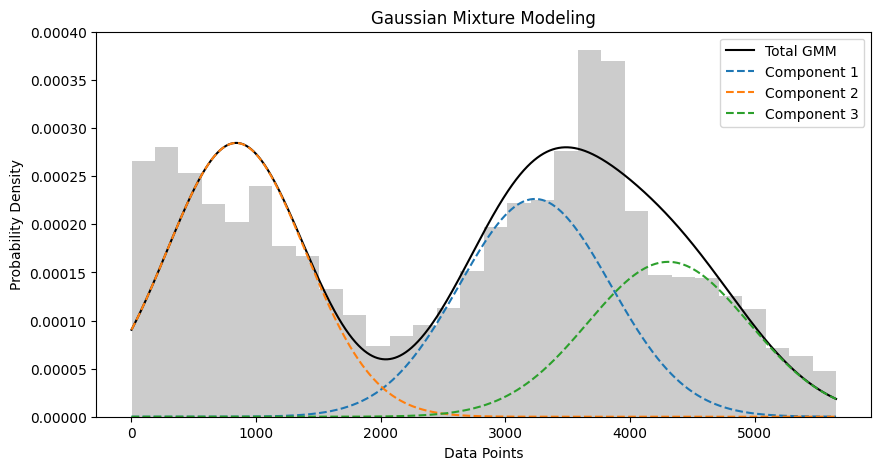

Client 21 - Means: [3237.70423765  840.05600865 4306.30009541]
Client 21 - Covariances: [366781.34502298 307040.06193248 417829.03858617]
Client 21 - Weights (priors): [0.34373641 0.39534771 0.26091588]
mean of pdf 2568.6131226443003
variance of pdf 2479480.209022677


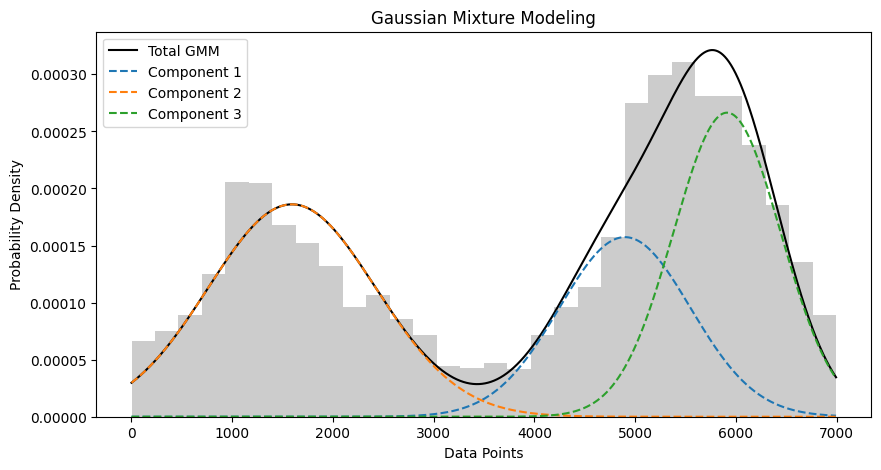

Client 22 - Means: [4898.23206023 1593.11158954 5911.86852372]
Client 22 - Covariances: [423464.75109879 691440.44442653 283142.5065873 ]
Client 22 - Weights (priors): [0.25670267 0.3879153  0.35538203]
mean of pdf 3976.3534414227493
variance of pdf 4230346.292619558


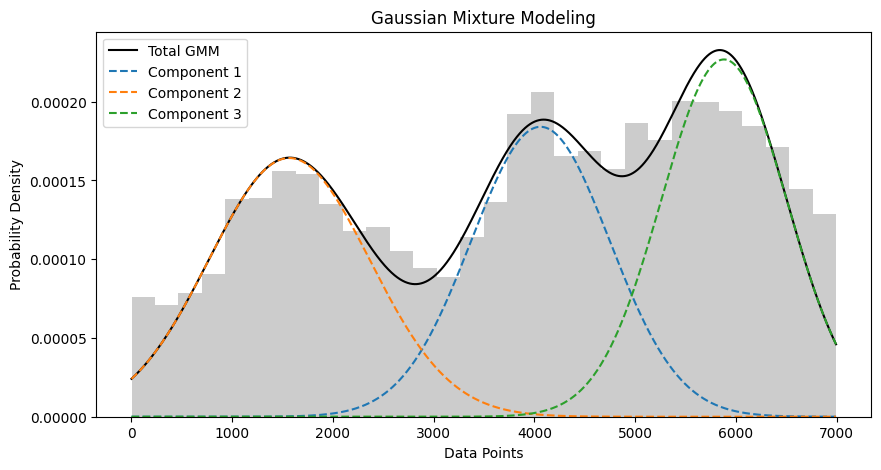

Client 23 - Means: [4060.14393104 1566.61942715 5881.5391107 ]
Client 23 - Covariances: [473029.4245092  638018.96491148 387690.55397353]
Client 23 - Weights (priors): [0.31727186 0.32877051 0.35395763]
mean of pdf 3885.0433267419876
variance of pdf 3684838.7494792705


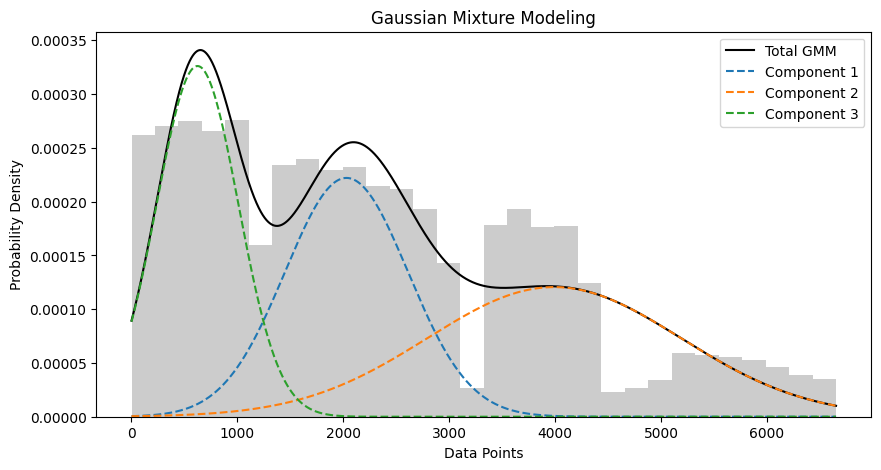

Client 24 - Means: [2030.72514482 3991.73496048  624.23056029]
Client 24 - Covariances: [ 337145.19188235 1432298.91941754  148733.97067999]
Client 24 - Weights (priors): [0.32317734 0.36158847 0.31523419]
mean of pdf 2296.428497984165
variance of pdf 2617262.995074943


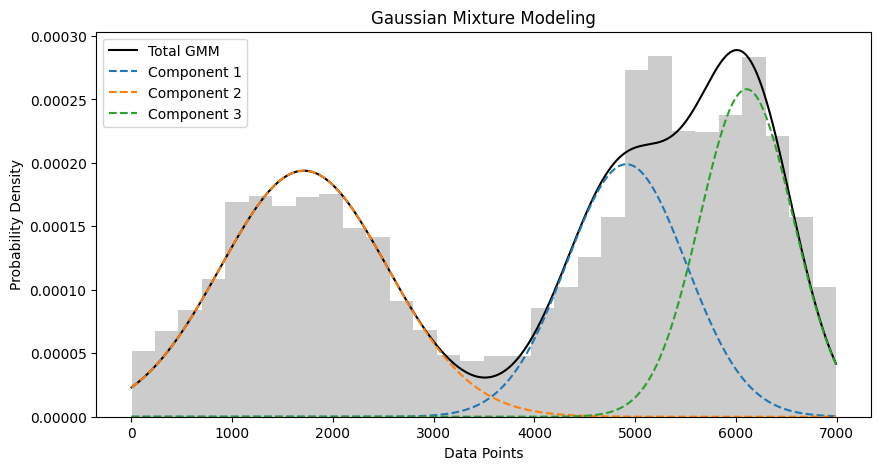

Client 25 - Means: [4912.52105435 1712.16122667 6105.37533457]
Client 25 - Covariances: [353599.39949669 688407.10274365 215472.43792415]
Client 25 - Weights (priors): [0.29655828 0.40317079 0.30027094]
mean of pdf 3980.4089352690216
variance of pdf 4134928.8622853435


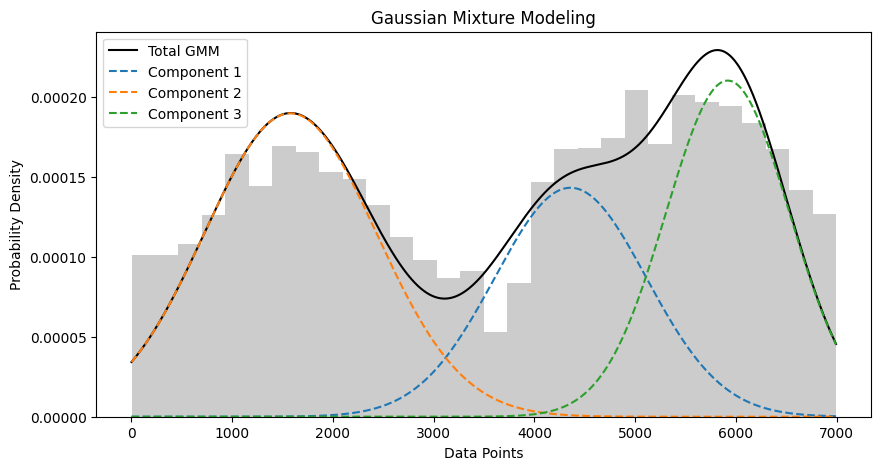

Client 26 - Means: [4358.64028618 1577.65330662 5918.77605034]
Client 26 - Covariances: [567293.71832698 725620.55017327 375924.66460433]
Client 26 - Weights (priors): [0.27071615 0.40575441 0.32352945]
mean of pdf 3734.9924271233667
variance of pdf 4106223.030297238


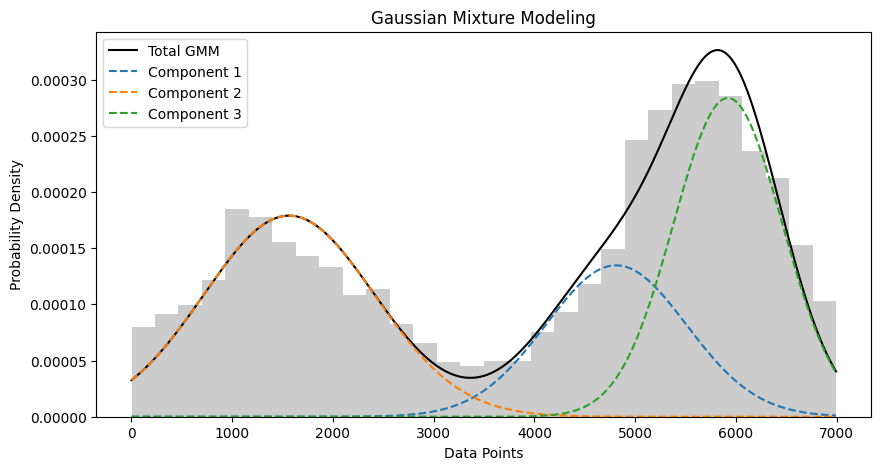

Client 27 - Means: [4810.72007835 1564.93637429 5920.51036822]
Client 27 - Covariances: [488929.4827851  717400.29898647 291359.37819484]
Client 27 - Weights (priors): [0.23615703 0.37999898 0.38384399]
mean of pdf 4003.311929912895
variance of pdf 4324091.360659268


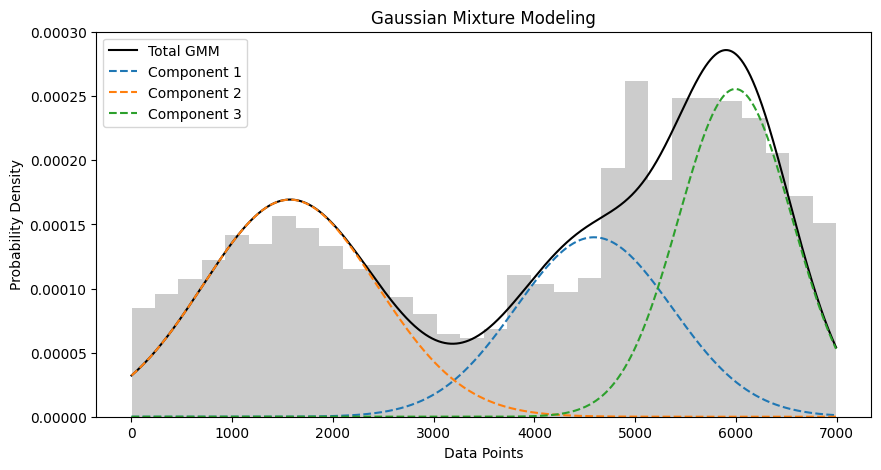

Client 28 - Means: [4590.85564813 1573.59622827 5994.6368056 ]
Client 28 - Covariances: [604828.00855893 744473.96050563 317183.50986484]
Client 28 - Weights (priors): [0.27288249 0.36621822 0.36089929]
mean of pdf 3992.503911190484
variance of pdf 4239319.416972142


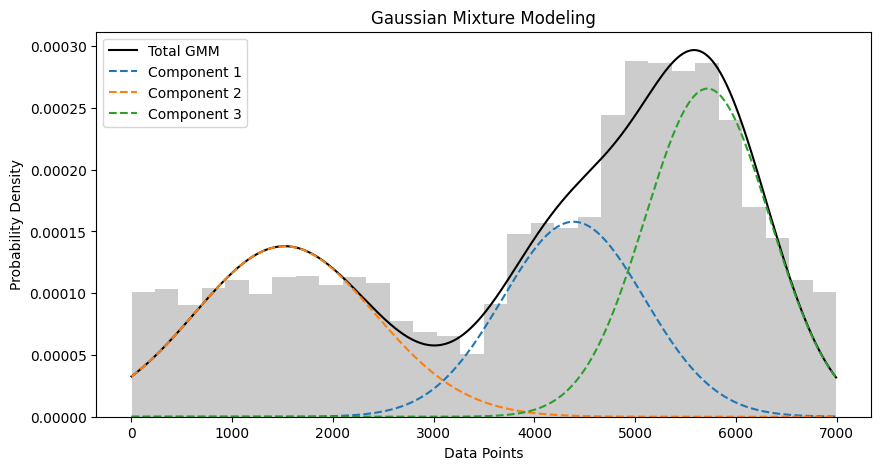

Client 29 - Means: [4388.35922885 1520.37463366 5717.54251224]
Client 29 - Covariances: [495744.74162526 799448.58180429 383053.80315952]
Client 29 - Weights (priors): [0.27858011 0.30932607 0.41209381]
mean of pdf 4048.965021407813
variance of pdf 3700429.140485434


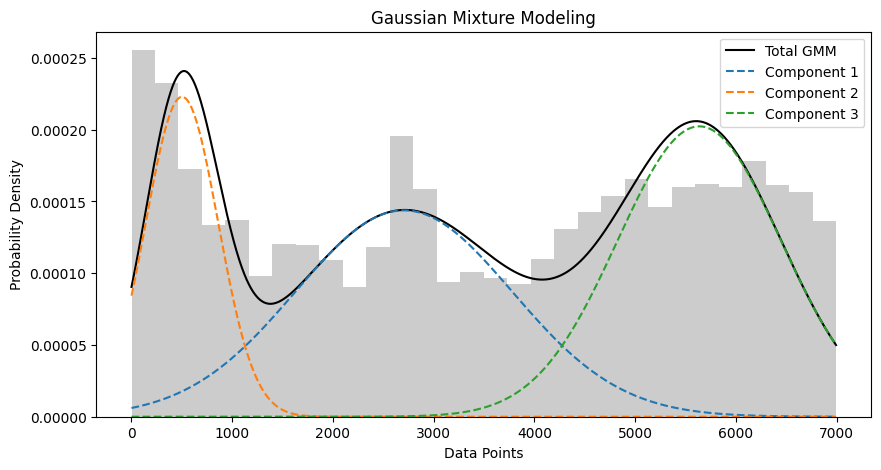

Client 30 - Means: [2704.23325284  502.27732432 5636.41458833]
Client 30 - Covariances: [1155494.370893    129311.12794971  658342.21757903]
Client 30 - Weights (priors): [0.38749684 0.20094171 0.41156145]
mean of pdf 3468.5412771554825
variance of pdf 4673280.582705223


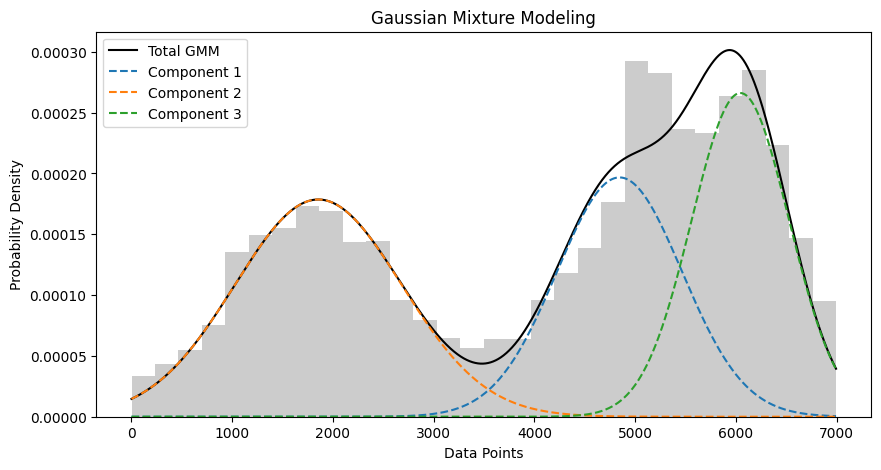

Client 31 - Means: [4844.84188636 1854.81060475 6044.30779194]
Client 31 - Covariances: [384942.41347258 687039.544977   234810.18611212]
Client 31 - Weights (priors): [0.30588043 0.37096944 0.32315013]
mean of pdf 4123.239207224509
variance of pdf 3709280.920474286


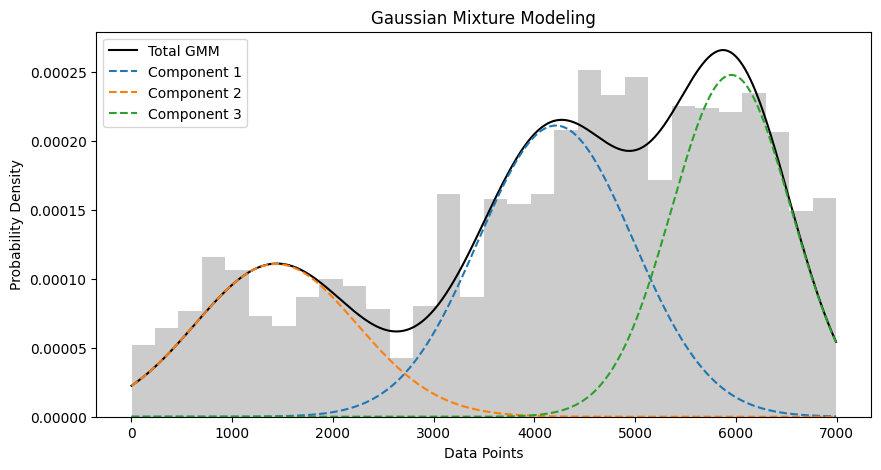

Client 32 - Means: [4212.70703013 1435.02870135 5955.01752189]
Client 32 - Covariances: [589554.63014351 644780.69035358 354358.9751711 ]
Client 32 - Weights (priors): [0.40674499 0.22309961 0.3701554 ]
mean of pdf 4237.933725999673
variance of pdf 3359165.2730187317


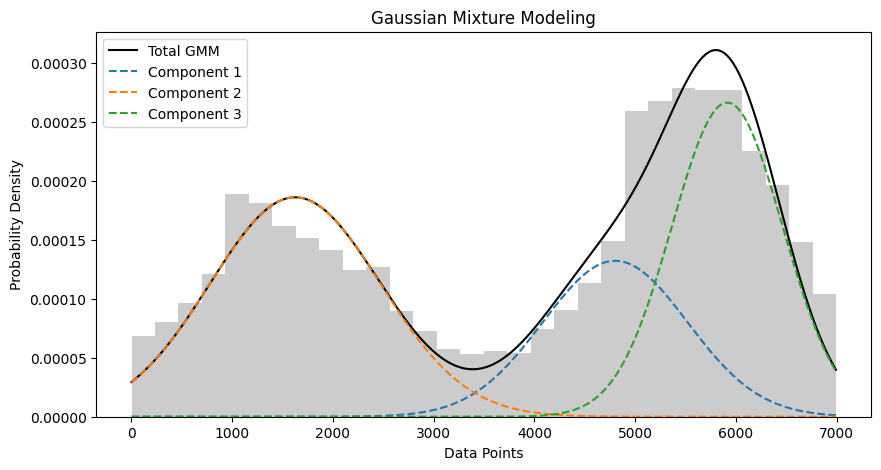

Client 33 - Means: [4801.38116537 1624.98859043 5914.14893495]
Client 33 - Covariances: [515694.7350715  715320.27637574 301601.0733852 ]
Client 33 - Weights (priors): [0.23817661 0.39483989 0.36698351]
mean of pdf 3955.582094636905
variance of pdf 4238713.170641595


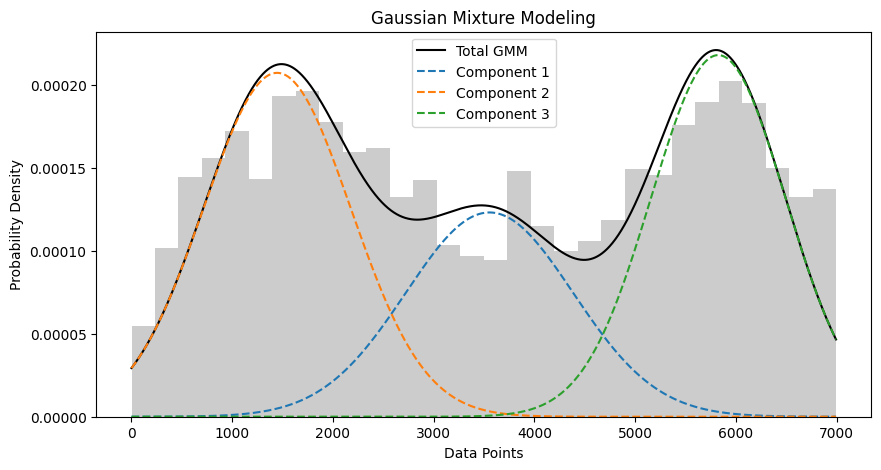

Client 34 - Means: [3553.81072002 1446.26821278 5824.33814879]
Client 34 - Covariances: [690421.29506893 534036.42706804 443099.60555747]
Client 34 - Weights (priors): [0.25649937 0.37974533 0.3637553 ]
mean of pdf 3579.397690731642
variance of pdf 4102409.6736776363


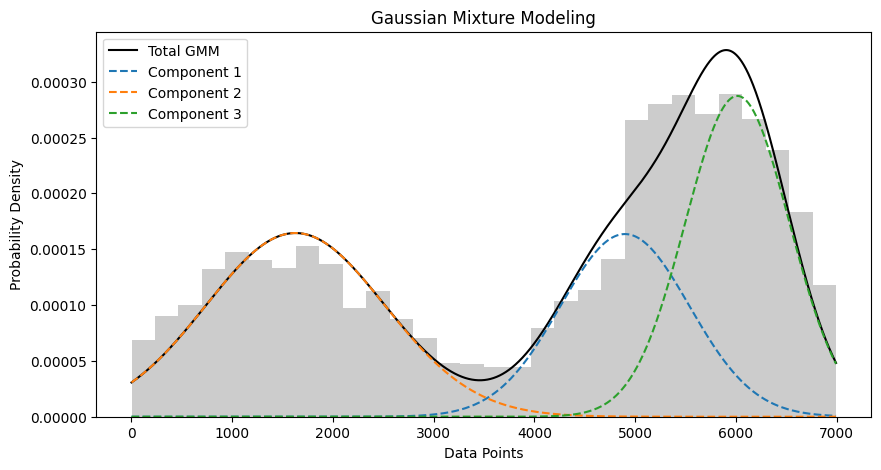

Client 35 - Means: [4898.44779383 1627.64837928 6014.48964015]
Client 35 - Covariances: [409615.13999204 788092.74669952 266272.23833968]
Client 35 - Weights (priors): [0.26241632 0.36605027 0.37153341]
mean of pdf 4115.817605420629
variance of pdf 4261206.4578522


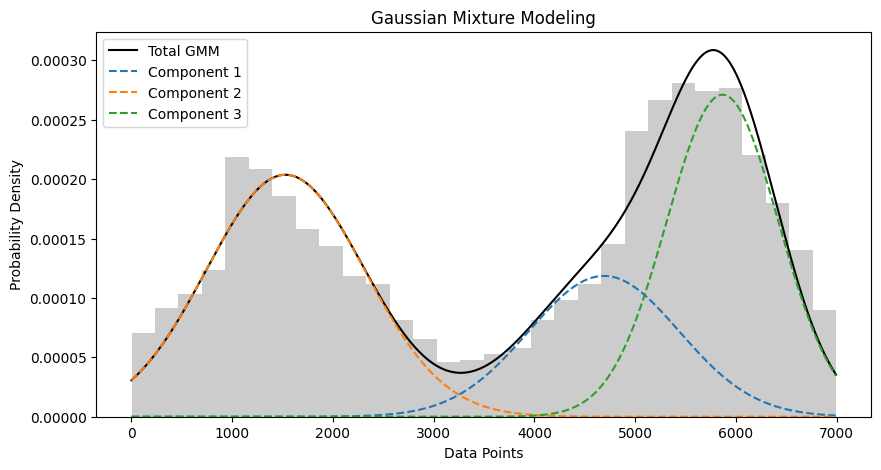

Client 36 - Means: [4690.40851704 1528.76951098 5867.13954518]
Client 36 - Covariances: [558002.32554891 617569.97890282 307454.4381977 ]
Client 36 - Weights (priors): [0.22197764 0.40123158 0.37679078]
mean of pdf 3865.24049951896
variance of pdf 4339032.342692857


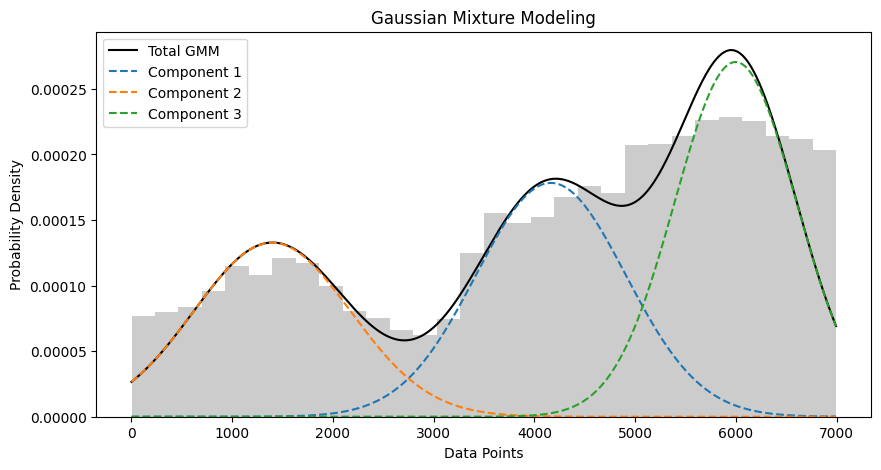

Client 37 - Means: [4163.66877857 1396.57814496 5996.76742298]
Client 37 - Covariances: [552062.39518679 605633.42286357 364089.64465238]
Client 37 - Weights (priors): [0.33205281 0.25877975 0.40916744]
mean of pdf 4197.646050792235
variance of pdf 3844186.1930975197


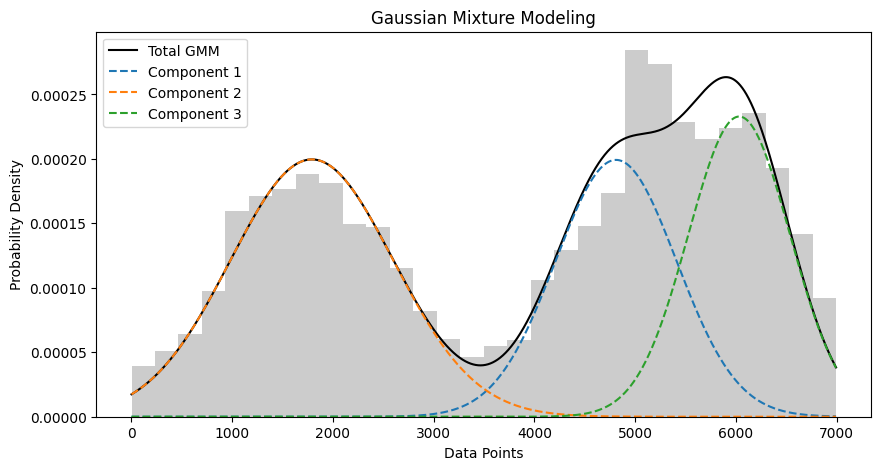

Client 38 - Means: [4810.40953295 1791.09851566 6032.49253768]
Client 38 - Covariances: [360828.86925645 656387.58639826 254921.67142999]
Client 38 - Weights (priors): [0.29995872 0.40534156 0.29469972]
mean of pdf 3946.7048011357006
variance of pdf 3838755.1390070333


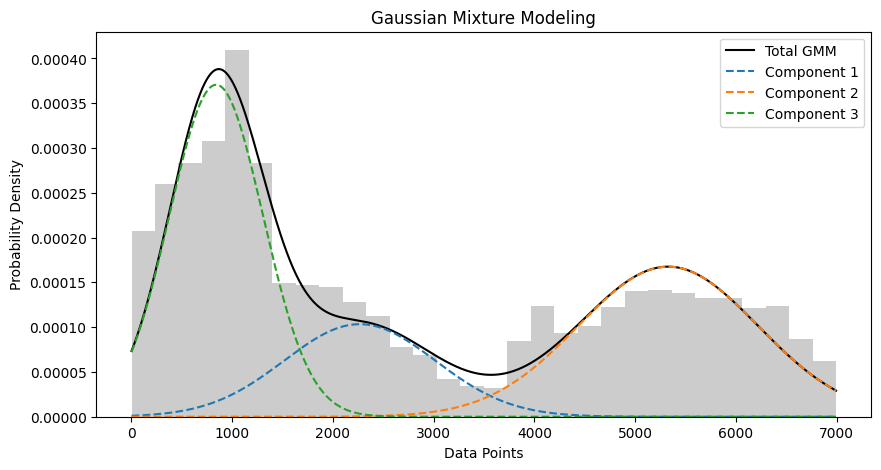

Client 39 - Means: [2266.42584661 5327.47741201  841.03917704]
Client 39 - Covariances: [562104.52410832 794209.97635444 215878.79296306]
Client 39 - Weights (priors): [0.19419118 0.37422511 0.43158371]
mean of pdf 2796.7745370551825
variance of pdf 4601632.465982847


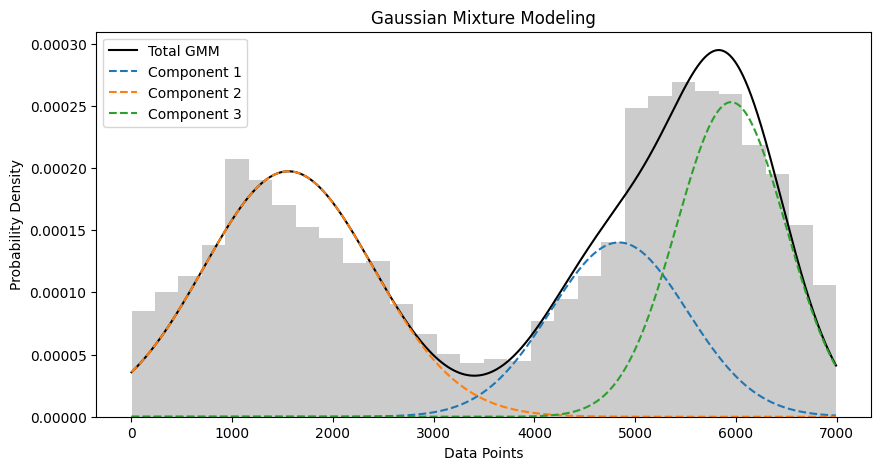

Client 40 - Means: [4839.02808239 1558.82585353 5953.14950221]
Client 40 - Covariances: [460792.28769133 710592.35620322 294841.96356987]
Client 40 - Weights (priors): [0.23851135 0.41709106 0.34439759]
mean of pdf 3854.585795731033
variance of pdf 4453977.141231548


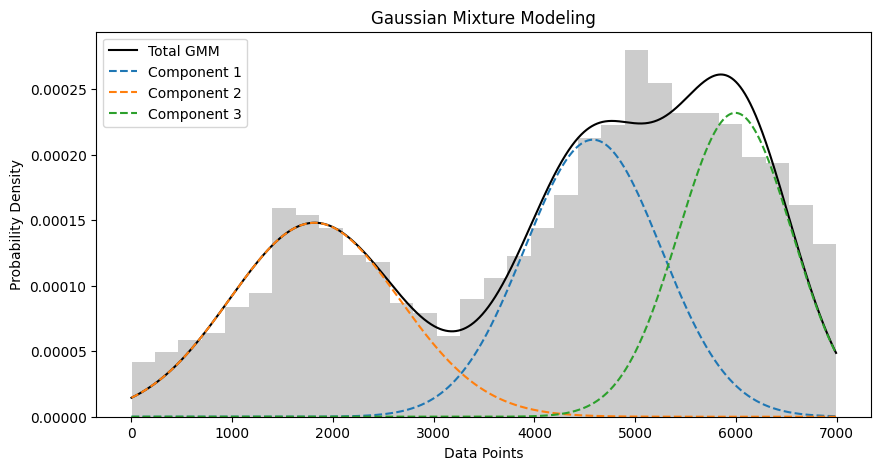

Client 41 - Means: [4580.65657724 1817.61245249 5994.19112469]
Client 41 - Covariances: [460283.09143268 710344.61233763 318732.60027526]
Client 41 - Weights (priors): [0.35939264 0.31255143 0.32805593]
mean of pdf 4180.781563791479
variance of pdf 3373732.3015613984


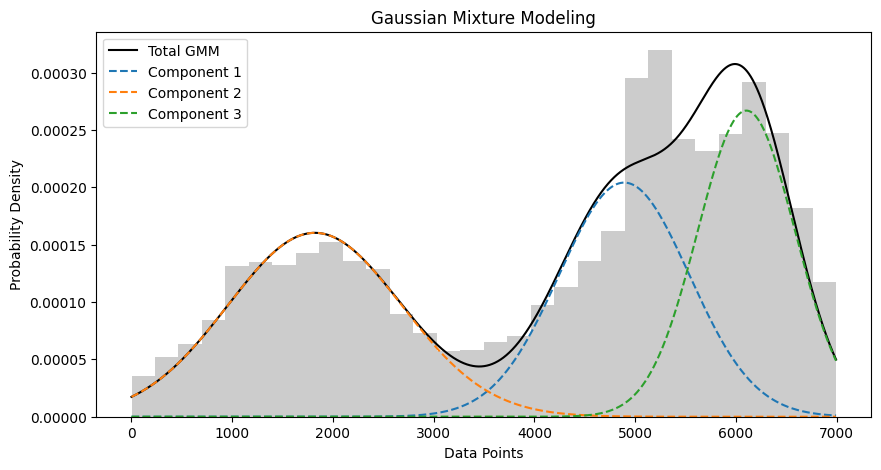

Client 42 - Means: [4891.22758237 1820.58523482 6103.97613016]
Client 42 - Covariances: [416695.88809431 743834.72008555 233201.20899521]
Client 42 - Weights (priors): [0.33030231 0.34662226 0.32307543]
mean of pdf 4218.683857539866
variance of pdf 3761905.26701934


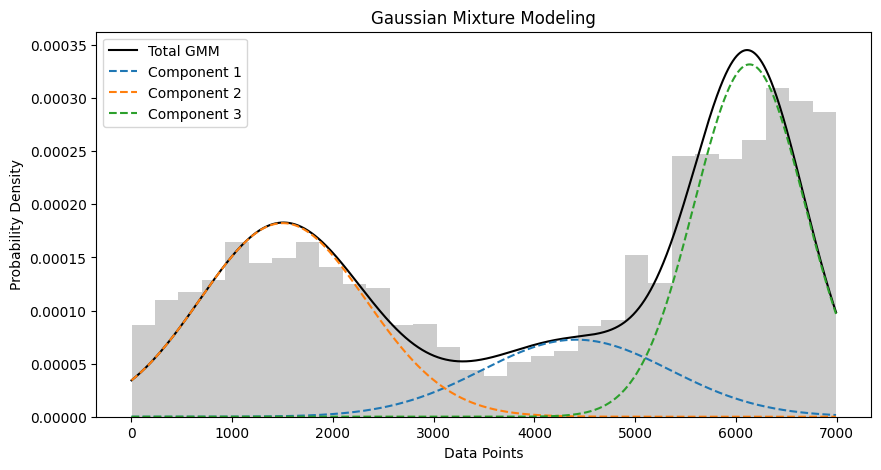

Client 43 - Means: [4414.01671811 1502.16878904 6135.16721202]
Client 43 - Covariances: [868757.13158031 674054.97985146 299401.67085502]
Client 43 - Weights (priors): [0.16958706 0.37525979 0.45515316]
mean of pdf 4104.704372675911
variance of pdf 4970976.817792064


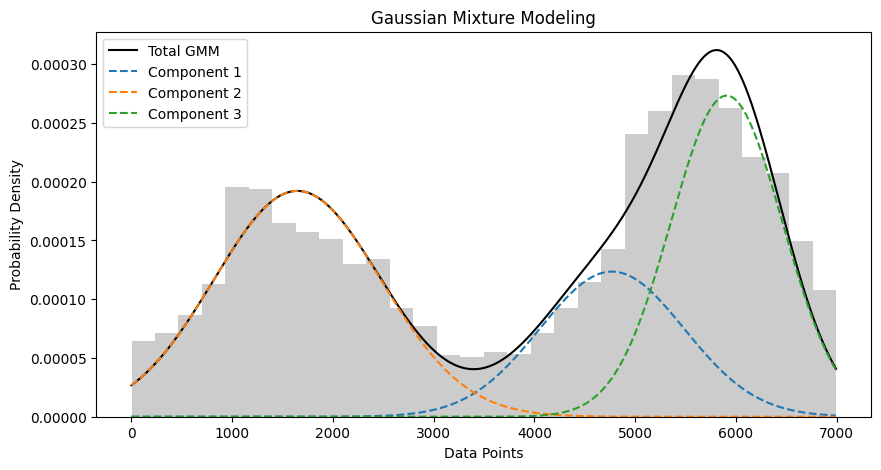

Client 44 - Means: [4769.88880231 1647.48848255 5907.95987942]
Client 44 - Covariances: [513220.59020688 687539.51397285 306254.00668386]
Client 44 - Weights (priors): [0.22174238 0.39933055 0.37892708]
mean of pdf 3954.2649221445226
variance of pdf 4223179.182882138


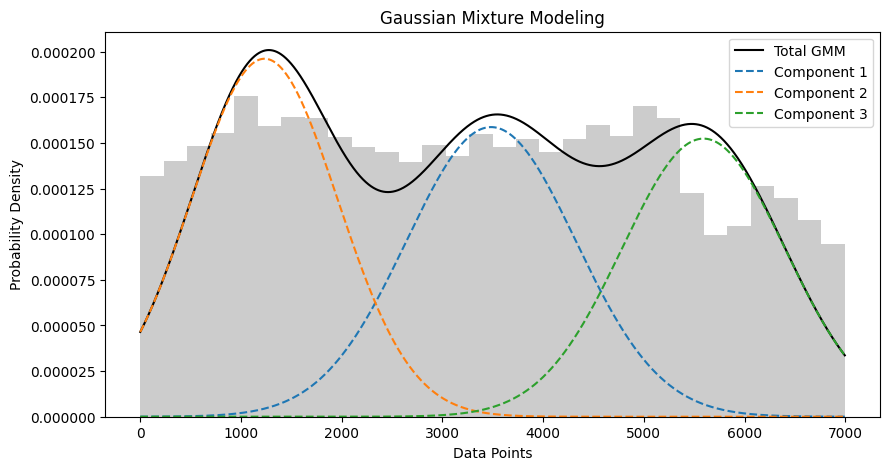

Client 45 - Means: [3483.42070602 1234.509025   5591.13077962]
Client 45 - Covariances: [707477.42354795 527940.99863572 650864.9935323 ]
Client 45 - Weights (priors): [0.33459602 0.35725529 0.30814869]
mean of pdf 3329.473205982869
variance of pdf 3777980.504656678


c:\Users\USER\anaconda3\envs\gpu3\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


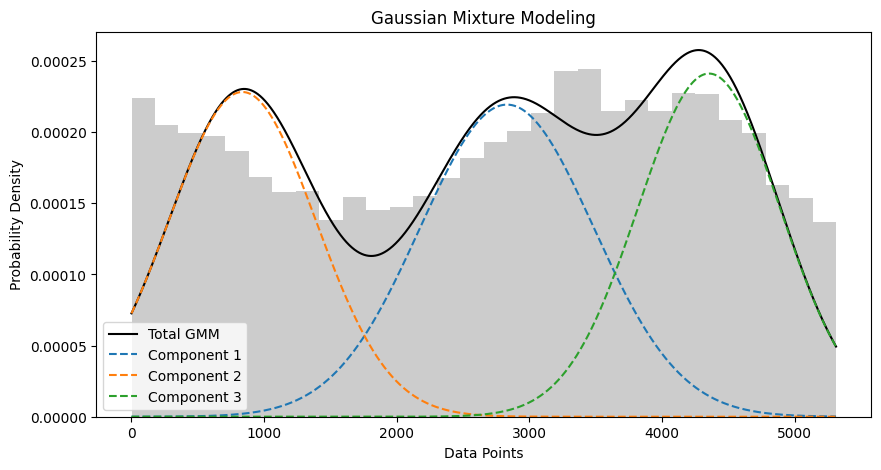

Client 46 - Means: [2830.5909086   836.35364597 4353.28418553]
Client 46 - Covariances: [427050.14029649 304769.38336467 288328.14457553]
Client 46 - Weights (priors): [0.35939957 0.31589731 0.32470312]
mean of pdf 2695.0399865314234
variance of pdf 2334177.429222789


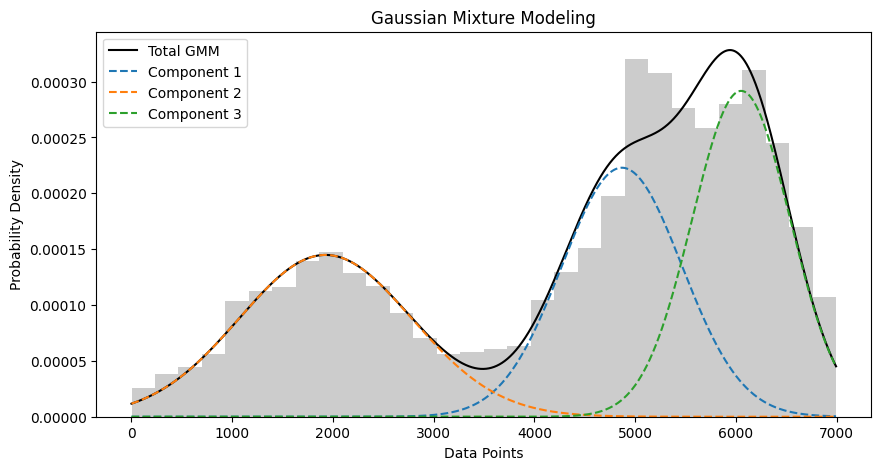

Client 47 - Means: [4868.84734898 1926.03456852 6052.04312763]
Client 47 - Covariances: [354488.53012657 736527.1297154  236620.89341869]
Client 47 - Weights (priors): [0.33270966 0.31159534 0.355695  ]
mean of pdf 4372.737405899898
variance of pdf 3381897.4869561098


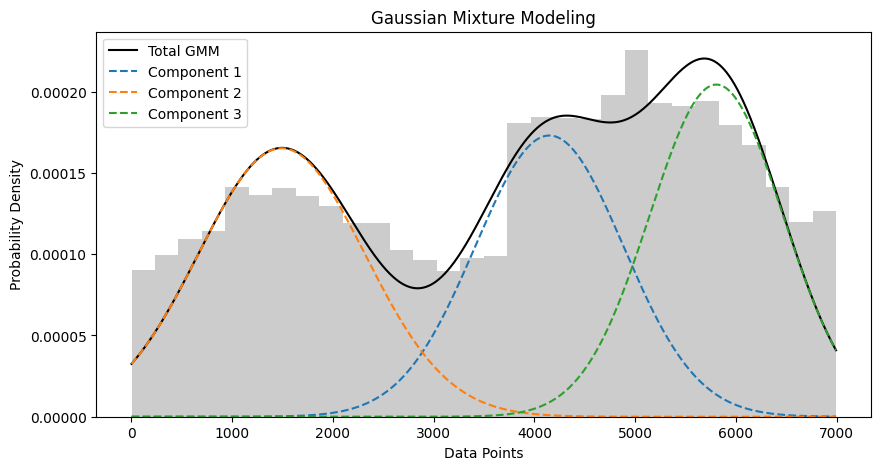

Client 48 - Means: [4148.52732062 1490.97560736 5806.07284275]
Client 48 - Covariances: [539794.44513905 682994.55469164 437968.20241185]
Client 48 - Weights (priors): [0.31868948 0.34224583 0.33906468]
mean of pdf 3801.006467883911
variance of pdf 3782212.307720038


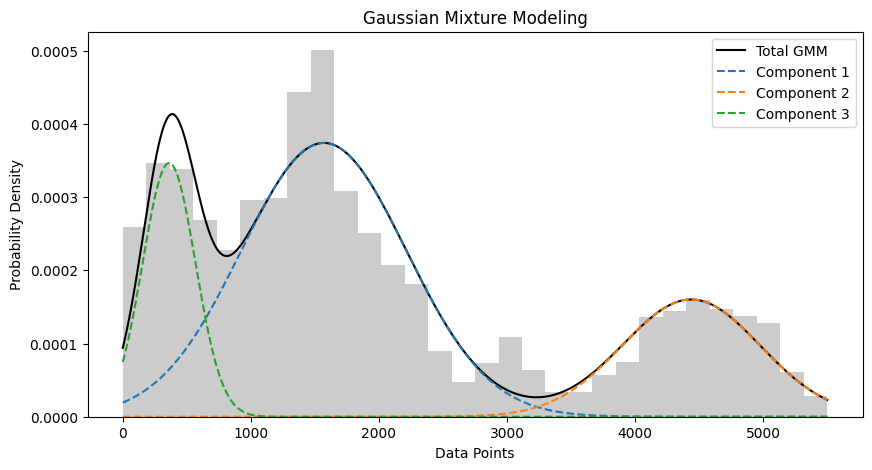

Client 49 - Means: [1570.13515317 4436.95296542  362.43844545]
Client 49 - Covariances: [415179.39141969 290095.94777165  42606.07961492]
Client 49 - Weights (priors): [0.60434894 0.21628285 0.1793682 ]
mean of pdf 1973.5563063455452
variance of pdf 2197715.560610775


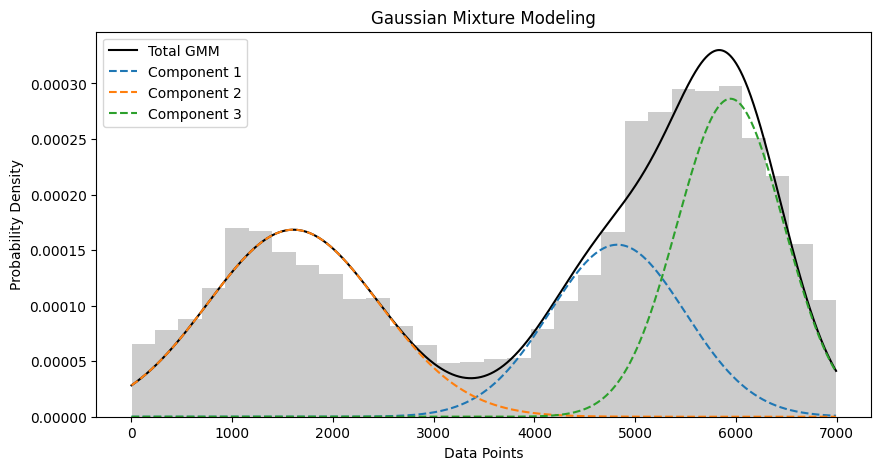

Client 50 - Means: [4823.91890707 1607.9301678  5946.09850239]
Client 50 - Covariances: [452648.28122045 723368.56364768 280488.33339585]
Client 50 - Weights (priors): [0.26112516 0.35889523 0.37997961]
mean of pdf 4096.121237087881
variance of pdf 4145109.12510202


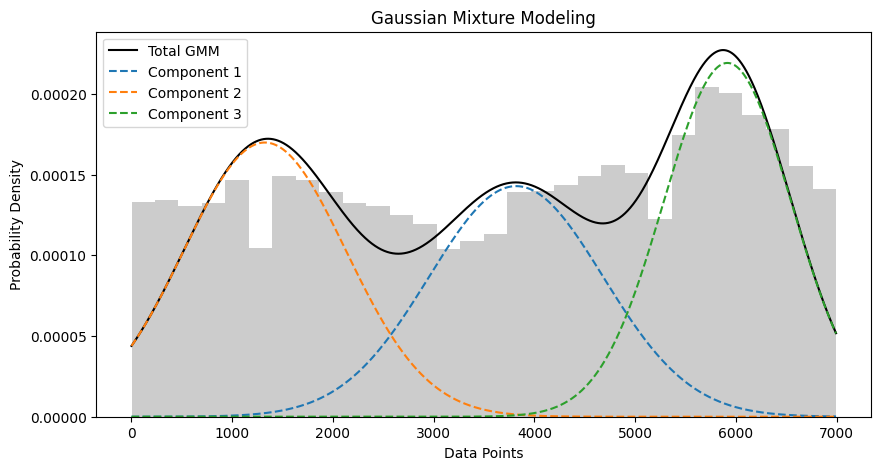

Client 51 - Means: [3818.47696775 1324.41972004 5915.67337031]
Client 51 - Covariances: [747273.5693399  646905.81415128 401878.8329028 ]
Client 51 - Weights (priors): [0.30945718 0.34237153 0.34817129]
mean of pdf 3694.7663553706802
variance of pdf 4238349.020716978


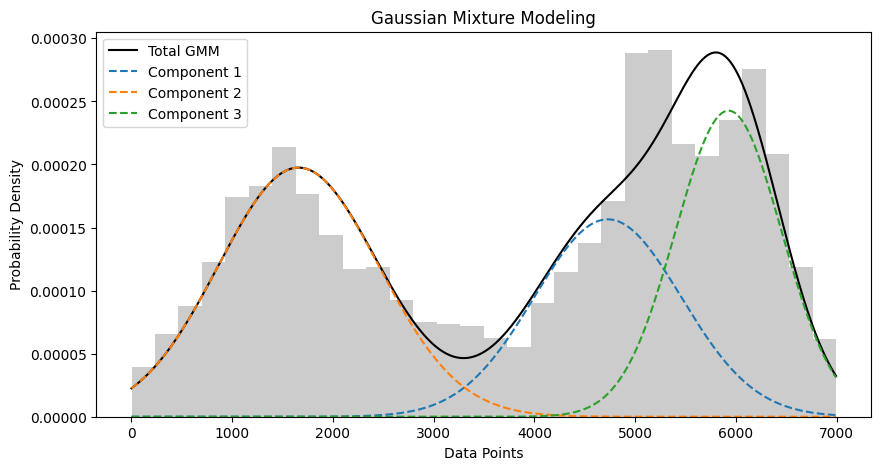

Client 52 - Means: [4728.19550057 1658.60460936 5926.6003409 ]
Client 52 - Covariances: [531251.52896539 633113.42680582 277040.7701606 ]
Client 52 - Weights (priors): [0.28593553 0.39392586 0.32013861]
mean of pdf 3902.6599245383622
variance of pdf 3979983.090453877


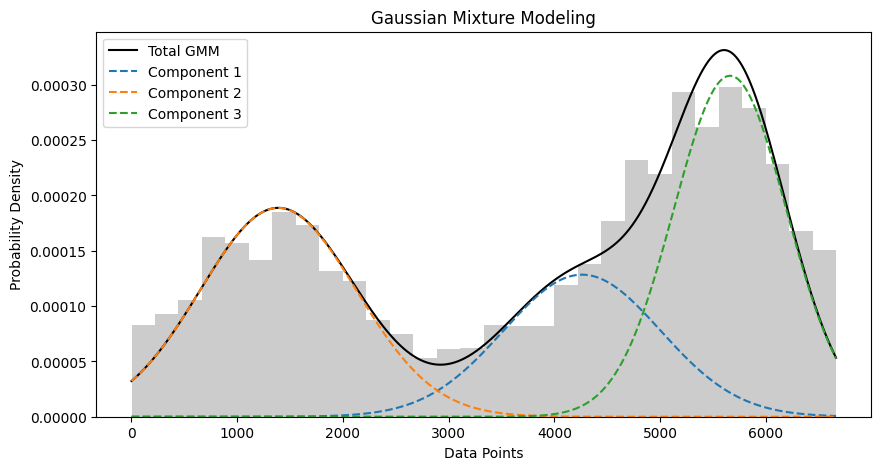

Client 53 - Means: [4261.68343869 1388.75589502 5661.47838371]
Client 53 - Covariances: [550990.19550336 544965.21139691 284464.09422071]
Client 53 - Weights (priors): [0.23886099 0.34918909 0.41194992]
mean of pdf 3835.133889227759
variance of pdf 3946438.1875482476


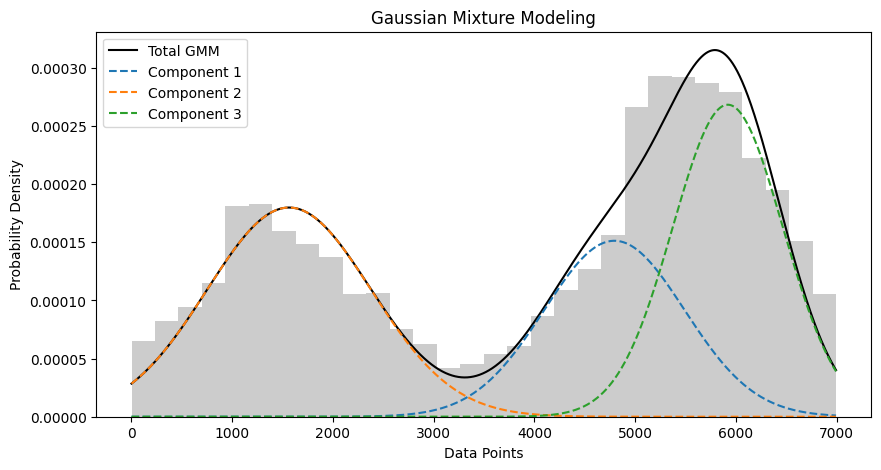

Client 54 - Means: [4793.81506926 1564.8447143  5919.5151312 ]
Client 54 - Covariances: [485162.85223338 663615.35769321 299409.43461672]
Client 54 - Weights (priors): [0.26431501 0.3674964  0.3681886 ]
mean of pdf 4021.6500300061216
variance of pdf 4184290.3120591305


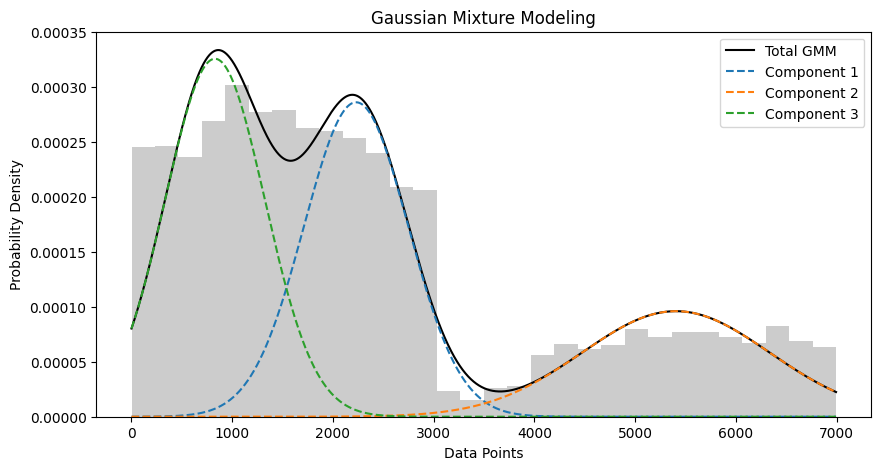

Client 55 - Means: [2230.25203605 5404.24736384  829.30487983]
Client 55 - Covariances: [267468.25178644 869918.13204075 244900.64045834]
Client 55 - Weights (priors): [0.37109646 0.22466638 0.40423716]
mean of pdf 2377.027181281652
variance of pdf 3428874.5988050657


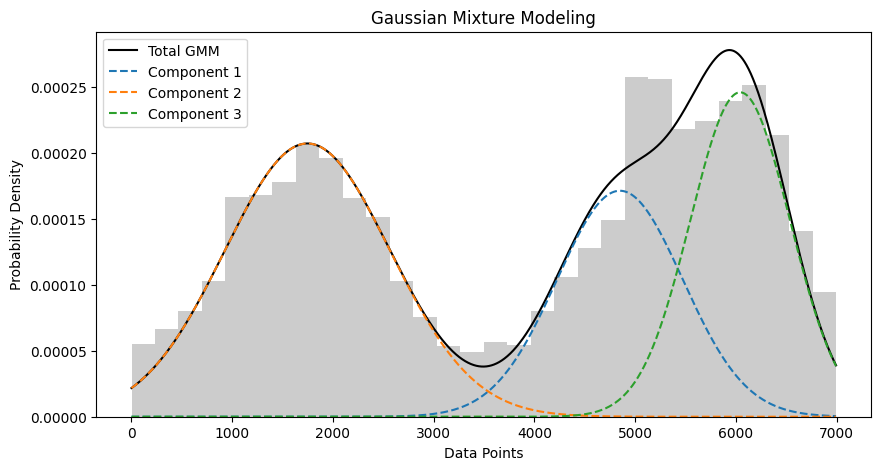

Client 56 - Means: [4848.61099048 1747.05497271 6042.20703252]
Client 56 - Covariances: [390298.51688452 676189.04653961 244178.09120043]
Client 56 - Weights (priors): [0.26832071 0.42702737 0.30465192]
mean of pdf 3887.7930082923913
variance of pdf 4086577.1522691506


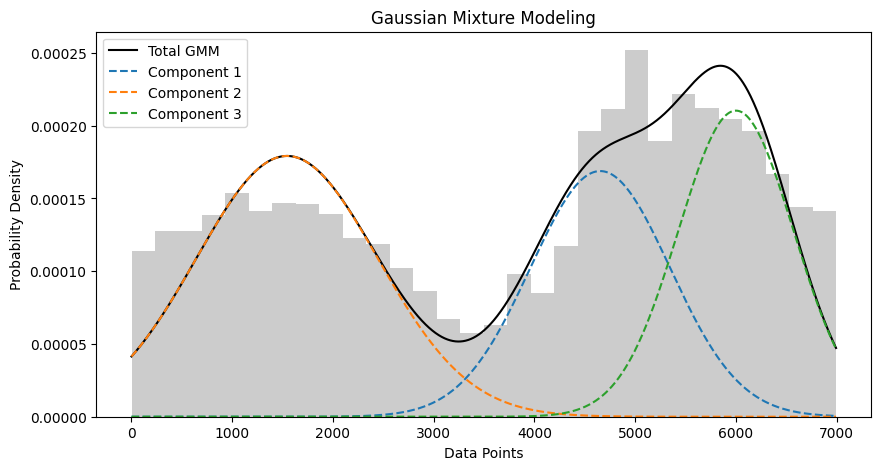

Client 57 - Means: [4653.17006915 1544.68250105 6000.29553898]
Client 57 - Covariances: [479874.88132707 813129.63532664 327982.27024037]
Client 57 - Weights (priors): [0.29309695 0.40498566 0.30191739]
mean of pdf 3800.9977780594
variance of pdf 4303938.223791285


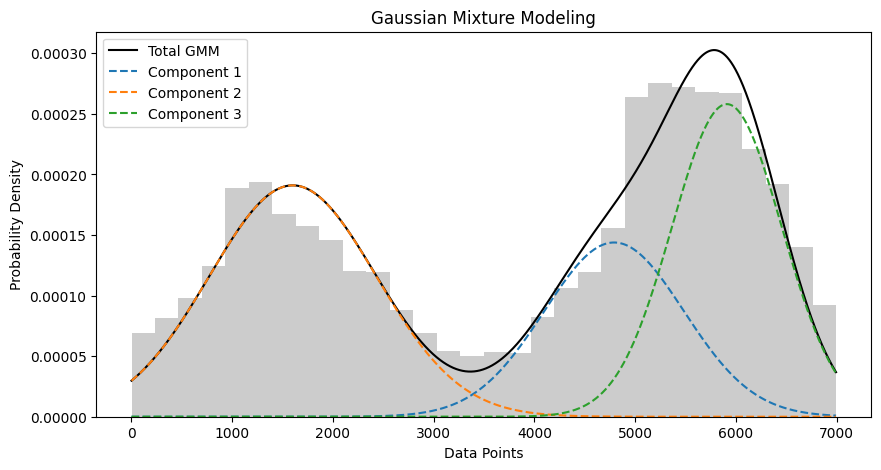

Client 58 - Means: [4790.86510213 1601.37202216 5910.31050153]
Client 58 - Covariances: [479759.56901484 688620.07915916 297601.54601715]
Client 58 - Weights (priors): [0.2497551  0.39733178 0.35291313]
mean of pdf 3918.645124737847
variance of pdf 4221951.710497817


c:\Users\USER\anaconda3\envs\gpu3\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


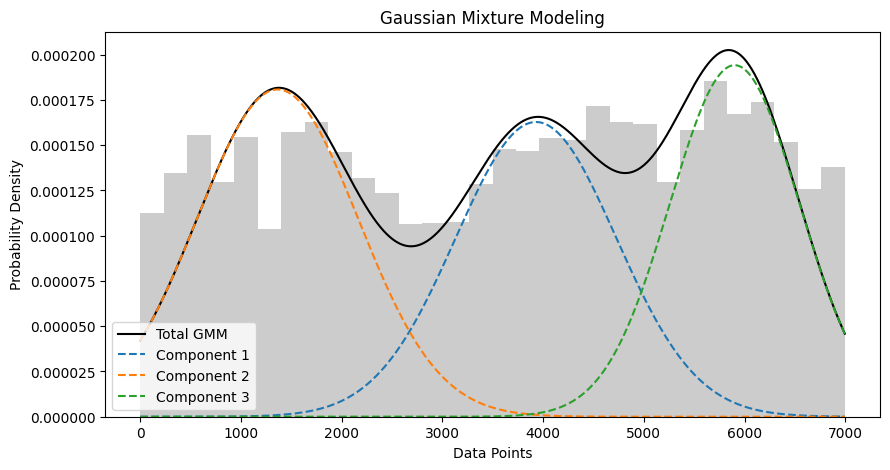

Client 59 - Means: [3929.09584247 1363.92563244 5900.44351228]
Client 59 - Covariances: [635834.51836858 637038.58701292 413736.46195665]
Client 59 - Weights (priors): [0.32536221 0.3615811  0.31305669]
mean of pdf 3618.7223519772633
variance of pdf 4066252.5756751266


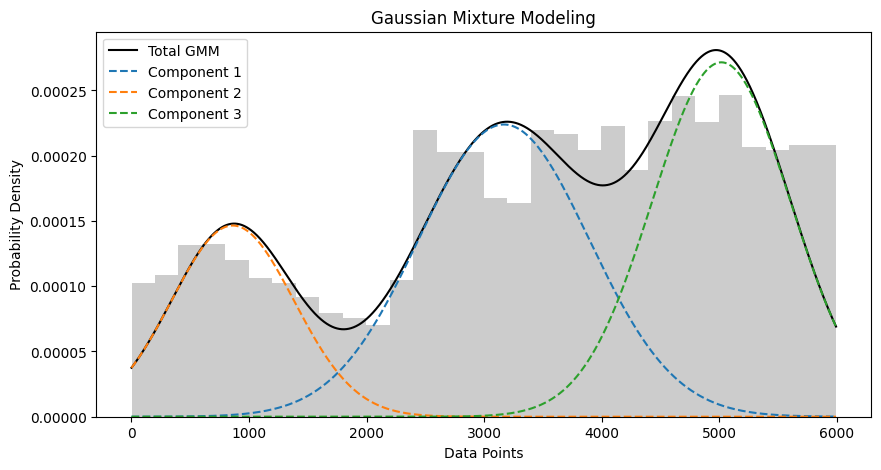

Client 60 - Means: [3167.92840487  862.05161865 5017.33842297]
Client 60 - Covariances: [526816.28560183 272108.75608838 347318.37401898]
Client 60 - Weights (priors): [0.40734863 0.19154024 0.40111112]
mean of pdf 3468.0791379641455
variance of pdf 2706300.279487623


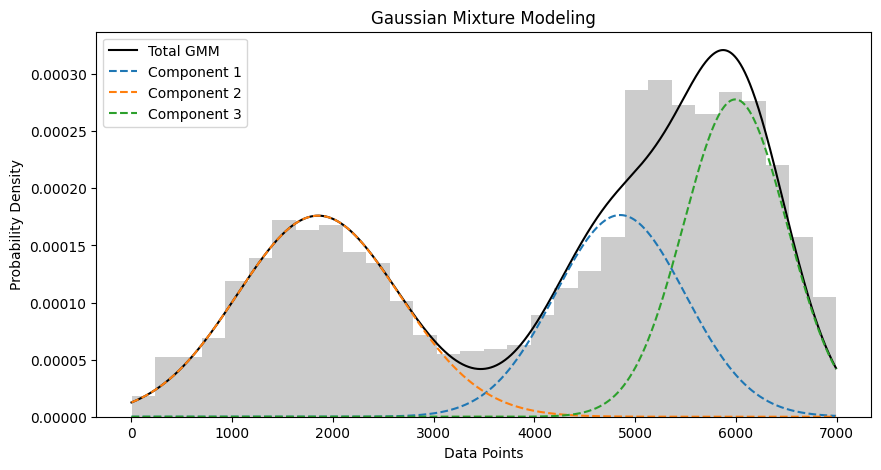

Client 61 - Means: [4851.60312343 1854.97559086 5993.84360706]
Client 61 - Covariances: [418596.95196079 650287.97127113 263921.88664734]
Client 61 - Weights (priors): [0.28639169 0.35583531 0.35777299]
mean of pdf 4193.960027171553
variance of pdf 3675320.5825580675


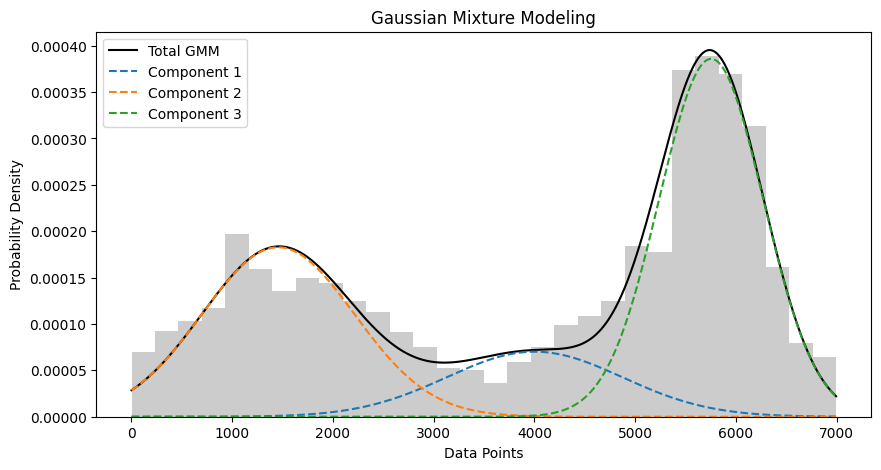

Client 62 - Means: [4000.88196287 1456.57065295 5754.45972437]
Client 62 - Covariances: [761743.73683742 570913.90089553 267905.86321141]
Client 62 - Weights (priors): [0.15338883 0.34599718 0.50061399]
mean of pdf 3998.4229856973548
variance of pdf 4227714.177927655


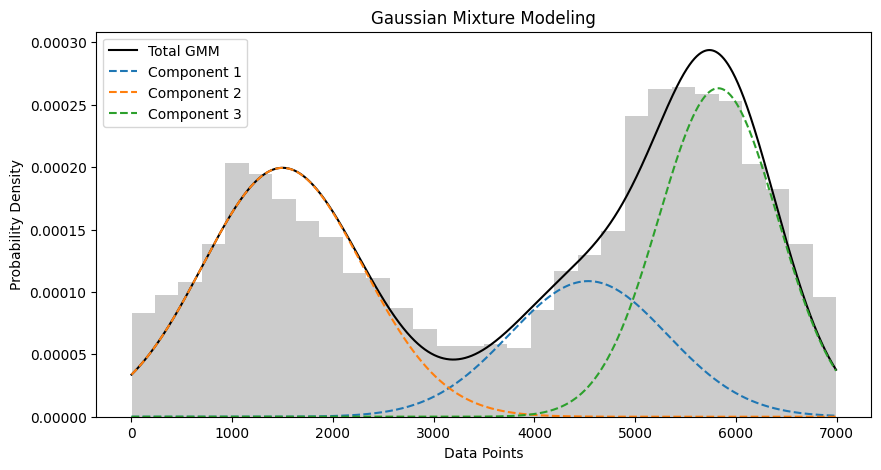

Client 63 - Means: [4534.37141812 1499.80972357 5824.53070576]
Client 63 - Covariances: [614458.5723802  632279.52601137 347834.27335317]
Client 63 - Weights (priors): [0.21351224 0.39740845 0.38907931]
mean of pdf 3830.3852282625967
variance of pdf 4329394.452100934


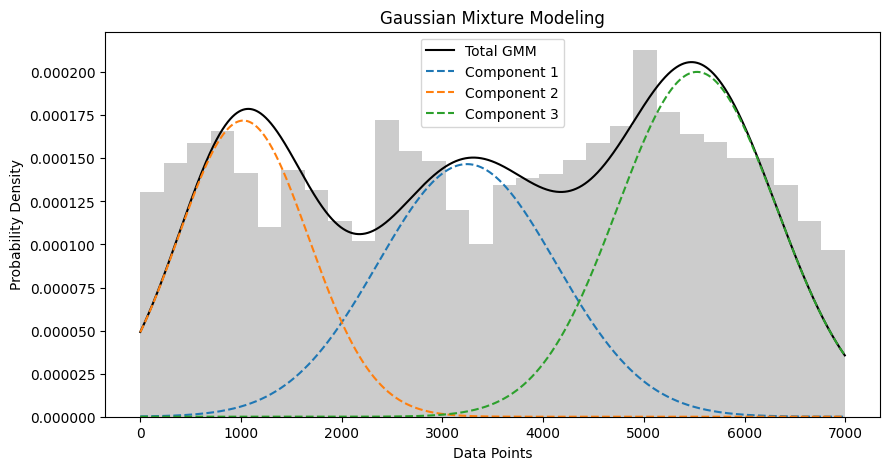

Client 64 - Means: [3243.54495679 1024.29631602 5527.06588648]
Client 64 - Covariances: [783820.79168892 417305.74652231 622977.9139109 ]
Client 64 - Weights (priors): [0.32548016 0.27843759 0.39608225]
mean of pdf 3530.084830689902
variance of pdf 3972638.3568114154


In [8]:
import csv
import numpy as np
import pandas as pd
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt

def process_client1(client_id, data):
    client_data = data.loc[data['client_id'] == client_id, ['datetime', 'target']]
    client_data['sample'] = range(1, len(client_data) + 1)
    
    client_target = client_data['target']
    target_sample = client_data['sample']
    
    vector = [sample for target, sample in zip(client_target, target_sample) for _ in range(int(target))]
    x = np.array(vector).reshape(-1, 1)
    
    gmm = GaussianMixture(n_components=3, random_state=0)
    gmm.fit(x)
    
    return gmm, x

# Plotting function for GMM
def plot_gmm(gmm, x):
    logprob = gmm.score_samples(x)
    responsibilities = gmm.predict_proba(x)
    pdf = np.exp(logprob)
    pdf_individual = responsibilities * pdf[:, np.newaxis]

    plt.figure(figsize=(10, 5))
    plt.hist(x, bins=30, density=True, alpha=0.4, color='gray')
    plt.plot(x.flatten(), pdf, '-k', label="Total GMM")
    for i in range(3):
        plt.plot(x.flatten(), pdf_individual[:, i], '--', label=f"Component {i+1}")
    plt.legend()
    plt.title('Gaussian Mixture Modeling')
    plt.xlabel('Data Points')
    plt.ylabel('Probability Density')
    plt.show()


def calculate_gmm_statistics(gmm):
    means = gmm.means_.flatten()  
    variances = gmm.covariances_.flatten()  
    weights = gmm.weights_.flatten()  
    
    weighted_mean = np.dot(weights, means)
    
    weighted_variance = np.dot(weights, variances) + np.dot(weights, (means - weighted_mean)**2)
    
    return weighted_mean, weighted_variance

# Function to save GMM parameters to CSV
def save_gmm_params_to_csv2(filename, data):
    with open(filename, 'w', newline='') as csvfile:
        # Create a CSV writer object
        writer = csv.writer(csvfile)
        # Write the header
        writer.writerow(['client_id', 'mean', 'covariance', 'weight','mean_pdf','covariance_pdf'])

        # Process each client_id and extract GMM parameters
        for client_id in range(1, 65):
            gmm, x = process_client1(client_id, data)
            mean_pdf,variance_pdf=calculate_gmm_statistics(gmm)
            # Retrieve means, covariances, and weights
            means = gmm.means_
            covariances = gmm.covariances_
            weights = gmm.weights_

            # Write GMM parameters to CSV for each client
            for i in range(means.shape[0]):
                mean_str = ','.join(map(str, means[i].flatten()))
                covariance_str = ','.join(map(str, covariances[i].flatten()))
                weight_str = str(weights[i])
                
                # Write the parameters for each component of the GMM for the client
                writer.writerow([client_id, mean_str, covariance_str, weight_str,mean_pdf,variance_pdf])

# Usage
# Assume 'data' is available from somewhere
filename = 'gmm_parameters.csv'
save_gmm_params_to_csv2(filename, data)

for client_id in range(1, 65):
    gmm, x = process_client1(client_id, data)
    mean_pdf, variance_pdf = calculate_gmm_statistics(gmm)
    plot_gmm(gmm, x)  
    print(f"Client {client_id} - Means:", gmm.means_.flatten())
    print(f"Client {client_id} - Covariances:", gmm.covariances_.flatten())
    print(f"Client {client_id} - Weights (priors):", gmm.weights_)
    print('mean of pdf', mean_pdf)
    print('variance of pdf', variance_pdf)





**for production**

In [17]:
data1

,Unnamed: 0,datetime,product_type,county,eic_count,installed_capacity,is_business,target,temperature,dewpoint,...,highest_price_per_mwh,elect_prices,hour,dayofweek,quarter,month,year,dayofyear,day,client_id
0,0,2021-09-01,1,0,108,952.89,0,0.713,13.60,10.60,...,46.32,92.51,0,2,3,9,2021,244,1,2
1,1,2021-09-01,2,0,17,166.40,0,0.000,13.60,10.60,...,46.32,92.51,0,2,3,9,2021,244,1,4
2,2,2021-09-01,3,0,688,7207.88,0,2.904,13.60,10.60,...,46.32,92.51,0,2,3,9,2021,244,1,6
3,3,2021-09-01,0,0,5,400.00,1,0.000,13.60,10.60,...,46.32,92.51,0,2,3,9,2021,244,1,1
4,4,2021-09-01,1,0,43,1411.00,1,0.000,13.60,10.60,...,46.32,92.51,0,2,3,9,2021,244,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
445883,445883,2023-05-29,1,15,51,415.60,0,224.109,15.68,7.18,...,36.98,3.49,0,0,2,5,2023,149,29,62
445884,445884,2023-05-29,3,15,161,2035.75,0,1072.256,15.68,7.18,...,36.98,3.49,0,0,2,5,2023,149,29,64
445885,445885,2023-05-29,0,15,15,620.00,1,170.411,15.68,7.18,...,36.98,3.49,0,0,2,5,2023,149,29,61
445886,445886,2023-05-29,1,15,20,624.50,1,329.412,15.68,7.18,...,36.98,3.49,0,0,2,5,2023,149,29,63


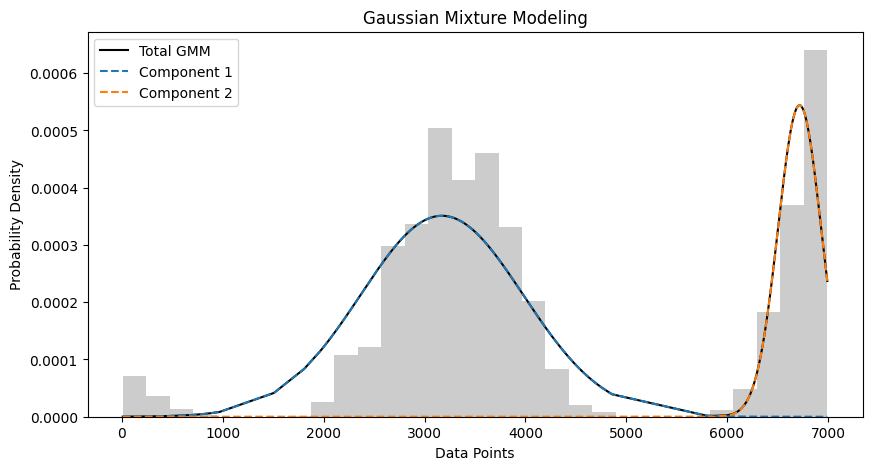

Client 1 - Means: [3172.66578989 6719.20622389]
Client 1 - Covariances: [650201.75364269  45460.41282184]
Client 1 - Weights (priors): [0.70926287 0.29073713]
mean of pdf 4203.776772809253
variance of pdf 3068067.9263209384


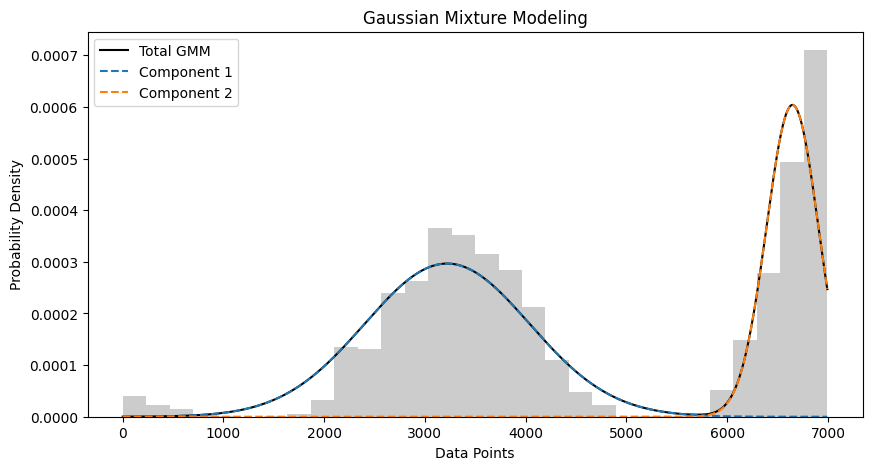

Client 2 - Means: [3220.87446038 6648.32548453]
Client 2 - Covariances: [669818.61198923  66861.90879458]
Client 2 - Weights (priors): [0.6085969 0.3914031]
mean of pdf 4562.38940737912
variance of pdf 3232133.916760576


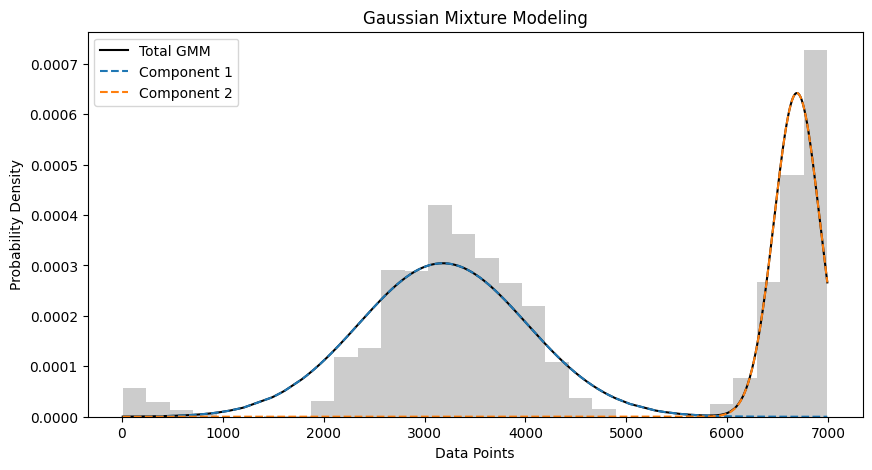

Client 3 - Means: [3181.52945605 6692.7210409 ]
Client 3 - Covariances: [692407.24077056  51601.57688708]
Client 3 - Weights (priors): [0.63459874 0.36540126]
mean of pdf 4464.523283086218
variance of pdf 3317020.012858136


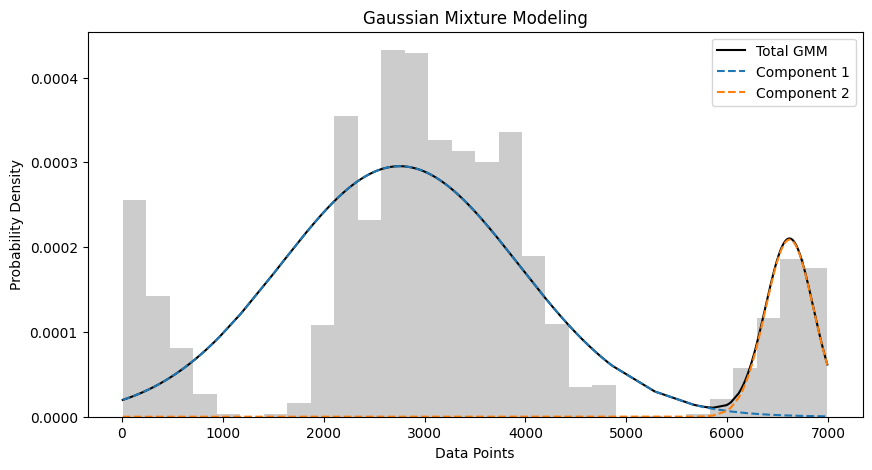

Client 4 - Means: [2753.62520222 6619.77515831]
Client 4 - Covariances: [1395598.31162733   57058.4863145 ]
Client 4 - Weights (priors): [0.87494072 0.12505928]
mean of pdf 3237.1231479787625
variance of pdf 2863706.777546373


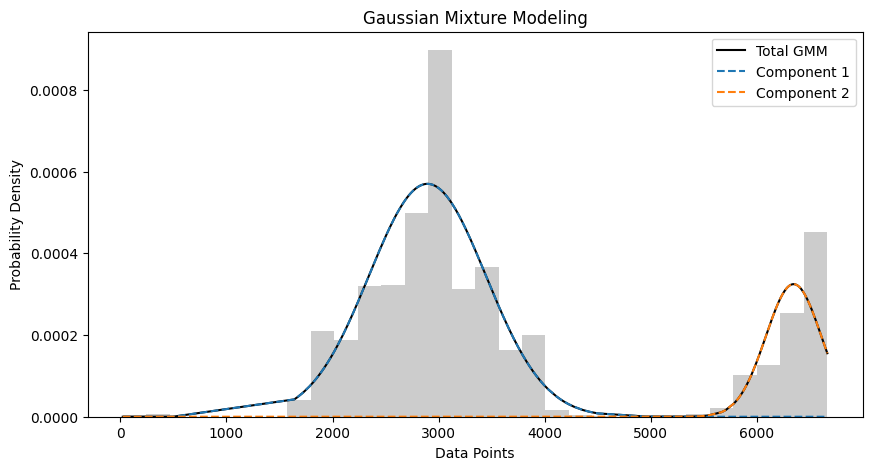

Client 5 - Means: [2894.19704274 6346.28807007]
Client 5 - Covariances: [303171.15147086  68568.51405479]
Client 5 - Weights (priors): [0.7869326 0.2130674]
mean of pdf 3629.72510130088
variance of pdf 2251293.263949623


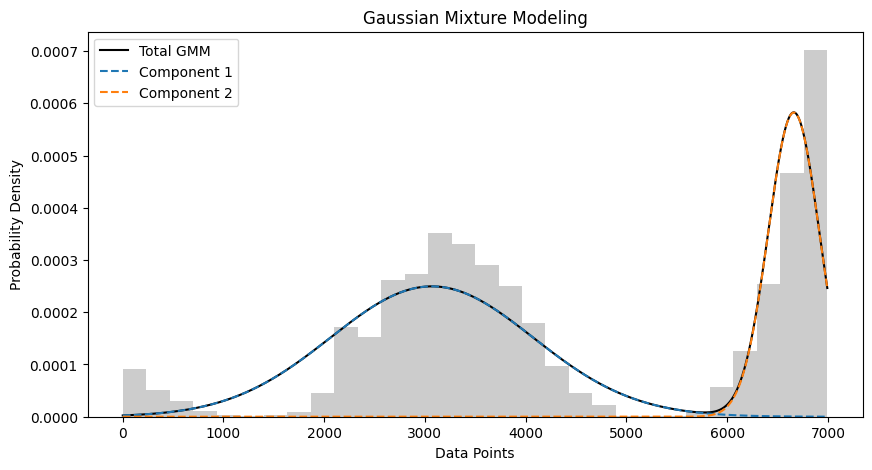

Client 6 - Means: [3068.83481409 6661.36731426]
Client 6 - Covariances: [1013547.56764118   64303.18498553]
Client 6 - Weights (priors): [0.62987987 0.37012013]
mean of pdf 4398.503423328415
variance of pdf 3671072.192590405


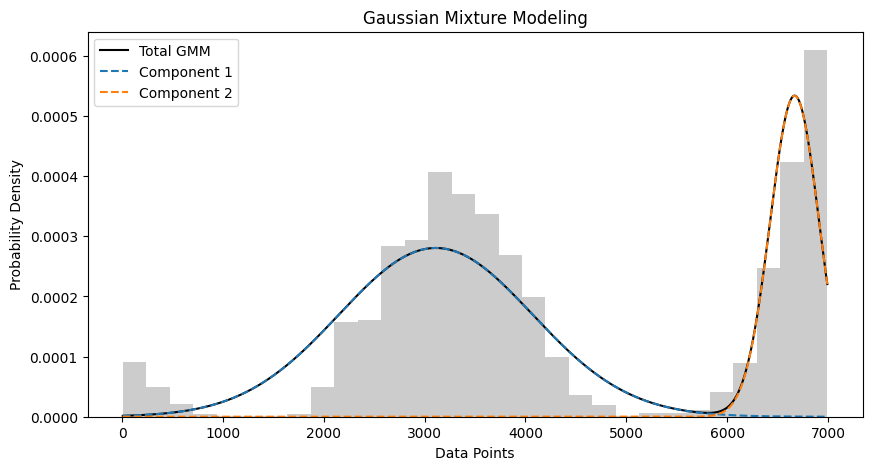

Client 7 - Means: [3111.11314468 6670.05217022]
Client 7 - Covariances: [918809.34905666  59378.09561977]
Client 7 - Weights (priors): [0.67411551 0.32588449]
mean of pdf 4270.916175996148
variance of pdf 3421259.2314897776


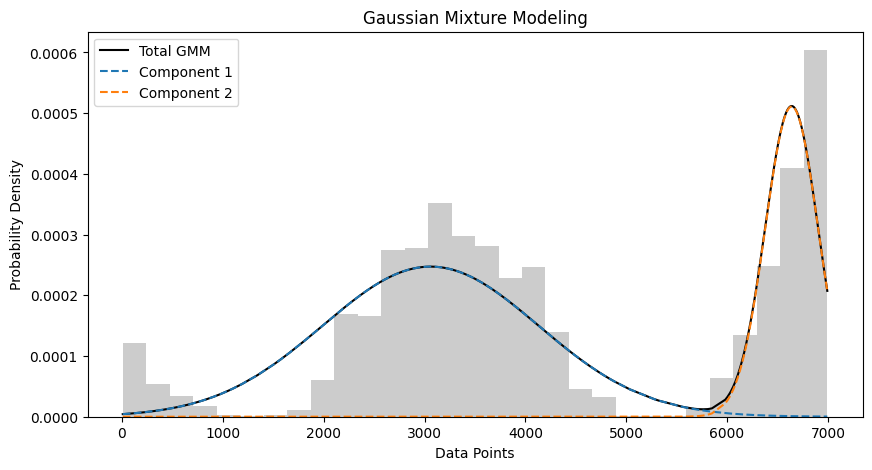

Client 8 - Means: [3060.20835628 6640.89113389]
Client 8 - Covariances: [1146882.49939836   68995.97367903]
Client 8 - Weights (priors): [0.66364834 0.33635166]
mean of pdf 4264.5769541946565
variance of pdf 3646291.7534765806


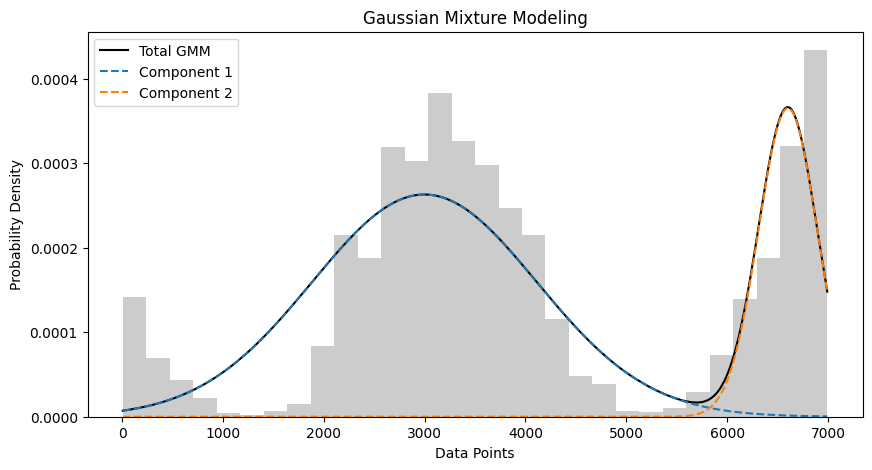

Client 9 - Means: [2998.58311671 6602.92028232]
Client 9 - Covariances: [1239935.09289091   84480.5771555 ]
Client 9 - Weights (priors): [0.73402567 0.26597433]
mean of pdf 3957.2442964217375
variance of pdf 3468920.708537927


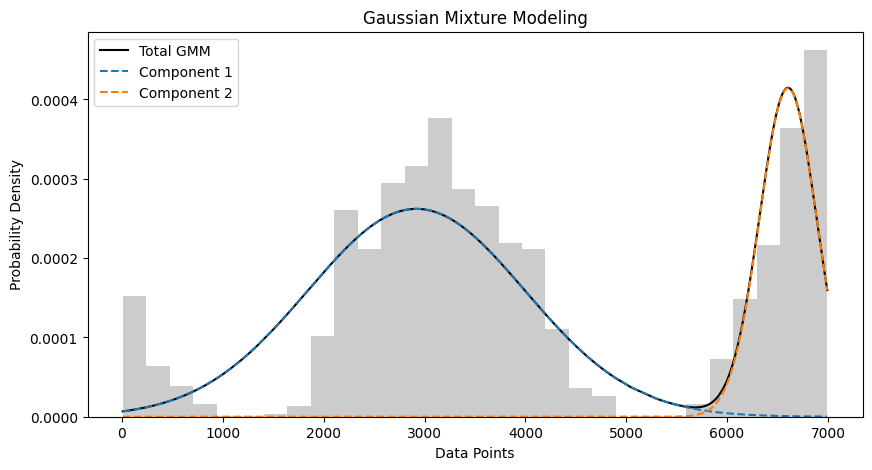

Client 10 - Means: [2919.49726971 6604.61680549]
Client 10 - Covariances: [1159781.05668168   79462.32646834]
Client 10 - Weights (priors): [0.70742425 0.29257575]
mean of pdf 3997.673876668042
variance of pdf 3654450.876965704


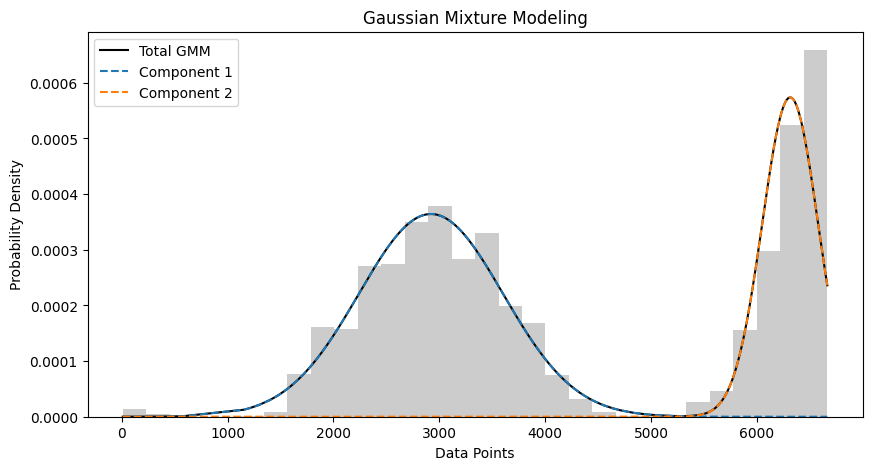

Client 11 - Means: [2920.834328  6313.3386341]
Client 11 - Covariances: [463457.12044579  69269.43623389]
Client 11 - Weights (priors): [0.62150866 0.37849134]
mean of pdf 4204.867826705449
variance of pdf 3021607.643618067


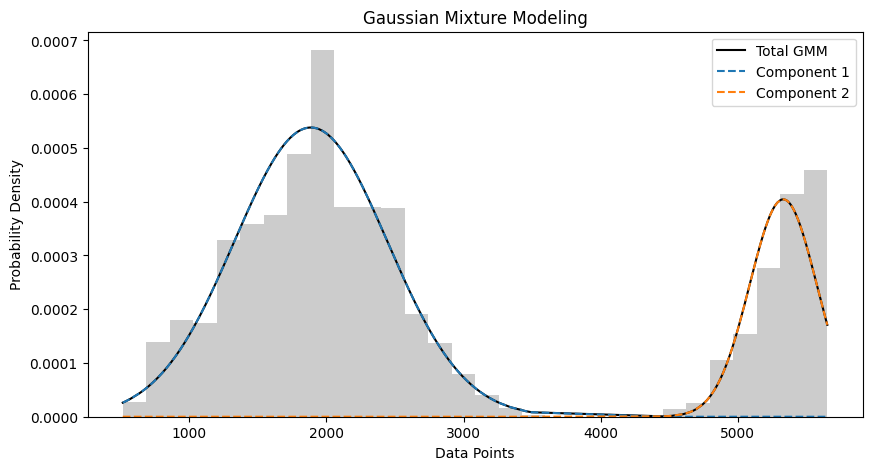

Client 12 - Means: [1887.05223593 5330.63939572]
Client 12 - Covariances: [310695.39343114  59987.31371997]
Client 12 - Weights (priors): [0.75172638 0.24827362]
mean of pdf 2742.004095004084
variance of pdf 2461609.7530554626


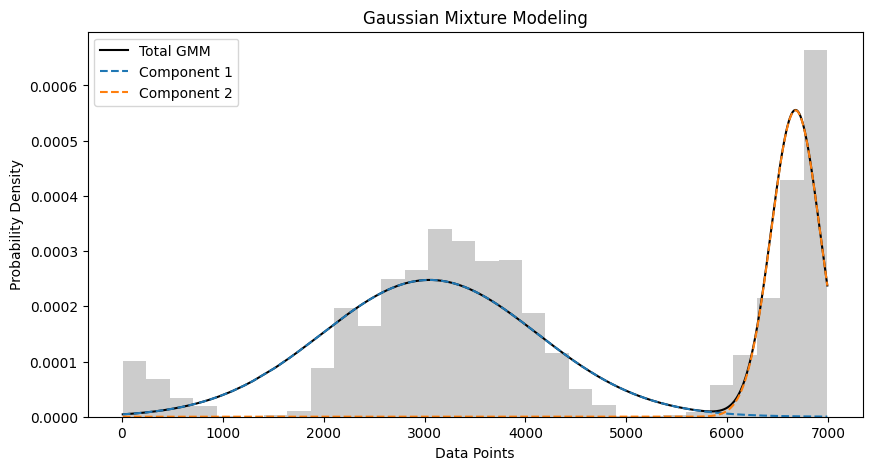

Client 13 - Means: [3050.71468757 6679.07996804]
Client 13 - Covariances: [1142875.06124022   58415.08712147]
Client 13 - Weights (priors): [0.66387195 0.33612805]
mean of pdf 4270.310017906289
variance of pdf 3716082.2326949085


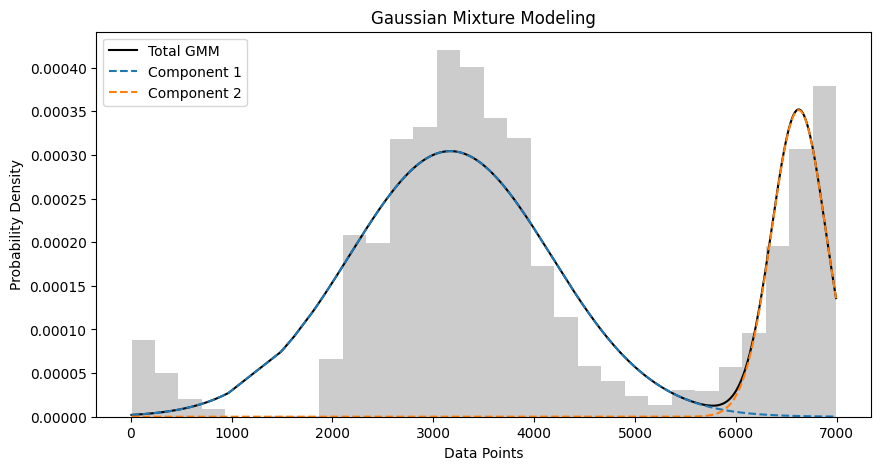

Client 14 - Means: [3168.12296963 6623.54331267]
Client 14 - Covariances: [1001638.99906593   72160.6052382 ]
Client 14 - Weights (priors): [0.76346213 0.23653787]
mean of pdf 3985.4607441489743
variance of pdf 2937986.6933525726


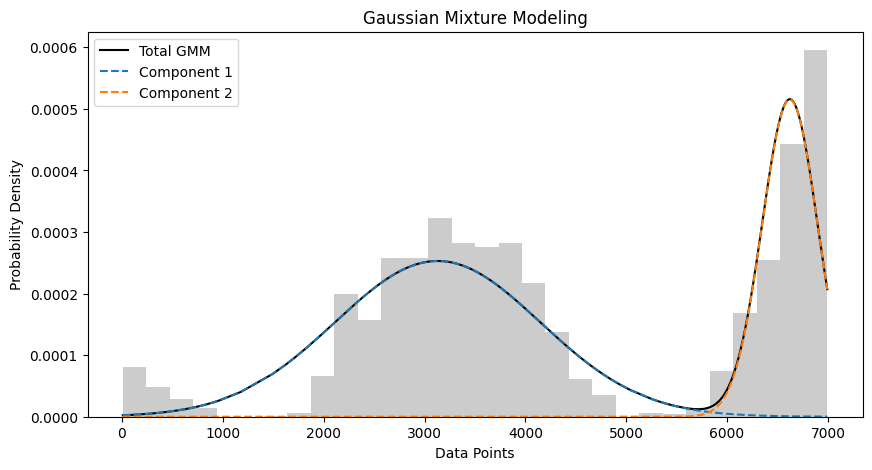

Client 15 - Means: [3129.94194493 6622.99279389]
Client 15 - Covariances: [1036208.34516877   75438.2953862 ]
Client 15 - Weights (priors): [0.64539576 0.35460424]
mean of pdf 4368.592585989247
variance of pdf 3487929.474711063


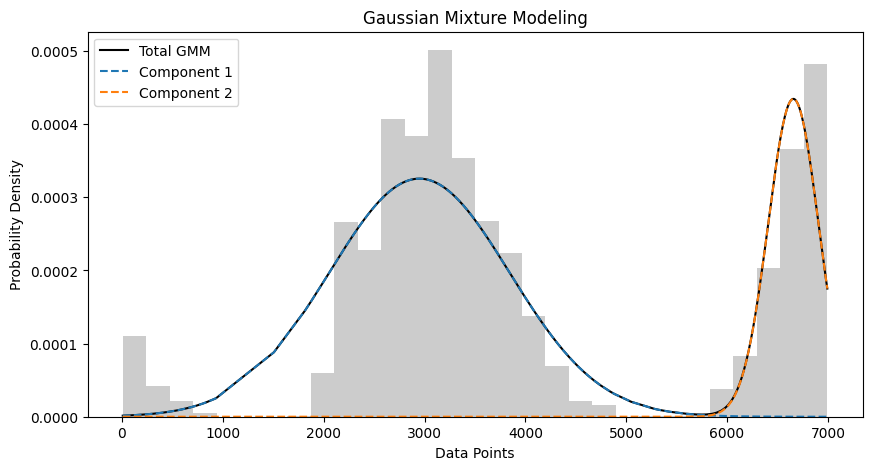

Client 16 - Means: [2949.51845328 6657.46350422]
Client 16 - Covariances: [796428.18513075  62356.77807618]
Client 16 - Weights (priors): [0.72804395 0.27195605]
mean of pdf 3957.916542334907
variance of pdf 3319011.0226422865


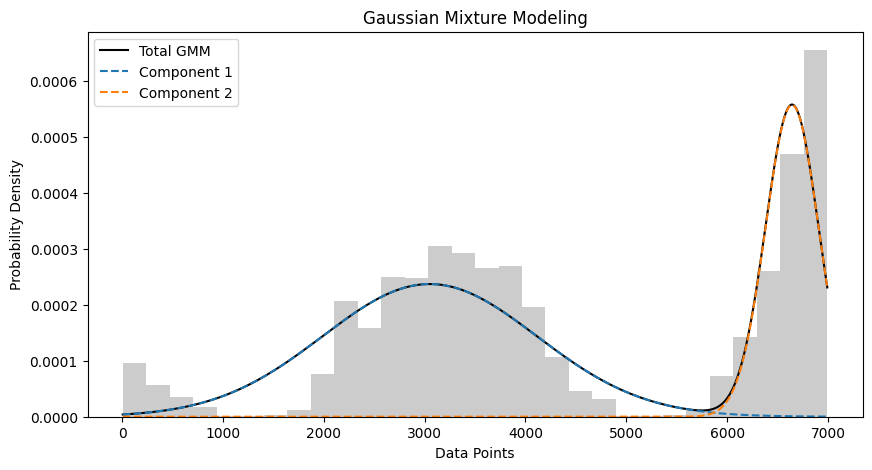

Client 17 - Means: [3051.46568068 6644.48839246]
Client 17 - Covariances: [1130704.90980855   69310.04032826]
Client 17 - Weights (priors): [0.63219665 0.36780335]
mean of pdf 4372.991462699052
variance of pdf 3742162.0799561124


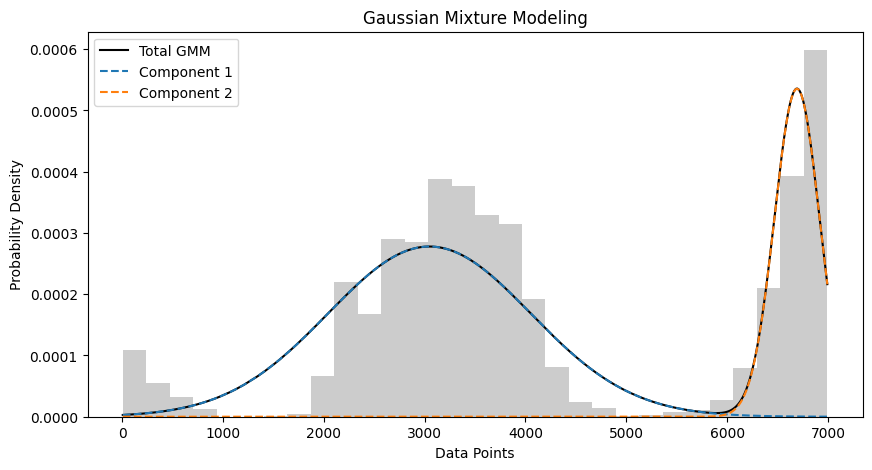

Client 18 - Means: [3047.84393828 6693.20276607]
Client 18 - Covariances: [1010381.89229825   49914.62533112]
Client 18 - Weights (priors): [0.70017295 0.29982705]
mean of pdf 4140.821126400138
variance of pdf 3512102.731350817


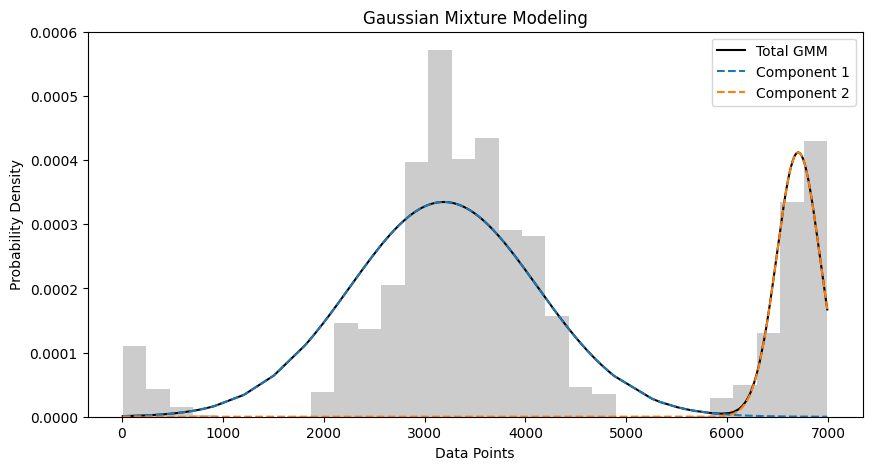

Client 19 - Means: [3191.07730546 6705.75145642]
Client 19 - Covariances: [859570.13358829  46076.09526372]
Client 19 - Weights (priors): [0.7783582 0.2216418]
mean of pdf 3970.076028006586
variance of pdf 2810353.5106709357


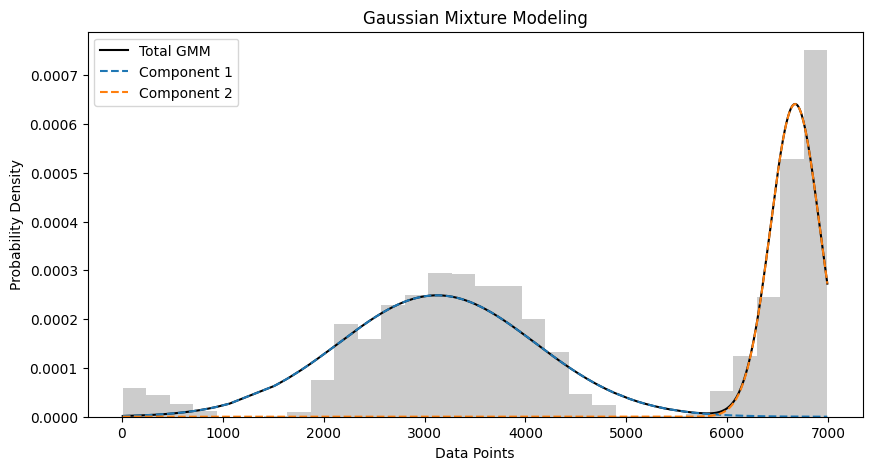

Client 20 - Means: [3124.6400347  6674.96466373]
Client 20 - Covariances: [950193.81010804  59591.68392212]
Client 20 - Weights (priors): [0.60795709 0.39204291]
mean of pdf 4516.519633066603
variance of pdf 3605335.163435017


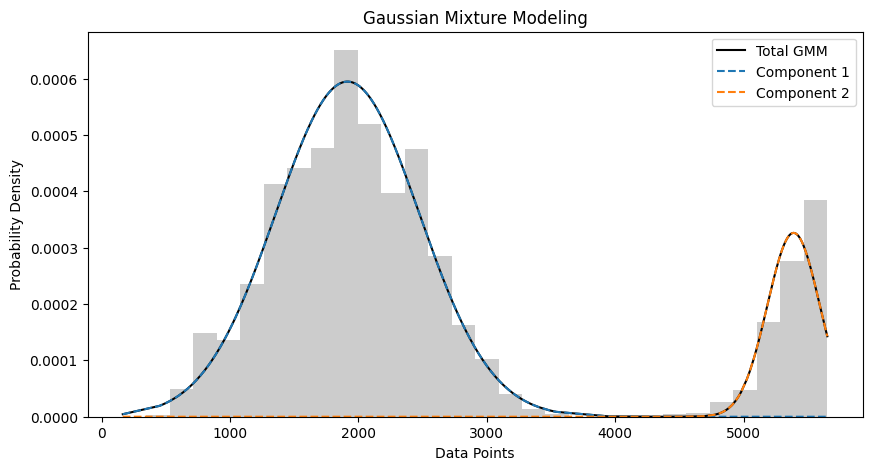

Client 21 - Means: [1915.01992183 5389.5747658 ]
Client 21 - Covariances: [312482.18213135  41681.05173569]
Client 21 - Weights (priors): [0.83308578 0.16691422]
mean of pdf 2494.972524459059
variance of pdf 1946013.7268084234


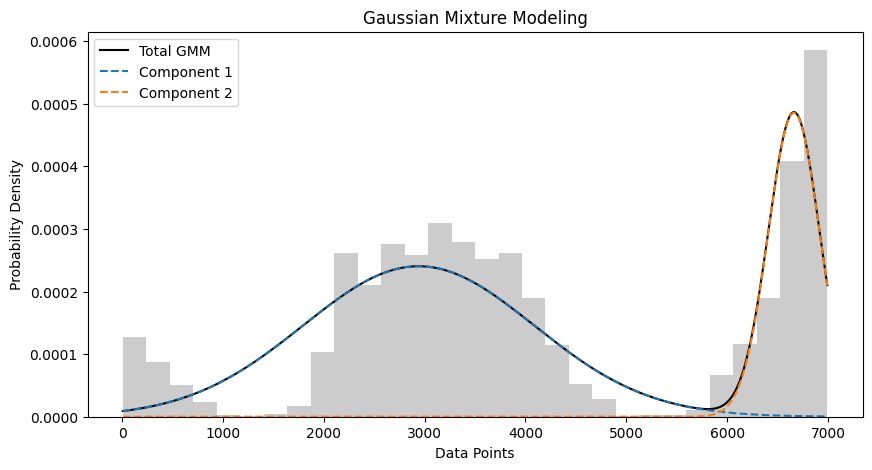

Client 22 - Means: [2941.43675036 6663.92427476]
Client 22 - Covariances: [1311491.59260838   64915.64941051]
Client 22 - Weights (priors): [0.69000905 0.30999095]
mean of pdf 4095.3742026862374
variance of pdf 3889010.45530428


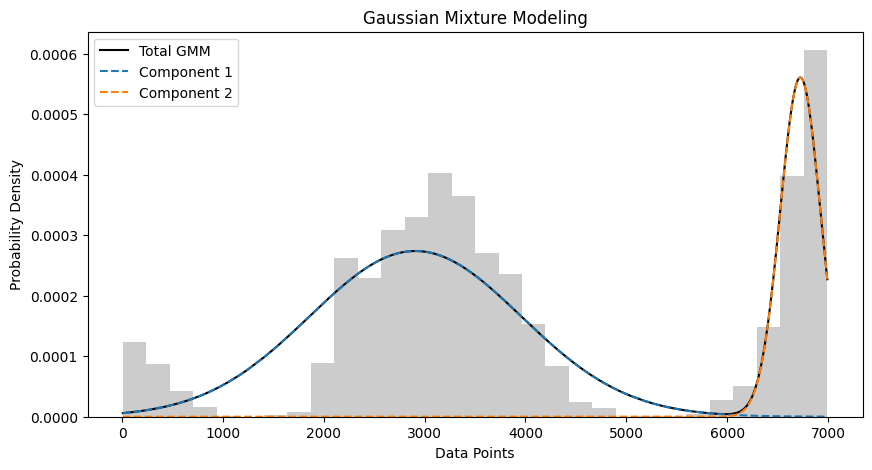

Client 23 - Means: [2908.93419543 6726.32460079]
Client 23 - Covariances: [1099244.54747057   39660.93955596]
Client 23 - Weights (priors): [0.72013923 0.27986077]
mean of pdf 3977.272007666533
variance of pdf 3739625.49780255


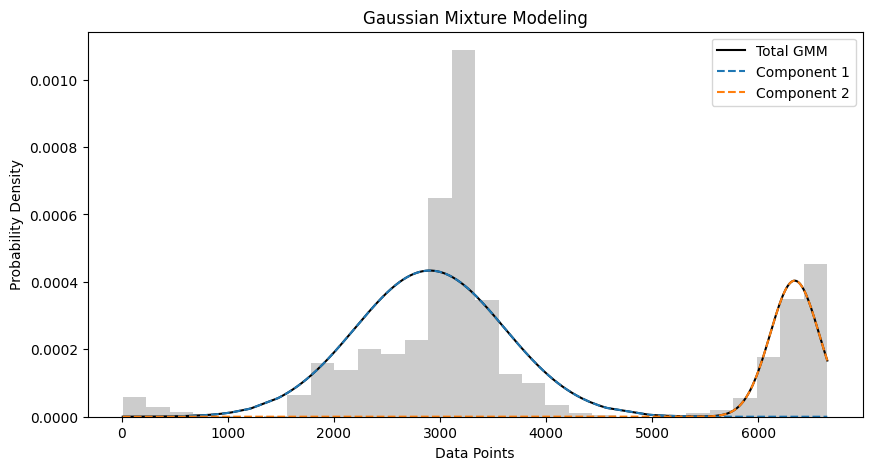

Client 24 - Means: [2903.73406474 6345.17093039]
Client 24 - Covariances: [496794.03840485  53612.27340224]
Client 24 - Weights (priors): [0.76581664 0.23418336]
mean of pdf 3709.6613272080904
variance of pdf 2517037.281490901


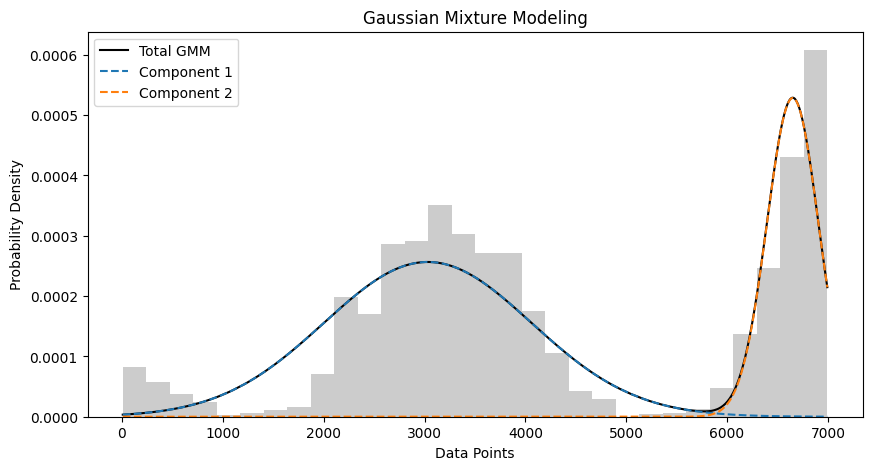

Client 25 - Means: [3031.7659304  6651.03764005]
Client 25 - Covariances: [1058822.0319784    65271.62958879]
Client 25 - Weights (priors): [0.66165218 0.33834782]
mean of pdf 4256.338629640826
variance of pdf 3655139.448596498


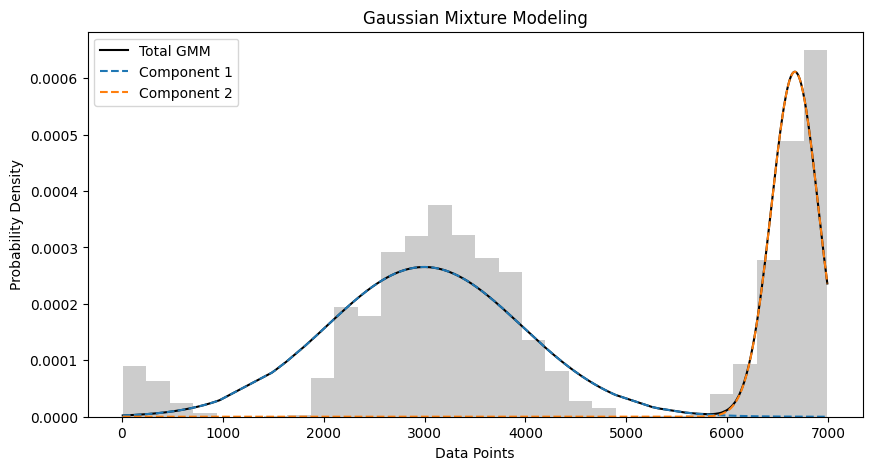

Client 26 - Means: [2997.38361519 6672.16009692]
Client 26 - Covariances: [933390.55088304  54448.85361845]
Client 26 - Weights (priors): [0.64249963 0.35750037]
mean of pdf 4311.1175821566
variance of pdf 3720950.314397934


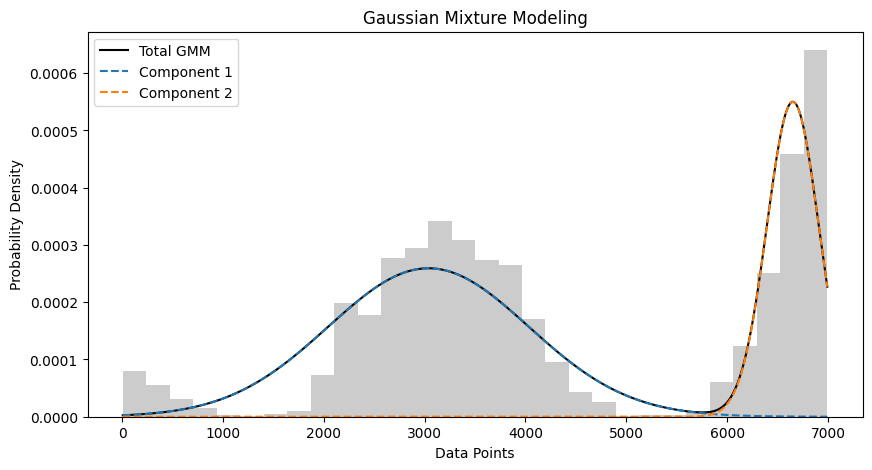

Client 27 - Means: [3038.95993325 6652.31447397]
Client 27 - Covariances: [988419.20398227  65995.75723747]
Client 27 - Weights (priors): [0.64604239 0.35395761]
mean of pdf 4317.93427053576
variance of pdf 3647532.7790341163


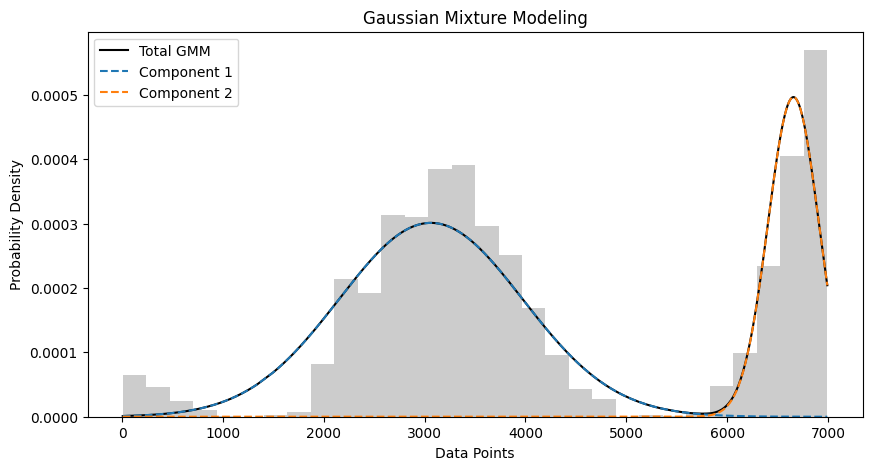

Client 28 - Means: [3062.46451626 6658.26345525]
Client 28 - Covariances: [828290.81115063  63453.62778576]
Client 28 - Weights (priors): [0.68668453 0.31331547]
mean of pdf 4189.083943004627
variance of pdf 3370481.097863815


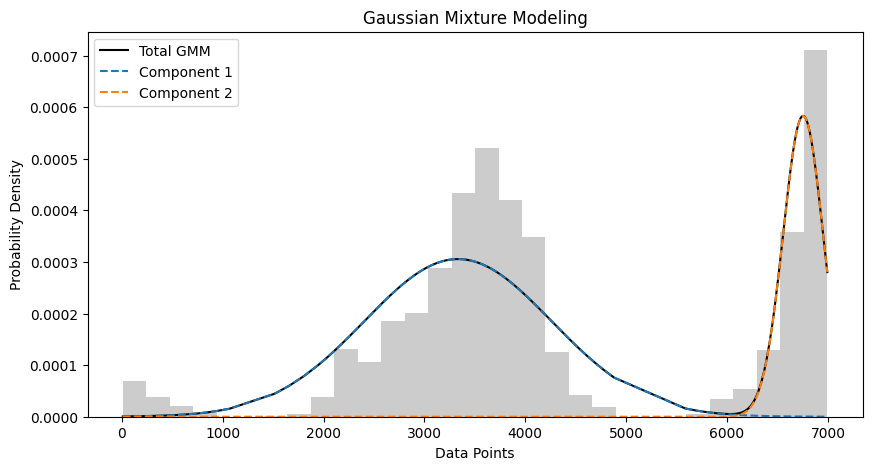

Client 29 - Means: [3332.52077984 6754.20019746]
Client 29 - Covariances: [860413.68709795  39234.74061781]
Client 29 - Weights (priors): [0.71055917 0.28944083]
mean of pdf 4322.8945114214375
variance of pdf 3030632.255925523


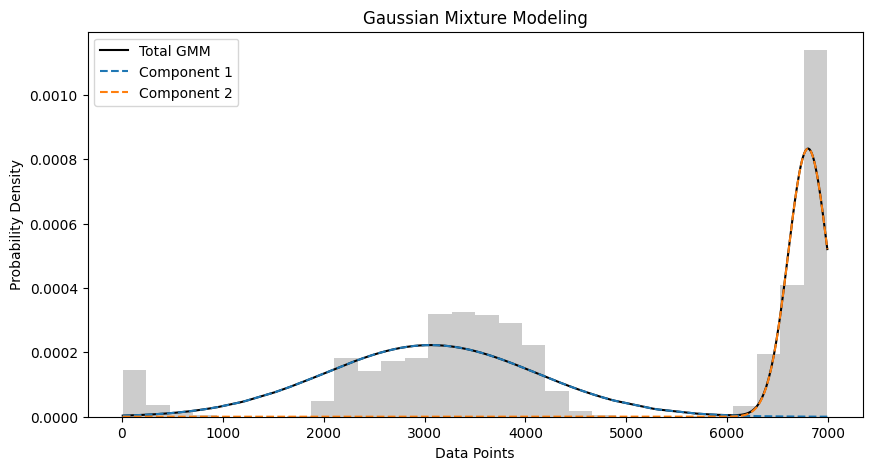

Client 30 - Means: [3060.97766709 6802.86275164]
Client 30 - Covariances: [1111023.74956083   38881.86195122]
Client 30 - Weights (priors): [0.58827435 0.41172565]
mean of pdf 4601.607719991549
variance of pdf 4060915.0943520414


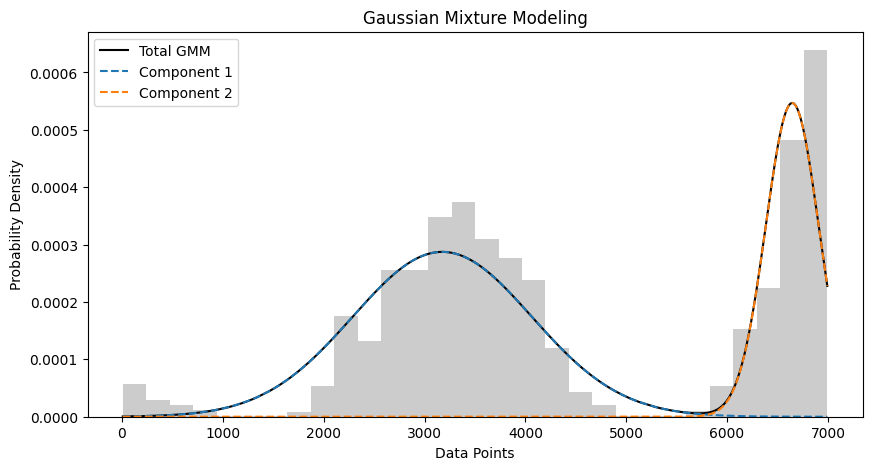

Client 31 - Means: [3176.02241008 6646.29071251]
Client 31 - Covariances: [789289.17565763  69147.9026211 ]
Client 31 - Weights (priors): [0.63970162 0.36029838]
mean of pdf 4426.354456817973
variance of pdf 3305480.883977645


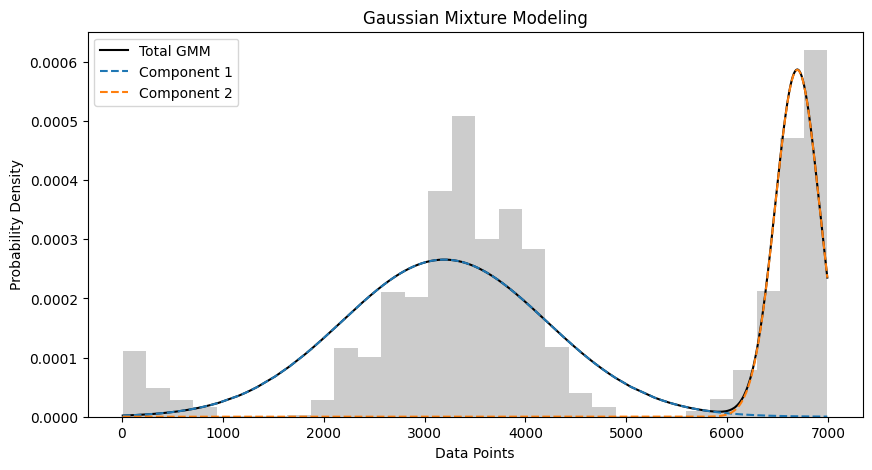

Client 32 - Means: [3195.41732716 6696.80625398]
Client 32 - Covariances: [1032046.18821672   48300.74551714]
Client 32 - Weights (priors): [0.67679607 0.32320393]
mean of pdf 4327.07998979414
variance of pdf 3395826.5285833636


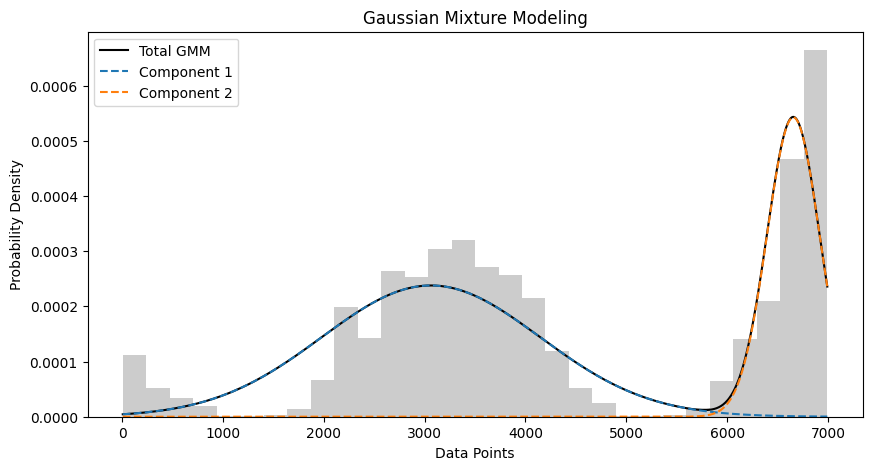

Client 33 - Means: [3063.31571054 6656.86474709]
Client 33 - Covariances: [1170975.89538919   68140.64985976]
Client 33 - Weights (priors): [0.64510398 0.35489602]
mean of pdf 4338.651968366489
variance of pdf 3736084.8639261895


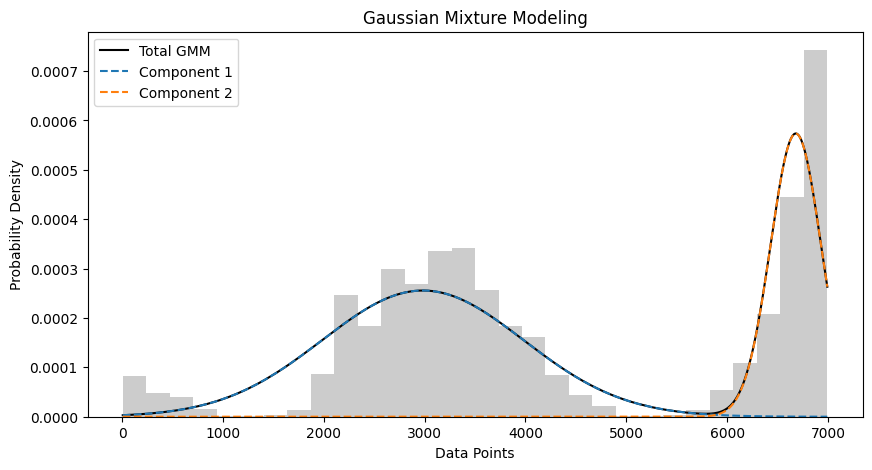

Client 34 - Means: [2983.33378922 6681.65864137]
Client 34 - Covariances: [999215.81569903  62645.52804806]
Client 34 - Weights (priors): [0.64032841 0.35967159]
mean of pdf 4313.516155193118
variance of pdf 3812419.469946842


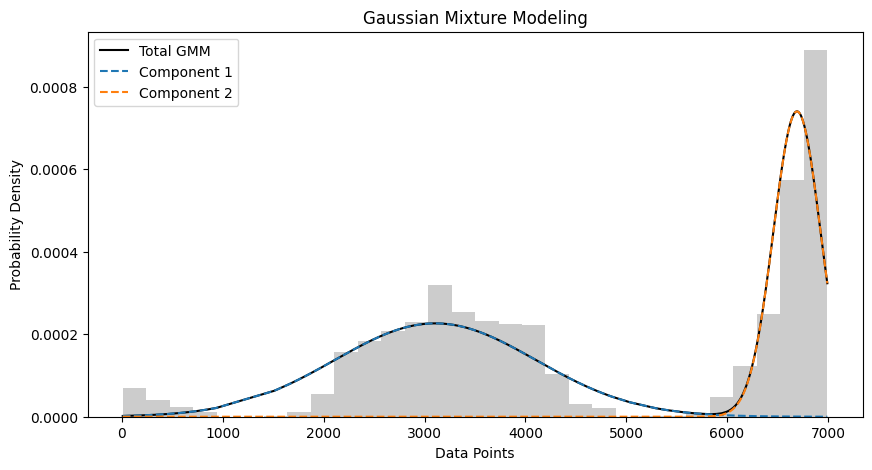

Client 35 - Means: [3107.40944784 6693.45573111]
Client 35 - Covariances: [997251.67718838  54573.10794069]
Client 35 - Weights (priors): [0.56658193 0.43341807]
mean of pdf 4661.666695653764
variance of pdf 3746600.588410734


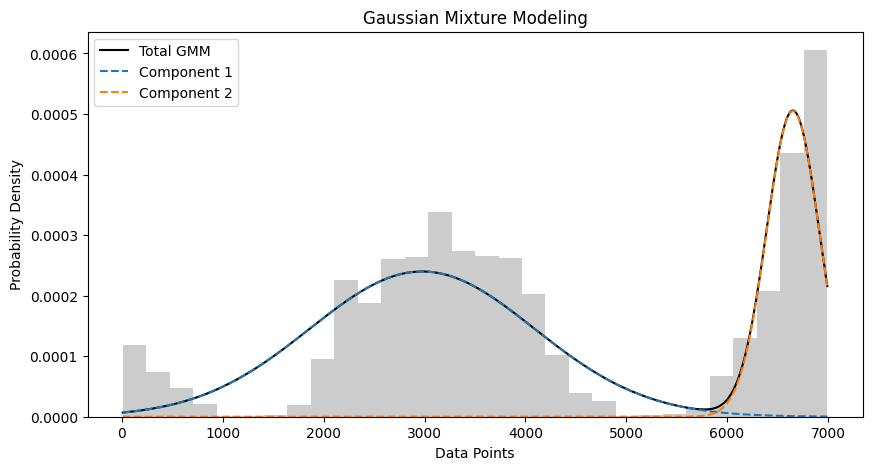

Client 36 - Means: [2976.48824296 6653.19054778]
Client 36 - Covariances: [1239348.91883361   68230.89150016]
Client 36 - Weights (priors): [0.66947747 0.33052253]
mean of pdf 4191.721176502819
variance of pdf 3843526.6749525


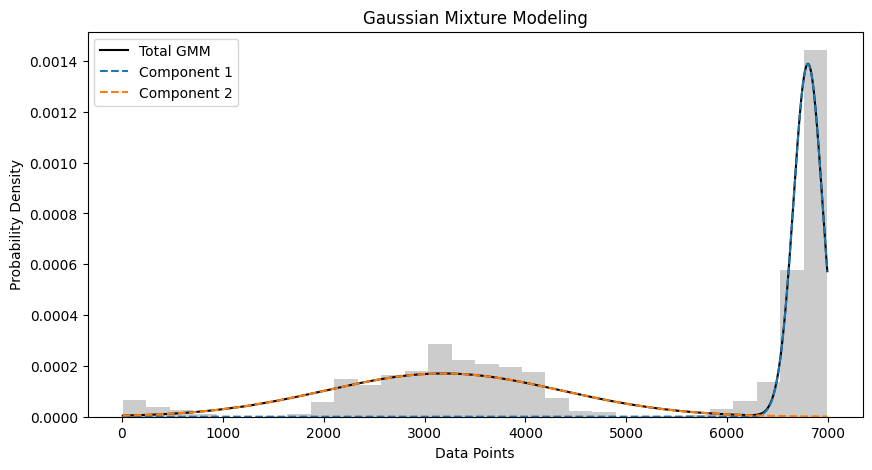

Client 37 - Means: [6802.10278135 3188.35138096]
Client 37 - Covariances: [  20767.28396895 1365922.34084598]
Client 37 - Weights (priors): [0.50127568 0.49872432]
mean of pdf 4999.837085066547
variance of pdf 3956407.363780154


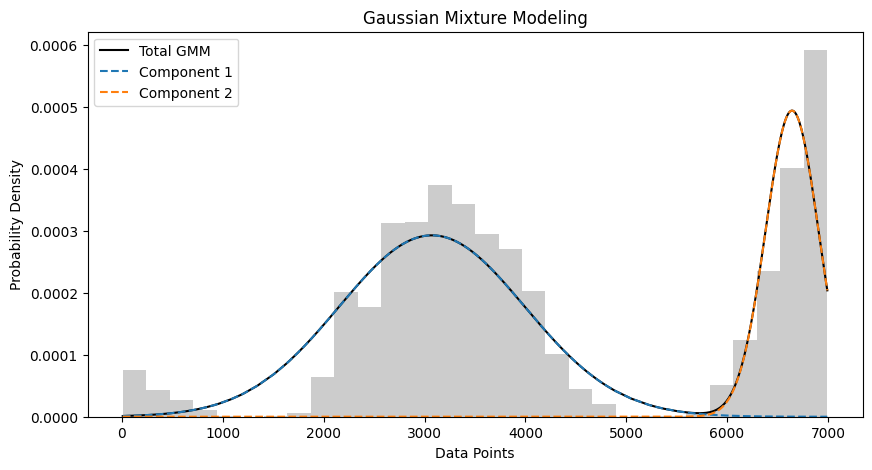

Client 38 - Means: [3073.68829319 6644.38794594]
Client 38 - Covariances: [847863.71288742  69083.26586314]
Client 38 - Weights (priors): [0.67492895 0.32507105]
mean of pdf 4234.419376518084
variance of pdf 3392030.164060671


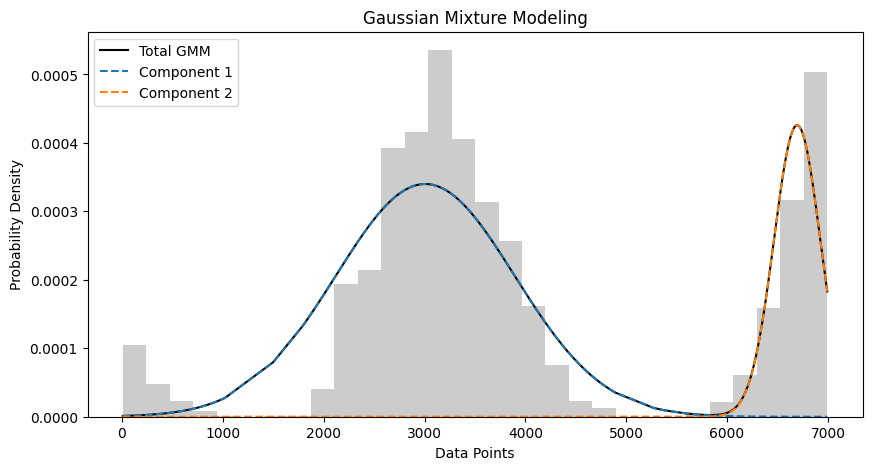

Client 39 - Means: [3007.21139623 6695.00778475]
Client 39 - Covariances: [784068.48646687  52928.37062935]
Client 39 - Weights (priors): [0.75447243 0.24552757]
mean of pdf 3912.6670736032165
variance of pdf 3123839.625479948


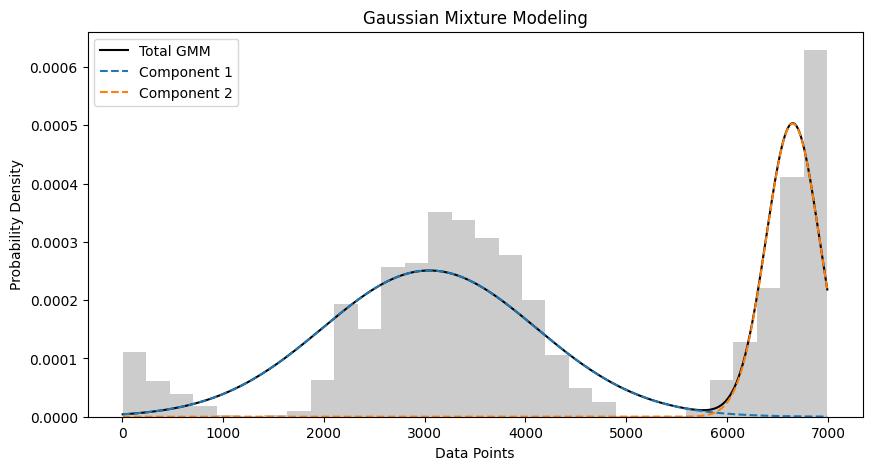

Client 40 - Means: [3047.9035866  6651.74865039]
Client 40 - Covariances: [1123254.72715097   70107.22127681]
Client 40 - Weights (priors): [0.66636876 0.33363124]
mean of pdf 4250.258897172284
variance of pdf 3659335.773083798


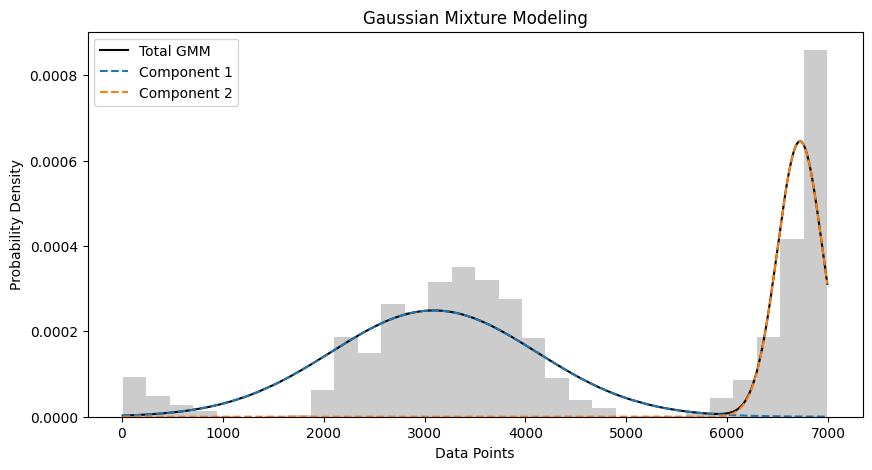

Client 41 - Means: [3091.90793427 6723.41008801]
Client 41 - Covariances: [1044010.76907578   50270.37952337]
Client 41 - Weights (priors): [0.63763606 0.36236394]
mean of pdf 4407.833361928713
variance of pdf 3731041.379971519


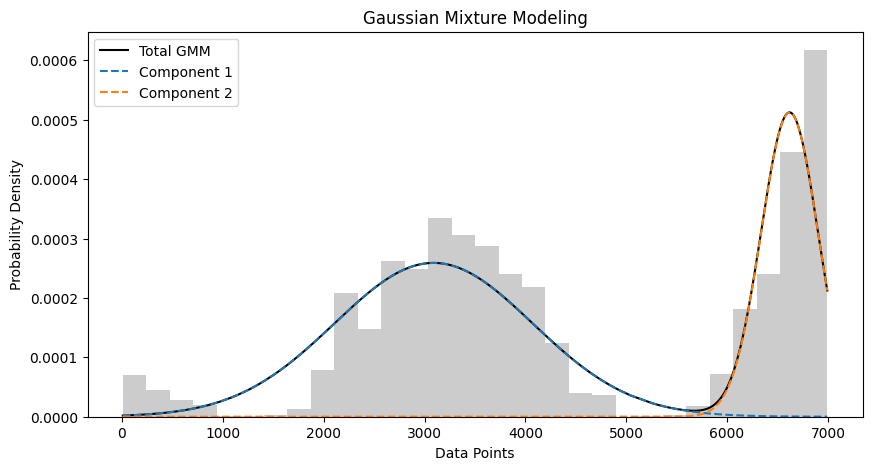

Client 42 - Means: [3089.8745201  6619.85295263]
Client 42 - Covariances: [965932.09655782  79556.87509168]
Client 42 - Weights (priors): [0.63798944 0.36201056]
mean of pdf 4367.7640043635565
variance of pdf 3522975.687077799


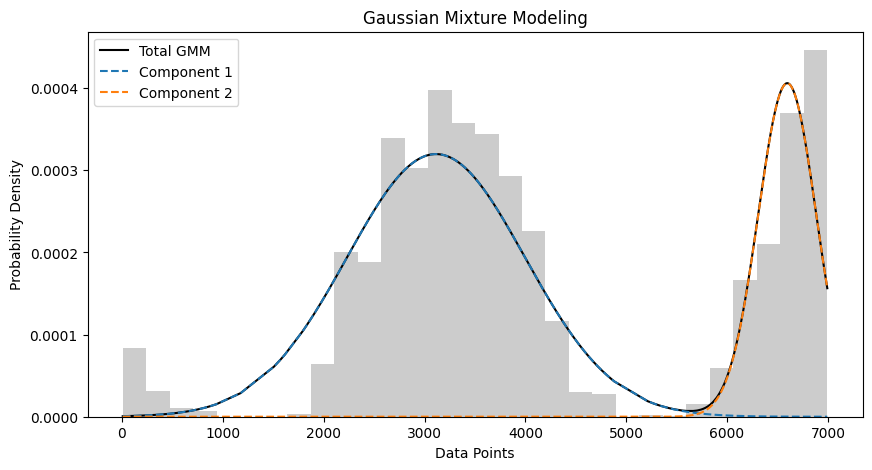

Client 43 - Means: [3114.05825382 6596.87956381]
Client 43 - Covariances: [778853.54620166  82692.85331877]
Client 43 - Weights (priors): [0.7073746 0.2926254]
mean of pdf 4133.220238872396
variance of pdf 3086007.1718655745


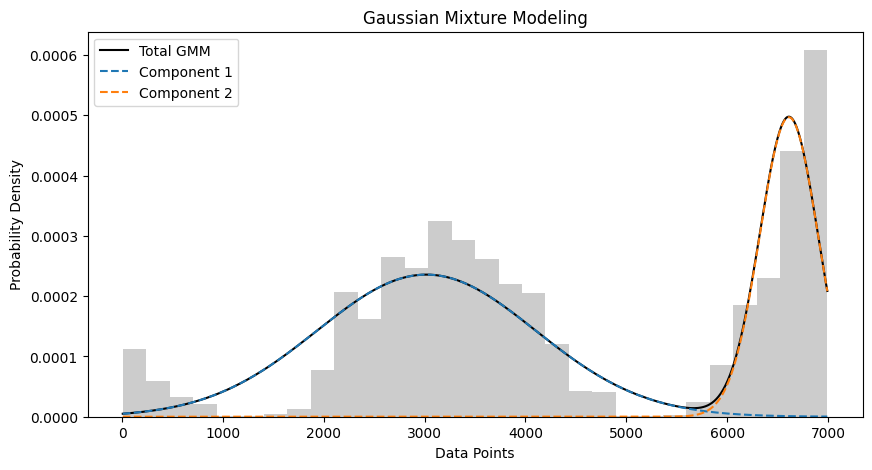

Client 44 - Means: [3017.91145381 6613.00877738]
Client 44 - Covariances: [1173703.11341745   83517.97003463]
Client 44 - Weights (priors): [0.64013843 0.35986157]
mean of pdf 4311.648804757517
variance of pdf 3758742.735606961


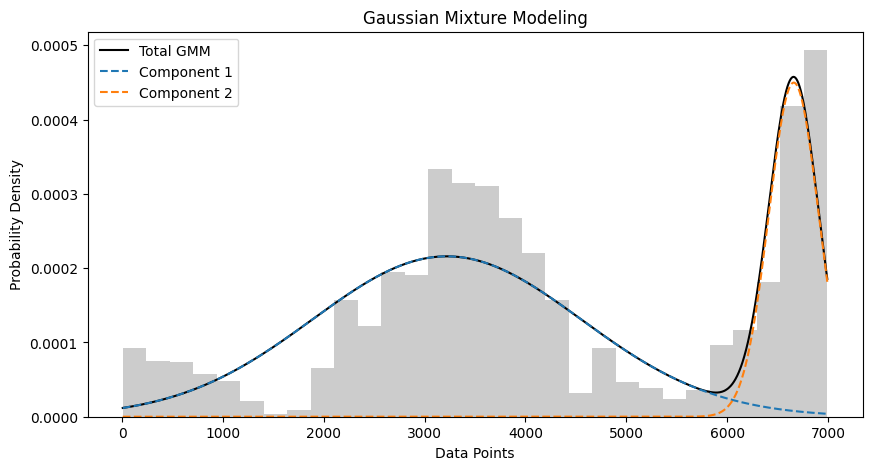

Client 45 - Means: [3220.86525938 6661.26591318]
Client 45 - Covariances: [1776361.82854509   61041.9004056 ]
Client 45 - Weights (priors): [0.72142924 0.27857076]
mean of pdf 4179.260278676497
variance of pdf 3677265.6932521015


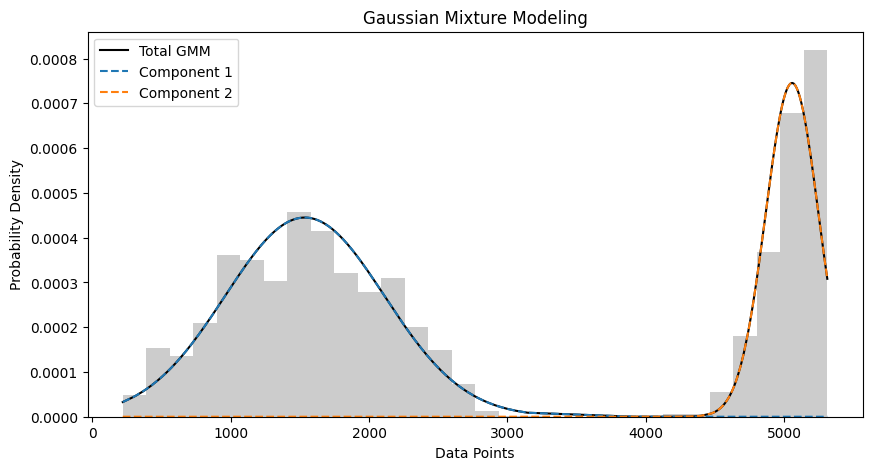

Client 46 - Means: [1535.33357339 5056.40252373]
Client 46 - Covariances: [331599.0813688   36674.23635079]
Client 46 - Weights (priors): [0.64216493 0.35783507]
mean of pdf 2795.295520287735
variance of pdf 3074973.411639171


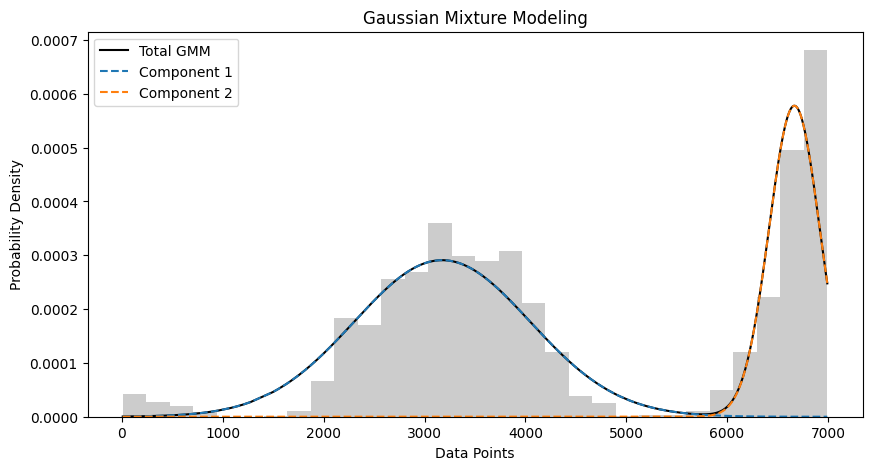

Client 47 - Means: [3175.22378381 6667.66619072]
Client 47 - Covariances: [762398.09938601  62887.20811507]
Client 47 - Weights (priors): [0.63675254 0.36324746]
mean of pdf 4443.844605720971
variance of pdf 3329488.914157517


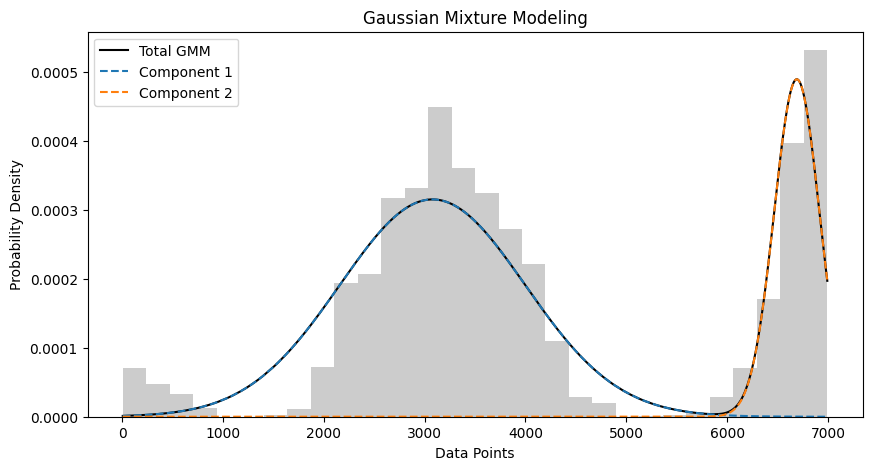

Client 48 - Means: [3078.66390304 6691.62163051]
Client 48 - Covariances: [843825.10661995  50262.53920629]
Client 48 - Weights (priors): [0.72520174 0.27479826]
mean of pdf 4071.4984071191934
variance of pdf 3227104.23343958


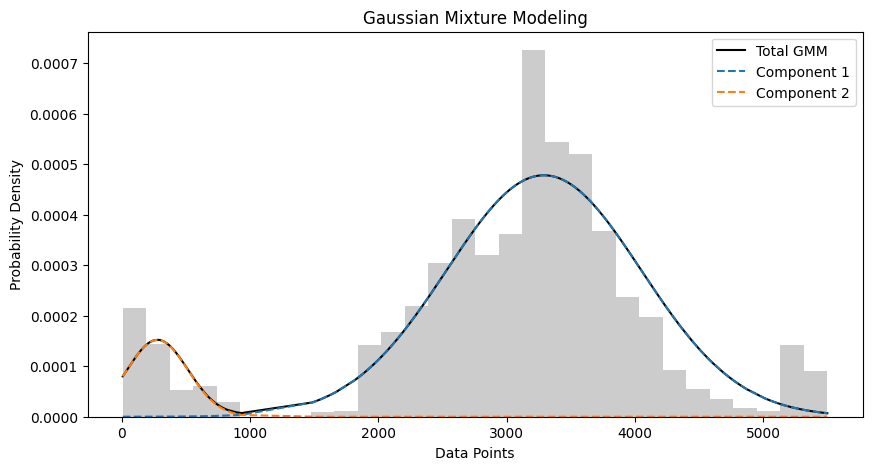

Client 49 - Means: [3290.49195336  278.45310566]
Client 49 - Covariances: [575763.01120165  56922.30771831]
Client 49 - Weights (priors): [0.90908982 0.09091018]
mean of pdf 3016.6669536423888
variance of pdf 1278386.5145777995


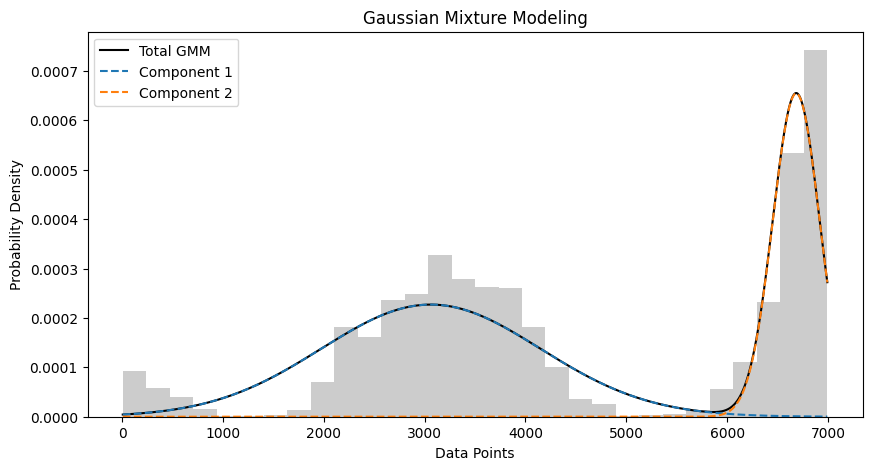

Client 50 - Means: [3062.14577498 6685.779413  ]
Client 50 - Covariances: [1181500.20008162   54104.65702531]
Client 50 - Weights (priors): [0.61848804 0.38151196]
mean of pdf 4444.605342659433
variance of pdf 3849717.8543376066


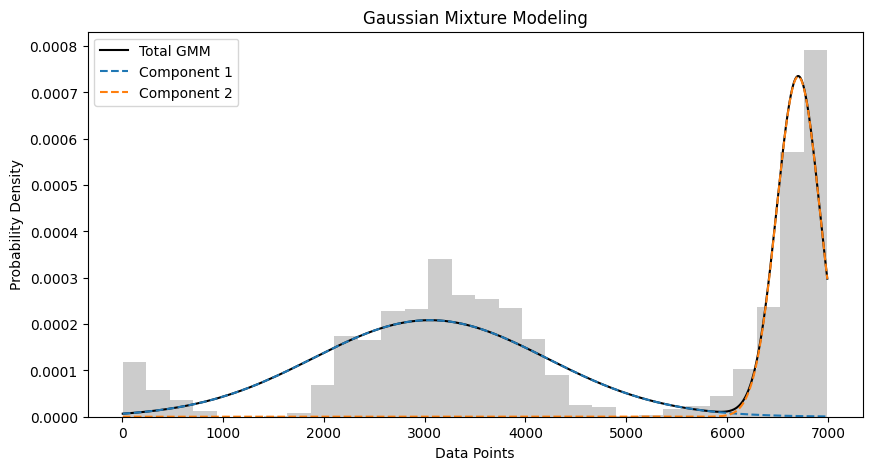

Client 51 - Means: [3052.67717023 6705.46177632]
Client 51 - Covariances: [1340529.49269437   46084.77443388]
Client 51 - Weights (priors): [0.60497953 0.39502047]
mean of pdf 4495.601862548039
variance of pdf 4017858.76771042


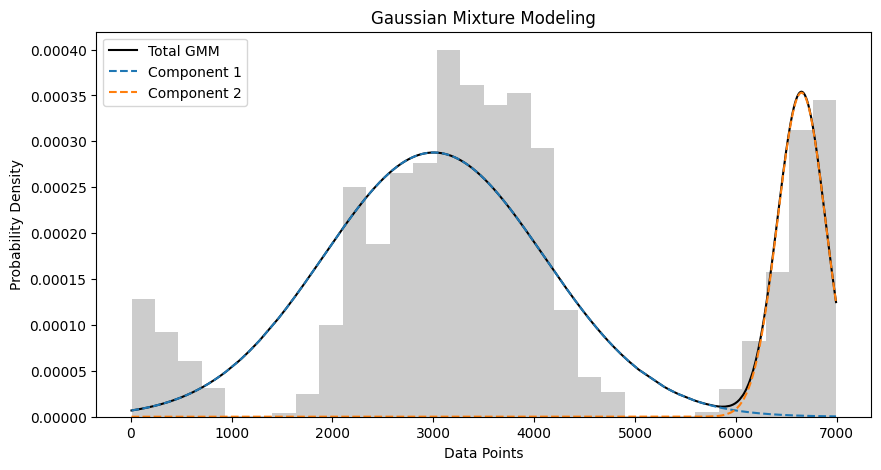

Client 52 - Means: [3004.02026043 6651.19089358]
Client 52 - Covariances: [1198496.11904314   56382.58762054]
Client 52 - Weights (priors): [0.78990731 0.21009269]
mean of pdf 3770.26414245679
variance of pdf 3166038.914794064


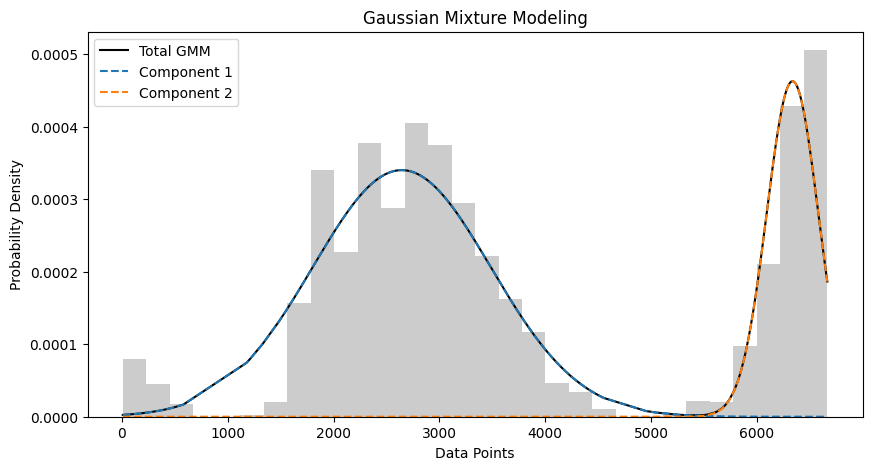

Client 53 - Means: [2644.2197919  6335.37334182]
Client 53 - Covariances: [707256.1201811   59416.57853843]
Client 53 - Weights (priors): [0.71718901 0.28281099]
mean of pdf 3688.118569109356
variance of pdf 3287506.000441957


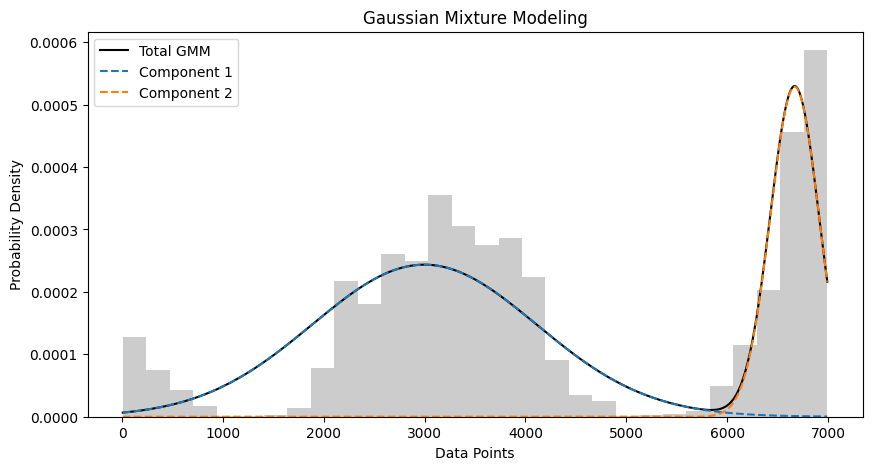

Client 54 - Means: [2998.11866641 6670.15142333]
Client 54 - Covariances: [1236502.26616321   58587.26929981]
Client 54 - Weights (priors): [0.67911669 0.32088331]
mean of pdf 4176.412689021116
variance of pdf 3796886.448577207


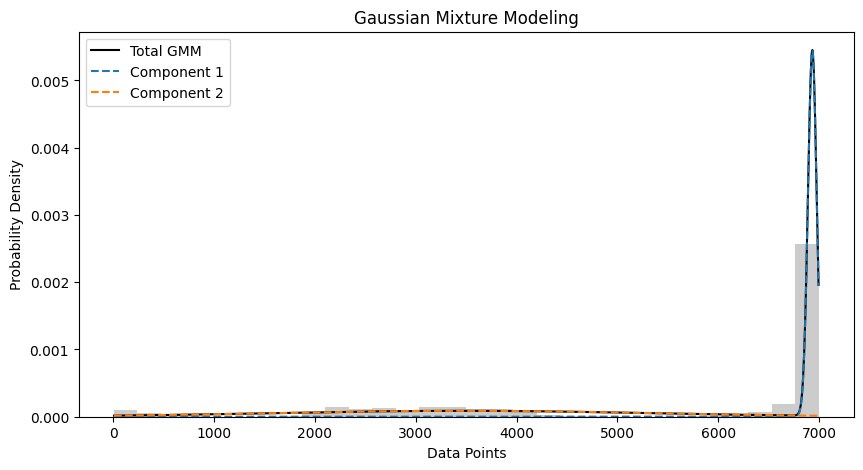

Client 55 - Means: [6932.23020977 3457.47421289]
Client 55 - Covariances: [1.85617843e+03 3.51677999e+06]
Client 55 - Weights (priors): [0.58710794 0.41289206]
mean of pdf 5497.531033261861
variance of pdf 4380008.167721074


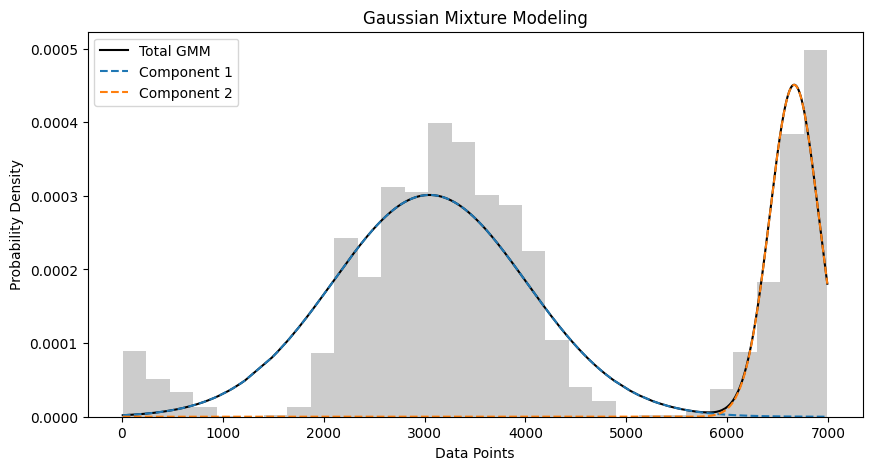

Client 56 - Means: [3049.31013995 6665.7671348 ]
Client 56 - Covariances: [923749.66452894  58905.28501224]
Client 56 - Weights (priors): [0.72577054 0.27422946]
mean of pdf 4041.0492052234576
variance of pdf 3289619.1594913043


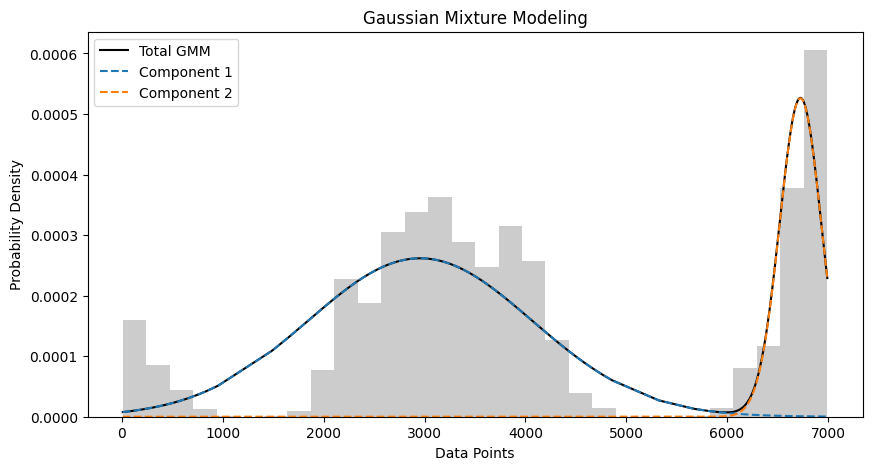

Client 57 - Means: [2956.99123446 6727.95102301]
Client 57 - Covariances: [1232242.27418797   42520.05231204]
Client 57 - Weights (priors): [0.72816895 0.27183105]
mean of pdf 3982.055198044178
variance of pdf 3723557.689824434


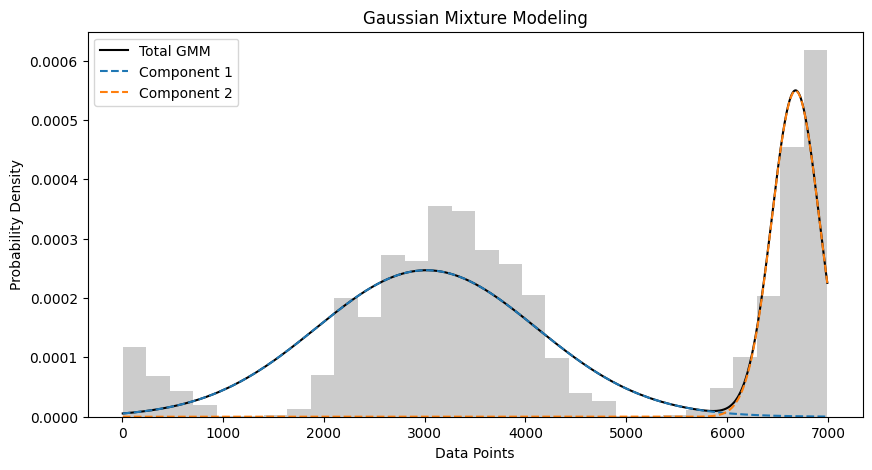

Client 58 - Means: [3018.07491503 6679.40333815]
Client 58 - Covariances: [1191571.2722214    55547.93979234]
Client 58 - Weights (priors): [0.67556838 0.32443162]
mean of pdf 4205.925624710669
variance of pdf 3761131.6400148515


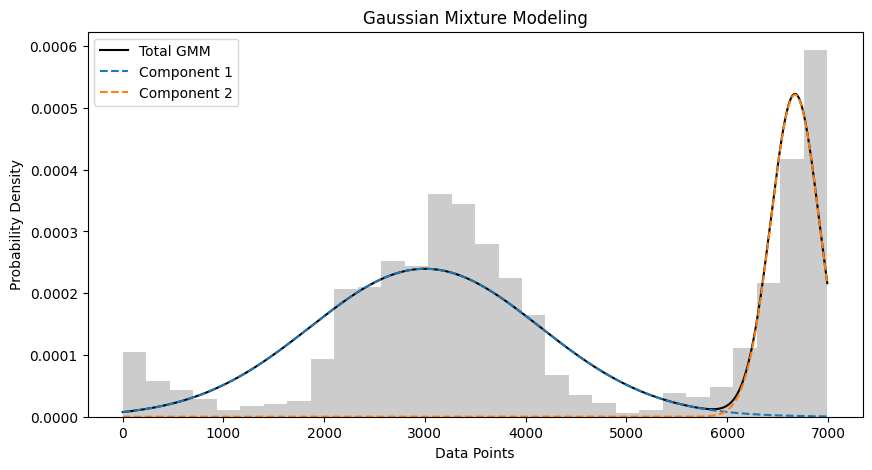

Client 59 - Means: [3002.70581269 6673.74175559]
Client 59 - Covariances: [1301553.10588139   58095.70128015]
Client 59 - Weights (priors): [0.68500346 0.31499654]
mean of pdf 4159.069434156336
variance of pdf 3817743.9177905284


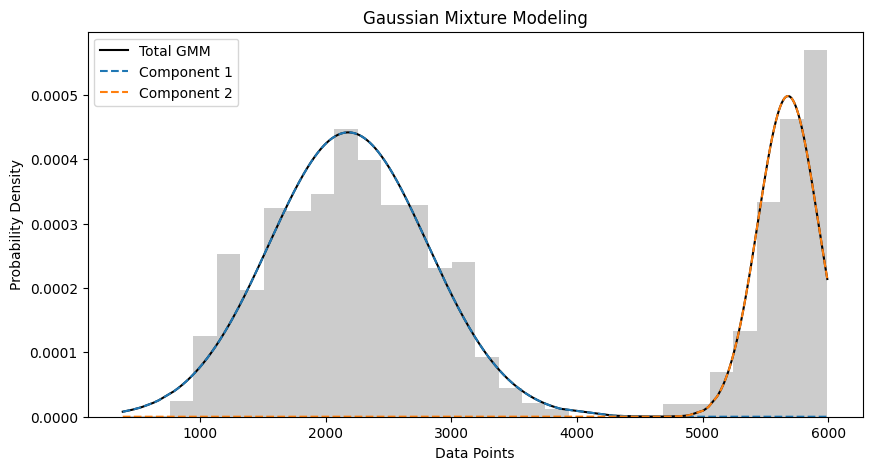

Client 60 - Means: [2180.47902295 5680.61152696]
Client 60 - Covariances: [399264.59932427  57715.53497816]
Client 60 - Weights (priors): [0.6998918 0.3001082]
mean of pdf 3230.897476972233
variance of pdf 2869987.770728019


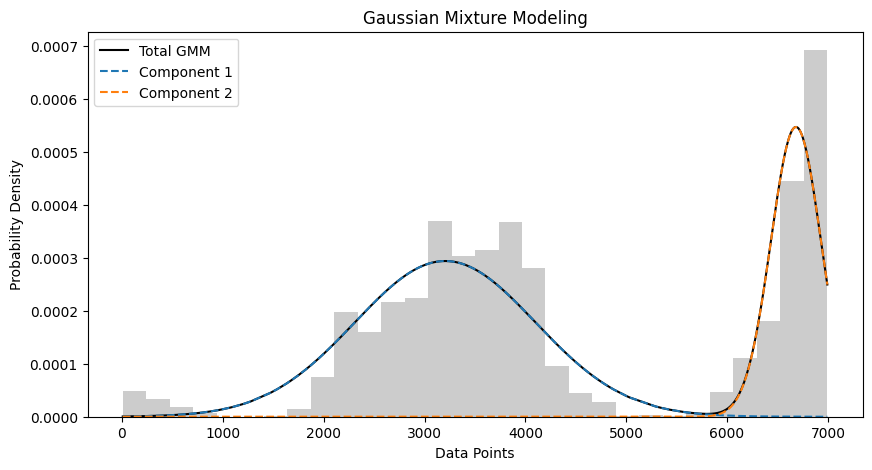

Client 61 - Means: [3205.06703204 6683.1491206 ]
Client 61 - Covariances: [800750.71041156  61579.75007272]
Client 61 - Weights (priors): [0.65962911 0.34037089]
mean of pdf 4388.904916098842
variance of pdf 3265171.639877106


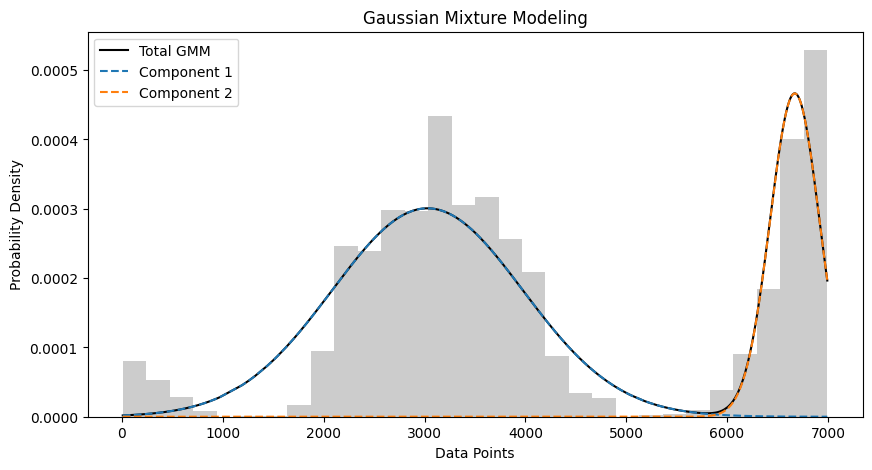

Client 62 - Means: [3029.56857309 6671.36669007]
Client 62 - Covariances: [895180.11457014  60192.37406787]
Client 62 - Weights (priors): [0.71316002 0.28683998]
mean of pdf 4074.181856010717
variance of pdf 3368726.027344942


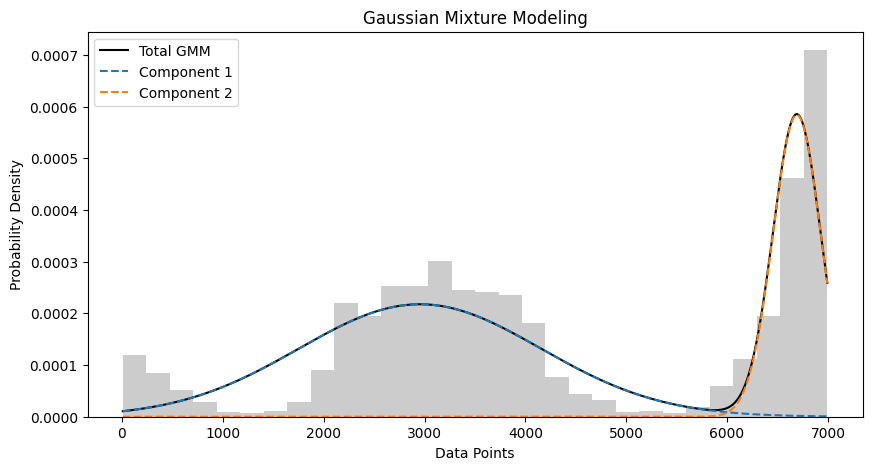

Client 63 - Means: [2954.79352013 6691.84419555]
Client 63 - Covariances: [1437439.43715258   56018.1855194 ]
Client 63 - Weights (priors): [0.65371946 0.34628054]
mean of pdf 4248.861435589478
variance of pdf 4120465.7516979957


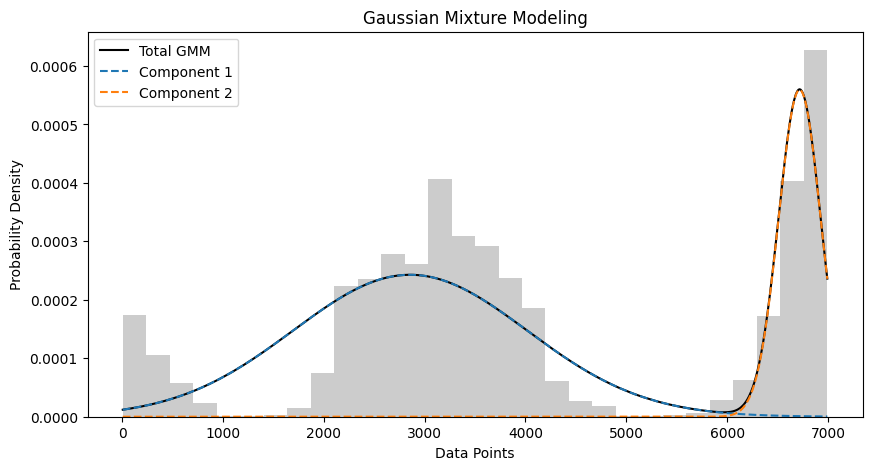

Client 64 - Means: [2856.71926933 6719.45674061]
Client 64 - Covariances: [1349336.35043948   43656.62502852]
Client 64 - Weights (priors): [0.7070959 0.2929041]
mean of pdf 3988.130904380646
variance of pdf 4057151.2383372635


In [48]:
def save_gmm_params_to_csv1(filename, data):
    with open(filename, 'w', newline='') as csvfile:
        # Create a CSV writer object
        writer = csv.writer(csvfile)
        # Write the header
        writer.writerow(['client_id', 'mean', 'covariance', 'weight','mean_pdf','covariance_pdf'])

        # Process each client_id and extract GMM parameters
        for client_id in range(1, 65):
            gmm, x = process_client(client_id, data)
            mean_pdf,variance_pdf=calculate_gmm_statistics(gmm)
            # Retrieve means, covariances, and weights
            means = gmm.means_
            covariances = gmm.covariances_
            weights = gmm.weights_

            # Write GMM parameters to CSV for each client
            for i in range(means.shape[0]):
                mean_str = ','.join(map(str, means[i].flatten()))
                covariance_str = ','.join(map(str, covariances[i].flatten()))
                weight_str = str(weights[i])
                
                # Write the parameters for each component of the GMM for the client
                writer.writerow([client_id, mean_str, covariance_str, weight_str,mean_pdf,variance_pdf])
filename = 'gmm_production2.csv'
save_gmm_params_to_csv1(filename, data1)
# Iterate over each client and process their data
for client_id in range(1, 65):
    gmm, x = process_client(client_id, data1)
    mean,variance=calculate_gmm_statistics(gmm)
    plot_gmm(gmm, x)  # This will plot 64 figures; you might want to adjust this based on your needs

    # Print GMM parameters for each client
    print(f"Client {client_id} - Means:", gmm.means_.flatten())
    print(f"Client {client_id} - Covariances:", gmm.covariances_.flatten())
    print(f"Client {client_id} - Weights (priors):", gmm.weights_)
   
    
   
    print('mean of pdf',mean)
    print('variance of pdf',variance)

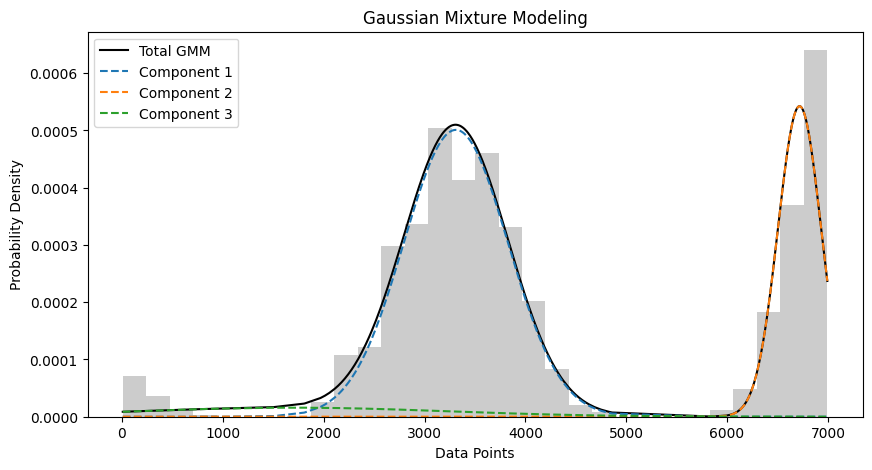

Client 1 - Means: [3310.84374986 6718.72390809 1688.83090461]
Client 1 - Covariances: [ 266790.45340872   45789.31206555 2335234.31424379]
Client 1 - Weights (priors): [0.64851879 0.29086902 0.06061219]
mean of pdf 4203.776772808831
variance of pdf 3972638.3568114154


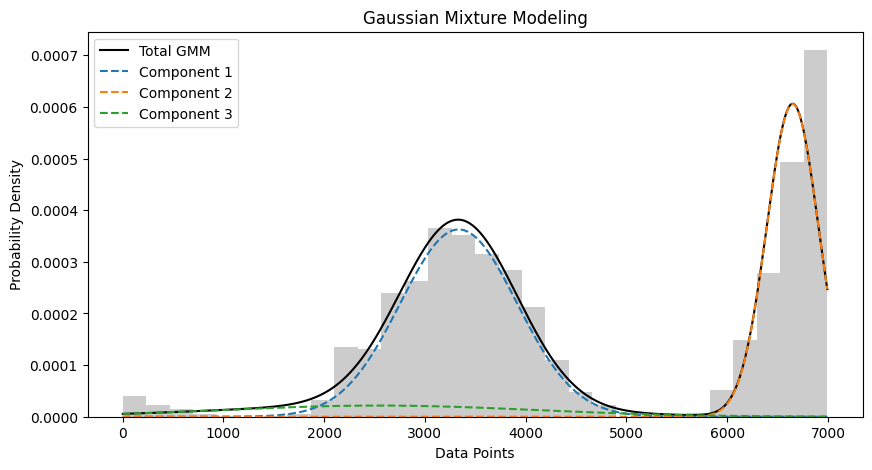

Client 2 - Means: [3335.73009724 6649.79975962 2544.4779266 ]
Client 2 - Covariances: [ 335242.14331372   66035.26289025 2373487.43941324]
Client 2 - Weights (priors): [0.52644356 0.39006975 0.08348669]
mean of pdf 4562.389407377389
variance of pdf 3972638.3568114154


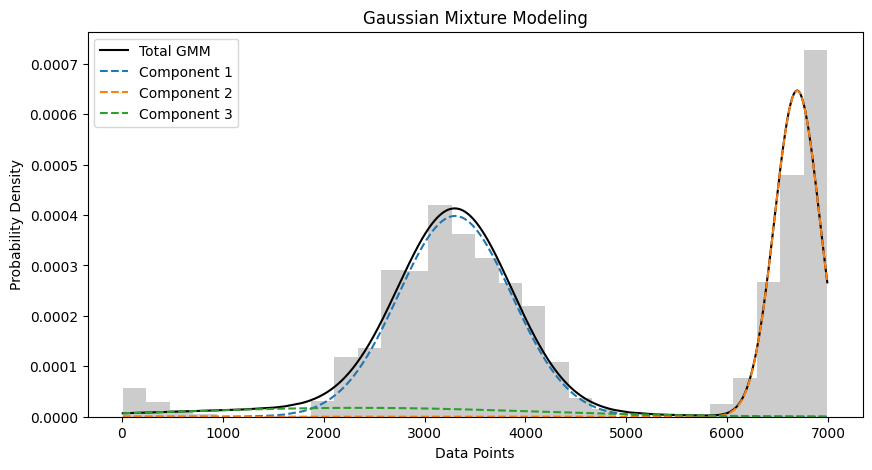

Client 3 - Means: [3302.85099986 6694.7207471  2340.91589605]
Client 3 - Covariances: [ 316545.41005147   50476.04937408 2880639.69388581]
Client 3 - Weights (priors): [0.56122581 0.36376104 0.07501315]
mean of pdf 4464.52328308492
variance of pdf 3972638.3568114154


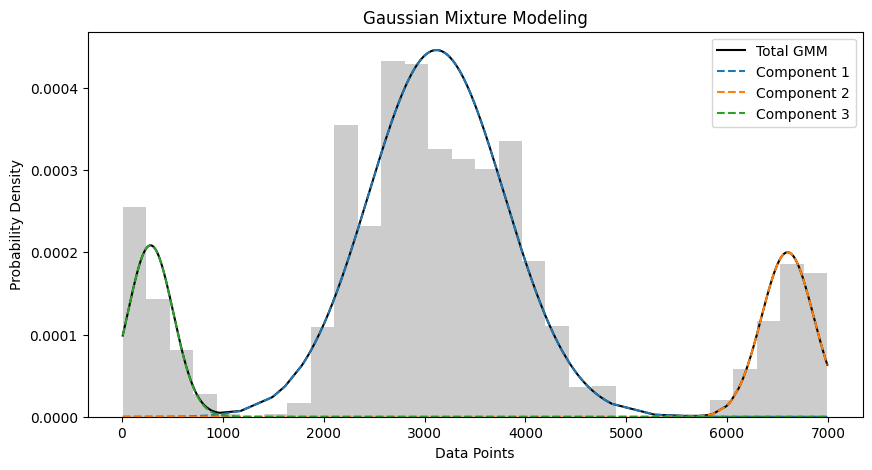

Client 4 - Means: [3118.46989441 6600.87315596  283.50210772]
Client 4 - Covariances: [452845.66083032  67144.96948198  50823.52133951]
Client 4 - Weights (priors): [0.75228302 0.12994692 0.11777006]
mean of pdf 3237.1231479787866
variance of pdf 3972638.3568114154


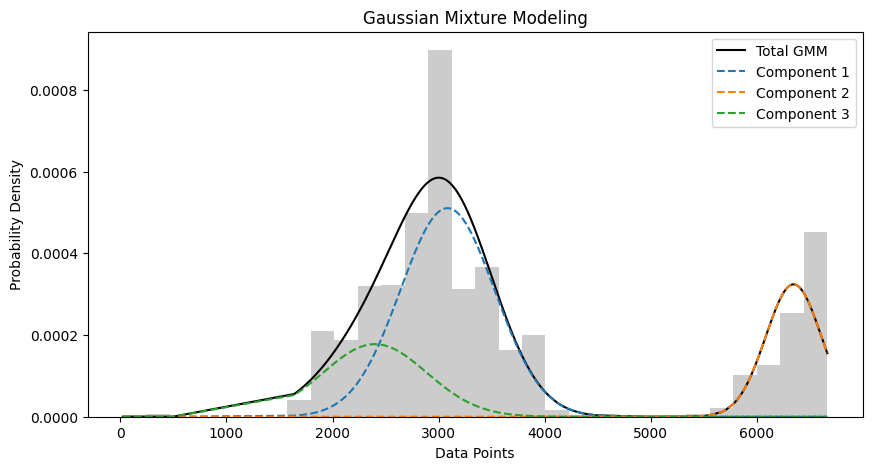

Client 5 - Means: [3083.39185843 6346.03418637 2399.30359605]
Client 5 - Covariances: [197649.40174825  68805.45123145 238987.13423336]
Client 5 - Weights (priors): [0.56906036 0.21312172 0.21781793]
mean of pdf 3629.7251013010086
variance of pdf 3972638.3568114154


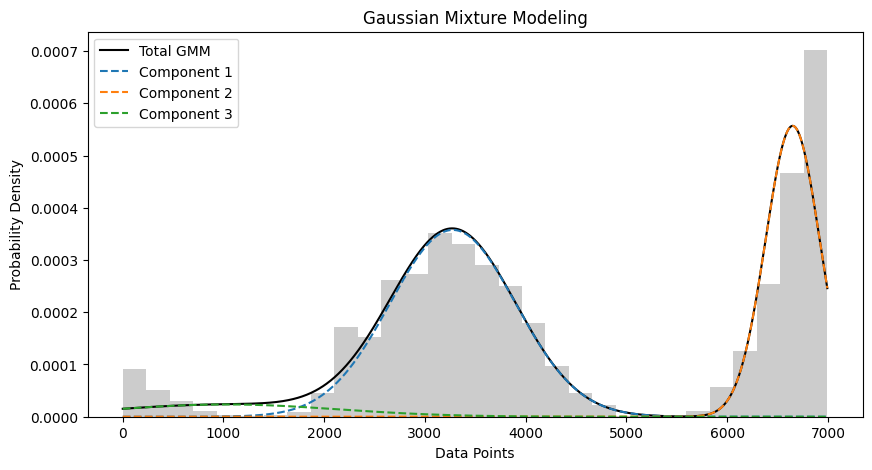

Client 6 - Means: [3276.65072198 6649.88576017 1028.43166912]
Client 6 - Covariances: [ 388972.36688579   72523.55921025 1216338.57735758]
Client 6 - Weights (priors): [0.5590952  0.37589976 0.06500503]
mean of pdf 4398.503423332313
variance of pdf 3972638.3568114154


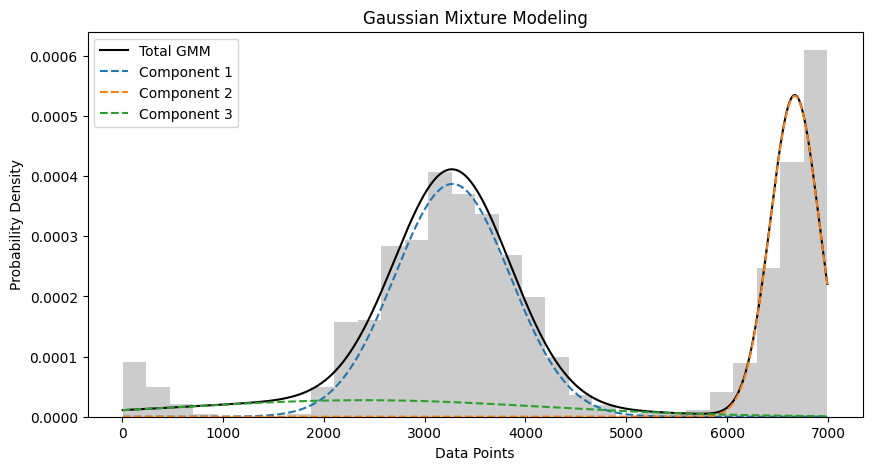

Client 7 - Means: [3276.23019626 6671.11940348 2398.33140962]
Client 7 - Covariances: [ 326052.89675913   58878.34737187 3110463.12815005]
Client 7 - Weights (priors): [0.55401335 0.32442918 0.12155746]
mean of pdf 4270.91617598407
variance of pdf 3972638.3568114154


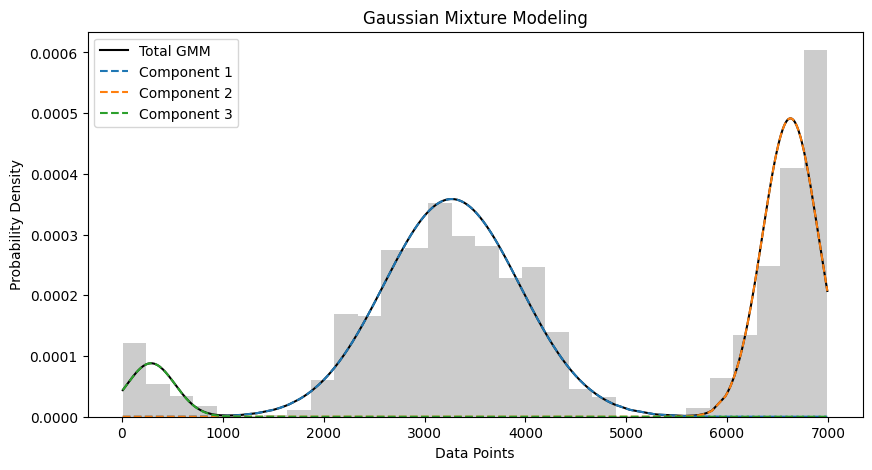

Client 8 - Means: [3269.3844086  6628.19608495  288.75160839]
Client 8 - Covariances: [452822.84351551  77454.29128711  56417.25206783]
Client 8 - Weights (priors): [0.60475165 0.34281911 0.05242923]
mean of pdf 4264.576954194819
variance of pdf 3972638.3568114154


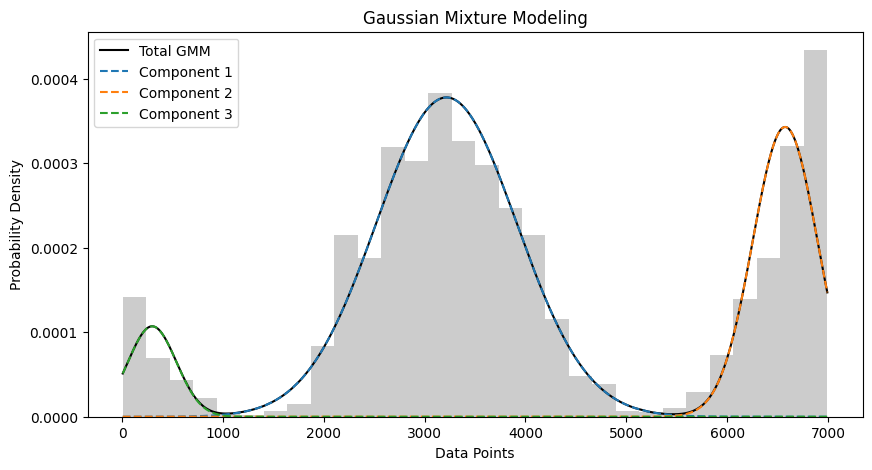

Client 9 - Means: [3217.33229406 6575.98099931  298.62735605]
Client 9 - Covariances: [484511.04338691 103279.72019071  57625.74794048]
Client 9 - Weights (priors): [0.65937059 0.27624838 0.06438104]
mean of pdf 3957.2442964217616
variance of pdf 3972638.3568114154


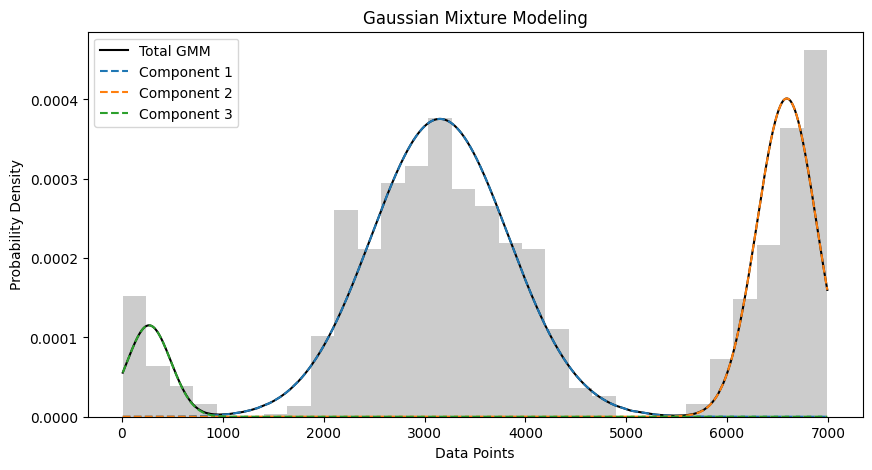

Client 10 - Means: [3152.36614589 6592.0971776   268.78538048]
Client 10 - Covariances: [461894.82159731  87800.48818797  46622.1910196 ]
Client 10 - Weights (priors): [0.63963569 0.29801588 0.06234843]
mean of pdf 3997.6738766685503
variance of pdf 3972638.3568114154


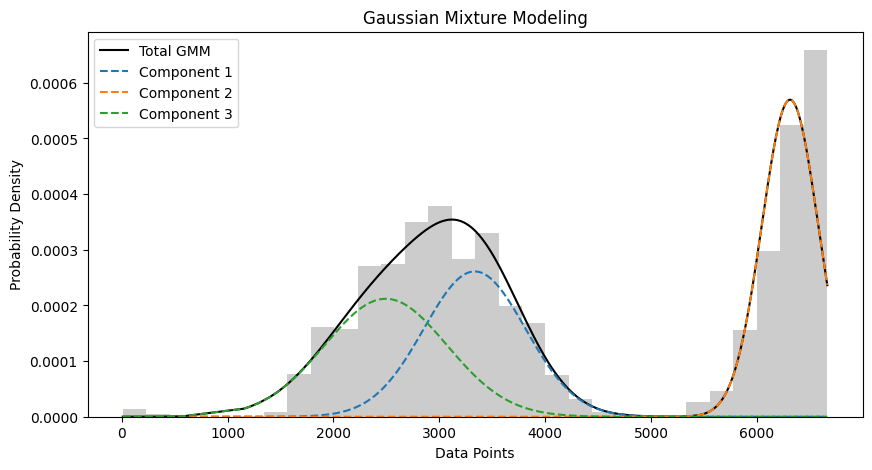

Client 11 - Means: [3333.83519013 6311.89882409 2493.8891962 ]
Client 11 - Covariances: [230054.64217555  70504.34194609 334282.46838894]
Client 11 - Weights (priors): [0.3138439  0.37908933 0.30706677]
mean of pdf 4204.867826705776
variance of pdf 3972638.3568114154


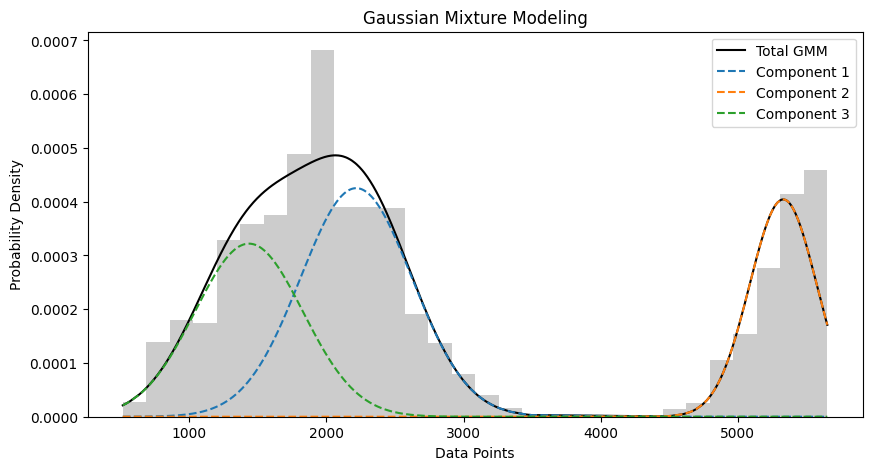

Client 12 - Means: [2217.98735836 5330.57210522 1435.90120462]
Client 12 - Covariances: [165491.32848674  60038.83268799 155380.87366436]
Client 12 - Weights (priors): [0.43355948 0.24829364 0.31814687]
mean of pdf 2742.0040950041293
variance of pdf 3972638.3568114154


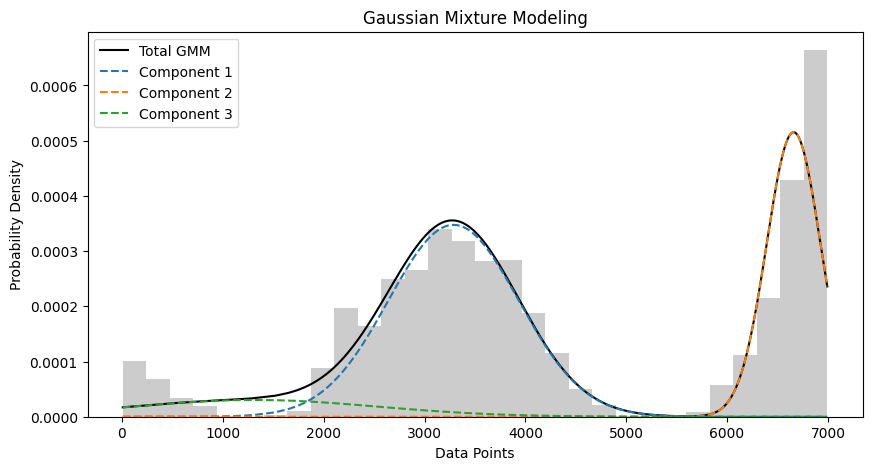

Client 13 - Means: [3287.92519702 6659.84717485 1313.37323809]
Client 13 - Covariances: [ 416879.74250471   71482.67969524 1465416.0921631 ]
Client 13 - Weights (priors): [0.56232519 0.34538586 0.09228895]
mean of pdf 4270.310017906688
variance of pdf 3972638.3568114154


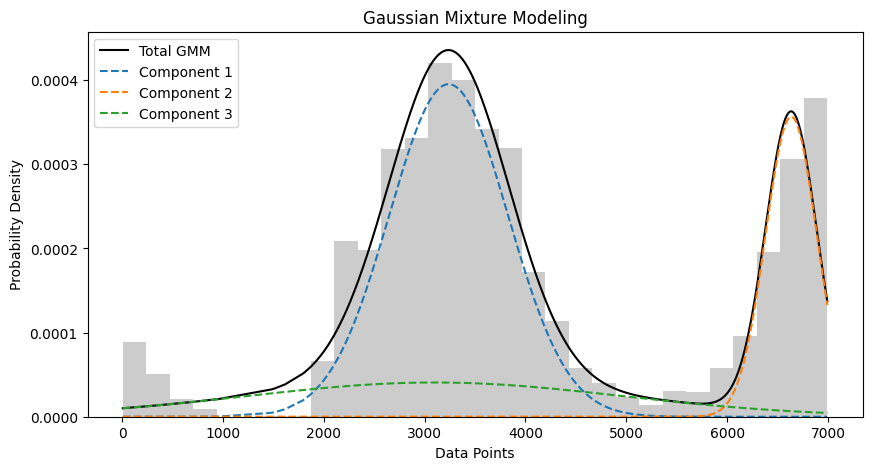

Client 14 - Means: [3238.59472308 6636.13764356 3099.2171575 ]
Client 14 - Covariances: [ 346795.57009299   64865.93823957 3430214.28503712]
Client 14 - Weights (priors): [0.58350459 0.22757541 0.18892   ]
mean of pdf 3985.460744148083
variance of pdf 3972638.3568114154


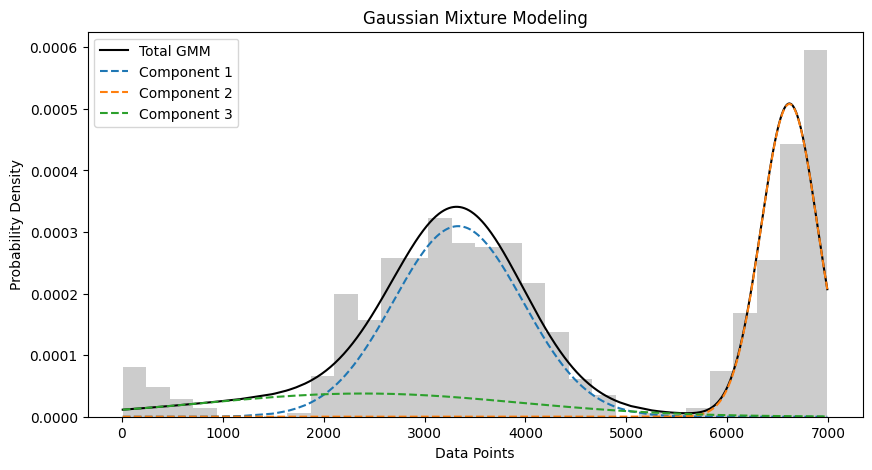

Client 15 - Means: [3333.74205397 6618.12407342 2395.278323  ]
Client 15 - Covariances: [ 410628.52301217   78559.89233464 2390270.498177  ]
Client 15 - Weights (priors): [0.49714979 0.35681086 0.14603936]
mean of pdf 4368.592585989081
variance of pdf 3972638.3568114154


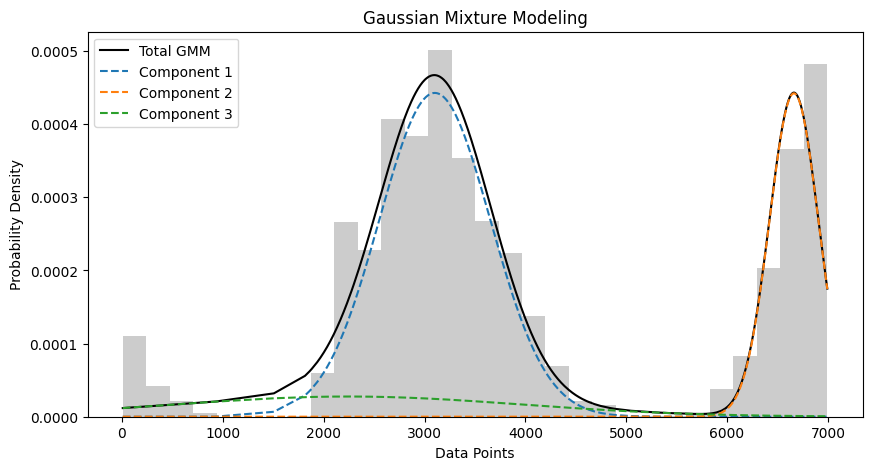

Client 16 - Means: [3102.21549827 6663.09118917 2243.03531951]
Client 16 - Covariances: [ 304353.59758247   58915.29266107 2947739.00131424]
Client 16 - Weights (priors): [0.61210072 0.26899579 0.11890349]
mean of pdf 3957.916542335024
variance of pdf 3972638.3568114154


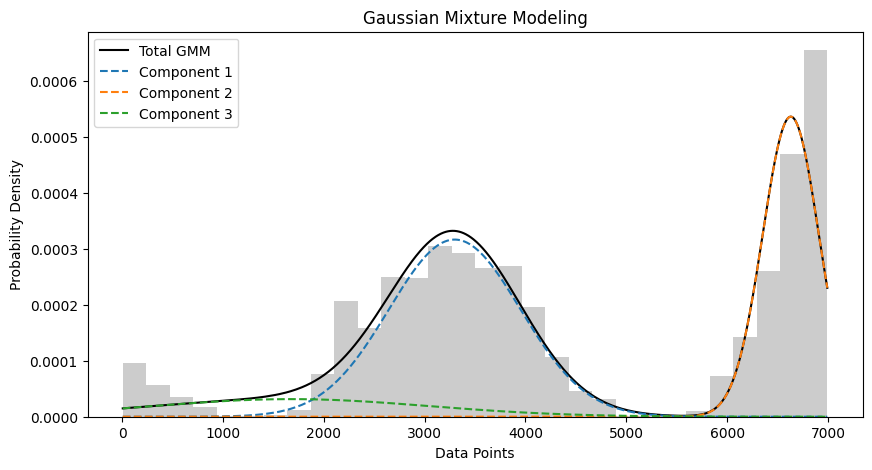

Client 17 - Means: [3298.74886046 6631.71469093 1675.37019763]
Client 17 - Covariances: [ 425138.18147327   77676.94817296 1861820.25600987]
Client 17 - Weights (priors): [0.51760859 0.37474121 0.1076502 ]
mean of pdf 4372.991462700533
variance of pdf 3972638.3568114154


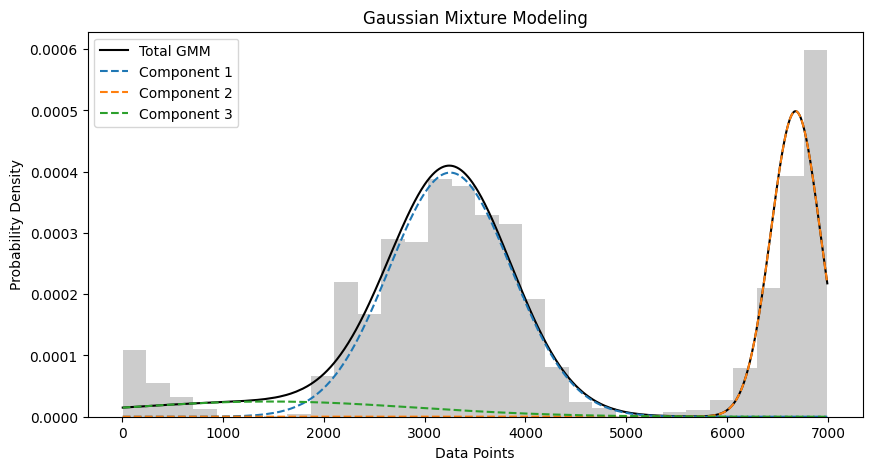

Client 18 - Means: [3254.24305738 6679.19606875 1460.11316313]
Client 18 - Covariances: [ 366650.24892071   59768.70442373 2062429.44133525]
Client 18 - Weights (priors): [0.60489942 0.30569352 0.08940706]
mean of pdf 4140.821126399765
variance of pdf 3972638.3568114154


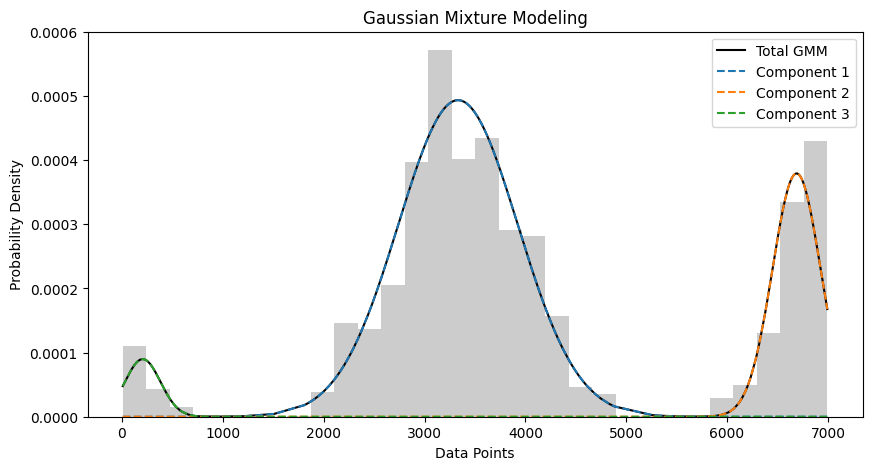

Client 19 - Means: [3332.37106169 6689.35459045  205.87143635]
Client 19 - Covariances: [351175.56884153  56925.12800119  31078.04320067]
Client 19 - Weights (priors): [0.73337952 0.22692953 0.03969095]
mean of pdf 3970.0760280061004
variance of pdf 3972638.3568114154


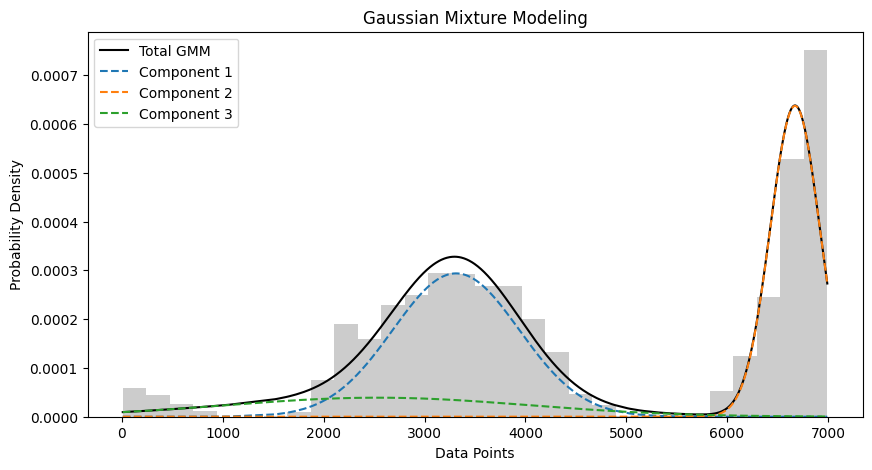

Client 20 - Means: [3312.59480458 6673.99976396 2533.67404694]
Client 20 - Covariances: [ 392231.00524022   60295.51442066 2250732.28546129]
Client 20 - Weights (priors): [0.46112437 0.39215906 0.14671657]
mean of pdf 4516.519633066345
variance of pdf 3972638.3568114154


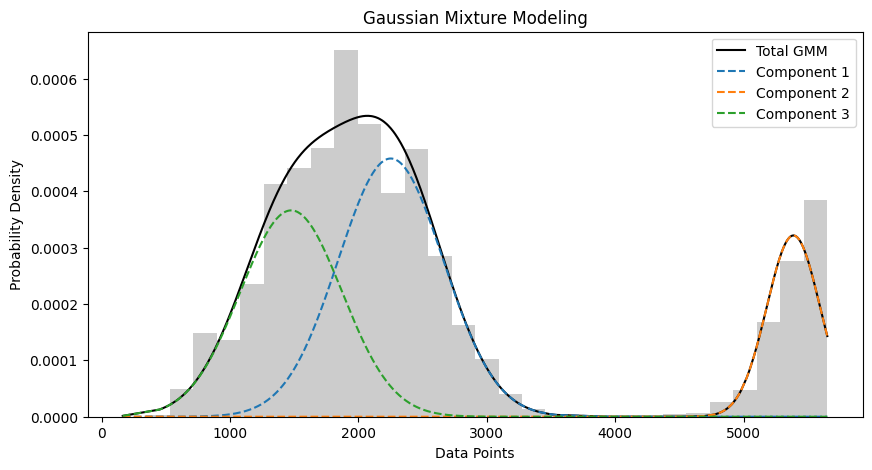

Client 21 - Means: [2251.9500417  5388.05117072 1476.76710767]
Client 21 - Covariances: [167467.52058537  43013.47733723 156408.97446476]
Client 21 - Weights (priors): [0.4699123  0.16719252 0.36289519]
mean of pdf 2494.97252445898
variance of pdf 3972638.3568114154


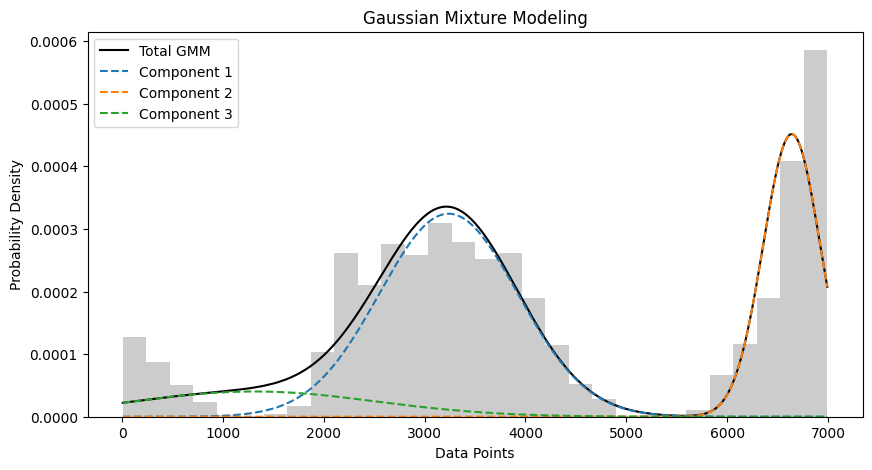

Client 22 - Means: [3238.28737065 6640.99987642 1315.22164974]
Client 22 - Covariances: [ 471694.04966042   80210.75531245 1443106.56869948]
Client 22 - Weights (priors): [0.55815279 0.32047674 0.12137047]
mean of pdf 4095.3742026868463
variance of pdf 3972638.3568114154


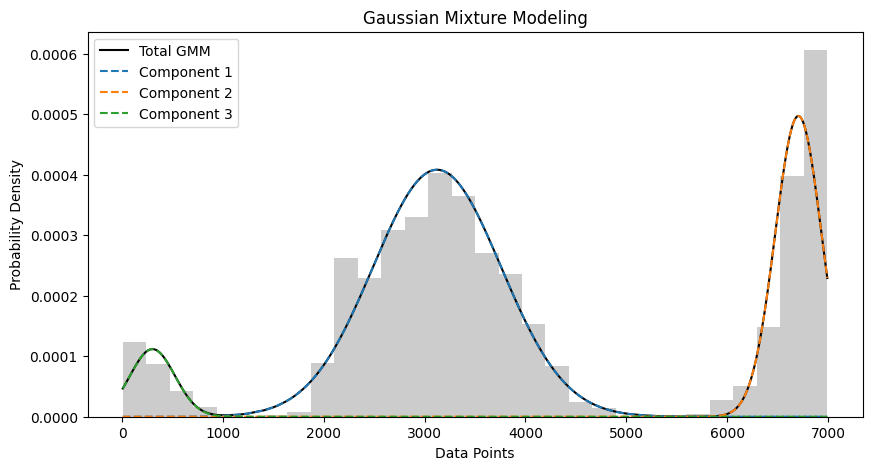

Client 23 - Means: [3123.88815647 6707.22191924  301.40322352]
Client 23 - Covariances: [403350.94758563  53118.39346474  49674.593906  ]
Client 23 - Weights (priors): [0.65018723 0.28735205 0.06246072]
mean of pdf 3977.272007665419
variance of pdf 3972638.3568114154


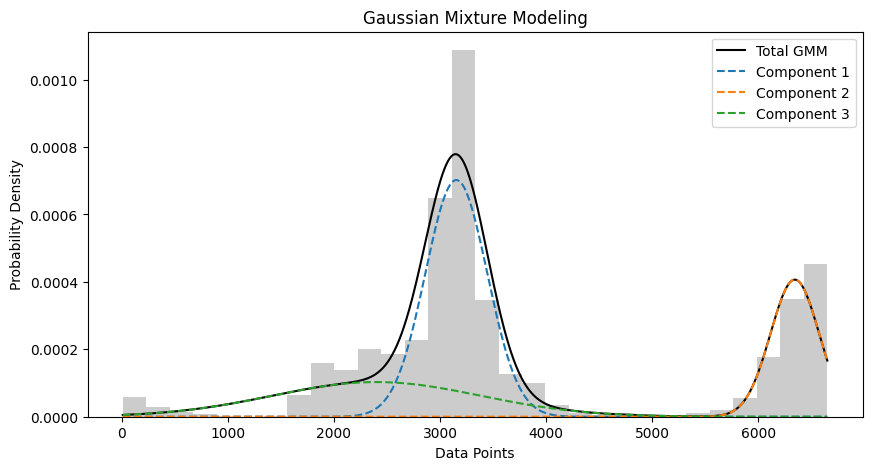

Client 24 - Means: [3154.01447602 6346.57298095 2400.71429428]
Client 24 - Covariances: [ 85115.85097992  52624.47271637 964249.05868776]
Client 24 - Weights (priors): [0.51329683 0.23373377 0.2529694 ]
mean of pdf 3709.6613272081313
variance of pdf 3972638.3568114154


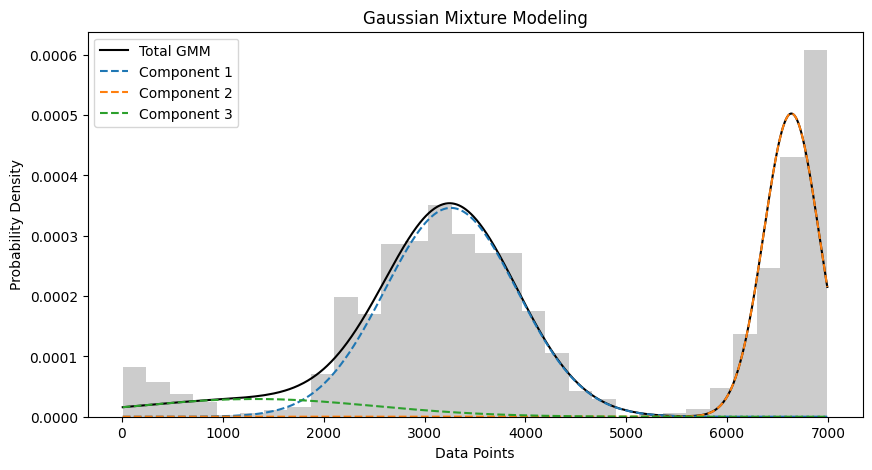

Client 25 - Means: [3261.49720888 6637.71520866 1323.28419115]
Client 25 - Covariances: [ 429284.34868458   74801.64714208 1393008.01631546]
Client 25 - Weights (priors): [0.56854562 0.34455089 0.0869035 ]
mean of pdf 4256.33862964138
variance of pdf 3972638.3568114154


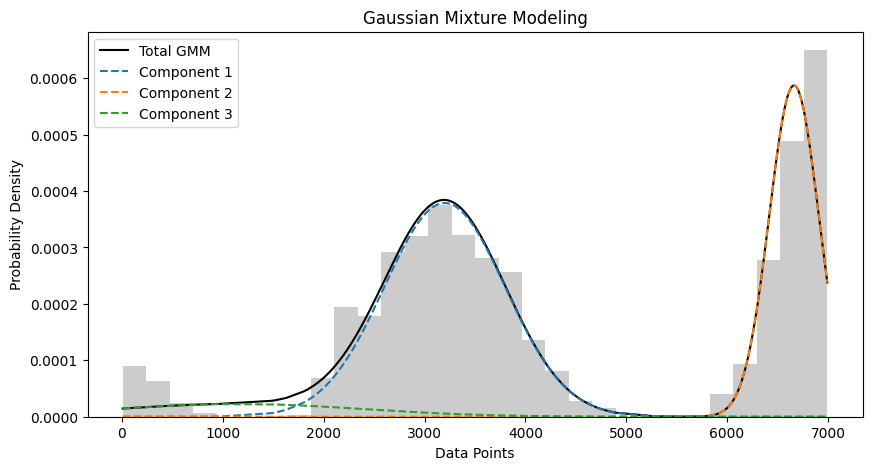

Client 26 - Means: [3200.2658445  6663.80900014 1159.08911883]
Client 26 - Covariances: [ 359744.42606662   60363.87119085 1485133.33046496]
Client 26 - Weights (priors): [0.56922241 0.36153428 0.06924331]
mean of pdf 4311.117582156398
variance of pdf 3972638.3568114154


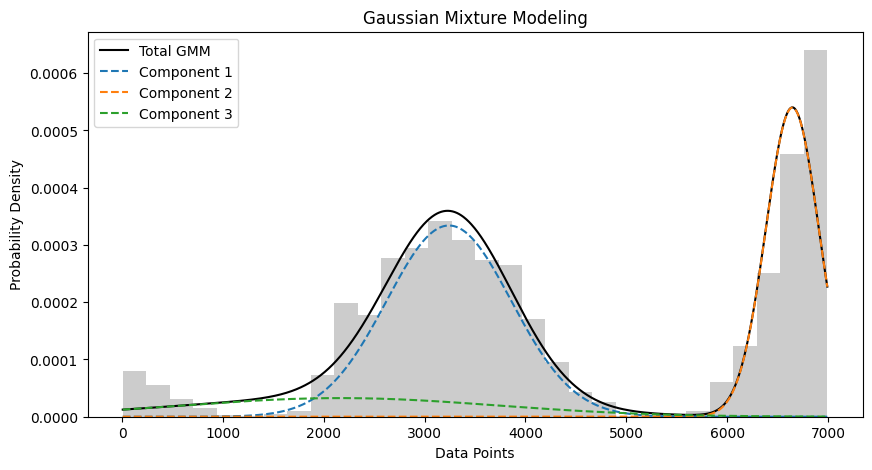

Client 27 - Means: [3241.56157794 6647.50711605 2164.83030867]
Client 27 - Covariances: [ 381740.41245577   69279.25125451 2415242.04349345]
Client 27 - Weights (priors): [0.51714332 0.35609964 0.12675705]
mean of pdf 4317.934270534438
variance of pdf 3972638.3568114154


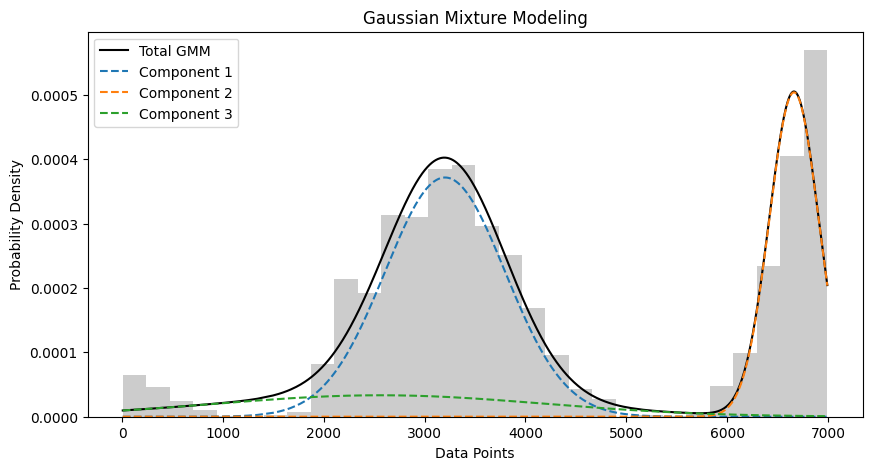

Client 28 - Means: [3203.30521949 6663.41120819 2562.56387122]
Client 28 - Covariances: [ 354111.88209836   60316.45388134 2645755.7986334 ]
Client 28 - Weights (priors): [0.55408374 0.31005683 0.13585944]
mean of pdf 4189.083943002024
variance of pdf 3972638.3568114154


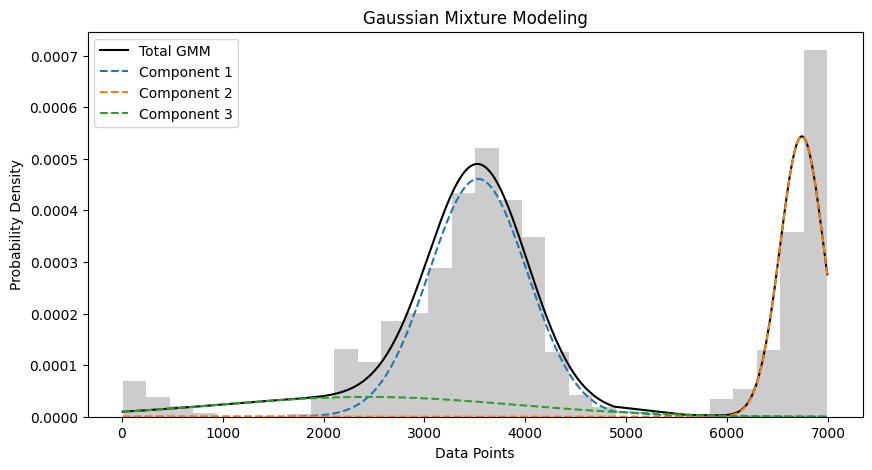

Client 29 - Means: [3532.06364535 6742.02686222 2431.71025517]
Client 29 - Covariances: [ 238665.25528653   46860.67069396 2137723.70670811]
Client 29 - Weights (priors): [0.5645323  0.29464175 0.14082595]
mean of pdf 4322.894511421318
variance of pdf 3972638.3568114154


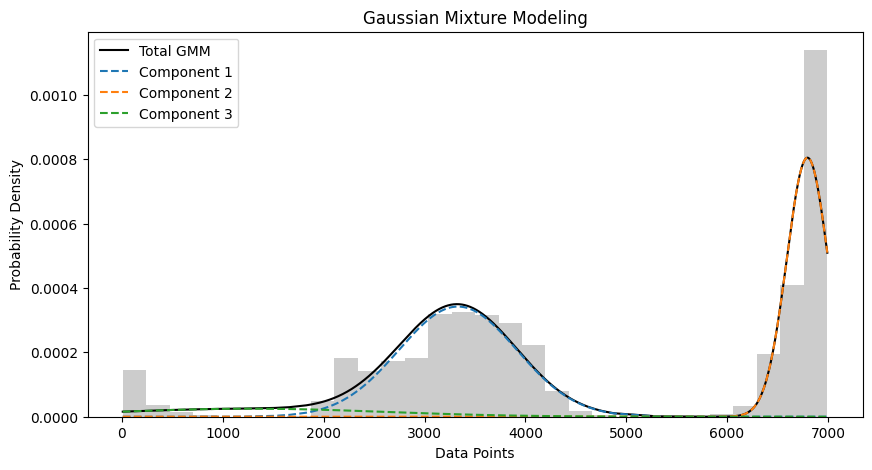

Client 30 - Means: [3331.07871812 6797.11334992 1277.75139913]
Client 30 - Covariances: [ 341717.46416744   42404.27066026 1748125.00112704]
Client 30 - Weights (priors): [0.50166922 0.41558521 0.08274557]
mean of pdf 4601.607719991365
variance of pdf 3972638.3568114154


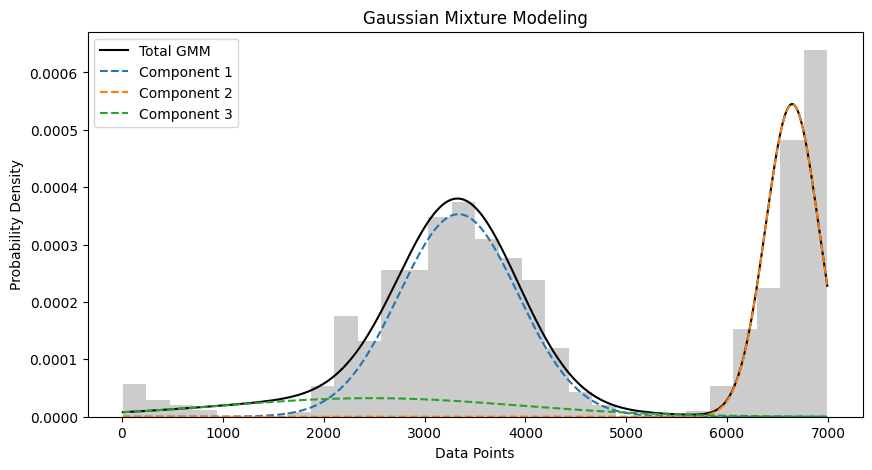

Client 31 - Means: [3337.77414612 6645.65289699 2469.20551111]
Client 31 - Covariances: [ 346972.22341528   69701.401869   2136915.63355835]
Client 31 - Weights (priors): [0.52117317 0.36022824 0.11859859]
mean of pdf 4426.3544568167945
variance of pdf 3972638.3568114154


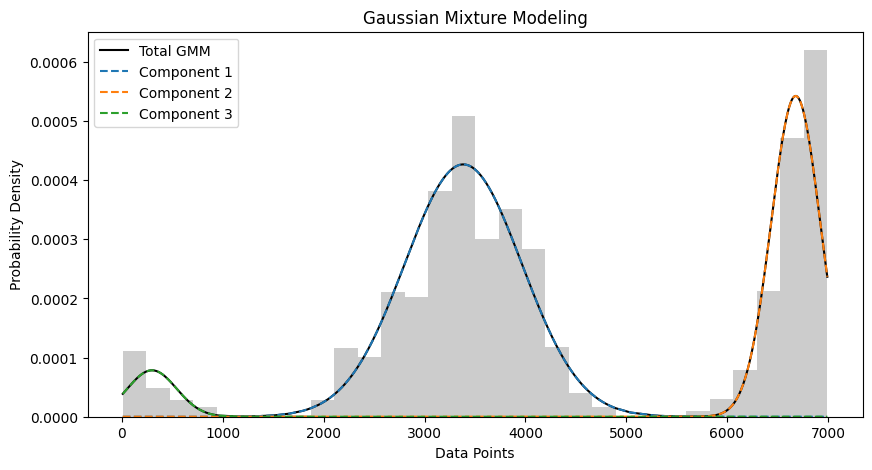

Client 32 - Means: [3384.2539214  6680.66094906  297.83397664]
Client 32 - Covariances: [336989.74446976  59188.47012465  59376.90366748]
Client 32 - Weights (priors): [0.62109381 0.33093325 0.04797294]
mean of pdf 4327.079989794822
variance of pdf 3972638.3568114154


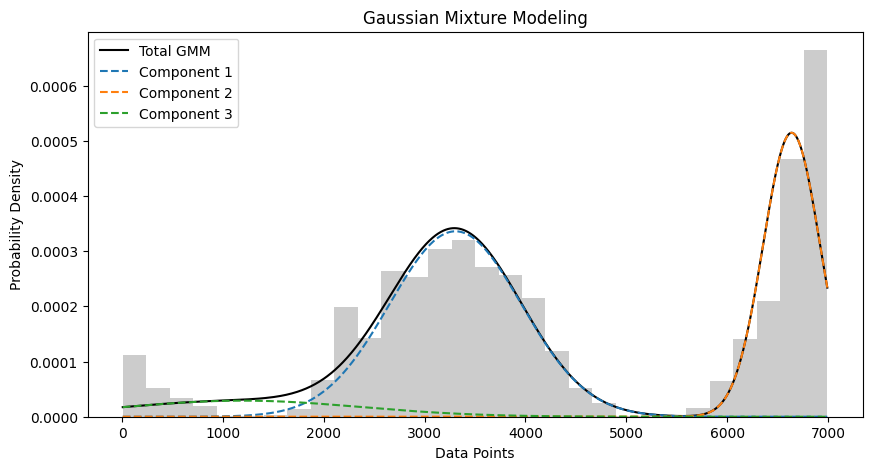

Client 33 - Means: [3306.41114746 6640.0340298  1194.43702129]
Client 33 - Covariances: [ 428342.37854075   79481.6295725  1360277.53898744]
Client 33 - Weights (priors): [0.551213   0.36360887 0.08517814]
mean of pdf 4338.65196836679
variance of pdf 3972638.3568114154


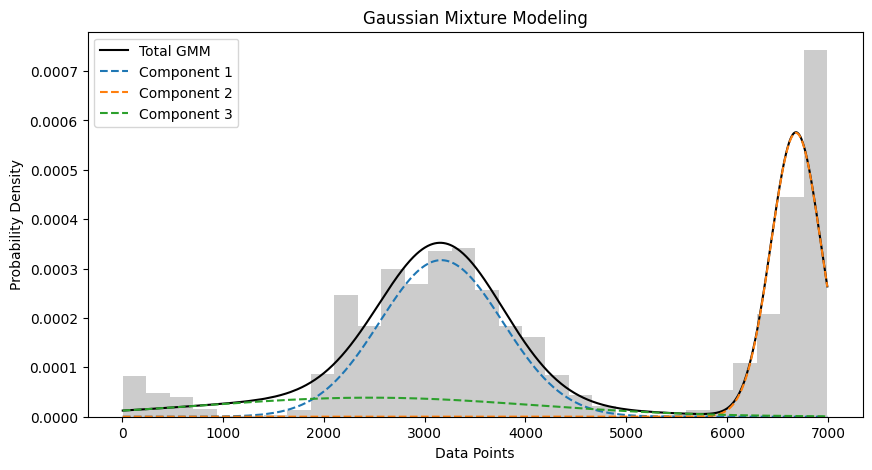

Client 34 - Means: [3165.12611368 6683.253179   2458.17342865]
Client 34 - Covariances: [ 371431.92849463   61790.54302977 2654324.41660174]
Client 34 - Weights (priors): [0.48431924 0.35808837 0.15759238]
mean of pdf 4313.516155192509
variance of pdf 3972638.3568114154


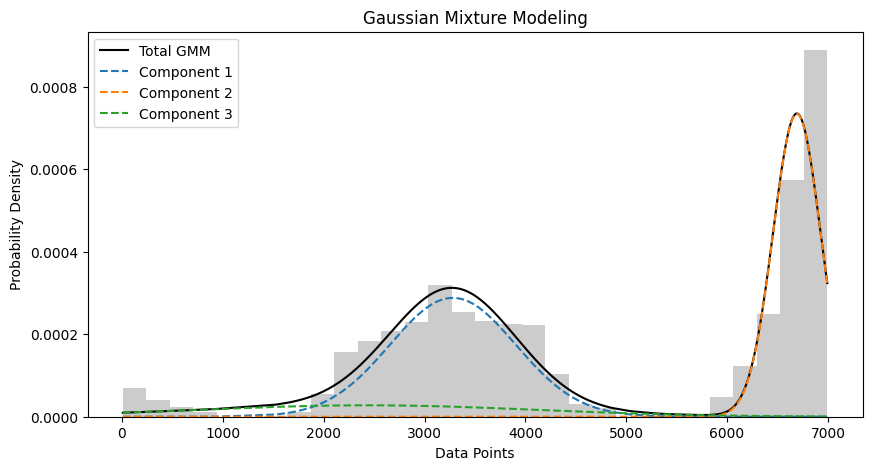

Client 35 - Means: [3280.95266186 6692.17895852 2430.91634913]
Client 35 - Covariances: [ 388853.64959813   55521.67602093 2791682.20471643]
Client 35 - Weights (priors): [0.45037257 0.43365488 0.11597255]
mean of pdf 4661.666695653784
variance of pdf 3972638.3568114154


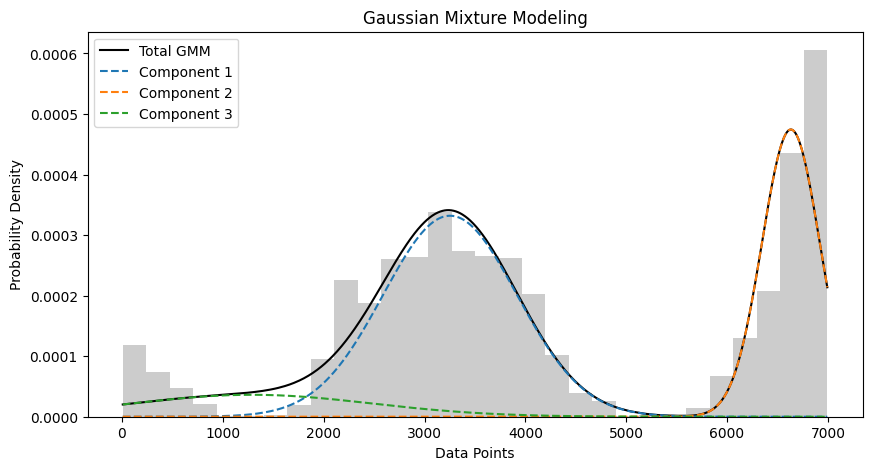

Client 36 - Means: [3253.17450829 6632.80394399 1287.34196184]
Client 36 - Covariances: [ 440150.17168735   81867.20146725 1403262.04762251]
Client 36 - Weights (priors): [0.5521184  0.34028993 0.10759167]
mean of pdf 4191.721176502602
variance of pdf 3972638.3568114154


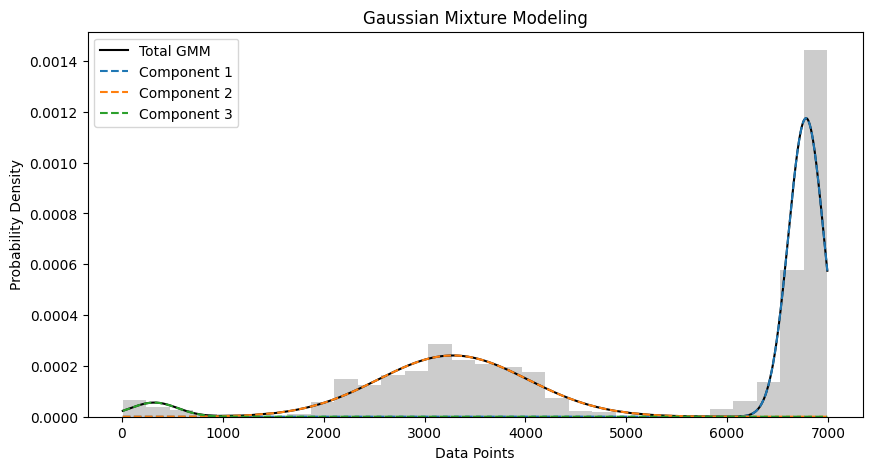

Client 37 - Means: [6783.50016191 3281.88724966  319.13858949]
Client 37 - Covariances: [ 30972.90821546 552316.76798229  55035.06713288]
Client 37 - Weights (priors): [0.51828604 0.44901215 0.03270181]
mean of pdf 4999.837085071756
variance of pdf 3972638.3568114154


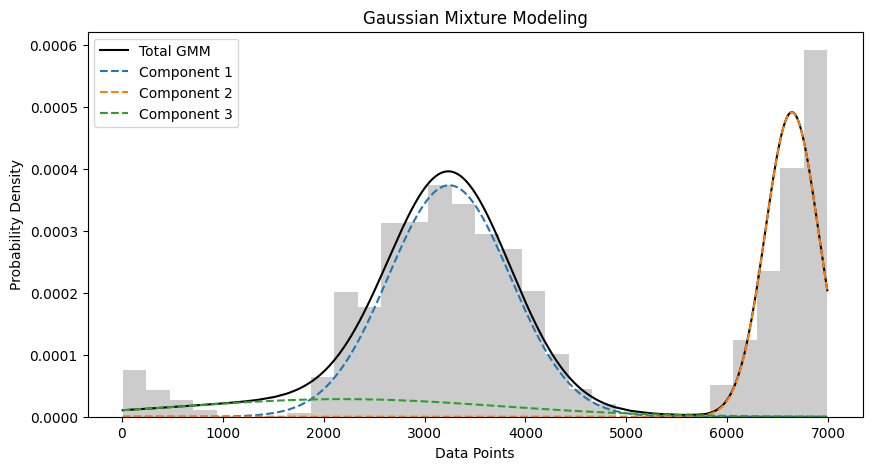

Client 38 - Means: [3245.63936471 6643.12079905 2185.77094786]
Client 38 - Covariances: [ 364615.31805812   70011.25763977 2386807.63651402]
Client 38 - Weights (priors): [0.56475314 0.32532434 0.10992252]
mean of pdf 4234.419376517106
variance of pdf 3972638.3568114154


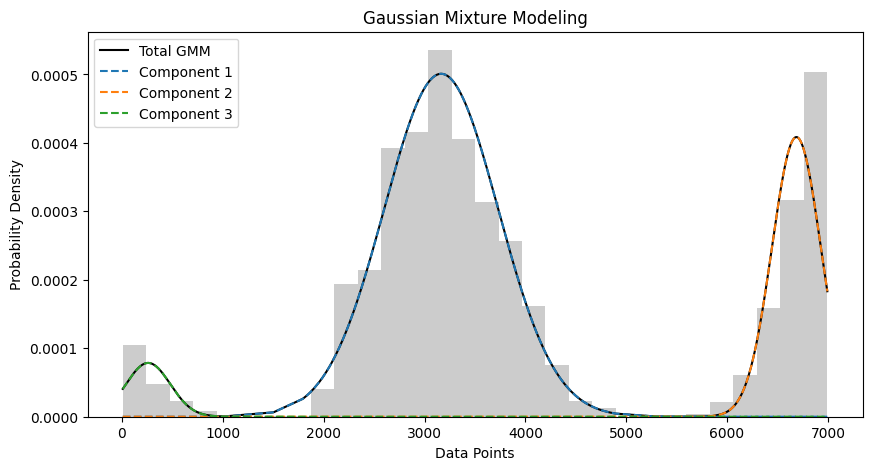

Client 39 - Means: [3165.14508887 6687.54454807  259.72052954]
Client 39 - Covariances: [318770.4062253   58583.76428334  48128.96985336]
Client 39 - Weights (priors): [0.70892892 0.24786102 0.04321005]
mean of pdf 3912.6670736036976
variance of pdf 3972638.3568114154


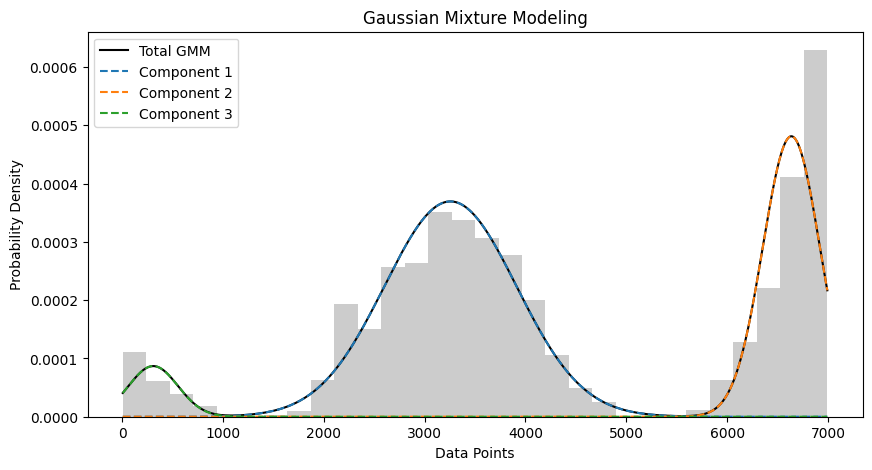

Client 40 - Means: [3256.73805716 6637.53830032  309.32454873]
Client 40 - Covariances: [428681.04874031  79745.22413859  60306.01562165]
Client 40 - Weights (priors): [0.60603942 0.34048875 0.05347183]
mean of pdf 4250.258897171508
variance of pdf 3972638.3568114154


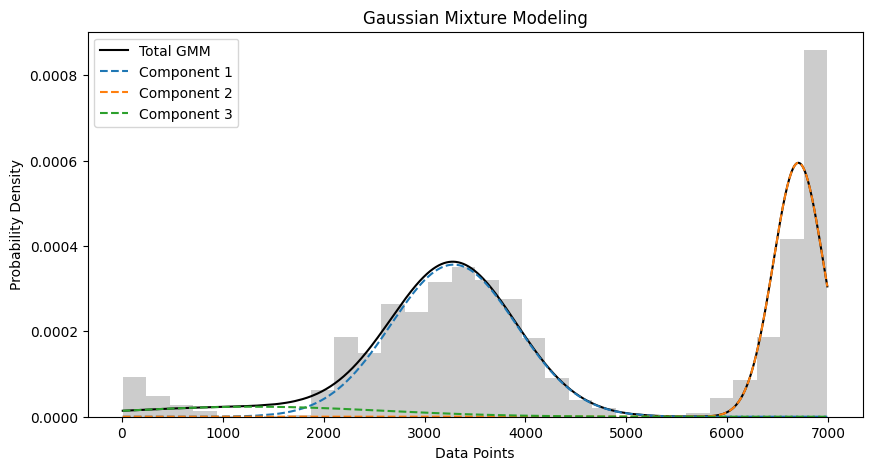

Client 41 - Means: [3288.74864316 6706.75657597 1300.60269614]
Client 41 - Covariances: [ 385816.43999889   61857.77792538 1606599.38556291]
Client 41 - Weights (priors): [0.55462979 0.37078961 0.0745806 ]
mean of pdf 4407.833361928037
variance of pdf 3972638.3568114154


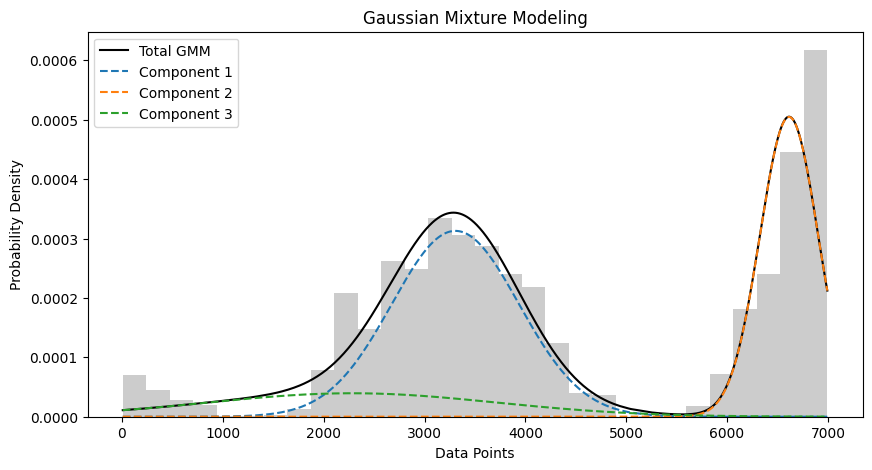

Client 42 - Means: [3306.15088654 6614.77821941 2283.6173633 ]
Client 42 - Covariances: [ 397556.09792921   82981.7954478  2027840.72175597]
Client 42 - Weights (priors): [0.49450075 0.36445265 0.1410466 ]
mean of pdf 4367.764004363606
variance of pdf 3972638.3568114154


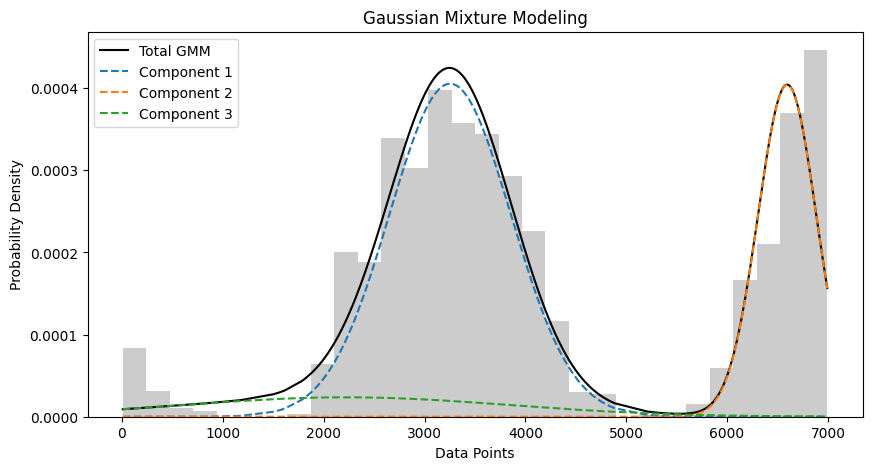

Client 43 - Means: [3253.97461363 6595.97656272 2222.09207258]
Client 43 - Covariances: [ 363231.21748189   83481.63451196 2572968.57250086]
Client 43 - Weights (priors): [0.61247534 0.29244612 0.09507854]
mean of pdf 4133.220238872143
variance of pdf 3972638.3568114154


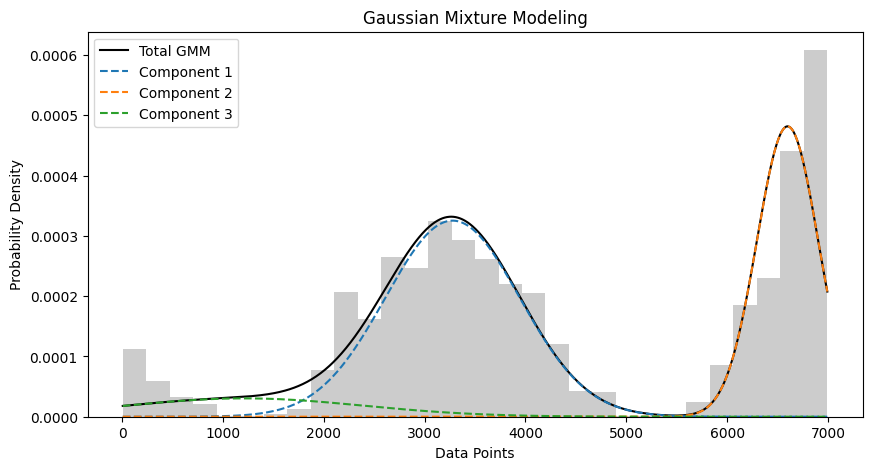

Client 44 - Means: [3277.55007104 6599.8599586  1213.87997888]
Client 44 - Covariances: [ 444821.91982692   92304.02001524 1374111.26906309]
Client 44 - Weights (priors): [0.54377749 0.36680261 0.08941991]
mean of pdf 4311.648804755492
variance of pdf 3972638.3568114154


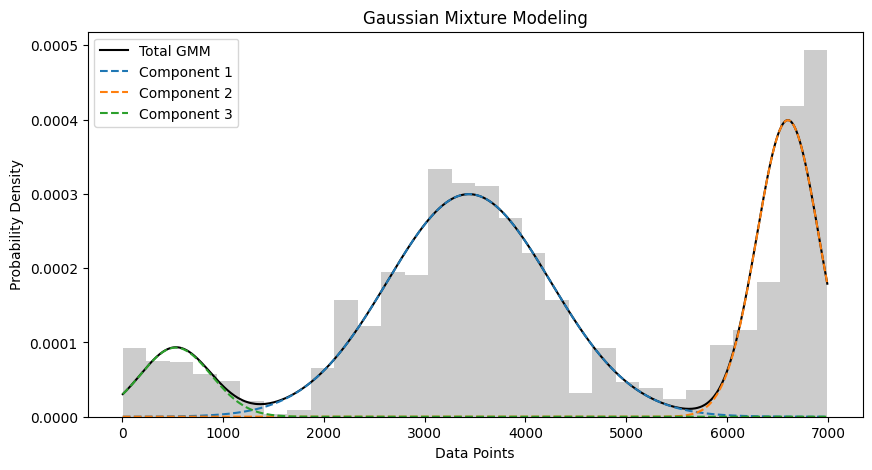

Client 45 - Means: [3439.83467857 6602.9635921   532.01876516]
Client 45 - Covariances: [657696.20350243  95380.89916491 123149.69090722]
Client 45 - Weights (priors): [0.60914028 0.30900853 0.0818512 ]
mean of pdf 4179.2602786770885
variance of pdf 3972638.3568114154


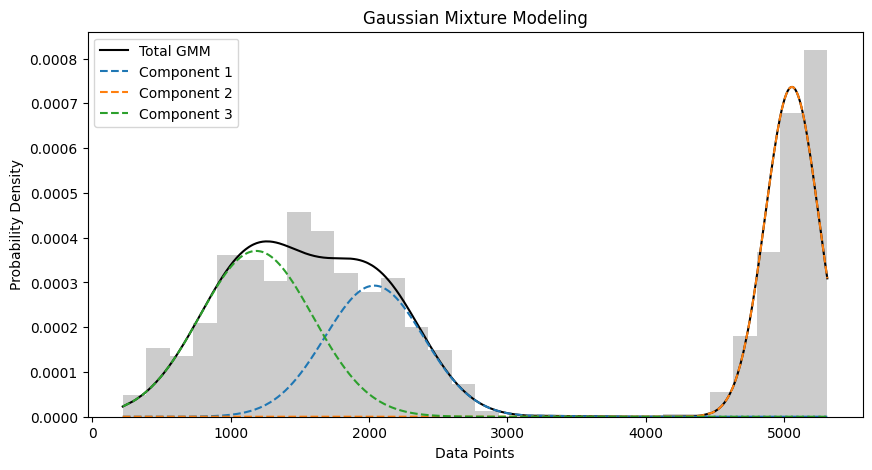

Client 46 - Means: [2037.37102758 5055.24605145 1184.38800525]
Client 46 - Covariances: [127969.56391371  37657.04041935 166826.06445467]
Client 46 - Weights (priors): [0.2625828  0.35830011 0.3791171 ]
mean of pdf 2795.2955202877647
variance of pdf 3972638.3568114154


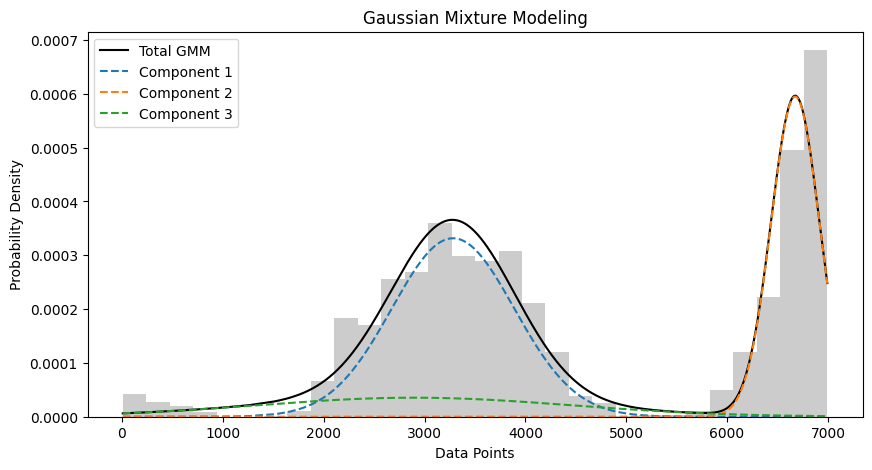

Client 47 - Means: [3283.10505126 6676.04725953 2895.71283936]
Client 47 - Covariances: [ 368741.60243078   57574.70909364 2404950.04528339]
Client 47 - Weights (priors): [0.50478209 0.35779457 0.13742334]
mean of pdf 4443.844605720645
variance of pdf 3972638.3568114154


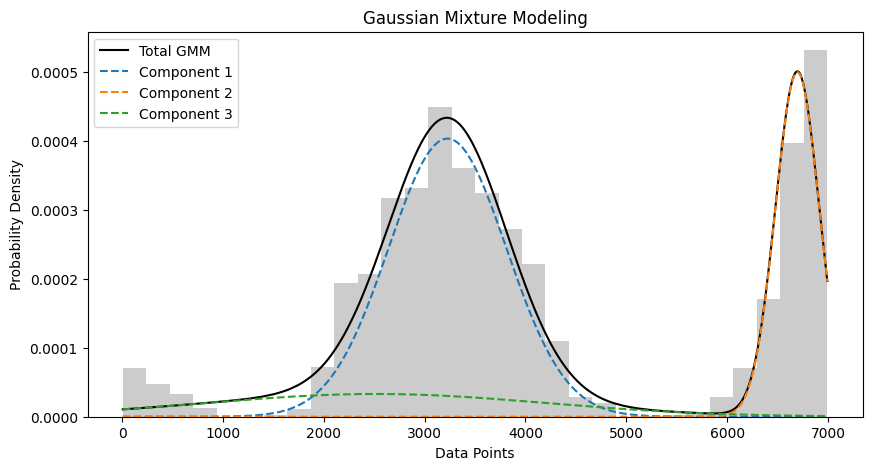

Client 48 - Means: [3227.11696148 6697.05979274 2518.5335154 ]
Client 48 - Covariances: [ 341177.47310103   47121.67326447 2796340.12540953]
Client 48 - Weights (priors): [0.59016623 0.2715749  0.13825886]
mean of pdf 4071.498407119652
variance of pdf 3972638.3568114154


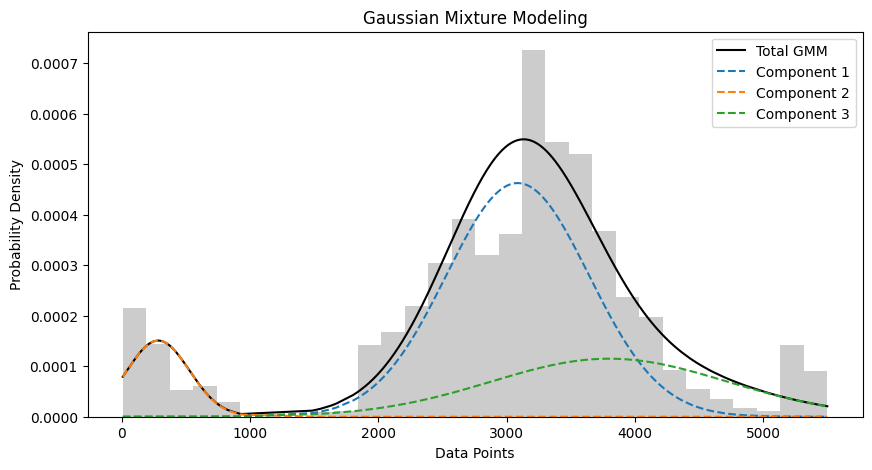

Client 49 - Means: [3085.71332165  284.14644041 3799.00289953]
Client 49 - Covariances: [308193.93512086  59315.92366544 843407.4762429 ]
Client 49 - Weights (priors): [0.64362912 0.0919645  0.26440639]
mean of pdf 3016.666953642322
variance of pdf 3972638.3568114154


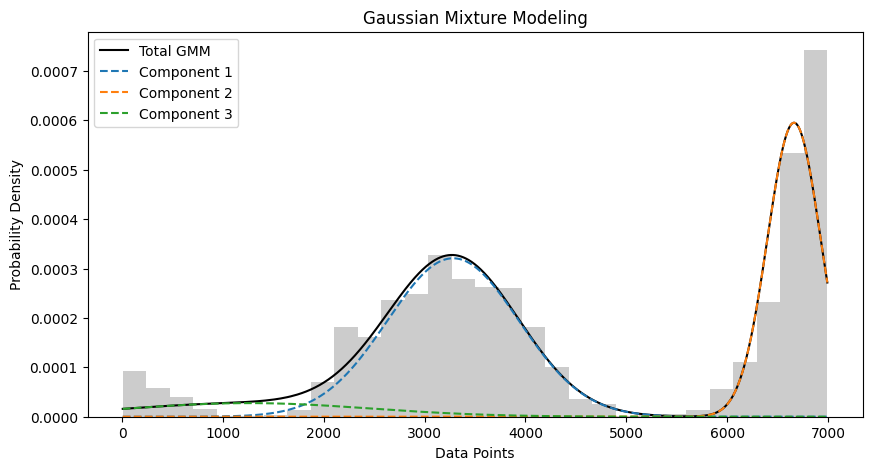

Client 50 - Means: [3283.28690363 6664.10743988 1261.75280851]
Client 50 - Covariances: [ 425335.10788426   69411.35051517 1432112.06235671]
Client 50 - Weights (priors): [0.52431224 0.39296522 0.08272254]
mean of pdf 4444.605342653637
variance of pdf 3972638.3568114154


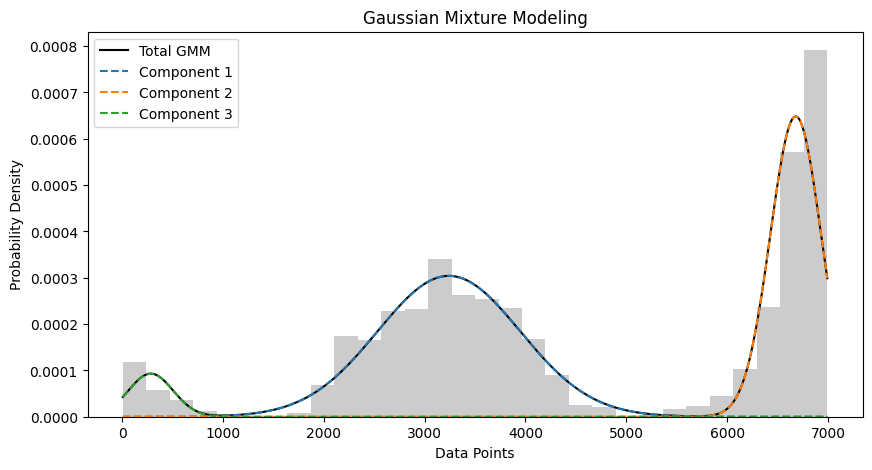

Client 51 - Means: [3241.17072918 6680.77765991  284.44768377]
Client 51 - Covariances: [500143.29370142  63371.13545912  49284.81110604]
Client 51 - Weights (priors): [0.5390724  0.40918252 0.05174508]
mean of pdf 4495.601862542026
variance of pdf 3972638.3568114154


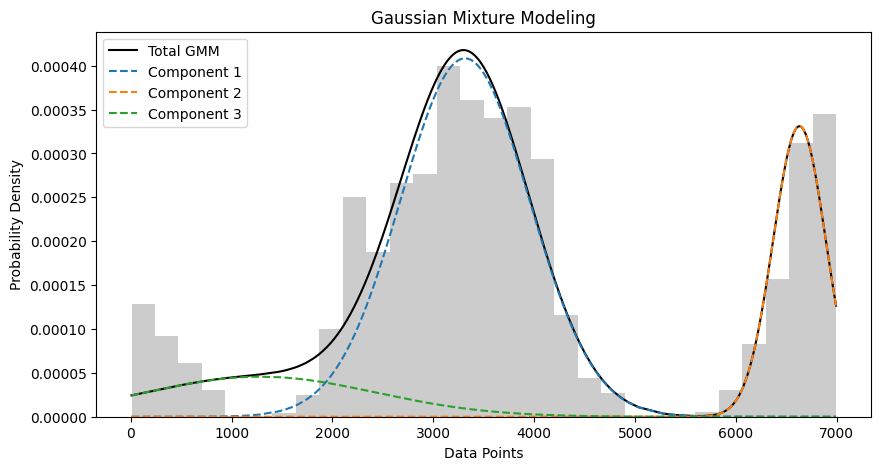

Client 52 - Means: [3314.4226787  6631.27423905 1286.00649799]
Client 52 - Covariances: [ 406557.89266127   68467.07858668 1297786.75922588]
Client 52 - Weights (priors): [0.65260787 0.21710742 0.13028471]
mean of pdf 3770.264142456826
variance of pdf 3972638.3568114154


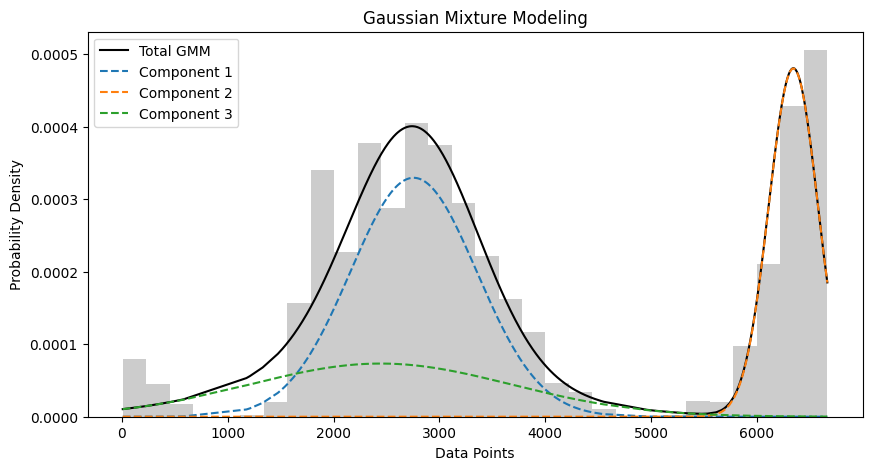

Client 53 - Means: [2756.23379261 6343.39449285 2444.12100622]
Client 53 - Covariances: [ 356729.30746822   53896.50828604 1523537.82848215]
Client 53 - Weights (priors): [0.49351639 0.27953022 0.22695339]
mean of pdf 3688.1185691093287
variance of pdf 3972638.3568114154


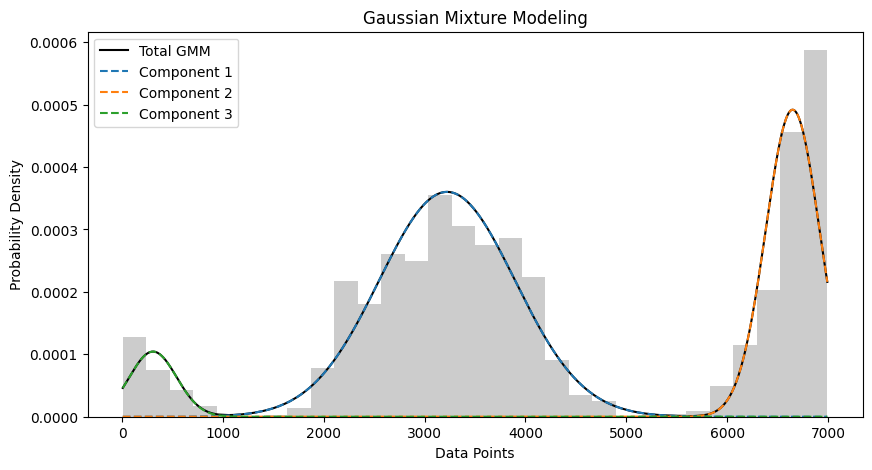

Client 54 - Means: [3223.18899674 6650.25707435  306.79499152]
Client 54 - Covariances: [453653.14546895  71790.57382097  55086.53691369]
Client 54 - Weights (priors): [0.60822025 0.33038864 0.06139111]
mean of pdf 4176.412689021908
variance of pdf 3972638.3568114154


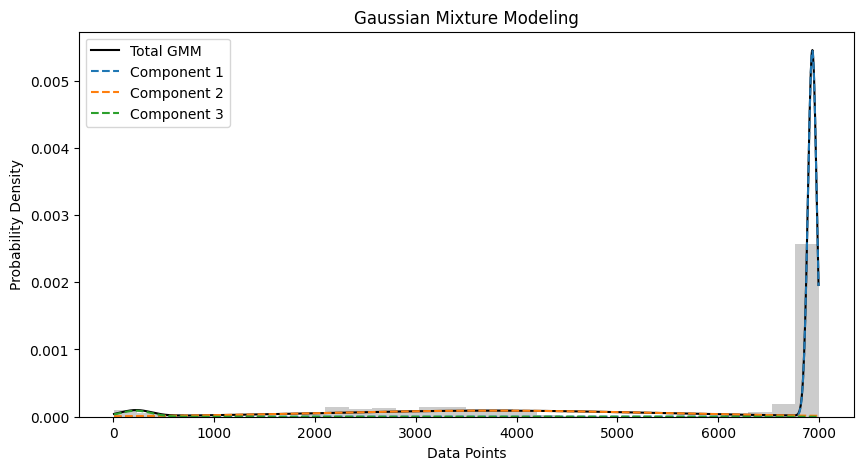

Client 55 - Means: [6932.23758399 3755.70981193  223.68634337]
Client 55 - Covariances: [1.85511354e+03 2.77884244e+06 2.43555074e+04]
Client 55 - Weights (priors): [0.58726211 0.37773439 0.0350035 ]
mean of pdf 5497.531033260585
variance of pdf 3972638.3568114154


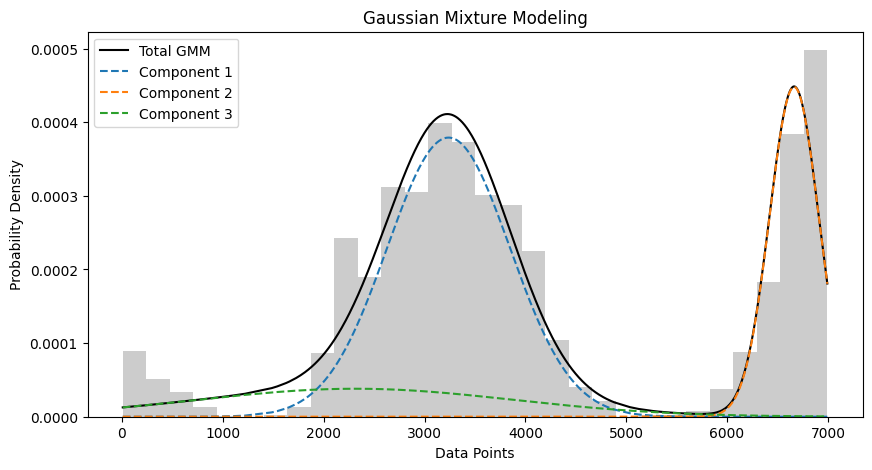

Client 56 - Means: [3238.40638531 6664.84625803 2316.32591836]
Client 56 - Covariances: [ 369171.80284457   59613.8586137  2422481.36164453]
Client 56 - Weights (priors): [0.57749887 0.27416748 0.14833365]
mean of pdf 4041.049205223341
variance of pdf 3972638.3568114154


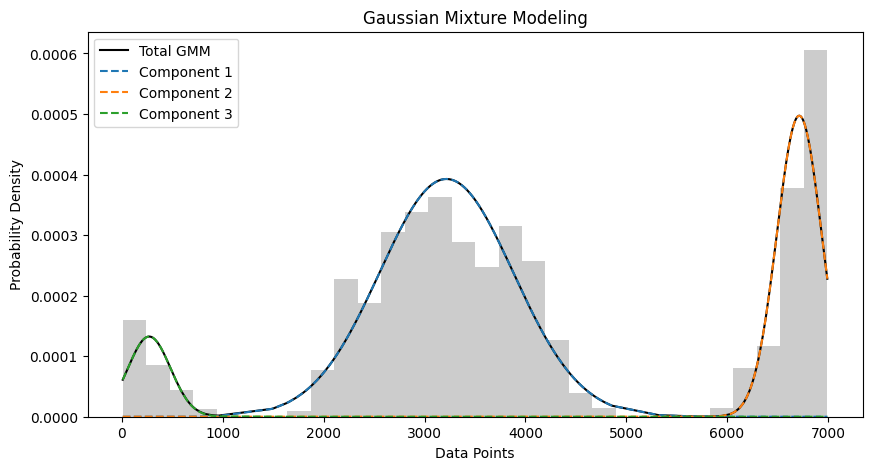

Client 57 - Means: [3217.29314591 6715.83111884  270.27041016]
Client 57 - Covariances: [439436.3947224   49599.03495185  44458.43045849]
Client 57 - Weights (priors): [0.65247849 0.27754232 0.0699792 ]
mean of pdf 3982.055198043957
variance of pdf 3972638.3568114154


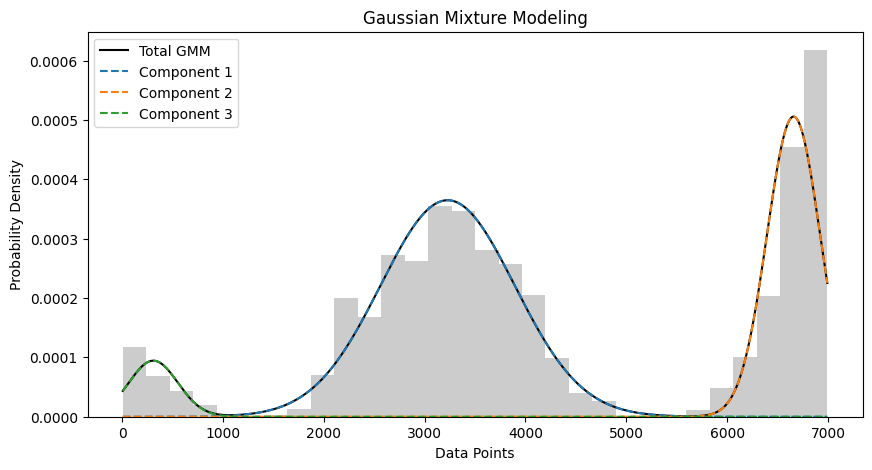

Client 58 - Means: [3228.48350679 6659.23734114  309.98559962]
Client 58 - Covariances: [442595.48630562  69337.78292     59175.20561966]
Client 58 - Weights (priors): [0.60850075 0.33390263 0.05759662]
mean of pdf 4205.925624704596
variance of pdf 3972638.3568114154


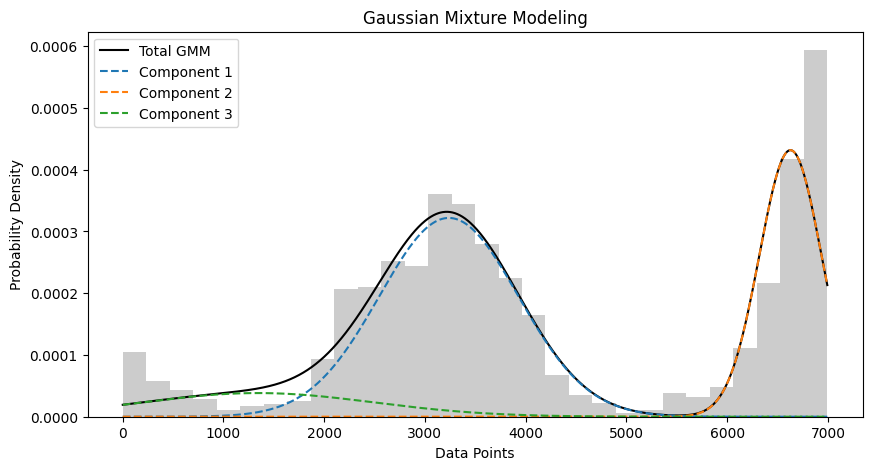

Client 59 - Means: [3238.05802125 6628.10332077 1344.0365136 ]
Client 59 - Covariances: [ 476095.3792986    94874.18134178 1314840.94522138]
Client 59 - Weights (priors): [0.55664444 0.33321615 0.11013941]
mean of pdf 4159.069434156007
variance of pdf 3972638.3568114154


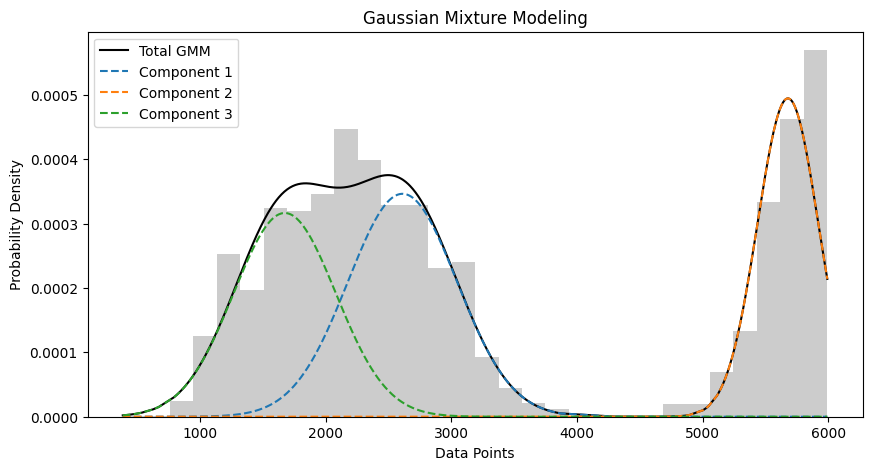

Client 60 - Means: [2611.47742366 5679.48677844 1674.22661966]
Client 60 - Covariances: [188346.37507496  58706.81323317 165336.36915657]
Client 60 - Weights (priors): [0.37684941 0.30047198 0.32267861]
mean of pdf 3230.8974769724937
variance of pdf 3972638.3568114154


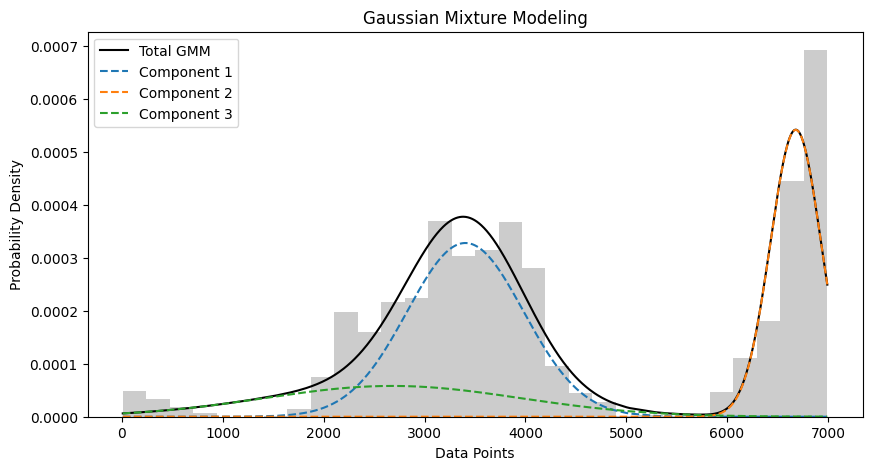

Client 61 - Means: [3405.00649481 6681.06140074 2680.44886655]
Client 61 - Covariances: [ 332587.36203151   63095.26248637 1602608.86491515]
Client 61 - Weights (priors): [0.47432146 0.34114346 0.18453508]
mean of pdf 4388.904916098803
variance of pdf 3972638.3568114154


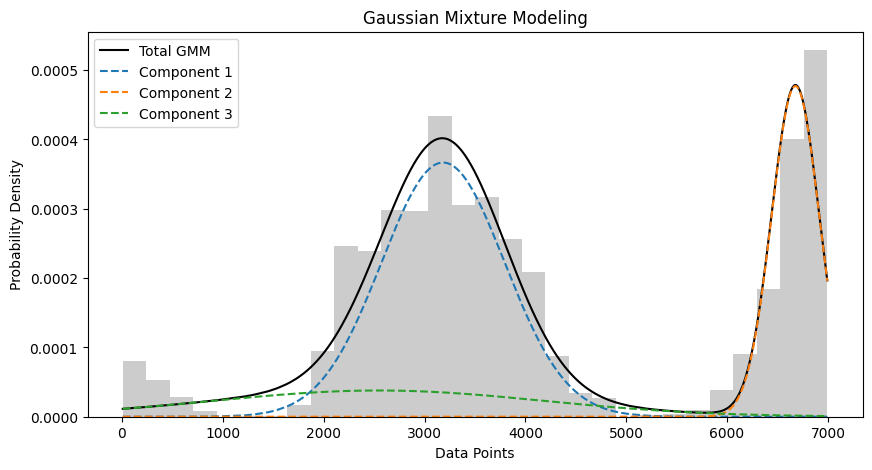

Client 62 - Means: [3184.16630888 6678.0035844  2544.71273992]
Client 62 - Covariances: [ 373290.39210309   56064.28527836 2676748.84318377]
Client 62 - Weights (priors): [0.56162785 0.28314828 0.15522388]
mean of pdf 4074.1818560099805
variance of pdf 3972638.3568114154


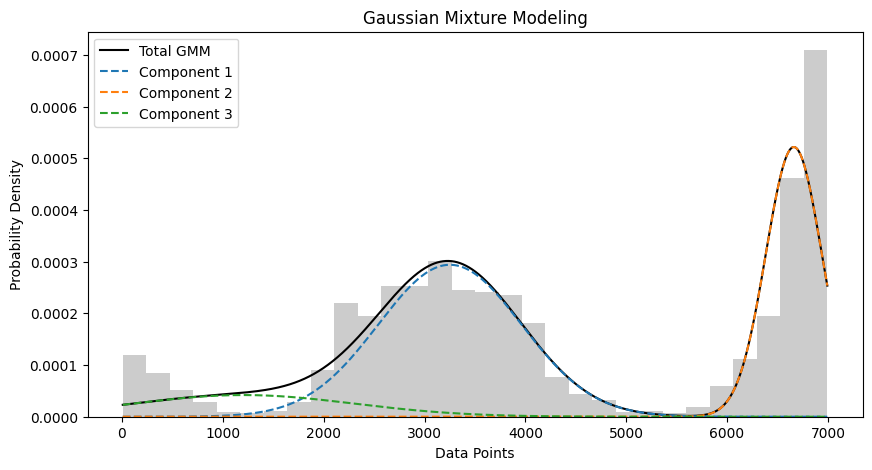

Client 63 - Means: [3251.75126933 6662.05617076 1204.62058942]
Client 63 - Covariances: [ 505256.10690369   76378.45159553 1197900.6193958 ]
Client 63 - Weights (priors): [0.52364896 0.36139007 0.11496098]
mean of pdf 4248.861435588216
variance of pdf 3972638.3568114154


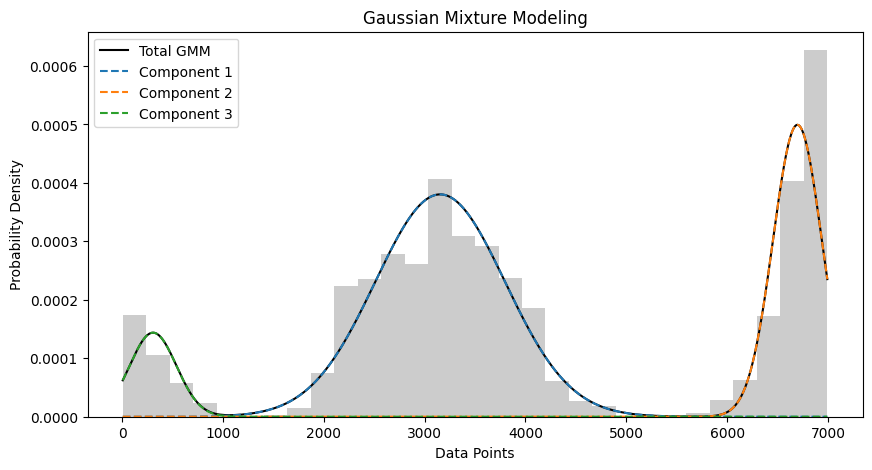

Client 64 - Means: [3154.57104367 6697.64227485  307.19002054]
Client 64 - Covariances: [414416.34639445  58382.19527619  53871.1251493 ]
Client 64 - Weights (priors): [0.61386508 0.30248769 0.08364724]
mean of pdf 3988.1309043793326
variance of pdf 3972638.3568114154


In [11]:

filename = 'gmm_production3.csv'
save_gmm_params_to_csv2(filename, data1)



# Iterate over each client and process their data
for client_id in range(1, 65):
    gmm, x = process_client1(client_id, data1)
    mean_pdf, varinace_pdf = calculate_gmm_statistics(gmm)
    plot_gmm(gmm, x)  # This will plot 64 figures; you might want to adjust this based on your needs

    # Print GMM parameters for each client
    print(f"Client {client_id} - Means:", gmm.means_.flatten())
    print(f"Client {client_id} - Covariances:", gmm.covariances_.flatten())
    print(f"Client {client_id} - Weights (priors):", gmm.weights_)
    print('mean of pdf',mean_pdf)
    print('variance of pdf',variance_pdf)


# ***calculer DI  Js: mesure la similarité Une valeur plus élevée de la divergence de JS indique une plus grande dissimilarité entre les distributions, tandis qu’une valeur plus proche de zéro indique une plus grande similarité.

 and DJ: cost ***

for consommation

In [20]:
import pandas as pd
import numpy as np
import scipy.linalg as linalg
import itertools

def kl_divergence(mean_p, cov_p, mean_q, cov_q):
    inv_cov_q = np.linalg.inv(cov_q)
    diff_mean = mean_p - mean_q
    trace_term = np.trace(inv_cov_q @ cov_p)
    quad_term = diff_mean.T @ inv_cov_q @ diff_mean
    log_det_term = np.log(np.linalg.det(cov_q) / np.linalg.det(cov_p))

    return 0.5 * (trace_term + quad_term - len(mean_p) + log_det_term)

def jensen_shannon_distance(mean_p, cov_p, mean_q, cov_q):
    mean_m = 0.5 * (mean_p + mean_q)
    cov_m = 0.5 * (cov_p + cov_q)

    kl_pm = kl_divergence(mean_p, cov_p, mean_m, cov_m)
    kl_qm = kl_divergence(mean_q, cov_q, mean_m, cov_m)

    return np.sqrt(0.5 * (kl_pm + kl_qm))

def wasserstein_distance(mean_p, cov_p, mean_q, cov_q):
    mean_diff = mean_p - mean_q
    cov_sqrt_p = linalg.sqrtm(cov_p)
    cov_mid = linalg.sqrtm(cov_sqrt_p @ cov_q @ cov_sqrt_p)

    return np.sqrt(np.sum(mean_diff**2) + np.trace(cov_p + cov_q - 2 * cov_mid))

# Read data
df = pd.read_csv('gmm_parameters2.csv', names=['client_id', 'mean', 'covariance', 'weight'])
df['mean'] = pd.to_numeric(df['mean'], errors='coerce')
df['covariance'] = pd.to_numeric(df['covariance'], errors='coerce')
df['weight'] = pd.to_numeric(df['weight'], errors='coerce')

df = df.dropna(subset=['mean', 'covariance', 'weight'])

# Convert mean and covariance to appropriate numeric types
df['mean'] = df['mean'].astype(float)
df['covariance'] = df['covariance'].astype(float)

# Initialize output
results = []

# Iterate over all pairs of clients
for (client_id_1, group1), (client_id_2, group2) in itertools.combinations(df.groupby('client_id'), 2):
    for i in range(2):
        mean_p = np.array([group1.iloc[i]['mean']])
        cov_p = np.array([[group1.iloc[i]['covariance']]])
        mean_q = np.array([group2.iloc[i]['mean']])
        cov_q = np.array([[group2.iloc[i]['covariance']]])

        js_dist = jensen_shannon_distance(mean_p, cov_p, mean_q, cov_q)
        w_dist = wasserstein_distance(mean_p, cov_p, mean_q, cov_q)

        results.append({'clients': f"{client_id_1}-{client_id_2}-{i+1}", 'DI': js_dist, 'DL': w_dist})

# Convert to DataFrame and save to CSV
result_df = pd.DataFrame(results)
result_df.to_csv('distribution_distances_consumtion.csv', index=False)

print("Distances calculated and saved to distribution_distances_consumption.csv.")


Distances calculated and saved to distribution_distances_consumption.csv.


**For the Production calculate the DI and DJ**

In [21]:


# Read data
df1 = pd.read_csv('gmm_production2.csv', names=['client_id', 'mean', 'covariance', 'weight'])
df1['mean'] = pd.to_numeric(df1['mean'], errors='coerce')
df1['covariance'] = pd.to_numeric(df1['covariance'], errors='coerce')
df1['weight'] = pd.to_numeric(df1['weight'], errors='coerce')

df1 = df1.dropna(subset=['mean', 'covariance', 'weight'])

# Convert mean and covariance to appropriate numeric types
df1['mean'] = df1['mean'].astype(float)
df1['covariance'] = df1['covariance'].astype(float)

# Initialize output
results1 = []

# Iterate over all pairs of clients
for (client_id_1, group1), (client_id_2, group2) in itertools.combinations(df1.groupby('client_id'), 2):
    for i in range(2):
        mean_p = np.array([group1.iloc[i]['mean']])
        cov_p = np.array([[group1.iloc[i]['covariance']]])
        mean_q = np.array([group2.iloc[i]['mean']])
        cov_q = np.array([[group2.iloc[i]['covariance']]])

        js_dist = jensen_shannon_distance(mean_p, cov_p, mean_q, cov_q)
        w_dist = wasserstein_distance(mean_p, cov_p, mean_q, cov_q)

        results1.append({'clients': f"{client_id_1}-{client_id_2}-{i+1}", 'DI': js_dist, 'DL': w_dist})

# Convert to DataFrame and save to CSV
result_df1 = pd.DataFrame(results1)
result_df1.to_csv('distribution_distances_production.csv', index=False)

print("Distances calculated and saved to distribution_distances_production.csv.")

Distances calculated and saved to distribution_distances_production.csv.


# **For the Production**

In [22]:
import pandas as pd
from io import StringIO


data_df = pd.read_csv('distribution_distances_production.csv')

# Function to get the main client identifier
data_df['clients'] = data_df['clients'].apply(lambda x: '-'.join(x.split('-')[:2]))

# Group by the new main_client identifier and calculate means
result_df = data_df.groupby('clients').agg({'DI': 'mean', 'DL': 'mean'}).reset_index()

result_df.to_csv('meanDI_production.csv')

In [23]:
result_df

,clients,DI,DL
0,1-10,0.192553,252.072127
1,1-11,0.377206,345.168209
2,1-12,1.409935,1349.212162
3,1-13,0.117793,169.416542
4,1-14,0.144197,152.537173
...,...,...,...
2011,64-8,0.119736,158.980781
2012,64-9,0.139828,146.060991
2013,7-8,0.056742,79.086957
2014,7-9,0.104388,136.730485


C:\Users\USER\AppData\Local\Temp\ipykernel_29348\1264620301.py:39: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(distance_matrix, 'single')


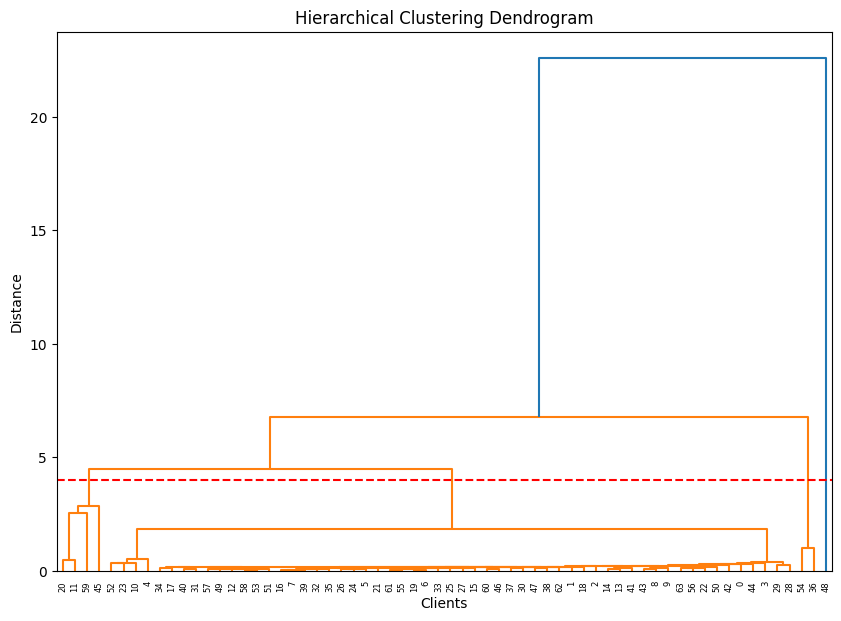

In [24]:
import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
import matplotlib.pyplot as plt
df=result_df
# Assuming df is already loaded
# Extract clients and 'DI' values
clients = df['clients']
DI_values = df['DI']

# Function to parse client IDs correctly from both old and new formats
def parse_client_ids(client_pair):
    parts = client_pair.split('-')
    if len(parts) == 3:
        # Old format: "1-10-1"
        return int(parts[0]), int(parts[1])
    elif len(parts) == 2:
        # New format: "1-10"
        return int(parts[0]), int(parts[1])
    else:
        raise ValueError(f"Unrecognized client pair format: {client_pair}")

# Extract and parse unique client IDs
client_ids = [parse_client_ids(client) for client in clients]
unique_clients = np.unique([id for sublist in client_ids for id in sublist])

# Initialize distance matrix with zeros
num_clients = len(unique_clients)
distance_matrix = np.zeros((num_clients, num_clients))

# Populate distance matrix with 'DI' values
for i, client_pair in enumerate(clients):
    client1, client2 = parse_client_ids(client_pair)
    idx1 = np.where(unique_clients == client1)[0][0]
    idx2 = np.where(unique_clients == client2)[0][0]
    distance_matrix[idx1, idx2] = DI_values[i]
    distance_matrix[idx2, idx1] = DI_values[i]
# Perform hierarchical clustering using single linkage
linked = linkage(distance_matrix, 'single')

# Assuming 'linked' is already computed from your previous code
def plot_dendrogram(linked, max_d=None):
    plt.figure(figsize=(10, 7))
    dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
    if max_d:
        plt.axhline(y=max_d, color='r', linestyle='--')
    plt.title('Hierarchical Clustering Dendrogram')
    plt.xlabel('Clients')
    plt.ylabel('Distance')
    plt.show()

# Example usage
plot_dendrogram(linked, max_d=4)  # Change max_d to see how the clusters change

# Interactive selection
max_d = float(input("Enter the maximum distance threshold for clustering: "))
clusters = fcluster(linked, t=max_d, criterion='distance')
cluster_df = pd.DataFrame({'Client': unique_clients, 'Cluster': clusters})
cluster_df.to_csv('clustering_production.csv')


# For the consumption

In [25]:
import pandas as pd
from io import StringIO


data_df1 = pd.read_csv('distribution_distances_consumtion.csv')

# Function to get the main client identifier
data_df1['clients'] = data_df1['clients'].apply(lambda x: '-'.join(x.split('-')[:2]))

# Group by the new main_client identifier and calculate means
result_df1 = data_df1.groupby('clients').agg({'DI': 'mean', 'DL': 'mean'}).reset_index()
result_df1

,clients,DI,DL
0,1-10,0.092678,206.373009
1,1-11,0.207739,490.580835
2,1-12,0.508822,1213.438757
3,1-13,0.152469,372.450842
4,1-14,1.367533,3325.738967
...,...,...,...
2011,64-8,0.160559,347.570482
2012,64-9,0.126463,297.372566
2013,7-8,0.127498,259.055570
2014,7-9,0.089130,193.711220


In [26]:
result_df1.to_csv('meanDI_consumption.csv')

C:\Users\USER\AppData\Local\Temp\ipykernel_29348\2153088555.py:39: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(distance_matrix, 'single')


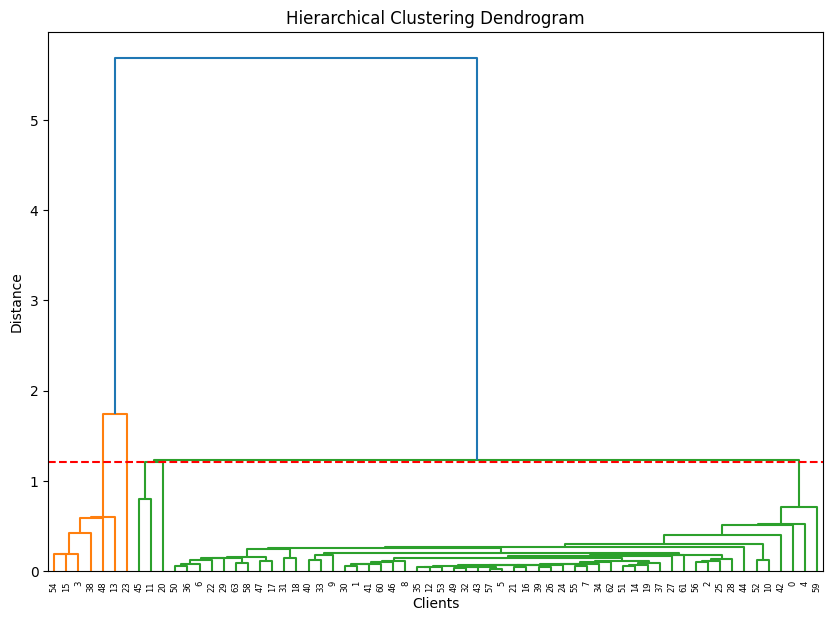

    Client  Cluster
0        1        1
1        2        1
2        3        1
3        4        3
4        5        1
..     ...      ...
59      60        1
60      61        1
61      62        1
62      63        1
63      64        1

[64 rows x 2 columns]


In [27]:
import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
import matplotlib.pyplot as plt
df=pd.read_csv('meanDI_consumption.csv')
# Assuming df is already loaded
# Extract clients and 'DI' values
clients = df['clients']
DI_values = df['DI']

# Function to parse client IDs correctly from both old and new formats
def parse_client_ids(client_pair):
    parts = client_pair.split('-')
    if len(parts) == 3:
        # Old format: "1-10-1"
        return int(parts[0]), int(parts[1])
    elif len(parts) == 2:
        # New format: "1-10"
        return int(parts[0]), int(parts[1])
    else:
        raise ValueError(f"Unrecognized client pair format: {client_pair}")

# Extract and parse unique client IDs
client_ids = [parse_client_ids(client) for client in clients]
unique_clients = np.unique([id for sublist in client_ids for id in sublist])

# Initialize distance matrix with zeros
num_clients = len(unique_clients)
distance_matrix = np.zeros((num_clients, num_clients))

# Populate distance matrix with 'DI' values
for i, client_pair in enumerate(clients):
    client1, client2 = parse_client_ids(client_pair)
    idx1 = np.where(unique_clients == client1)[0][0]
    idx2 = np.where(unique_clients == client2)[0][0]
    distance_matrix[idx1, idx2] = DI_values[i]
    distance_matrix[idx2, idx1] = DI_values[i]
# Perform hierarchical clustering using single linkage
linked = linkage(distance_matrix, 'single')

# Assuming 'linked' is already computed from your previous code
def plot_dendrogram(linked, max_d=None):
    plt.figure(figsize=(10, 7))
    dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
    if max_d:
        plt.axhline(y=max_d, color='r', linestyle='--')
    plt.title('Hierarchical Clustering Dendrogram')
    plt.xlabel('Clients')
    plt.ylabel('Distance')
    plt.show()

# Example usage
plot_dendrogram(linked, max_d=1.21)  # Change max_d to see how the clusters change

# Interactive selection
max_d = float(input("Enter the maximum distance threshold for clustering: "))
clusters = fcluster(linked, t=max_d, criterion='distance')
cluster_df = pd.DataFrame({'Client': unique_clients, 'Cluster': clusters})
print(cluster_df)


In [37]:
cluster_df=pd.read('clustering_production.csv')

In [76]:
cluster_df1=pd.read_csv('clustering_production.csv')
desired_columns = ['client_id', 'product_type', 'is_business', 'county']
data_extract1 = data1[desired_columns]
cluster_df1 = cluster_df1.rename(columns={'Client': 'client_id'})
data_extract1=pd.merge(data_extract1,cluster_df1, on='client_id',how='inner')


In [82]:
df1.to_csv('client_cluster_production.csv')

In [77]:
df1=data_extract1.drop_duplicates()
df=data_extract.drop_duplicates()

In [69]:
df.to_csv('client_cluster_consommation.csv')

In [81]:
df1 = df1.drop(columns=['Unnamed: 0'])

In [66]:
data_extract.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 439422 entries, 0 to 439421
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype
---  ------        --------------   -----
 0   client_id     439422 non-null  int64
 1   product_type  439422 non-null  int64
 2   is_business   439422 non-null  int64
 3   county        439422 non-null  int64
 4   Cluster       439422 non-null  int32
dtypes: int32(1), int64(4)
memory usage: 15.1 MB


**Using the pdf = somme des distrubution**

In [32]:
import pandas as pd
import numpy as np
import scipy.linalg as linalg
import itertools

def kl_divergence(mean_p, cov_p, mean_q, cov_q):
    inv_cov_q = np.linalg.inv(cov_q)
    diff_mean = mean_p - mean_q
    trace_term = np.trace(inv_cov_q @ cov_p)
    quad_term = diff_mean.T @ inv_cov_q @ diff_mean
    log_det_term = np.log(np.linalg.det(cov_q) / np.linalg.det(cov_p))
    
    # Calculate KL divergence
    return 0.5 * (trace_term + quad_term - len(mean_p) + log_det_term)

def jensen_shannon_distance(mean_p, cov_p, mean_q, cov_q):
    mean_m = 0.5 * (mean_p + mean_q)
    cov_m = 0.5 * (cov_p + cov_q)
    
    # Calculate Jensen-Shannon distance using KL divergence
    kl_pm = kl_divergence(mean_p, cov_p, mean_m, cov_m)
    kl_qm = kl_divergence(mean_q, cov_q, mean_m, cov_m)
    
    return np.sqrt(0.5 * (kl_pm + kl_qm))

def wasserstein_distance(mean_p, cov_p, mean_q, cov_q):
    mean_diff = mean_p - mean_q
    cov_sqrt_p = linalg.sqrtm(cov_p)
    cov_mid = linalg.sqrtm(cov_sqrt_p @ cov_q @ cov_sqrt_p)
    
    # Calculate Wasserstein distance
    return np.sqrt(np.sum(mean_diff**2) + np.trace(cov_p + cov_q - 2 * cov_mid))

# Load your DataFrame, assuming it's already populated with 'mean_pdf', 'covariance_pdf', and 'client_id'
# df = pd.read_csv('your_dataset.csv')
df1 = pd.read_csv('gmm_parameters.csv', names=['client_id','mean','covarinace','weight', 'mean_pdf','covariance_pdf'])
df = df1[['client_id', 'mean_pdf', 'covariance_pdf']]
# Drop rows with missing or invalid data
df = df.dropna(subset=['mean_pdf', 'covariance_pdf'])
df = df.drop_duplicates()

# Convert 'mean_pdf' and 'covariance_pdf' columns to numeric
df['mean_pdf'] = pd.to_numeric(df['mean_pdf'], errors='coerce')
df['covariance_pdf'] = pd.to_numeric(df['covariance_pdf'], errors='coerce')

# Initialize results list
results = []

# Iterate over all pairs of clients
for (client_id_1, group1), (client_id_2, group2) in itertools.combinations(df.groupby('client_id'), 2):
    mean_p = group1['mean_pdf'].values
    cov_p = group1['covariance_pdf'].values.reshape(-1, 1)  # Assuming covariance is a scalar for each client
    mean_q = group2['mean_pdf'].values
    cov_q = group2['covariance_pdf'].values.reshape(-1, 1)  # Assuming covariance is a scalar for each client
    
    js_dist = jensen_shannon_distance(mean_p, cov_p, mean_q, cov_q)
    w_dist = wasserstein_distance(mean_p, cov_p, mean_q, cov_q)
    
    results.append({'clients': f"{client_id_1}-{client_id_2}", 'JS Distance': js_dist, 'Wasserstein Distance': w_dist})

# Convert results to DataFrame and save to CSV
result_df = pd.DataFrame(results)
result_df.to_csv('distribution_distances_consumption_pdf.csv', index=False)

print("Distances calculated and saved to distribution_distances_consumption_pdf.csv.")


Distances calculated and saved to distribution_distances_consumption_pdf.csv.


In [45]:


df = df.drop_duplicates()

# Convert 'mean_pdf' and 'covariance_pdf' columns to numeric
df['mean_pdf'] = pd.to_numeric(df['mean_pdf'], errors='coerce')
df['covariance_pdf'] = pd.to_numeric(df['covariance_pdf'], errors='coerce')

# Initialize results list
results = []

# Iterate over all pairs of clients
for (client_id_1, group1), (client_id_2, group2) in itertools.combinations(df.groupby('client_id'), 2):
    mean_p = group1['mean_pdf'].values
    cov_p = group1['covariance_pdf'].values.reshape(-1, 1)  # Assuming covariance is a scalar for each client
    mean_q = group2['mean_pdf'].values
    cov_q = group2['covariance_pdf'].values.reshape(-1, 1)  # Assuming covariance is a scalar for each client
    
    js_dist = jensen_shannon_distance(mean_p, cov_p, mean_q, cov_q)
    w_dist = wasserstein_distance(mean_p, cov_p, mean_q, cov_q)
    
    results.append({'clients': f"{client_id_1}-{client_id_2}", 'JS Distance': js_dist, 'Wasserstein Distance': w_dist})

# Convert results to DataFrame and save to CSV
result_df = pd.DataFrame(results)
result_df.to_csv('distribution_distances_production_pdf.csv', index=False)

print("Distances calculated and saved to distribution_distances_production_pdf.csv.")

Distances calculated and saved to distribution_distances_production_pdf.csv.


clustering using pdf

In [49]:
import pandas as pd
from io import StringIO


data_df = pd.read_csv('distribution_distances_consumption_pdf.csv')

# Function to get the main client identifier
data_df

,clients,JS Distance,Wasserstein Distance
0,1-10,0.169732,843.575540
1,1-11,0.102250,495.614881
2,1-12,0.338458,1645.537005
3,1-13,0.161191,782.411555
4,1-14,0.313255,1519.299424
...,...,...,...
2011,64-8,0.094394,530.675178
2012,64-9,0.058065,328.452356
2013,7-8,0.077765,438.136987
2014,7-9,0.041247,234.549808


C:\Users\Ghada\AppData\Local\Temp\ipykernel_24896\2125356191.py:39: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(distance_matrix, 'single')


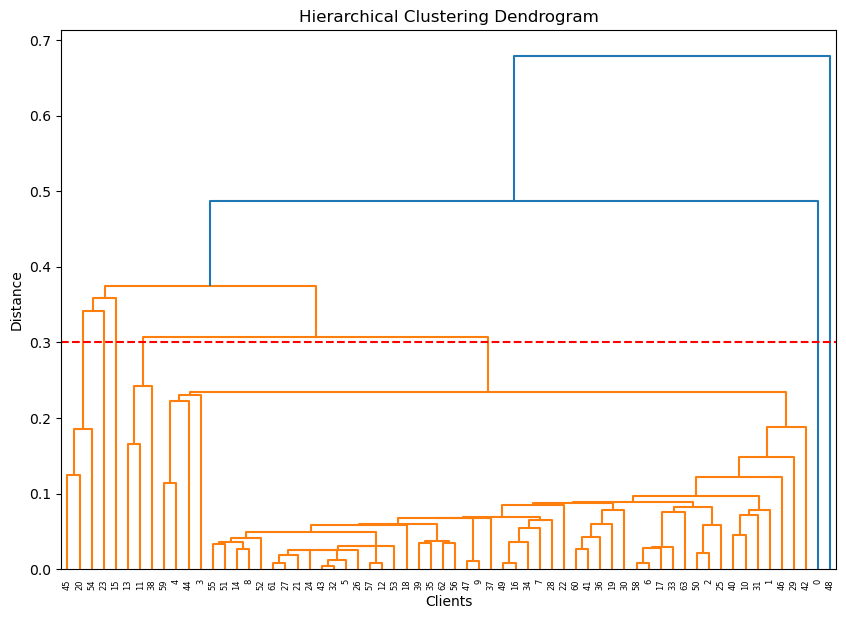

Enter the maximum distance threshold for clustering: 0.3


In [34]:
import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
import matplotlib.pyplot as plt
df=pd.read_csv('distribution_distances_consumption_pdf.csv')
# Assuming df is already loaded
# Extract clients and 'DI' values
clients = df['clients']
DI_values = df['JS Distance']

# Function to parse client IDs correctly from both old and new formats
def parse_client_ids(client_pair):
    parts = client_pair.split('-')
    if len(parts) == 3:
        # Old format: "1-10-1"
        return int(parts[0]), int(parts[1])
    elif len(parts) == 2:
        # New format: "1-10"
        return int(parts[0]), int(parts[1])
    else:
        raise ValueError(f"Unrecognized client pair format: {client_pair}")

# Extract and parse unique client IDs
client_ids = [parse_client_ids(client) for client in clients]
unique_clients = np.unique([id for sublist in client_ids for id in sublist])

# Initialize distance matrix with zeros
num_clients = len(unique_clients)
distance_matrix = np.zeros((num_clients, num_clients))

# Populate distance matrix with 'DI' values
for i, client_pair in enumerate(clients):
    client1, client2 = parse_client_ids(client_pair)
    idx1 = np.where(unique_clients == client1)[0][0]
    idx2 = np.where(unique_clients == client2)[0][0]
    distance_matrix[idx1, idx2] = DI_values[i]
    distance_matrix[idx2, idx1] = DI_values[i]
# Perform hierarchical clustering using single linkage
linked = linkage(distance_matrix, 'single')

# Assuming 'linked' is already computed from your previous code
def plot_dendrogram(linked, max_d=None):
    plt.figure(figsize=(10, 7))
    dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
    if max_d:
        plt.axhline(y=max_d, color='r', linestyle='--')
    plt.title('Hierarchical Clustering Dendrogram')
    plt.xlabel('Clients')
    plt.ylabel('Distance')
    plt.show()

# Example usage
plot_dendrogram(linked, max_d=0.3)  # Change max_d to see how the clusters change

# Interactive selection
max_d = float(input("Enter the maximum distance threshold for clustering: "))
clusters = fcluster(linked, t=max_d, criterion='distance')
cluster_df = pd.DataFrame({'Client': unique_clients, 'Cluster': clusters})
cluster_df.to_csv('clustering_consumption_pdf1.csv')

C:\Users\Ghada\AppData\Local\Temp\ipykernel_24896\1018153909.py:40: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(distance_matrix, 'single')


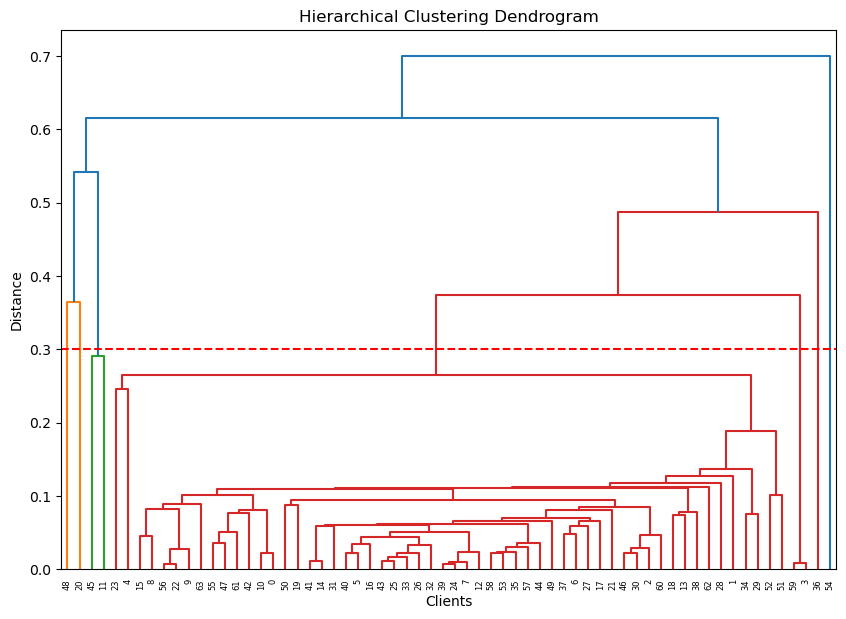

Enter the maximum distance threshold for clustering: 0.33


In [41]:
import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
import matplotlib.pyplot as plt
df1= pd.read_csv('distribution_distances_production_pdf.csv')

# Assuming df is already loaded
# Extract clients and 'DI' values
clients = df1['clients']
DI_values = df1['JS Distance']

# Function to parse client IDs correctly from both old and new formats
def parse_client_ids(client_pair):
    parts = client_pair.split('-')
    if len(parts) == 3:
        # Old format: "1-10-1"
        return int(parts[0]), int(parts[1])
    elif len(parts) == 2:
        # New format: "1-10"
        return int(parts[0]), int(parts[1])
    else:
        raise ValueError(f"Unrecognized client pair format: {client_pair}")

# Extract and parse unique client IDs
client_ids = [parse_client_ids(client) for client in clients]
unique_clients = np.unique([id for sublist in client_ids for id in sublist])

# Initialize distance matrix with zeros
num_clients = len(unique_clients)
distance_matrix = np.zeros((num_clients, num_clients))

# Populate distance matrix with 'DI' values
for i, client_pair in enumerate(clients):
    client1, client2 = parse_client_ids(client_pair)
    idx1 = np.where(unique_clients == client1)[0][0]
    idx2 = np.where(unique_clients == client2)[0][0]
    distance_matrix[idx1, idx2] = DI_values[i]
    distance_matrix[idx2, idx1] = DI_values[i]
# Perform hierarchical clustering using single linkage
linked = linkage(distance_matrix, 'single')

# Assuming 'linked' is already computed from your previous code
def plot_dendrogram(linked, max_d=None):
    plt.figure(figsize=(10, 7))
    dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
    if max_d:
        plt.axhline(y=max_d, color='r', linestyle='--')
    plt.title('Hierarchical Clustering Dendrogram')
    plt.xlabel('Clients')
    plt.ylabel('Distance')
    plt.show()

# Example usage
plot_dendrogram(linked, max_d=0.3)  # Change max_d to see how the clusters change

# Interactive selection
max_d = float(input("Enter the maximum distance threshold for clustering: "))
clusters = fcluster(linked, t=max_d, criterion='distance')
cluster_df = pd.DataFrame({'Client': unique_clients, 'Cluster': clusters})
cluster_df.to_csv('clustering_production_pdf1.csv')

In [44]:
production=pd.read_csv('clustering_production_pdf1.csv')
production

,Unnamed: 0,Client,Cluster
0,0,1,2
1,1,2,2
2,2,3,2
3,3,4,1
4,4,5,2
...,...,...,...
59,59,60,1
60,60,61,2
61,61,62,2
62,62,63,2


In [36]:
cluster_df=pd.read_csv('clustering_consumption_pdf1.csv')

cluster_df = cluster_df.rename(columns={'Client': 'client_id'})



desired_columns = ['client_id', 'product_type', 'is_business', 'county']
data_extract = data[desired_columns]

In [37]:
cluster_df

,Unnamed: 0,client_id,Cluster
0,0,1,6
1,1,2,1
2,2,3,1
3,3,4,1
4,4,5,1
...,...,...,...
59,59,60,1
60,60,61,1
61,61,62,1
62,62,63,1


In [17]:
data_extract.drop_duplicates()

,client_id,product_type,is_business,county
0,2,1,0,0
6994,4,2,0,0
13988,6,3,0,0
20982,1,0,1,0
27976,3,1,1,0
...,...,...,...,...
410150,53,1,1,13
416814,60,0,1,15
422807,12,1,1,2
428459,21,1,1,4


In [18]:
data_extract2=pd.merge(data_extract,cluster_df, on='client_id',how='inner')

In [19]:
data_extract2

,client_id,product_type,is_business,county,Unnamed: 0,Cluster
0,2,1,0,0,1,1
1,2,1,0,0,1,1
2,2,1,0,0,1,1
3,2,1,0,0,1,1
4,2,1,0,0,1,1
...,...,...,...,...,...,...
439417,46,0,1,11,45,3
439418,46,0,1,11,45,3
439419,46,0,1,11,45,3
439420,46,0,1,11,45,3


In [108]:
data_extract

,client_id,product_type,is_business,county,Cluster
0,2,1,0,0,1
1,2,1,0,0,1
2,2,1,0,0,1
3,2,1,0,0,1
4,2,1,0,0,1
...,...,...,...,...,...
439417,46,0,1,11,3
439418,46,0,1,11,3
439419,46,0,1,11,3
439420,46,0,1,11,3


In [64]:
data_extract=data_extract.rename(columns={'Cluster_x': 'cluster'})

In [65]:
data_extract=data_extract.rename(columns={'Cluster_y': 'cluster'})

In [114]:
df.to_csv('cluster_client_pdf_production1.csv')

In [ ]:
data_e

In [131]:
df1=pd.read_csv('cluster_client_pdf_production.csv')

In [20]:
# Assuming df is already defined
data_extract2.drop(['Unnamed: 0'], axis=1, inplace=True)


In [142]:
data

,client_id,product_type,is_business,county,Cluster
0,2,1,0,0,1
1,2,1,0,0,1
2,2,1,0,0,1
3,2,1,0,0,1
4,2,1,0,0,1
...,...,...,...,...,...
439417,46,0,1,11,3
439418,46,0,1,11,3
439419,46,0,1,11,3
439420,46,0,1,11,3


In [21]:
data_extract2.drop_duplicates()

,client_id,product_type,is_business,county,Cluster
0,2,1,0,0,1
6994,4,2,0,0,1
13988,6,3,0,0,1
20982,1,0,1,0,6
27976,3,1,1,0,1
...,...,...,...,...,...
410150,53,1,1,13,1
416814,60,0,1,15,1
422807,12,1,1,2,2
428459,21,1,1,4,3


In [22]:
data_extract2.to_csv('cluster_client_consumption_pdf.csv')

In [145]:
data2=pd.read_csv('cluster_client_production_pdf.csv')

In [23]:
data_extract2

,client_id,product_type,is_business,county,Cluster
0,2,1,0,0,1
1,2,1,0,0,1
2,2,1,0,0,1
3,2,1,0,0,1
4,2,1,0,0,1
...,...,...,...,...,...
439417,46,0,1,11,3
439418,46,0,1,11,3
439419,46,0,1,11,3
439420,46,0,1,11,3


In [55]:
production=production.rename(columns={'Client': 'client_id'})



desired_columns = ['client_id', 'product_type', 'is_business', 'county']
data_extract1 = data1[desired_columns]

In [80]:
desired_columns = ['client_id', 'product_type', 'is_business', 'county']
data_extract1 = data1[desired_columns]

In [81]:
data_extract1=pd.merge(data_extract1,production, on='client_id',how='inner')

In [82]:
data_extract1

,client_id,product_type,is_business,county,Cluster
0,2,1,0,0,2
1,2,1,0,0,2
2,2,1,0,0,2
3,2,1,0,0,2
4,2,1,0,0,2
...,...,...,...,...,...
439417,46,0,1,11,4
439418,46,0,1,11,4
439419,46,0,1,11,4
439420,46,0,1,11,4


In [57]:
data_extract1.drop(['Unnamed: 0'], axis=1, inplace=True)

In [83]:
data_extract1.drop_duplicates()

,client_id,product_type,is_business,county,Cluster
0,2,1,0,0,2
6994,4,2,0,0,1
13988,6,3,0,0,2
20982,1,0,1,0,2
27976,3,1,1,0,2
...,...,...,...,...,...
410150,53,1,1,13,2
416814,60,0,1,15,1
422807,12,1,1,2,4
428459,21,1,1,4,5


In [89]:
data232.to_csv('cluster_client_production_final_pdf.csv')

In [90]:
data22=pd.read_csv('cluster_client_production_final_pdf.csv')

In [97]:
data_extract.drop(['Unnamed: 0'], axis=1, inplace=True)

In [98]:
data_extract.drop_duplicates()

,client_id,product_type,is_business,county,Cluster
0,2,1,0,0,1
6994,4,2,0,0,1
13988,6,3,0,0,1
20982,1,0,1,0,6
27976,3,1,1,0,1
...,...,...,...,...,...
410150,53,1,1,13,1
416814,60,0,1,15,1
422807,12,1,1,2,2
428459,21,1,1,4,3


In [99]:
data_extract.to_csv('cluster_client_consumption_final_pdf.csv')

In [91]:
data22

,Unnamed: 0,client_id,product_type,is_business,county,Cluster
0,0,2,1,0,0,2
1,1,2,1,0,0,2
2,2,2,1,0,0,2
3,3,2,1,0,0,2
4,4,2,1,0,0,2
...,...,...,...,...,...,...
439417,439417,46,0,1,11,4
439418,439418,46,0,1,11,4
439419,439419,46,0,1,11,4
439420,439420,46,0,1,11,4


In [79]:
production.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64 entries, 0 to 63
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype
---  ------     --------------  -----
 0   client_id  64 non-null     int64
 1   Cluster    64 non-null     int64
dtypes: int64(2)
memory usage: 1.1 KB


In [92]:
consumption=pd.read_csv('clustering_consumption_pdf1.csv')

consumption=consumption.rename(columns={'Client': 'client_id'})



desired_columns = ['client_id', 'product_type', 'is_business', 'county']
data_extract = data[desired_columns]

In [94]:
data_extract=pd.merge(data_extract,consumption, on='client_id',how='inner')

In [95]:
data_extract

,client_id,product_type,is_business,county,Unnamed: 0,Cluster
0,2,1,0,0,1,1
1,2,1,0,0,1,1
2,2,1,0,0,1,1
3,2,1,0,0,1,1
4,2,1,0,0,1,1
...,...,...,...,...,...,...
439417,46,0,1,11,45,3
439418,46,0,1,11,45,3
439419,46,0,1,11,45,3
439420,46,0,1,11,45,3
